# ALTRI 4 SEP Da includere nell'analisi statistica 

https://www.swsc-journal.org/articles/swsc/full_html/2014/01/swsc130038/swsc130038.html#F2

# AUG 1972
 Raukunen et al 2018 Table 2 GLE 24

AUG 1972 (GLE #24) — Band Function (Raukunen et al. 2018)
J₀  = 6.47e+10 ± 7.50e+09 p/cm²
γ₁  = 0.87 ± 0.01
γ₂  = 7.95 ± 0.42
R₀  = 0.0713 ± 0.001 GV

Breakpoint: Rb = 0.5048 GV  →  Eb ≈ 127.2 MeV

Fluenze integrali (verifica vs King 1974 / Jiggens 2014):
  J(>10 MeV) = 5.301e+10 cm⁻²
  J(>30 MeV) = 7.847e+09 cm⁻²
  J(>60 MeV) = 1.384e+09 cm⁻²
  J(>100 MeV) = 2.566e+08 cm⁻²
  J(>500 MeV) = 2.170e+05 cm⁻²

✓ Bootstrap completato: 2000/2000 trials validi


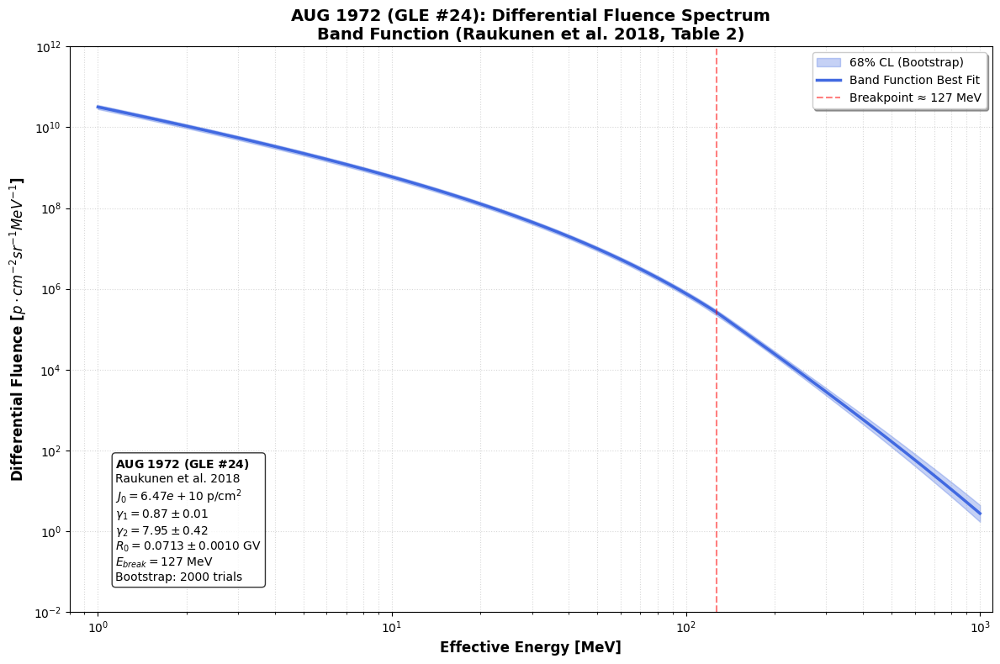


--- EXPORT SR-NIEL ---
  ✓ Planare: Median + CL68 → AUG1972_SRNIEL_EXPORT/AUG72_Planare_*.txt
  ✓ Sferica: Median + CL68 → AUG1972_SRNIEL_EXPORT/AUG72_Sferica_*.txt

--- ANALISI COMPLETATA ---
✓ Export: AUG1972_SRNIEL_EXPORT
✓ Parametri: γ₁=0.87, γ₂=7.95, R₀=0.0713 GV
✓ Ebreak = 127 MeV
✓ Bootstrap: 2000 trials validi su 2000
✓ Range export: 1 – 1000 MeV (500 punti)
✓ Geometrie: Planare (Φ/4) + Sferica (Φ)

⚠️  NOTA GEOMETRICA:
   La Band function (Raukunen) dà fluenza OMNIDIREZIONALE.
   Planare = Φ_omni × (1/4)  |  Sferica = Φ_omni × 1
   Diverso dagli eventi GOES/STEREO che erano per-steradian!


In [17]:

import numpy as np
import matplotlib.pyplot as plt
import os

# ============================================================
# 1. PARAMETRI BAND FUNCTION — GLE #24 (AUG 1972)
#    Raukunen et al. 2018, Table 2
# ============================================================
J0     = 6.47e10     # p/cm²  (normalization, omnidirezionale)
dJ0    = 7.50e9      # incertezza ±1σ
gamma1 = 0.87        # low-rigidity spectral index
dg1    = 0.01        # incertezza ±1σ
gamma2 = 7.95        # high-rigidity spectral index
dg2    = 0.42        # incertezza ±1σ
R0_GV  = 7.13e-2     # characteristic rigidity [GV]
dR0    = 1.00e-3     # incertezza ±1σ

mp = 938.272         # proton rest mass [MeV]

print("=" * 65)
print("AUG 1972 (GLE #24) — Band Function (Raukunen et al. 2018)")
print("=" * 65)
print(f"J₀  = {J0:.2e} ± {dJ0:.2e} p/cm²")
print(f"γ₁  = {gamma1} ± {dg1}")
print(f"γ₂  = {gamma2} ± {dg2}")
print(f"R₀  = {R0_GV} ± {dR0} GV")

# ============================================================
# 2. FUNZIONI DI CONVERSIONE RIGIDITÀ ↔ ENERGIA
# ============================================================

def E_to_R(E_MeV):
    """Energia cinetica [MeV] → Rigidità [GV] per protoni"""
    return np.sqrt(E_MeV**2 + 2.0 * E_MeV * mp) * 1e-3  # GV

def R_to_E(R_GV):
    """Rigidità [GV] → Energia cinetica [MeV] per protoni"""
    p_MeV = R_GV * 1e3  # momento in MeV/c
    return np.sqrt(p_MeV**2 + mp**2) - mp

def dR_dE(E_MeV):
    """Jacobiano dR/dE [GV/MeV] per protoni"""
    return (E_MeV + mp) / (1e3 * np.sqrt(E_MeV**2 + 2.0 * E_MeV * mp))

# ============================================================
# 3. BAND FUNCTION IN RIGIDITÀ (Raukunen Eq. 1)
# ============================================================

def band_integral_R(R, J0, g1, g2, R0):
    """
    Fluenza integrale omnidirezionale J(>R) [cm⁻²]
    Band function in rigidità
    """
    Rb = (g2 - g1) * R0  # breakpoint rigidity

    lo = J0 * R**(-g1) * np.exp(-R / R0)
    hi = J0 * Rb**(g2 - g1) * np.exp(g1 - g2) * R**(-g2)

    return np.where(R <= Rb, lo, hi)

def band_diff_R(R, J0, g1, g2, R0):
    """
    -dJ/dR [cm⁻² GV⁻¹]  (positivo)
    Derivata analitica della Band function
    """
    Rb = (g2 - g1) * R0

    lo = J0 * R**(-g1) * np.exp(-R / R0) * (g1 / R + 1.0 / R0)
    hi = J0 * Rb**(g2 - g1) * np.exp(g1 - g2) * g2 * R**(-(g2 + 1))

    return np.where(R <= Rb, lo, hi)

def band_diff_E(E_MeV, J0, g1, g2, R0):
    """
    Fluenza differenziale omnidirezionale dJ/dE [cm⁻² MeV⁻¹]
    Chain rule: dJ/dE = (-dJ/dR) × (dR/dE)
    """
    R = E_to_R(E_MeV)
    return band_diff_R(R, J0, g1, g2, R0) * dR_dE(E_MeV)

# ============================================================
# 4. CALCOLO SPETTRO BEST-FIT
# ============================================================
E_grid = np.logspace(np.log10(1.0), np.log10(1000.0), 500)  # 1 – 1000 MeV

# Breakpoint
Rb_GV = (gamma2 - gamma1) * R0_GV
Eb_MeV = R_to_E(Rb_GV)
print(f"\nBreakpoint: Rb = {Rb_GV:.4f} GV  →  Eb ≈ {Eb_MeV:.1f} MeV")

# Spettro best-fit
phi_best = band_diff_E(E_grid, J0, gamma1, gamma2, R0_GV)  # cm⁻² MeV⁻¹ (omni)

# Fluenze integrali di verifica
print(f"\nFluenze integrali (verifica vs King 1974 / Jiggens 2014):")
for Echeck in [10, 30, 60, 100, 500]:
    Rcheck = E_to_R(Echeck)
    Jcheck = band_integral_R(Rcheck, J0, gamma1, gamma2, R0_GV)
    print(f"  J(>{Echeck} MeV) = {Jcheck:.3e} cm⁻²")

# ============================================================
# 5. BOOTSTRAP PARAMETRICO PER INCERTEZZE
#    Perturba i 4 parametri entro le loro σ pubblicate
#    e ricalcola lo spettro ogni volta
# ============================================================
N_boot = 2000
rng = np.random.default_rng(42)

boot_spectra = []
for i in range(N_boot):
    # Campiona parametri
    J0_s  = rng.normal(J0, dJ0)
    g1_s  = rng.normal(gamma1, dg1)
    g2_s  = rng.normal(gamma2, dg2)
    R0_s  = np.abs(rng.normal(R0_GV, dR0))

    # Vincoli fisici
    if J0_s <= 0 or g2_s <= g1_s or R0_s <= 0:
        continue

    spec = band_diff_E(E_grid, J0_s, g1_s, g2_s, R0_s)
    if np.all(np.isfinite(spec)) and np.all(spec > 0):
        boot_spectra.append(spec)

boot_spectra = np.array(boot_spectra)
n_good = len(boot_spectra)

phi_med = np.median(boot_spectra, axis=0)
phi_lo, phi_hi = np.percentile(boot_spectra, [16, 84], axis=0)

print(f"\n✓ Bootstrap completato: {n_good}/{N_boot} trials validi")

# ============================================================
# 6. PLOT SPETTRO DIFFERENZIALE CON BANDE
# ============================================================
fig, ax = plt.subplots(figsize=(12, 8))

# Nota: plottiamo in cm⁻² sr⁻¹ MeV⁻¹ (÷ 4π) per coerenza
# con i plot degli altri eventi (GOES/STEREO sono per-sr)
factor_plot = 1.0 / (4.0 * np.pi)

ax.fill_between(E_grid, phi_lo * factor_plot, phi_hi * factor_plot,
                color='royalblue', alpha=0.3, label='68% CL (Bootstrap)')
ax.loglog(E_grid, phi_best * factor_plot, color='royalblue', lw=2.5,
          label='Band Function Best Fit')

ax.axvline(Eb_MeV, color='red', ls='--', alpha=0.5,
           label=f'Breakpoint ≈ {Eb_MeV:.0f} MeV')

# Stats box
stats_box = (
    r"$\bf{AUG\ 1972\ (GLE\ \#24)}$" + "\n"
    r"Raukunen et al. 2018" + "\n"
    r"$J_0 = %.2e$ p/cm$^2$" % J0 + "\n"
    r"$\gamma_1 = %.2f \pm %.2f$" % (gamma1, dg1) + "\n"
    r"$\gamma_2 = %.2f \pm %.2f$" % (gamma2, dg2) + "\n"
    r"$R_0 = %.4f \pm %.4f$ GV" % (R0_GV, dR0) + "\n"
    r"$E_{break} = %.0f$ MeV" % Eb_MeV + "\n"
    r"Bootstrap: %d trials" % n_good
)
ax.text(0.05, 0.05, stats_box, transform=ax.transAxes,
        fontsize=10, verticalalignment='bottom',
        bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

ax.set_xscale("log"); ax.set_yscale("log")
ax.set_xlim(0.8, 1100)
ax.set_ylim(1e-2, 1e12)
ax.set_xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=12)
ax.set_ylabel(r"Differential Fluence [$p \cdot cm^{-2} sr^{-1} MeV^{-1}$]",
              fontweight='bold', fontsize=12)
ax.set_title("AUG 1972 (GLE #24): Differential Fluence Spectrum\n"
             "Band Function (Raukunen et al. 2018, Table 2)",
             fontsize=14, fontweight='bold')
ax.grid(True, which="both", ls=':', alpha=0.5)
ax.legend(loc="upper right", shadow=True, fontsize=10)
fig.tight_layout()
plt.show()

# ============================================================
# 7. EXPORT SR-NIEL (1 – 1000 MeV)
#    La Band function dà fluenza OMNIDIREZIONALE (4π sr)
#    Per SR-NIEL serve: Φ_omni / 4π × fattore_geometria
#    → Planare: Φ_omni / 4π × π = Φ_omni / 4
#    → Sferica: Φ_omni / 4π × 4π = Φ_omni
# ============================================================
out_dir = "AUG1972_SRNIEL_EXPORT"
os.makedirs(out_dir, exist_ok=True)

print(f"\n--- EXPORT SR-NIEL ---")

for geo, factor, desc in [
    ("Planare", 1.0 / 4.0, "Phi_omni / 4 (planar geometry)"),
    ("Sferica", 1.0,       "Phi_omni (spherical geometry)")
]:
    # Mediana (best-fit)
    np.savetxt(f"{out_dir}/AUG72_{geo}_Median.txt",
               np.column_stack([E_grid, phi_best * factor]),
               fmt="%.6e", encoding='utf-8',
               header=f"AUG 1972 GLE#24 - {desc}\n"
                      f"Raukunen et al. 2018\n"
                      f"Energy(MeV) Fluence(cm^-2*MeV^-1)")

    # Bande CL68 (bootstrap)
    np.savetxt(f"{out_dir}/AUG72_{geo}_CL68.txt",
               np.column_stack([E_grid, phi_lo * factor, phi_hi * factor]),
               fmt="%.6e", encoding='utf-8',
               header=f"AUG 1972 GLE#24 - {desc} - 68% CL\n"
                      f"Energy(MeV) Phi16(cm^-2*MeV^-1) Phi84(cm^-2*MeV^-1)")

    # Bande CL68 (bootstrap)
    np.savetxt(f"{out_dir}/AUG72_{geo}_CL68.txt",
               np.column_stack([E_grid, phi_lo * factor, phi_hi * factor]),
               fmt="%.6e",
               header=f"AUG 1972 GLE#24 - {desc} - 68% CL\n"
                      f"Energy(MeV) Phi16(cm^-2*MeV^-1) Phi84(cm^-2*MeV^-1)")

    print(f"  ✓ {geo}: Median + CL68 → {out_dir}/AUG72_{geo}_*.txt")

print(f"\n--- ANALISI COMPLETATA ---")
print(f"✓ Export: {out_dir}")
print(f"✓ Parametri: γ₁={gamma1}, γ₂={gamma2}, R₀={R0_GV} GV")
print(f"✓ Ebreak = {Eb_MeV:.0f} MeV")
print(f"✓ Bootstrap: {n_good} trials validi su {N_boot}")
print(f"✓ Range export: 1 – 1000 MeV ({len(E_grid)} punti)")
print(f"✓ Geometrie: Planare (Φ/4) + Sferica (Φ)")
print(f"\n⚠️  NOTA GEOMETRICA:")
print(f"   La Band function (Raukunen) dà fluenza OMNIDIREZIONALE.")
print(f"   Planare = Φ_omni × (1/4)  |  Sferica = Φ_omni × 1")
print(f"   Diverso dagli eventi GOES/STEREO che erano per-steradian!")




















# CALCOLO DOSE PLANARE
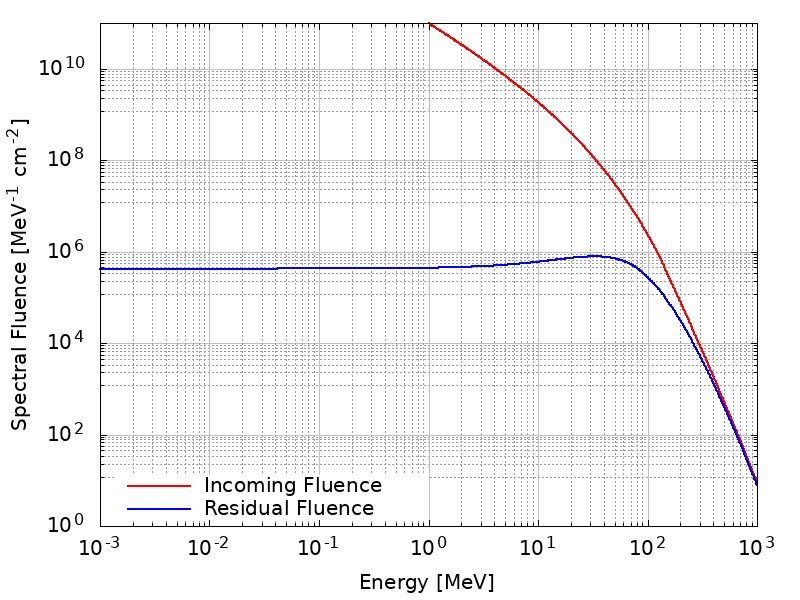

In [22]:
# ESTRAZIOEN BANDE PHI 16 e 84
# estrapolare righe Phi 16 e Phi84
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "AUG1972_SRNIEL_EXPORT/Planare/AUG72_Planare_CL68.txt"

# Caricamento del file (saltando l'header)
df_cl = pd.read_csv(path_cl, sep=r"\s+", skiprows=2, names=["E", "Phi_16", "Phi_84"])

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_16 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_84 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
------------------------------
1.000000e+00 8.836907e+10
1.013939e+00 8.652459e+10
1.028073e+00 8.470547e+10
1.042404e+00 8.292091e+10
1.056935e+00 8.117247e+10
1.071668e+00 7.945946e+10
1.086606e+00 7.778117e+10
1.101753e+00 7.613801e+10
1.117111e+00 7.452817e+10
1.132683e+00 7.295098e+10
1.148472e+00 7.141016e+10
1.164481e+00 6.990248e+10
1.180713e+00 6.842531e+10
1.197171e+00 6.697819e+10
1.213859e+00 6.556291e+10
1.230780e+00 6.416971e+10
1.247936e+00 6.281014e+10
1.265332e+00 6.148044e+10
1.282970e+00 6.016779e+10
1.300854e+00 5.887257e+10
1.318987e+00 5.762371e+10
1.337373e+00 5.640595e+10
1.356015e+00 5.519734e+10
1.374917e+00 5.401236e+10
1.394083e+00 5.285205e+10
1.413516e+00 5.171562e+10
1.433219e+00 5.060265e+10
1.453198e+00 4.951833e+10
1.473454e+00 4.845307e+10
1.493993e+00 4.740673e+10
1.514819e+00 4.638186e+10
1.535935e+00 4.537806e+10
1.557345e+00 4.439337e+10
1.579053e+00 4.342972e+10
1.601064

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  AUG 1972 
Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)
Dose Mediana: 187.0617 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [153.314 - 224.158] mGy
Incertezza Totale: +37.096 / -33.747 mGy
-----------------------------------------------------------------


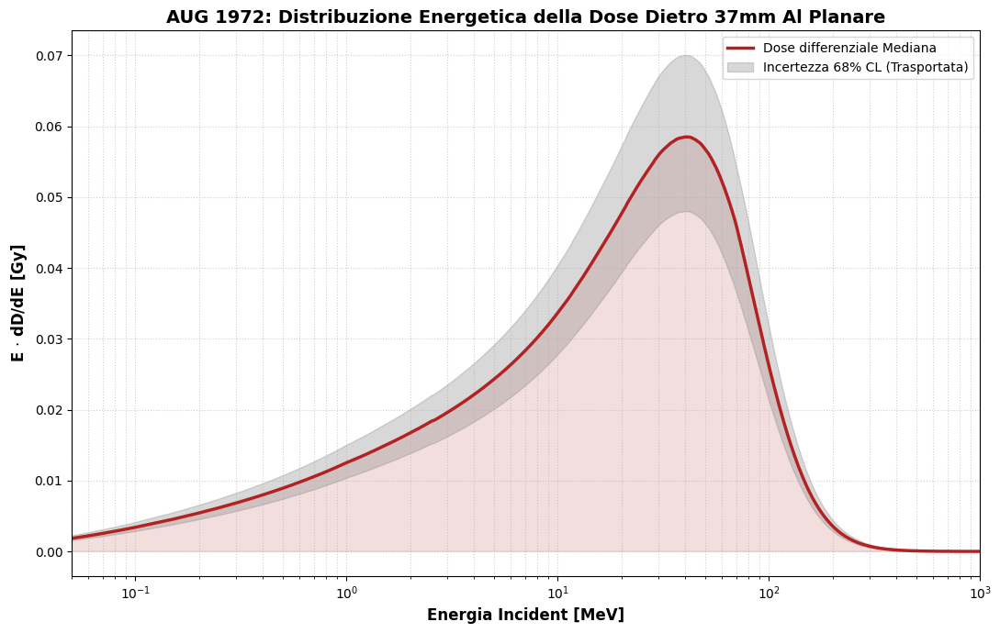

In [23]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "AUG1972_SRNIEL_EXPORT/Planare/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "median_residual_planar.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "Phi16_residual_planar.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "Phi84_residual_planar.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  AUG 1972 ")
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("AUG 1972: Distribuzione Energetica della Dose Dietro 37mm Al Planare", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.05, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# CALCOLO DOSE SFERICA

In [1]:
# ESTRAZIOEN BANDE PHI 16 e 84
# estrapolare righe Phi 16 e Phi84
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "AUG1972_SRNIEL_EXPORT/Sferica/AUG72_Sferica_CL68.txt"

# Caricamento del file (saltando l'header)
df_cl = pd.read_csv(path_cl, sep=r"\s+", skiprows=2, names=["E", "Phi_16", "Phi_84"])

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_16 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_84 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
------------------------------
1.000000e+00 3.534763e+11
1.013939e+00 3.460983e+11
1.028073e+00 3.388219e+11
1.042404e+00 3.316836e+11
1.056935e+00 3.246899e+11
1.071668e+00 3.178378e+11
1.086606e+00 3.111247e+11
1.101753e+00 3.045520e+11
1.117111e+00 2.981127e+11
1.132683e+00 2.918039e+11
1.148472e+00 2.856406e+11
1.164481e+00 2.796099e+11
1.180713e+00 2.737012e+11
1.197171e+00 2.679128e+11
1.213859e+00 2.622517e+11
1.230780e+00 2.566788e+11
1.247936e+00 2.512405e+11
1.265332e+00 2.459218e+11
1.282970e+00 2.406712e+11
1.300854e+00 2.354903e+11
1.318987e+00 2.304948e+11
1.337373e+00 2.256238e+11
1.356015e+00 2.207894e+11
1.374917e+00 2.160494e+11
1.394083e+00 2.114082e+11
1.413516e+00 2.068625e+11
1.433219e+00 2.024106e+11
1.453198e+00 1.980733e+11
1.473454e+00 1.938123e+11
1.493993e+00 1.896269e+11
1.514819e+00 1.855275e+11
1.535935e+00 1.815123e+11
1.557345e+00 1.775735e+11
1.579053e+00 1.737189e+11
1.601064

# DOse sferica 
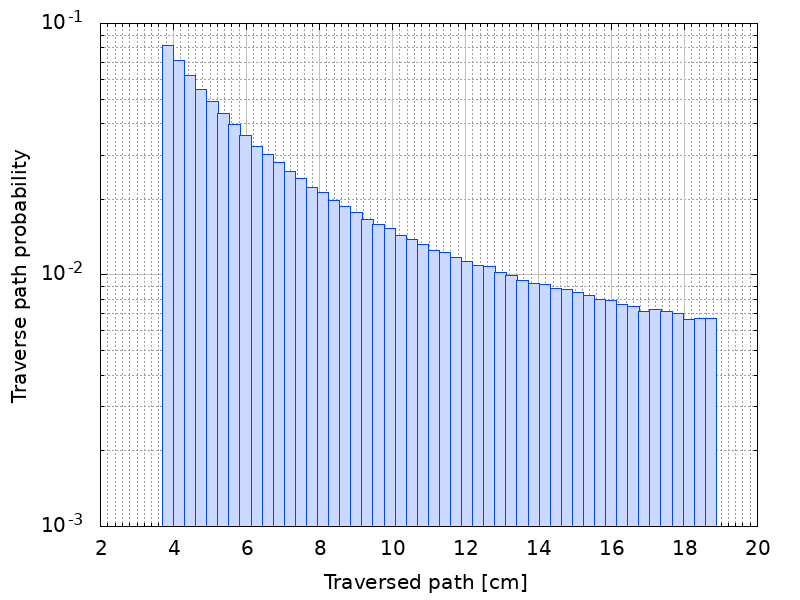
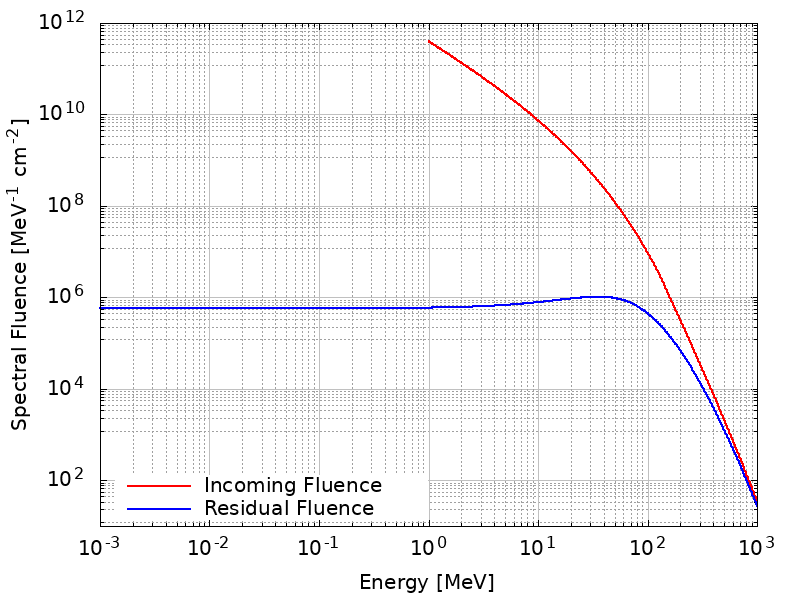

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  AUG 1972 
Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)
Dose Mediana: 255.3947 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [208.140 - 307.527] mGy
Incertezza Totale: +52.133 / -47.255 mGy
-----------------------------------------------------------------


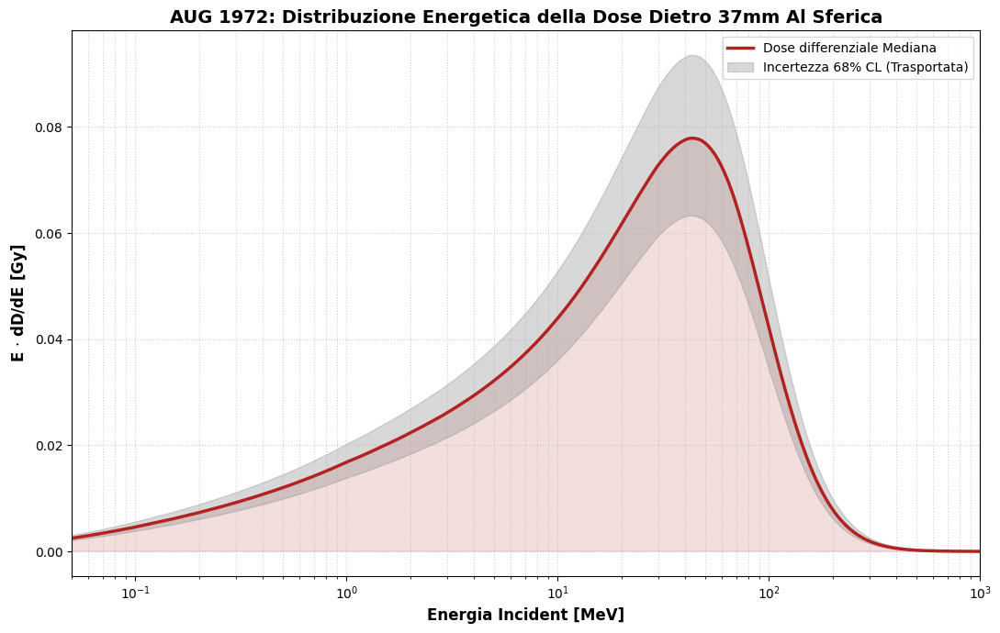

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "AUG1972_SRNIEL_EXPORT/Sferica/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "median_residual_spherical.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "Phi16_residual_spherical.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "Phi84_residual_spherical.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  AUG 1972 ")
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("AUG 1972: Distribuzione Energetica della Dose Dietro 37mm Al Sferica", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.05, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# OCT 1989



# DATI GOES-7

Colonne: ['P2', 'P3', 'P4', 'P5', 'P6', 'P7']
Canali trovati: ['P2', 'P3', 'P4', 'P5', 'P6', 'P7']


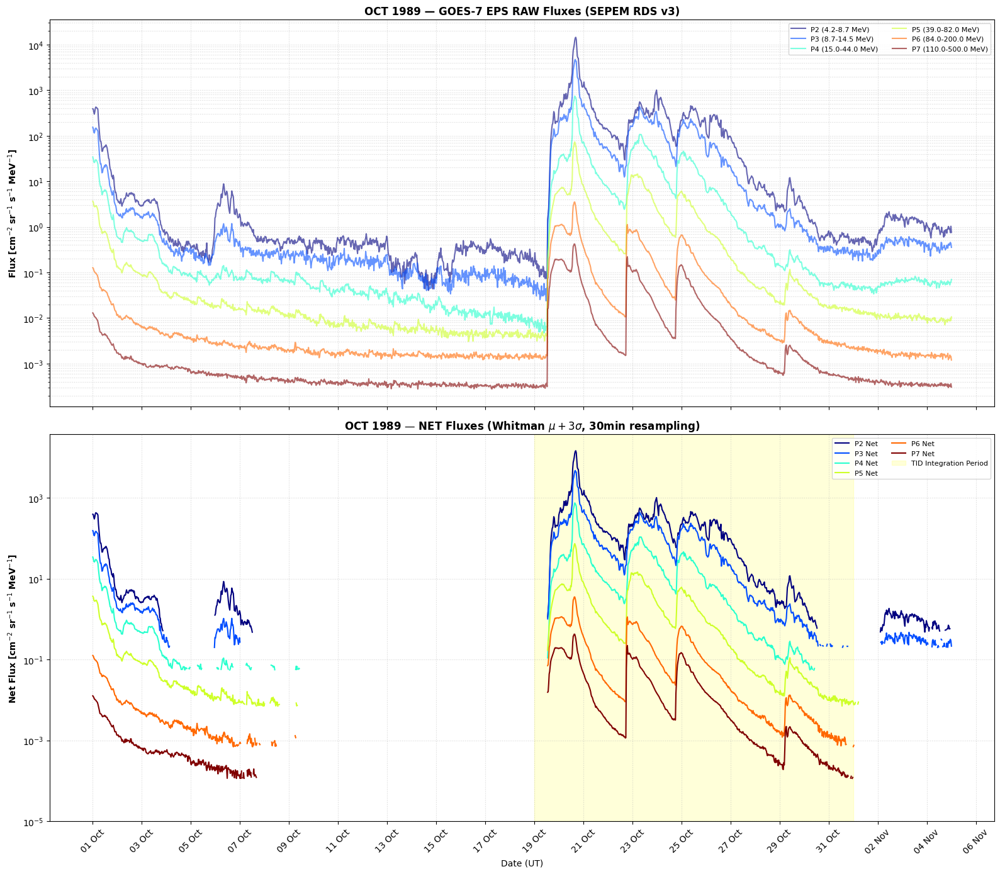


SOGLIE WHITMAN (mu + 3sigma):
  P2 (4.2-8.7 MeV): bg=3.222e-01, thr=7.924e-01
  P3 (8.7-14.5 MeV): bg=1.422e-01, thr=3.400e-01
  P4 (15.0-44.0 MeV): bg=3.352e-02, thr=8.814e-02
  P5 (39.0-82.0 MeV): bg=6.842e-03, thr=1.388e-02
  P6 (84.0-200.0 MeV): bg=1.639e-03, thr=2.328e-03
  P7 (110.0-500.0 MeV): bg=3.655e-04, thr=4.754e-04


In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

# ==========================================
# 1. CARICAMENTO DATI — GOES-7 EPS (SEPEM RDS v3)
# ==========================================
file_path_eps = "SEPEM_RDS_v3/SEPEM_RDS_v3-0/RDS3.0_H_EPS_GOES07.txt"

df_eps = pd.read_csv(file_path_eps, sep=',', skipinitialspace=True, 
                     index_col='epoch', parse_dates=['epoch'])
df_eps.columns = df_eps.columns.str.strip()

print("Colonne:", df_eps.columns.tolist())

# ==========================================
# 2. PARAMETRI E INTERVALLI — OCT 1989
# ==========================================
t_start, t_end = '1989-10-01 00:00:00', '1989-11-05 00:00:00'
bg_start, bg_end = '1989-10-09 00:00:00', '1989-10-17 00:00:00'
t_integ_start, t_integ_end = '1989-10-19 00:00:00', '1989-11-01 00:00:00'

energy_labels = {
    'P2': '4.2-8.7 MeV', 'P3': '8.7-14.5 MeV', 'P4': '15.0-44.0 MeV',
    'P5': '39.0-82.0 MeV', 'P6': '84.0-200.0 MeV', 'P7': '110.0-500.0 MeV'
}

eff_energies = {
    'P2': 6.591, 'P3': 11.15, 'P4': 21.54,
    'P5': 49.98, 'P6': 102.4, 'P7': 214.4
}

# Filtra canali disponibili
available = {k: v for k, v in energy_labels.items() if k in df_eps.columns}
print(f"Canali trovati: {list(available.keys())}")

# ==========================================
# 3. SELEZIONE TEMPORALE + RESAMPLING + PULIZIA
# ==========================================
df_raw = df_eps.loc[t_start:t_end, list(available.keys())].copy()
df_raw = df_raw.resample('30min').mean()

bg_period = df_raw.loc[bg_start:bg_end]
mu = bg_period.mean()
sigma = bg_period.std()
threshold = mu + 3 * sigma

df_net = df_raw.copy()
for col in available.keys():
    df_net[col] = df_raw[col] - mu[col]
    df_net.loc[df_raw[col] < threshold[col], col] = np.nan

# ==========================================
# 4. PLOT DI CONFRONTO
# ==========================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 14), sharex=True)
colors_map = plt.cm.jet(np.linspace(0, 1, len(available)))

# RAW
for i, col in enumerate(available.keys()):
    ax1.plot(df_raw.index, df_raw[col], 
             label=f"{col} ({available[col]})", color=colors_map[i], alpha=0.6)
ax1.set_yscale('log')
ax1.set_ylabel(r'Flux [cm$^{-2}$ sr$^{-1}$ s$^{-1}$ MeV$^{-1}$]', fontweight='bold')
ax1.set_title('OCT 1989 — GOES-7 EPS RAW Fluxes (SEPEM RDS v3)', fontweight='bold')
ax1.grid(True, which="both", ls=':', alpha=0.5)
ax1.legend(loc='upper right', fontsize=8, ncol=2)

# NET + Integration window
for i, col in enumerate(available.keys()):
    ax2.plot(df_net.index, df_net[col], 
             label=f"{col} Net", color=colors_map[i], linewidth=1.5)

ax2.axvspan(pd.to_datetime(t_integ_start), pd.to_datetime(t_integ_end), 
            color='yellow', alpha=0.15, label='TID Integration Period')
ax2.set_yscale('log')
ax2.set_ylim(bottom=1e-5)
ax2.set_ylabel(r'Net Flux [cm$^{-2}$ sr$^{-1}$ s$^{-1}$ MeV$^{-1}$]', fontweight='bold')
ax2.set_title(r'OCT 1989 — NET Fluxes (Whitman $\mu+3\sigma$, 30min resampling)', fontweight='bold')
ax2.set_xlabel('Date (UT)')
ax2.grid(True, which="both", ls=':', alpha=0.5)
ax2.legend(loc='upper right', fontsize=8, ncol=2)

ax2.xaxis.set_major_locator(mdates.DayLocator(interval=2))
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# ==========================================
# 5. DIAGNOSTICA
# ==========================================
print("\n" + "=" * 50)
print("SOGLIE WHITMAN (mu + 3sigma):")
print("=" * 50)
for col in available.keys():
    print(f"  {col} ({available[col]}): bg={mu[col]:.3e}, thr={threshold[col]:.3e}")

# CALCOLO FLUENZA 

OCT 1989 — FLUENZE INTEGRATE PER CANALE
Periodo: 1989-10-19 00:00:00 → 1989-11-01 00:00:00
  P2 (4.2-8.7 MeV):  4.2554e+08 cm^-2 sr^-1 MeV^-1
  P3 (8.7-14.5 MeV):  1.6364e+08 cm^-2 sr^-1 MeV^-1
  P4 (15.0-44.0 MeV):  2.7118e+07 cm^-2 sr^-1 MeV^-1
  P5 (39.0-82.0 MeV):  3.3056e+06 cm^-2 sr^-1 MeV^-1
  P6 (84.0-200.0 MeV):  2.3782e+05 cm^-2 sr^-1 MeV^-1
  P7 (110.0-500.0 MeV):  3.6824e+04 cm^-2 sr^-1 MeV^-1

--- DataFrame Fluenze ---
Channel   E_eff  E_lo  E_hi      Fluence  Fluence_err  x_err_low  x_err_high Instrument
     P2   6.591   4.2   8.7 4.255374e+08 1.063844e+08      2.391       2.109 GOES-7/EPS
     P3  11.150   8.7  14.5 1.636361e+08 4.090902e+07      2.450       3.350 GOES-7/EPS
     P4  21.540  15.0  44.0 2.711751e+07 6.779378e+06      6.540      22.460 GOES-7/EPS
     P5  49.980  39.0  82.0 3.305609e+06 8.264024e+05     10.980      32.020 GOES-7/EPS
     P6 102.400  84.0 200.0 2.378180e+05 5.945450e+04     18.400      97.600 GOES-7/EPS
     P7 214.400 110.0 500.0 3.682420

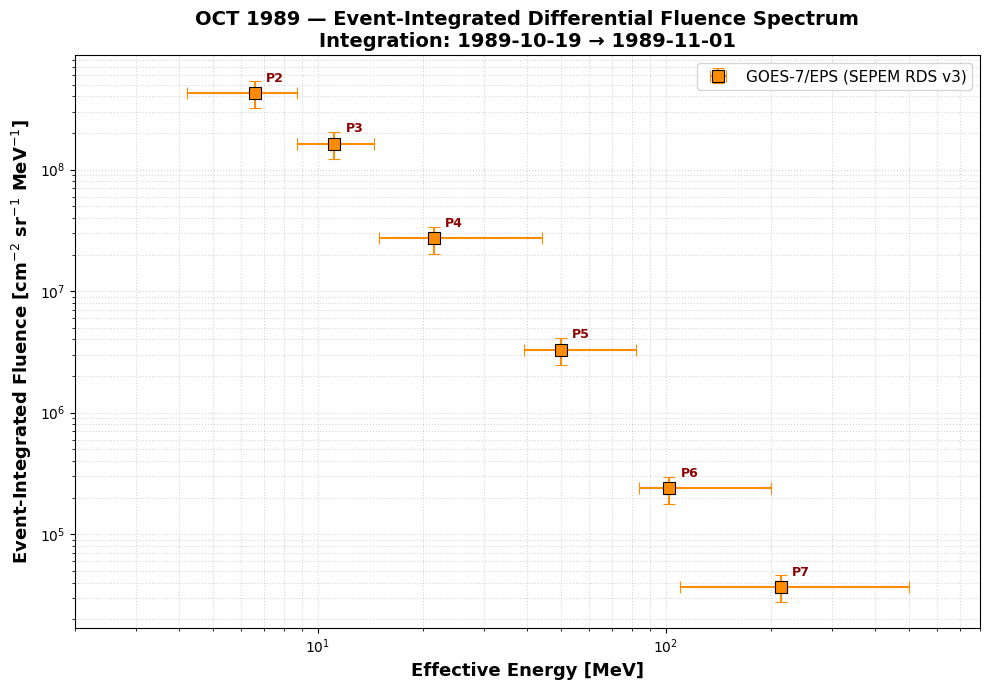


--- SANITY CHECK ---
Punti dati: 6
Range energetico: 6.6 – 214.4 MeV
Fluenza max (P2): 4.255e+08 cm^-2 sr^-1 MeV^-1
Fluenza min (P7): 3.682e+04 cm^-2 sr^-1 MeV^-1
Rapporto P2/P7: 11556x
N timesteps integrati: 625 (× 1800.0s = 312 ore)


In [5]:
# ============================================================
# OCT 1989: INTEGRAZIONE TEMPORALE → FLUENZA + PLOT DI VERIFICA
# ============================================================

# 1. INTEGRAZIONE TEMPORALE (flux → fluence)
# I dati SEPEM sono in cm^-2 sr^-1 s^-1 MeV^-1
# Resampling a 30 min → dt = 1800 s

dt = 1800.0  # secondi per bin (30 min)

df_integ = df_net.loc[t_integ_start:t_integ_end].copy()

# Fluenza per canale: somma(flux * dt), ignorando NaN
fluence = {}
for col in available.keys():
    flux_valid = df_integ[col].dropna()
    fluence[col] = flux_valid.sum() * dt  # cm^-2 sr^-1 MeV^-1

print("=" * 60)
print("OCT 1989 — FLUENZE INTEGRATE PER CANALE")
print(f"Periodo: {t_integ_start} → {t_integ_end}")
print("=" * 60)
for col, fl in fluence.items():
    print(f"  {col} ({available[col]}):  {fl:.4e} cm^-2 sr^-1 MeV^-1")

# 2. COSTRUZIONE DATAFRAME PER FIT
E_eff = np.array([eff_energies[col] for col in available.keys()])
F_val = np.array([fluence[col] for col in available.keys()])
ch_names = list(available.keys())

# Energie nominali dei canali (bordi)
energy_bounds = {
    'P2': (4.2, 8.7),   'P3': (8.7, 14.5),  'P4': (15.0, 44.0),
    'P5': (39.0, 82.0),  'P6': (84.0, 200.0), 'P7': (110.0, 500.0)
}

E_lo = np.array([energy_bounds[col][0] for col in ch_names])
E_hi = np.array([energy_bounds[col][1] for col in ch_names])
x_err_low  = E_eff - E_lo
x_err_high = E_hi - E_eff

# Incertezza sulla fluenza: 25% sistematico (conservativo per GOES-7)
y_err = 0.25 * F_val

# DataFrame di riepilogo
df_fluence = pd.DataFrame({
    'Channel': ch_names,
    'E_eff': E_eff,
    'E_lo': E_lo,
    'E_hi': E_hi,
    'Fluence': F_val,
    'Fluence_err': y_err,
    'x_err_low': x_err_low,
    'x_err_high': x_err_high,
    'Instrument': 'GOES-7/EPS'
})

print("\n--- DataFrame Fluenze ---")
print(df_fluence.to_string(index=False))

# 3. PLOT DI VERIFICA — SPETTRO DI FLUENZA
fig, ax = plt.subplots(figsize=(10, 7))

ax.errorbar(E_eff, F_val, 
            yerr=y_err,
            xerr=[x_err_low, x_err_high],
            fmt='s', color='darkorange', capsize=4, capthick=1.5,
            markersize=8, markeredgecolor='black', markeredgewidth=0.8,
            label='GOES-7/EPS (SEPEM RDS v3)', zorder=5)

# Annotazione canali
for i, ch in enumerate(ch_names):
    ax.annotate(ch, (E_eff[i], F_val[i]), 
                textcoords="offset points", xytext=(8, 8),
                fontsize=9, color='darkred', fontweight='bold')

ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Effective Energy [MeV]', fontsize=13, fontweight='bold')
ax.set_ylabel(r'Event-Integrated Fluence [cm$^{-2}$ sr$^{-1}$ MeV$^{-1}$]', 
              fontsize=13, fontweight='bold')
ax.set_title('OCT 1989 — Event-Integrated Differential Fluence Spectrum\n'
             f'Integration: {t_integ_start[:10]} → {t_integ_end[:10]}',
             fontsize=14, fontweight='bold')
ax.set_xlim(2, 800)
ax.grid(True, which='both', ls=':', alpha=0.5)
ax.legend(fontsize=11, loc='upper right')
plt.tight_layout()
plt.show()

# 4. SANITY CHECK
print("\n--- SANITY CHECK ---")
print(f"Punti dati: {len(F_val)}")
print(f"Range energetico: {E_eff.min():.1f} – {E_eff.max():.1f} MeV")
print(f"Fluenza max (P2): {F_val[0]:.3e} cm^-2 sr^-1 MeV^-1")
print(f"Fluenza min (P7): {F_val[-1]:.3e} cm^-2 sr^-1 MeV^-1")
print(f"Rapporto P2/P7: {F_val[0]/F_val[-1]:.0f}x")
print(f"N timesteps integrati: {df_integ.shape[0]} (× {dt}s = {df_integ.shape[0]*dt/3600:.0f} ore)")

# FIT e EXPORT SRNIEL


--- INIZIO ELABORAZIONE FINALE (BAND FUNCTION): OTTOBRE 1989 ---
    Metodo incertezza: Bootstrap Parametrico (N=2000)

Numero punti per fit: 6
✓ Best-fit convergito
  logA = 10.357 ± 0.546
  γₐ   = 1.992 ± 0.688
  γᵦ   = 3.069 ± 0.242
  E₀   = 41.11 ± 57.14 MeV
  Ebreak = 44.3 MeV
  χ²ᵥ   = 1.188

✓ Bootstrap completato: 2000/2000 trials riusciti (0 falliti, 0 filtrati)

  Parametri Bootstrap (mediana [16%, 84%]):
    logA = 10.093  [9.237, 10.577]
    γₐ = 1.700  [0.100, 2.243]
    γᵦ = 3.055  [2.872, 3.289]
    E₀ = 27.026  [5.692, 69.936] MeV


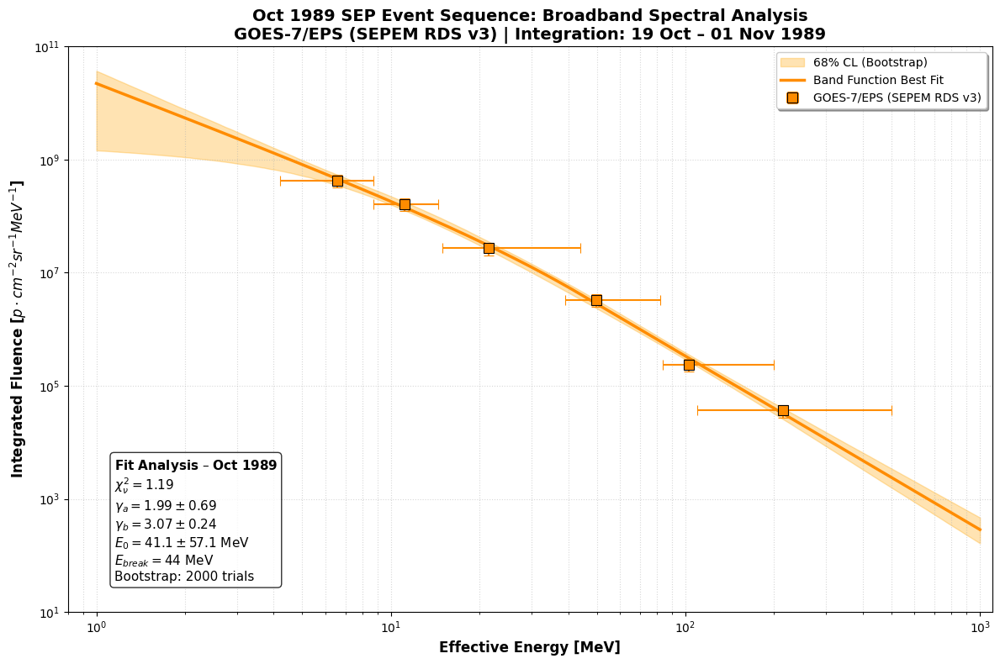


--- ANALISI COMPLETATA ---
✓ Export: OCT1989_SRNIEL_EXPORT_2026_usaquesto
✓ Parametri: γₐ=1.99, γᵦ=3.07, E₀=41.1 MeV
✓ Ebreak = 44 MeV
✓ χ²ᵥ = 1.19
✓ Bootstrap: 2000 trials validi su 2000
✓ Range export: 1 – 1000 MeV (500 punti)
✓ Geometrie: Planare (×π) + Sferica (×4π)


In [6]:
# ============================================================
# OCT 1989: FIT BAND FUNCTION + BOOTSTRAP PARAMETRICO + EXPORT SR-NIEL
# Dati: GOES-7/EPS (SEPEM RDS v3)
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
import os
from scipy.optimize import curve_fit

# ── 1. MODELLI FISICI (LOG-SPACE) ──
def log_band(E, logA, ga, gb, E0):
    E0_s = np.clip(E0, 0.1, 1000)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E, dtype=float)
    mask = E <= ebreak
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

def band_linear(E, *p):
    return 10**log_band(E, *p)

print("\n--- INIZIO ELABORAZIONE FINALE (BAND FUNCTION): OTTOBRE 1989 ---")
print("    Metodo incertezza: Bootstrap Parametrico (N=2000)\n")

# ── 2. PREPARAZIONE DATI ──
E_tot = df_fluence['E_eff'].values
Y_tot = df_fluence['Fluence'].values
print(f"Numero punti per fit: {len(E_tot)}")

# Errore: 25% sistematico + poissoniano
Yerr_tot = np.sqrt((0.25 * Y_tot)**2 + Y_tot)
sigma_log = Yerr_tot / (Y_tot * np.log(10))

# ── 3. FIT BEST-FIT SUI DATI REALI ──
p0 = [10.0, 1.2, 3.5, 25.0]
bounds = ([7, 0.1, 1.5, 1.0], [14, 2.5, 7.0, 500])

try:
    popt, pcov = curve_fit(log_band, E_tot, np.log10(Y_tot), p0=p0,
                           sigma=sigma_log, absolute_sigma=True,
                           bounds=bounds, maxfev=20000)
    perr = np.sqrt(np.diag(pcov))
    print("✓ Best-fit convergito")
    print(f"  logA = {popt[0]:.3f} ± {perr[0]:.3f}")
    print(f"  γₐ   = {popt[1]:.3f} ± {perr[1]:.3f}")
    print(f"  γᵦ   = {popt[2]:.3f} ± {perr[2]:.3f}")
    print(f"  E₀   = {popt[3]:.2f} ± {perr[3]:.2f} MeV")
except Exception as e:
    print(f"❌ Errore Fit: {e}")
    popt = None

if popt is not None:
    # Residui e chi2 ridotto
    residuals = (np.log10(Y_tot) - log_band(E_tot, *popt)) / sigma_log
    chi2red = np.sum(residuals**2) / max(len(E_tot) - len(popt), 1)
    ebreak = (popt[2] - popt[1]) * popt[3]
    print(f"  Ebreak = {ebreak:.1f} MeV")
    print(f"  χ²ᵥ   = {chi2red:.3f}")

    # ── 4. BOOTSTRAP PARAMETRICO ──
    # Per ogni trial:
    #   1) Perturba i punti sperimentali entro le loro σ_log
    #   2) Ri-fitta la Band function
    #   3) Valuta lo spettro sulla griglia
    # Le bande emergono naturalmente dalla dispersione dei fit

    E_grid = np.logspace(np.log10(1.0), 3, 500)
    N_boot = 2000
    rng = np.random.default_rng(42)

    boot_spectra = []
    boot_params = []
    n_fail = 0

    for i in range(N_boot):
        # Perturba dati in log-space
        noise = rng.normal(0, sigma_log)
        Y_synth_log = np.log10(Y_tot) + noise

        try:
            p_boot, _ = curve_fit(log_band, E_tot, Y_synth_log, p0=popt,
                                  sigma=sigma_log, absolute_sigma=True,
                                  bounds=bounds, maxfev=10000)
            spectrum = band_linear(E_grid, *p_boot)

            # Filtro fisico: scarta fit palesemente non fisici
            if np.all(np.isfinite(spectrum)) and np.all(spectrum > 0):
                boot_spectra.append(spectrum)
                boot_params.append(p_boot)
        except:
            n_fail += 1

    boot_spectra = np.array(boot_spectra)
    boot_params = np.array(boot_params)
    n_good = len(boot_spectra)

    print(f"\n✓ Bootstrap completato: {n_good}/{N_boot} trials riusciti "
          f"({n_fail} falliti, {N_boot - n_good - n_fail} filtrati)")

    # Percentili
    Phi_best = band_linear(E_grid, *popt)
    Phi_med = np.median(boot_spectra, axis=0)
    Phi_lo, Phi_hi = np.percentile(boot_spectra, [16, 84], axis=0)

    # Statistiche parametri bootstrap
    print(f"\n  Parametri Bootstrap (mediana [16%, 84%]):")
    labels = ['logA', 'γₐ', 'γᵦ', 'E₀']
    units = ['', '', '', ' MeV']
    for j, (lab, unit) in enumerate(zip(labels, units)):
        med = np.median(boot_params[:, j])
        lo, hi = np.percentile(boot_params[:, j], [16, 84])
        print(f"    {lab} = {med:.3f}  [{lo:.3f}, {hi:.3f}]{unit}")

    # ── 5. PLOT PROFESSIONALE ──
    fig, ax = plt.subplots(figsize=(12, 8))

    # Bande bootstrap
    ax.fill_between(E_grid, Phi_lo, Phi_hi, color='orange', alpha=0.3,
                    label='68% CL (Bootstrap)')

    # Best-fit
    ax.plot(E_grid, Phi_best, color='darkorange', lw=2.5,
            label="Band Function Best Fit")

    # Dati
    ax.errorbar(E_tot, Y_tot, yerr=Yerr_tot,
                xerr=[df_fluence['x_err_low'].values,
                      df_fluence['x_err_high'].values],
                fmt='s', color='darkorange', capsize=4, capthick=1.5,
                markersize=8, markeredgecolor='black', markeredgewidth=0.8,
                label='GOES-7/EPS (SEPEM RDS v3)', zorder=5)

    # Stats box
    stats_box = (
        r"$\bf{Fit\ Analysis\ –\ Oct\ 1989}$" + "\n"
        r"$\chi^2_\nu = %.2f$" % chi2red + "\n"
        r"$\gamma_a = %.2f \pm %.2f$" % (popt[1], perr[1]) + "\n"
        r"$\gamma_b = %.2f \pm %.2f$" % (popt[2], perr[2]) + "\n"
        r"$E_0 = %.1f \pm %.1f$ MeV" % (popt[3], perr[3]) + "\n"
        r"$E_{break} = %.0f$ MeV" % ebreak + "\n"
        r"Bootstrap: %d trials" % n_good
    )
    ax.text(0.05, 0.05, stats_box, transform=ax.transAxes,
            fontsize=11, verticalalignment='bottom',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

    ax.set_xscale("log"); ax.set_yscale("log")
    ax.set_xlim(0.8, 1100); ax.set_ylim(1e1, 1e11)
    ax.set_xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=12)
    ax.set_ylabel(r"Integrated Fluence [$p \cdot cm^{-2} sr^{-1} MeV^{-1}$]",
                  fontweight='bold', fontsize=12)
    ax.set_title("Oct 1989 SEP Event Sequence: Broadband Spectral Analysis\n"
                 "GOES-7/EPS (SEPEM RDS v3) | Integration: 19 Oct – 01 Nov 1989",
                 fontsize=14, fontweight='bold')
    ax.grid(True, which="both", ls=':', alpha=0.5)
    ax.legend(loc="upper right", shadow=True, fontsize=10)
    fig.tight_layout()
    plt.show()

    # ── 6. EXPORT SR-NIEL (1 – 1000 MeV) ──
    out_dir = "OCT1989_SRNIEL_EXPORT_2026_usaquesto"
    os.makedirs(out_dir, exist_ok=True)

    for geo, factor in {"Planare": np.pi, "Sferica": 4*np.pi}.items():
        np.savetxt(f"{out_dir}/OCT89_{geo}_Median.txt",
                   np.column_stack([E_grid, factor * Phi_med]),
                   fmt="%.6e",
                   header=f"Energy(MeV) {geo}_Fluence(cm^-2*MeV^-1)")
        np.savetxt(f"{out_dir}/OCT89_{geo}_CL68.txt",
                   np.column_stack([E_grid, factor * Phi_lo, factor * Phi_hi]),
                   fmt="%.6e",
                   header="Energy(MeV) Phi16 Phi84")

    print(f"\n--- ANALISI COMPLETATA ---")
    print(f"✓ Export: {out_dir}")
    print(f"✓ Parametri: γₐ={popt[1]:.2f}, γᵦ={popt[2]:.2f}, E₀={popt[3]:.1f} MeV")
    print(f"✓ Ebreak = {ebreak:.0f} MeV")
    print(f"✓ χ²ᵥ = {chi2red:.2f}")
    print(f"✓ Bootstrap: {n_good} trials validi su {N_boot}")
    print(f"✓ Range export: 1 – 1000 MeV ({len(E_grid)} punti)")
    print(f"✓ Geometrie: Planare (×π) + Sferica (×4π)")

In [9]:
# ============================================================
# CALCOLO FLUENZE INTEGRALI — OCT 1989
# La Band function è in cm⁻² sr⁻¹ MeV⁻¹
# Fluenza omnidirezionale = integrale × 4π sr
# ============================================================

E_int = np.logspace(np.log10(0.5), 3, 5000)  # griglia fine per integrazione
phi_diff = band_linear(E_int, *popt)  # cm⁻² sr⁻¹ MeV⁻¹

print("\n--- FLUENZE INTEGRALI OCT 1989 (omnidirezionali, ×4π sr) ---")
for E_thresh in [10, 30, 60, 100, 500]:
    mask = E_int >= E_thresh
    J_omni = 4 * np.pi * np.trapezoid(phi_diff[mask], E_int[mask])
    print(f"  J(>{E_thresh} MeV) = {J_omni:.3e} cm⁻²")


--- FLUENZE INTEGRALI OCT 1989 (omnidirezionali, ×4π sr) ---
  J(>10 MeV) = 1.557e+10 cm⁻²
  J(>30 MeV) = 2.415e+09 cm⁻²
  J(>60 MeV) = 5.836e+08 cm⁻²
  J(>100 MeV) = 2.017e+08 cm⁻²
  J(>500 MeV) = 5.535e+06 cm⁻²


# CALCOLO DOSE SRNIEL

# PLANARE range 1-1000 MeV

In [11]:
# ESTRAZIOEN BANDE PHI 16 e 84
# estrapolare righe Phi 16 e Phi84
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "OCT1989_SRNIEL_EXPORT_2026_usaquesto/Planar/OCT89_Planare_CL68.txt"

# Caricamento del file (saltando l'header)
df_cl = pd.read_csv(path_cl, sep=r"\s+", skiprows=1, names=["E", "Phi_16", "Phi_84"])

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_16 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_84 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
------------------------------
1.000000e+00 4.572160e+09
1.013939e+00 4.553983e+09
1.028073e+00 4.535715e+09
1.042404e+00 4.512014e+09
1.056935e+00 4.493780e+09
1.071668e+00 4.473539e+09
1.086606e+00 4.455743e+09
1.101753e+00 4.431726e+09
1.117111e+00 4.412656e+09
1.132683e+00 4.394450e+09
1.148472e+00 4.362776e+09
1.164481e+00 4.343210e+09
1.180713e+00 4.323627e+09
1.197171e+00 4.299703e+09
1.213859e+00 4.278591e+09
1.230780e+00 4.260020e+09
1.247936e+00 4.241354e+09
1.265332e+00 4.221672e+09
1.282970e+00 4.202437e+09
1.300854e+00 4.175418e+09
1.318987e+00 4.155676e+09
1.337373e+00 4.136629e+09
1.356015e+00 4.117486e+09
1.374917e+00 4.096429e+09
1.394083e+00 4.068770e+09
1.413516e+00 4.045108e+09
1.433219e+00 4.015903e+09
1.453198e+00 3.997252e+09
1.473454e+00 3.977114e+09
1.493993e+00 3.958735e+09
1.514819e+00 3.936476e+09
1.535935e+00 3.907181e+09
1.557345e+00 3.886346e+09
1.579053e+00 3.865409e+09
1.601064

# CALCOLO DOSE 
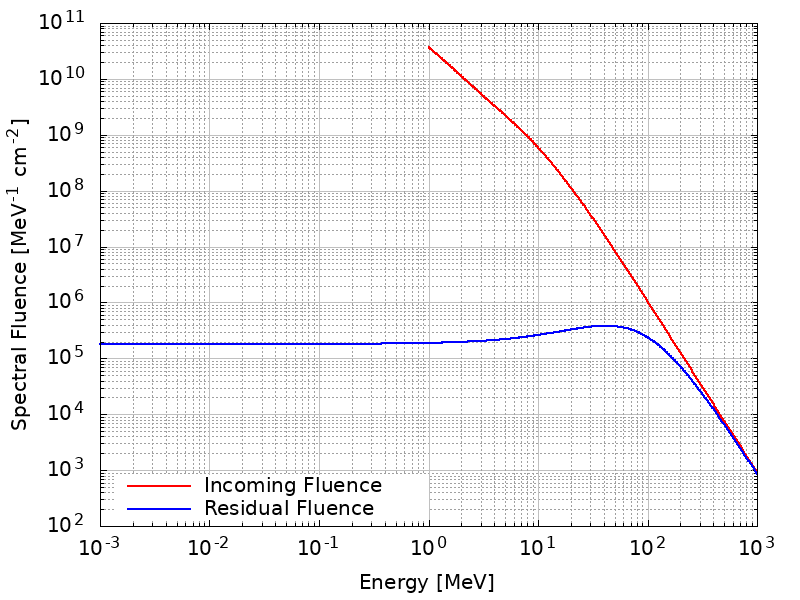

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  OCT 1989 
Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)
Dose Mediana: 99.1015 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [80.630 - 121.761] mGy
Incertezza Totale: +22.660 / -18.471 mGy
-----------------------------------------------------------------


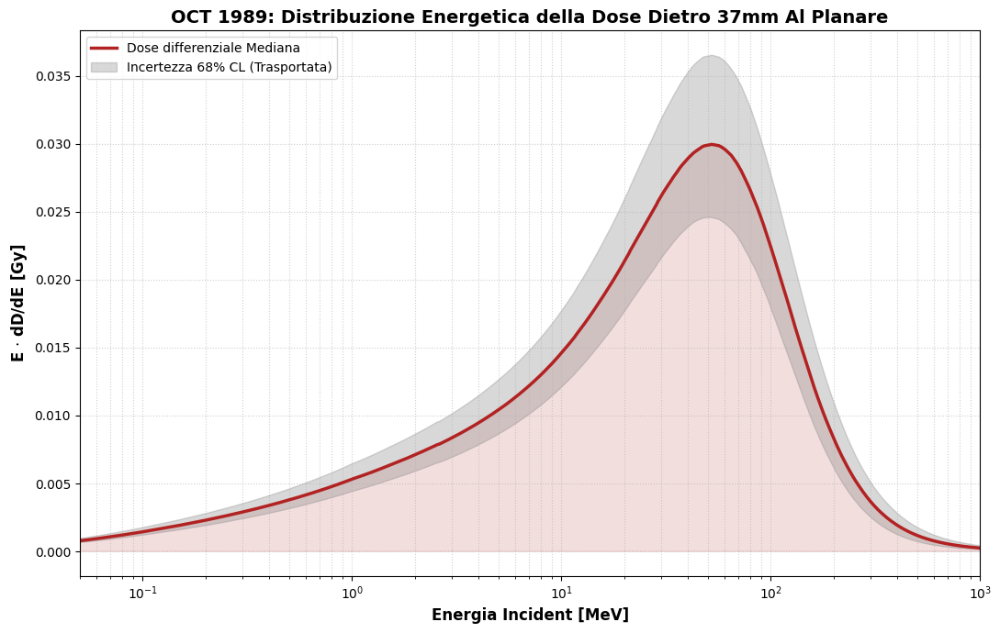

In [12]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "OCT1989_SRNIEL_EXPORT_2026_usaquesto/Planar/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "Median_residual_planar.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "Phi16_residual_planar.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "Phi84_residual_planar.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  OCT 1989 ")
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("OCT 1989: Distribuzione Energetica della Dose Dietro 37mm Al Planare", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.05, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# SPHERICAL

In [13]:
# ESTRAZIOEN BANDE PHI 16 e 84
# estrapolare righe Phi 16 e Phi84
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "OCT1989_SRNIEL_EXPORT_2026_usaquesto/Spherical/OCT89_Sferica_CL68.txt"

# Caricamento del file (saltando l'header)
df_cl = pd.read_csv(path_cl, sep=r"\s+", skiprows=1, names=["E", "Phi_16", "Phi_84"])

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_16 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_84 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
------------------------------
1.000000e+00 1.828864e+10
1.013939e+00 1.821593e+10
1.028073e+00 1.814286e+10
1.042404e+00 1.804805e+10
1.056935e+00 1.797512e+10
1.071668e+00 1.789416e+10
1.086606e+00 1.782297e+10
1.101753e+00 1.772690e+10
1.117111e+00 1.765063e+10
1.132683e+00 1.757780e+10
1.148472e+00 1.745111e+10
1.164481e+00 1.737284e+10
1.180713e+00 1.729451e+10
1.197171e+00 1.719881e+10
1.213859e+00 1.711436e+10
1.230780e+00 1.704008e+10
1.247936e+00 1.696542e+10
1.265332e+00 1.688669e+10
1.282970e+00 1.680975e+10
1.300854e+00 1.670167e+10
1.318987e+00 1.662270e+10
1.337373e+00 1.654652e+10
1.356015e+00 1.646995e+10
1.374917e+00 1.638572e+10
1.394083e+00 1.627508e+10
1.413516e+00 1.618043e+10
1.433219e+00 1.606361e+10
1.453198e+00 1.598901e+10
1.473454e+00 1.590846e+10
1.493993e+00 1.583494e+10
1.514819e+00 1.574590e+10
1.535935e+00 1.562872e+10
1.557345e+00 1.554538e+10
1.579053e+00 1.546163e+10
1.601064

# DOSE sperica
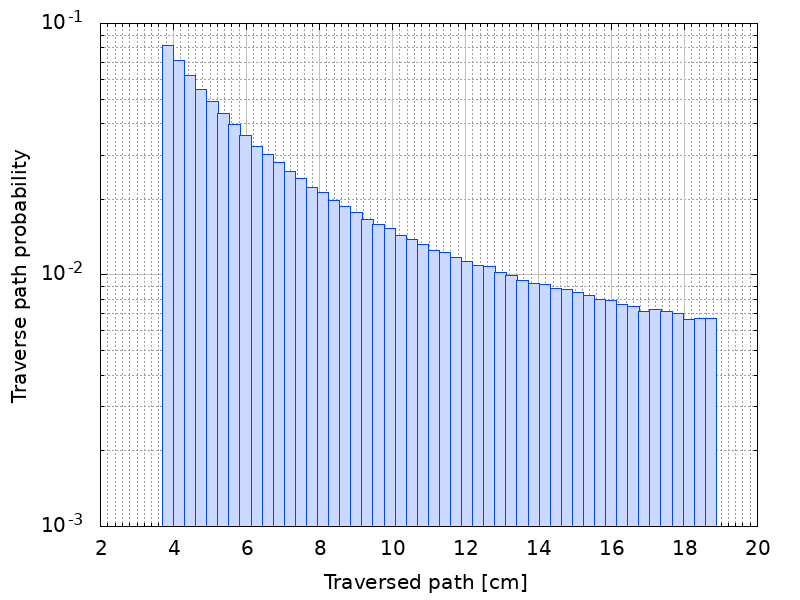
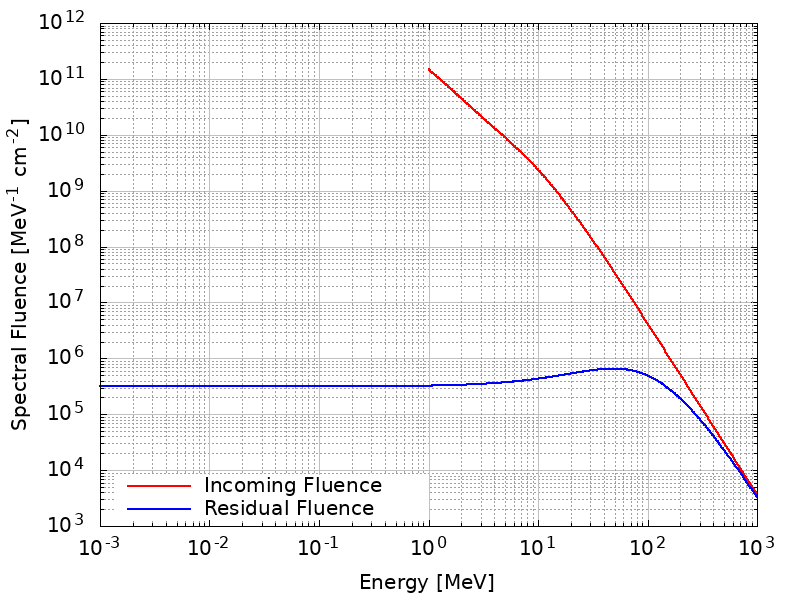

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  OCT 1989 
Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)
Dose Mediana: 181.6008 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [144.402 - 227.323] mGy
Incertezza Totale: +45.722 / -37.199 mGy
-----------------------------------------------------------------


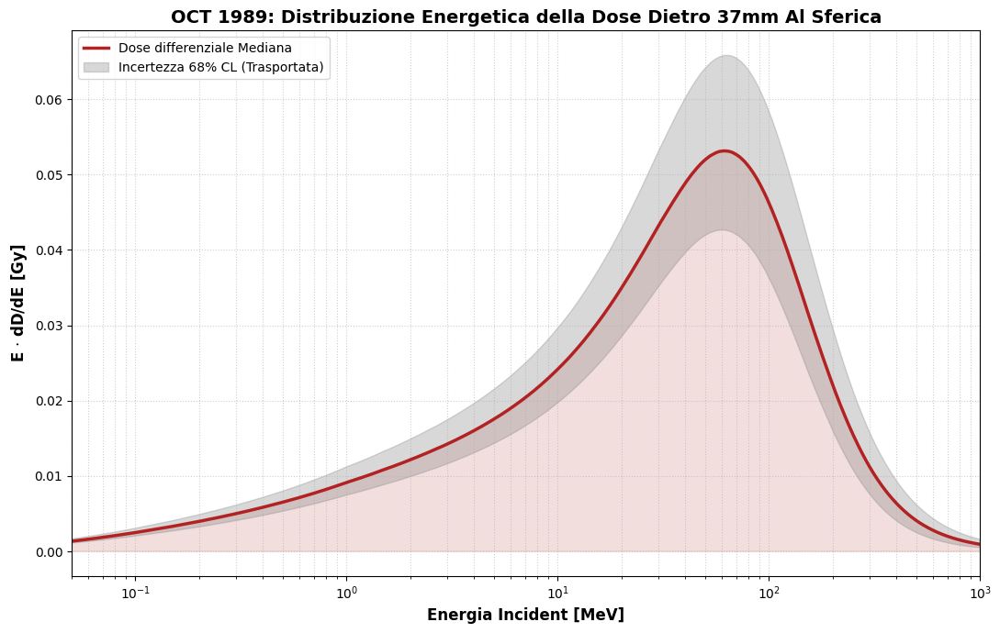

In [14]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "OCT1989_SRNIEL_EXPORT_2026_usaquesto/Spherical/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "median_residual_spherical.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "Phi16_residual_spherical.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "Phi84_residual_spherical.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  OCT 1989 ")
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("OCT 1989: Distribuzione Energetica della Dose Dietro 37mm Al Sferica", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.05, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# confronto letteratura
Nel paper Jiggens 2014 trovano dietro 12mm di Al circa 400mGy il che ha senso se confrontiamo con i nostri 37mm di Al e 181 mGy.


# JAN 2005


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from scipy.optimize import curve_fit

# ============================================================
# 0. PARAMETRI GENERALI
# ============================================================

# File SEPEM GOES
file_goes_eps   = "SEPEM_RDS_v3/SEPEM_RDS_v3-0/RDS3.0_H_EPS_GOES11.txt"
file_goes_hepad = "SEPEM_RDS_v3/SEPEM_RDS_v3-0/RDS3.0_H_HEPAD_GOES11.txt"

# File ACE EPAM (ASCII)
file_ace_epam = "JAN 2005 File/ACE_EPAM_Data (2).txt"

# Intervallo temporale globale
t_start = "2005-01-12 00:00:00"
t_end   = "2005-01-27 00:00:00"

# Intervallo background (tranquillo, comune ACE+GOES)
bg_start = "2005-01-12 00:00:00"
bg_end   = "2005-01-14 00:00:00"

# Eventi definitivi (come da tua scelta)
events = {
    "1° SEP  15/01 07:55 - 15/01 20:25": {
        "start": "2005-01-15 07:55", "end": "2005-01-15 20:25", "color": "royalblue"
    },
    "2° SEP  16/01 02:10 - 19/01 19:00": {
        "start": "2005-01-16 02:10", "end": "2005-01-19 19:00", "color": "forestgreen"
    },
    "3° SEP 20/01 06:40 - 25/01 00:00": {
        "start": "2005-01-20 06:40", "end": "2005-01-25 00:00", "color": "darkorange"
    }
}

# ============================================================
# 1. CARICAMENTO GOES-11 EPS (P2–P7) + HEPAD (P8–P10)
# ============================================================

# EPS
df_eps = pd.read_csv(
    file_goes_eps,
    sep=",",
    skipinitialspace=True,
    index_col="epoch",
    parse_dates=["epoch"]
)
df_eps.columns = df_eps.columns.str.strip()

# HEPAD
df_hepad = pd.read_csv(
    file_goes_hepad,
    sep=",",
    skipinitialspace=True,
    index_col="epoch",
    parse_dates=["epoch"]
)
df_hepad.columns = df_hepad.columns.str.strip()

# Slice sull'intervallo di interesse
df_eps_event   = df_eps.loc[t_start:t_end]
df_hepad_event = df_hepad.loc[t_start:t_end]

# Background (media) su intervallo quieto
bg_eps   = df_eps.loc[bg_start:bg_end].mean()
bg_hepad = df_hepad.loc[bg_start:bg_end].mean()

# Sottrazione background
df_eps_corr   = df_eps_event   - bg_eps
df_hepad_corr = df_hepad_event - bg_hepad

# Valori negativi → NaN
df_eps_corr[df_eps_corr < 0]     = np.nan
df_hepad_corr[df_hepad_corr < 0] = np.nan

# Dataframe totale GOES (EPS + HEPAD)
df_goes = pd.concat([df_eps_corr, df_hepad_corr], axis=1).sort_index()

# ============================================================
# 2. CARICAMENTO ACE EPAM (LEMS120) DAL FILE ASCII
# ============================================================

def load_ace_epam_lems120(path):
    """
    Carica il file ACE/EPAM LEMS120 con header 'year day hr min sec ... P1p ... P8p'
    e restituisce un DataFrame indicizzato da 'epoch'.
    """
    header_cols = []
    start_row = 0

    with open(path, "r") as f:
        lines = f.readlines()

    for i, line in enumerate(lines):
        # riga con i nomi delle colonne
        if line.strip().startswith("year") and "P1p" in line:
            header_cols = line.strip().split()
        if "BEGIN DATA" in line:
            start_row = i + 1
            break

    if not header_cols:
        raise RuntimeError("Header ACE non trovato (riga con 'year day hr min sec ... P1p').")

    # Lettura effettiva
    df = pd.read_csv(
        path,
        sep=r"\s+",
        names=header_cols,
        skiprows=start_row,
        index_col=False
    )

    # Costruzione colonna epoch da year, day-of-year, hr, min, sec
    time_str = (
        df["year"].astype(int).astype(str) + " " +
        df["day"].astype(int).astype(str)  + " " +
        df["hr"].astype(int).astype(str)   + " " +
        df["min"].astype(int).astype(str)  + " " +
        df["sec"].astype(int).astype(str)
    )
    df["epoch"] = pd.to_datetime(time_str, format="%Y %j %H %M %S")
    df.set_index("epoch", inplace=True)

    # Pulizia valori negativi → NaN
    cols_flux = [c for c in df.columns if c.endswith("p")]
    df[cols_flux] = df[cols_flux].where(df[cols_flux] >= 0, np.nan)

    return df

df_ace_raw = load_ace_epam_lems120(file_ace_epam)

# Slice temporale e background
df_ace_event = df_ace_raw.loc[t_start:t_end]
bg_ace = df_ace_raw.loc[bg_start:bg_end].mean()

# Sottrazione background
df_ace_corr = df_ace_event - bg_ace
df_ace_corr[df_ace_corr <= 0] = np.nan

# ============================================================
# 3. DEFINIZIONE CANALI & ENERGIE
# ============================================================

# GOES SEPEM: bordi canali (MeV) e energie efficaci (SEPCALIB)
goes_bins = {
    "P2":  (4.0, 9.0),
    "P3":  (9.0, 15.0),
    "P4":  (15.0, 40.0),
    "P5":  (40.0, 80.0),
    "P6":  (80.0, 165.0),
    "P7":  (165.0, 500.0),
    "P8":  (350.0, 420.0),
    "P9":  (420.0, 510.0),
    "P10": (510.0, 700.0),
}

goes_eff = {
    "P2":  6.643,
    "P3":  12.61,
    "P4":  20.55,
    "P5":  46.62,
    "P6":  103.7,
    "P7":  154.6,
    "P8":  406.0,
    "P9":  457.0,
    "P10": 583.0,
}

# ACE LEMS120: bordi canali (MeV) e energie efficaci (geom. mean)
ace_bins = {
    "P1p": (0.047, 0.068),
    "P2p": (0.068, 0.115),
    "P3p": (0.115, 0.195),
    "P4p": (0.195, 0.321),
    "P5p": (0.321, 0.580),
    "P6p": (0.580, 1.060),
    "P7p": (1.060, 1.900),
    "P8p": (1.900, 4.800),
}
ace_eff = {ch: np.sqrt(lo * hi) for ch, (lo, hi) in ace_bins.items()}

# ============================================================
# 4. FUNZIONI SPETTRALI E FIT IN LOG-SPACE
# ============================================================

def ellison_ramaty(E, A, gamma, Er):
    return A * E**(-gamma) * np.exp(-E / Er)

def band_function(E, A, ga, gb, E0):
    # break energy
    if gb <= ga:
        return np.zeros_like(E) + 1e-40
    E_break = (gb - ga) * E0
    if E_break <= 0:
        return np.zeros_like(E) + 1e-40

    res = np.zeros_like(E)
    mask = E < E_break

    res[mask] = A * (E[mask] ** -ga) * np.exp(-E[mask] / E0)
    norm = (E_break ** (gb - ga)) * np.exp(ga - gb)
    res[~mask] = A * (E[~mask] ** -gb) * norm

    return res

def combined_function(E, A, ga, gb, E0, Er):
    return band_function(E, A, ga, gb, E0) * np.exp(-E / Er)

def fit_log_space(func, x, y, y_err, p0, bounds):
    # fittiamo log10(fluenza) per pesare bene l'intervallo dinamico
    def log_func(E, *params):
        val = func(E, *params)
        val = np.where(val > 0, val, 1e-40)
        return np.log10(val)

    y_pos = np.where(y > 0, y, 1e-40)
    sigma_log = (y_err / y_pos) / np.log(10)
    sigma_log = np.where(np.isfinite(sigma_log) & (sigma_log > 0), sigma_log, 1.0)

    try:
        popt, pcov = curve_fit(
            log_func,
            x,
            np.log10(y_pos),
            p0=p0,
            bounds=bounds,
            sigma=sigma_log,
            absolute_sigma=True,
            maxfev=20000,
        )
        return popt, pcov
    except Exception:
        return None, None

def get_stats_text(model_name, func, x, y, y_err, popt, pcov):
    if popt is None:
        return f"{model_name}: fit failed"

    y_model = func(x, *popt)
    y_model = np.where(y_model > 0, y_model, 1e-40)
    res = (y - y_model) / y_err
    res = np.where(np.isfinite(res), res, 0.0)
    chi2 = np.sum(res**2)
    dof = max(len(y) - len(popt), 1)
    chi2_red = chi2 / dof

    if pcov is None or np.ndim(pcov) != 2:
        perr = [0.0] * len(popt)
    else:
        perr = np.sqrt(np.diag(pcov))

    txt = rf"$\bf{{{model_name}}}$ ($\chi^2_\nu={chi2_red:.1f}$)" + "\n"

    if model_name == "Ellison-Ramaty":
        txt += rf"$\gamma$: {popt[1]:.2f} $\pm$ {perr[1]:.2f}" + "\n"
        txt += rf"$E_r$: {popt[2]:.0f} $\pm$ {perr[2]:.0f} MeV"
    elif model_name == "Band":
        txt += rf"$\gamma_a$: {popt[1]:.2f} $\pm$ {perr[1]:.2f}" + "\n"
        txt += rf"$\gamma_b$: {popt[2]:.2f} $\pm$ {perr[2]:.2f}" + "\n"
        txt += rf"$E_0$: {popt[3]:.1f} $\pm$ {perr[3]:.1f} MeV"
    elif model_name == "Combined":
        if popt[4] > 4000:
            txt += "Cutoff: Power Law Limit"
        else:
            txt += rf"$E_{{cut}}$: {popt[4]:.0f} $\pm$ {perr[4]:.0f} MeV"

    return txt

# ============================================================
# 5. CALCOLO FLUENZE: ACE + GOES, EVENTO PER EVENTO
# ============================================================

results = {}

print("--- Calcolo fluenze (ACE + GOES) ---")

for name, pars in events.items():
    t0 = pars["start"]
    t1 = pars["end"]

    # Slice temporale
    df_g = df_goes.loc[t0:t1]
    df_a = df_ace_corr.loc[t0:t1]

    # dt (5 min nominali) calcolato dai time-step reali
    dt_g = df_g.index.to_series().diff().dt.total_seconds().fillna(300.0)
    dt_a = df_a.index.to_series().diff().dt.total_seconds().fillna(300.0)

    fluences = []
    energies = []
    xerr_low = []
    xerr_high = []

    # ---- ACE (low energy) ----
    for ch, (Emin, Emax) in ace_bins.items():
        if ch not in df_a.columns:
            continue
        flux = df_a[ch].fillna(0).clip(lower=0)
        flu = (flux * dt_a).sum()
        if flu <= 0:
            continue
        Eeff = ace_eff[ch]
        fluences.append(flu)
        energies.append(Eeff)
        xerr_low.append(Eeff - Emin)
        xerr_high.append(Emax - Eeff)

    # ---- GOES (mid + high energy) ----
    for ch, (Emin, Emax) in goes_bins.items():
        if ch not in df_g.columns:
            continue
        flux = df_g[ch].fillna(0).clip(lower=0)
        flu = (flux * dt_g).sum()
        if flu <= 0:
            continue
        Eeff = goes_eff[ch]
        fluences.append(flu)
        energies.append(Eeff)
        xerr_low.append(Eeff - Emin)
        xerr_high.append(Emax - Eeff)

    # Convertiamo in array e ordiniamo per energia (ACE→GOES continui)  ===> OPZIONE B
    energies = np.array(energies)
    fluences = np.array(fluences)
    xerr_low = np.array(xerr_low)
    xerr_high = np.array(xerr_high)

    sort_idx = np.argsort(energies)
    energies = energies[sort_idx]
    fluences = fluences[sort_idx]
    xerr_low = xerr_low[sort_idx]
    xerr_high = xerr_high[sort_idx]

    results[name] = {
        "x": energies,
        "y": fluences,
        "x_err": [xerr_low, xerr_high],
        "color": pars["color"],
    }

    print(f"{name}: {len(energies)} punti (ACE+GOES)")

# ============================================================
# 6. FIT E PLOT FINALE (3 PANNELLI, COME NELLA TUA FIGURA)
# ============================================================

combined_fit_params = {}
band_fit_params = {}


x_plot = np.logspace(np.log10(0.04), np.log10(1000.0), 800)

fig, axes = plt.subplots(1, 3, figsize=(24, 8), sharey=True)
axes = axes.flatten()

for i, (name, data) in enumerate(results.items()):
    ax = axes[i]
    x = data["x"]
    y = data["y"]
    dx_low, dx_high = data["x_err"]
    color_evt = data["color"]

    # errore verticale ~30% sistematico
    y_err = y * 0.30

    # xerr positivo
    xerr = [np.abs(dx_low), np.abs(dx_high)]

    # Dati (ACE+GOES)
    ax.errorbar(
        x,
        y,
        yerr=y_err,
        xerr=xerr,
        fmt="o",
        color="black",
        ecolor="black",
        capsize=3,
        elinewidth=1.2,
        markersize=5,
        label="Data (ACE+GOES)",
        zorder=10,
    )

    stats_box = ""

    # ---------- Ellison-Ramaty ----------
    p0_er = [1e8, 2.0, 150.0]
    bounds_er = ([0, 0.1, 10.0], [np.inf, 10.0, 5000.0])
    popt_er, pcov_er = fit_log_space(ellison_ramaty, x, y, y_err, p0_er, bounds_er)
    if popt_er is not None:
        ax.plot(
            x_plot,
            ellison_ramaty(x_plot, *popt_er),
            "--",
            color="cornflowerblue",
            linewidth=2,
            label="Ellison-Ramaty",
        )
        stats_box += get_stats_text(
            "Ellison-Ramaty", ellison_ramaty, x, y, y_err, popt_er, pcov_er
        ) + "\n\n"

    # ---------- Band ----------
    p0_b = [1e7, 1.0, 3.0, 15.0]
    bounds_b = ([0, 0.1, 0.5, 1.0], [np.inf, 6.0, 10.0, 500.0])
    popt_b, pcov_b = fit_log_space(band_function, x, y, y_err, p0_b, bounds_b)
    if popt_b is not None:
        ax.plot(
            x_plot,
            band_function(x_plot, *popt_b),
            "-.",
            color="mediumseagreen",
            linewidth=2,
            label="Band",
        )
            # >>> SALVATAGGIO PARAMETRI BAND <<<
        band_fit_params[name] = popt_b

        stats_box += get_stats_text(
            "Band", band_function, x, y, y_err, popt_b, pcov_b
        ) + "\n\n"

    # ---------- Combined ----------
    popt_c, pcov_c = (None, None)
    if popt_b is not None:
        p0_c = [popt_b[0], popt_b[1], popt_b[2], popt_b[3], 500.0]
        bounds_c = ([0, 0.1, 0.5, 1.0, 50.0], [np.inf, 6.0, 10.0, 500.0, 5000.0])
        popt_c, pcov_c = fit_log_space(combined_function, x, y, y_err, p0_c, bounds_c)

        if popt_c is not None:
            ax.plot(
                x_plot,
                combined_function(x_plot, *popt_c),
                "-",
                color="firebrick",
                linewidth=2.5,
                label="Combined",
            )

                # >>> SALVATAGGIO PARAMETRI COMBINED <<<
            combined_fit_params[name] = popt_c

            stats_box += get_stats_text(
                "Combined", combined_function, x, y, y_err, popt_c, pcov_c
            )

    # ---------- STYLING ----------
    ax.set_title(name, fontsize=14, color=color_evt, fontweight="bold")
    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlim(0.04, 1000)
    ax.set_ylim(1e-2, 1e12)

    ax.grid(True, which="major", alpha=0.5)
    ax.grid(True, which="minor", alpha=0.2, linestyle=":")

    ax.set_xlabel("Energy (MeV)", fontsize=12)
    if i == 0:
        ax.set_ylabel(r"Fluence [p cm$^{-2}$ sr$^{-1}$ MeV$^{-1}$]", fontsize=12)
        ax.legend(loc="upper right", fontsize=10, framealpha=0.95)

    ax.text(
        0.03,
        0.03,
        stats_box,
        transform=ax.transAxes,
        fontsize=8,
        verticalalignment="bottom",
        bbox=dict(boxstyle="round", facecolor="white", alpha=0.92, edgecolor="gray"),
    )

plt.suptitle(
    "Full Spectrum Analysis: ACE (Low E) + GOES (High E) - Jan 2005", 
    fontsize=18,
    y=0.98,
)
plt.tight_layout(rect=[0, 0.0, 1, 0.95])
plt.show()


KeyboardInterrupt: 

# CARICAMENTO DATI GOES 

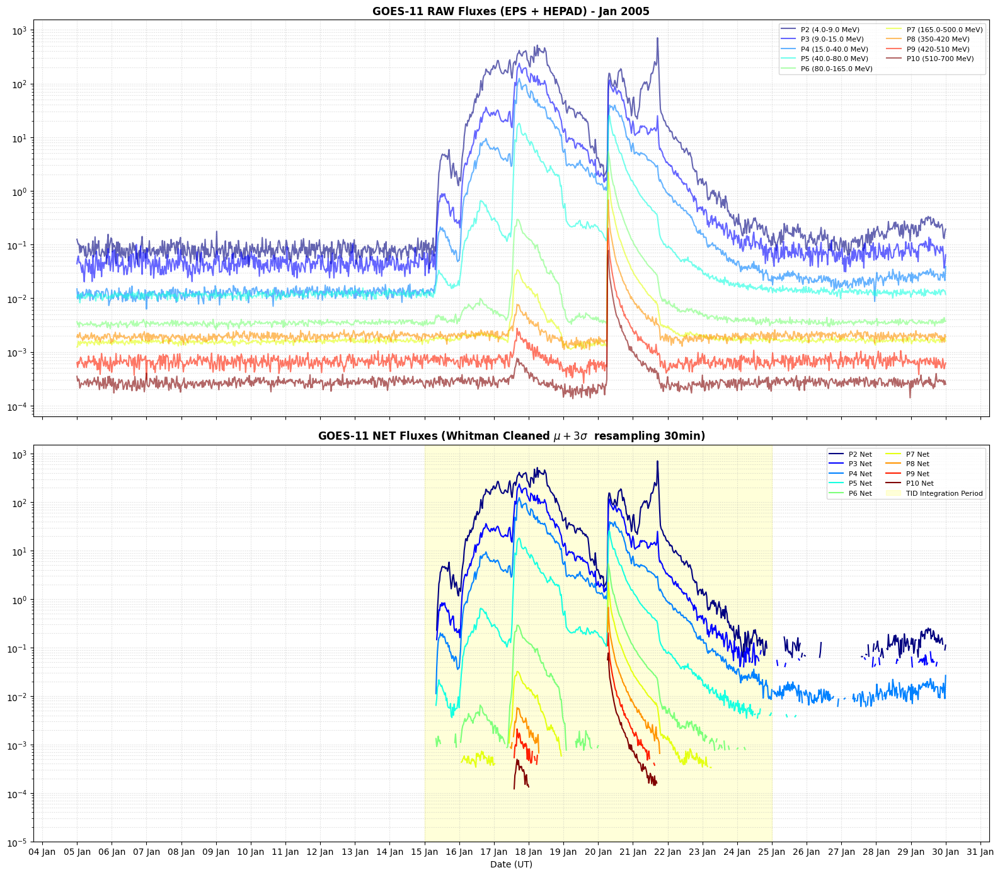

------------------------------
SOGLIE WHITMAN (EPS+HEPAD):
P2: 1.43e-01
P3: 8.49e-02
P4: 1.85e-02
P5: 1.50e-02
P6: 4.17e-03
P7: 1.86e-03
P8: 2.56e-03
P9: 1.02e-03
P10: 3.80e-04


In [31]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

# ==========================================
# 1. CARICAMENTO DATI (EPS + HEPAD)
# ==========================================
file_path_eps = "SEPEM_RDS_v3/SEPEM_RDS_v3-0/RDS3.0_H_EPS_GOES11.txt"
file_path_hepad = "SEPEM_RDS_v3/SEPEM_RDS_v3-0/RDS3.0_H_HEPAD_GOES11.txt"

df_eps = pd.read_csv(file_path_eps, sep=',', skipinitialspace=True, index_col='epoch', parse_dates=['epoch'])
df_hepad = pd.read_csv(file_path_hepad, sep=',', skipinitialspace=True, index_col='epoch', parse_dates=['epoch'])
df_eps.columns = df_eps.columns.str.strip()
df_hepad.columns = df_hepad.columns.str.strip()

# ==========================================
# 2. PARAMETRI E INTERVALLI
# ==========================================
t_start, t_end = '2005-01-05 00:00:00', '2005-01-30 00:00:00'
bg_start, bg_end = '2005-01-05 00:00:00', '2005-01-14 00:00:00'
t_integ_start, t_integ_end = '2005-01-15 00:00:00', '2005-01-25 00:00:00'

energy_labels = {
    'P2': '4.0-9.0 MeV', 'P3': '9.0-15.0 MeV', 'P4': '15.0-40.0 MeV',
    'P5': '40.0-80.0 MeV', 'P6': '80.0-165.0 MeV', 'P7': '165.0-500.0 MeV',
    'P8': '350-420 MeV', 'P9': '420-510 MeV', 'P10': '510-700 MeV'
}

# ==========================================
# 3. PULIZIA WHITMAN UNIFICATA
# ==========================================
df_total_raw = pd.concat([df_eps.loc[t_start:t_end], df_hepad.loc[t_start:t_end]], axis=1).sort_index()


#resampling a 30 min
df_total_raw = df_total_raw.resample('30min').mean()


bg_period = df_total_raw.loc[bg_start:bg_end]
mu = bg_period.mean()
sigma = bg_period.std()
threshold = mu + 3 * sigma

df_total_corrected = df_total_raw.copy()
for col in energy_labels.keys():
    if col in df_total_raw.columns:
        df_total_corrected[col] = df_total_raw[col] - mu[col]
        df_total_corrected.loc[df_total_raw[col] < threshold[col], col] = np.nan

# ==========================================
# 4. PLOT DI CONFRONTO FINALE
# ==========================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 14), sharex=True)
colors_map = plt.cm.jet(np.linspace(0, 1, len(energy_labels)))

# PLOT 1: RAW
for i, col in enumerate(energy_labels.keys()):
    if col in df_total_raw.columns:
        ax1.plot(df_total_raw.index, df_total_raw[col], label=f"{col} ({energy_labels[col]})", color=colors_map[i], alpha=0.6)
ax1.set_yscale('log')
ax1.set_title('GOES-11 RAW Fluxes (EPS + HEPAD) - Jan 2005', fontweight='bold')
ax1.grid(True, which="both", ls=':', alpha=0.5)

# PLOT 2: NET + INTEGRATION WINDOW
for i, col in enumerate(energy_labels.keys()):
    if col in df_total_corrected.columns:
        ax2.plot(df_total_corrected.index, df_total_corrected[col], label=f"{col} Net", color=colors_map[i], linewidth=1.5)

ax2.axvspan(pd.to_datetime(t_integ_start), pd.to_datetime(t_integ_end), color='yellow', alpha=0.15, label='TID Integration Period')
ax2.set_yscale('log')
ax2.set_ylim(bottom=1e-5)
ax2.set_title(r'GOES-11 NET Fluxes (Whitman Cleaned $\mu+3\sigma$  resampling 30min)', fontweight='bold')
ax2.set_xlabel('Date (UT)')
ax2.grid(True, which="both", ls=':', alpha=0.5)

ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
ax1.legend(loc='upper right', fontsize=8, ncol=2)
ax2.legend(loc='upper right', fontsize=8, ncol=2)

plt.tight_layout()
plt.show()

# Verifica soglie
print("-" * 30)
print("SOGLIE WHITMAN (EPS+HEPAD):")
for col in energy_labels.keys():
    if col in threshold.index:
        print(f"{col}: {threshold[col]:.2e}")

# CALCOLO FLUENZA GOES 

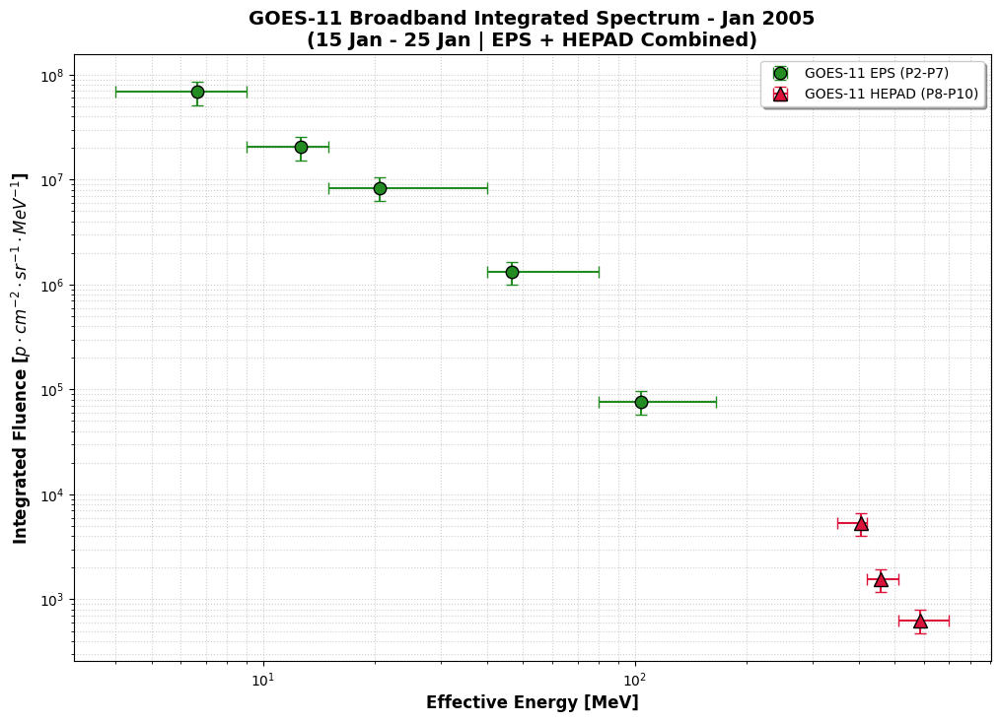

-------------------------------------------------------
Channel  | Instrument | E_eff    | Fluence     
-------------------------------------------------------
P2       | EPS        | 6.64     | 6.84e+07    
P3       | EPS        | 12.61    | 2.04e+07    
P4       | EPS        | 20.55    | 8.35e+06    
P5       | EPS        | 46.62    | 1.33e+06    
P6       | EPS        | 103.70   | 7.67e+04    
P8       | HEPAD      | 406.00   | 5.33e+03    
P9       | HEPAD      | 457.00   | 1.55e+03    
P10      | HEPAD      | 583.00   | 6.33e+02    


In [2]:
# =================================================================
# CALCOLO E PLOT FLUENZA INTEGRATA DEFINITIVO (EPS + HEPAD)
# Intervallo: 15/01/2005 00:00 - 25/01/2005 00:00
# =================================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# 1. Energie Efficaci (SEPEM Calib) e Bin Nominali
e_eff_map = {
    'P2': 6.643, 'P3': 12.61, 'P4': 20.55, 
    'P5': 46.62, 
    'P6': 103.7, 
    #'P7': 154.6,
    'P8': 406.0, 'P9': 457.0, 'P10': 583.0
}

goes_bins_list = {
    'P2': (4.0, 9.0), 'P3': (9.0, 15.0), 'P4': (15.0, 40.0), 'P5': (40.0, 80.0),
    'P6': (80.0, 165.0), 
    #'P7': (165.0, 500.0), 
    'P8': (350.0, 420.0), 
    'P9': (420.0, 510.0), 'P10': (510.0, 700.0)
}

# 2. Parametro di integrazione (300 secondi per GOES-11 RDS 3.0)
delta_t = 1800

fluence_goes_data = []

# Taglio temporale dell'evento unico
t_inv_start, t_inv_end = '2005-01-15 00:00:00', '2005-01-25 00:00:00'
df_event_goes = df_total_corrected.loc[t_inv_start:t_inv_end]

for col, e_eff in e_eff_map.items():
    if col in df_event_goes.columns:
        # Integrazione: somma i flussi netti (fillna(0) per i momenti sotto soglia)
        f_val = df_event_goes[col].fillna(0).sum() * delta_t
        
        if f_val > 0:
            e_min, e_max = goes_bins_list[col]
            
            # --- CORREZIONE BARRE D'ERRORE (x_err) ---
            # Se e_eff è fuori dal bin nominale (come in P7), usiamo abs()
            # per evitare ValueError in matplotlib.
            x_err_low = abs(e_eff - e_min)
            x_err_high = abs(e_max - e_eff)
            
            # --- CALCOLO ERRORI (y_err) ---
            # 25% errore sistematico (calibrazione) + Poissoniano (statistico)
            y_err_val = np.sqrt((0.25 * f_val)**2 + f_val)
            
            fluence_goes_data.append({
                'Channel': col,
                'E_eff': e_eff,
                'Fluence': f_val,
                'y_err': y_err_val,
                'x_err_low': x_err_low,
                'x_err_high': x_err_high,
                'Instrument': 'EPS' if int(col[1:]) < 8 else 'HEPAD'
            })

# Creazione DataFrame finale
df_fluence_goes = pd.DataFrame(fluence_goes_data).sort_values('E_eff')

# ==========================================
# 3. PLOT DELLO SPETTRO (EPS vs HEPAD)
# ==========================================
plt.figure(figsize=(12, 8))

# Filtriamo per evidenziare i due diversi strumenti
df_eps = df_fluence_goes[df_fluence_goes['Instrument'] == 'EPS']
df_hepad = df_fluence_goes[df_fluence_goes['Instrument'] == 'HEPAD']

# Plot EPS (P2-P7)
plt.errorbar(df_eps['E_eff'], df_eps['Fluence'], 
             yerr=df_eps['y_err'], xerr=[df_eps['x_err_low'], df_eps['x_err_high']],
             fmt='o', color= "forestgreen",markersize=9, capsize=4, elinewidth=1.5, 
             markeredgecolor='black', label='GOES-11 EPS (P2-P7)')

# Plot HEPAD (P8-P10)
plt.errorbar(df_hepad['E_eff'], df_hepad['Fluence'], 
             yerr=df_hepad['y_err'], xerr=[df_hepad['x_err_low'], df_hepad['x_err_high']],
             fmt='^',color= "crimson", markersize=10, capsize=4, elinewidth=1.5, 
             markeredgecolor='black', label='GOES-11 HEPAD (P8-P10)')

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.6)

plt.xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=12)
plt.ylabel(r"Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]", fontweight='bold', fontsize=12)
plt.title("GOES-11 Broadband Integrated Spectrum - Jan 2005\n(15 Jan - 25 Jan | EPS + HEPAD Combined)", fontsize=14, fontweight='bold')

plt.legend(loc='upper right', shadow=True)
plt.show()

# Tabella di verifica stampata
print("-" * 55)
print(f"{'Channel':<8} | {'Instrument':<10} | {'E_eff':<8} | {'Fluence':<12}")
print("-" * 55)
for _, row in df_fluence_goes.iterrows():
    print(f"{row['Channel']:<8} | {row['Instrument']:<10} | {row['E_eff']:<8.2f} | {row['Fluence']:<12.2e}")

# ACE data

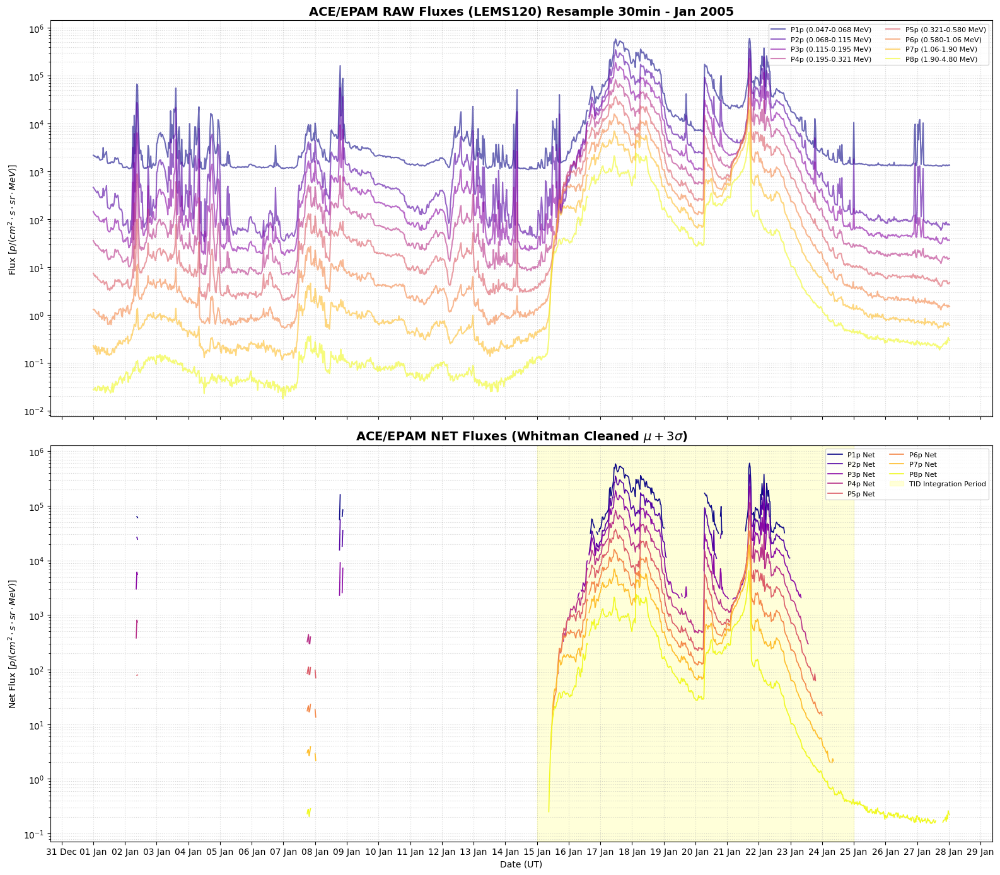

--------------------------------------------------
CHANNEL  | MU         | THRESHOLD (μ+3σ)
--------------------------------------------------
P1p      | 3.56e+03 | 3.36e+04
P2p      | 9.80e+02 | 1.15e+04
P3p      | 2.85e+02 | 2.24e+03
P4p      | 7.39e+01 | 3.62e+02
P5p      | 1.85e+01 | 8.16e+01
P6p      | 3.86e+00 | 1.63e+01
P7p      | 6.71e-01 | 2.66e+00
P8p      | 7.36e-02 | 2.27e-01


In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

# ==========================================
# 1. FUNZIONE CARICAMENTO DATI ACE
# ==========================================
def load_ace_epam_fixed(file_path):
    header_cols = []
    start_row = 0
    with open(file_path, 'r') as f:
        lines = f.readlines()
    for i, line in enumerate(lines):
        if line.strip().startswith("year") and "P1p" in line:
            header_cols = line.strip().split()
        if "BEGIN DATA" in line:
            start_row = i + 1
            break
    if not header_cols: return None

    df = pd.read_csv(file_path, sep=r'\s+', names=header_cols, skiprows=start_row, index_col=False)
    
    # Conversione Tempo (Year + Day of Year)
    time_str = df['year'].astype(str) + ' ' + df['day'].astype(str) + ' ' + \
               df['hr'].astype(str) + ' ' + df['min'].astype(str) + ' ' + \
               df['sec'].astype(int).astype(str)
    
    df['epoch'] = pd.to_datetime(time_str, format='%Y %j %H %M %S')
    df.set_index('epoch', inplace=True)
    
    # Pulizia preliminare (valori negativi strumentali)
    cols_to_clean = [c for c in df.columns if 'P' in c]
    df[cols_to_clean] = df[cols_to_clean].apply(lambda x: pd.to_numeric(x, errors='coerce'))
    df[cols_to_clean] = df[cols_to_clean].mask(df[cols_to_clean] < 0)
    return df

# ==========================================
# 2. PARAMETRI E INTERVALLI (IDENTICI A GOES)
# ==========================================
file_path_ace = "JAN 2005 File/ACE_EPAM_Data (2).txt"
t_start, t_end = '2005-01-01 00:00:00', '2005-01-30 00:00:00'
bg_start, bg_end = '2005-01-05 00:00:00', '2005-01-14 00:00:00'
t_integ_start, t_integ_end = '2005-01-15 00:00:00', '2005-01-25 00:00:00'

ace_labels = {
    'P1p': '0.047-0.068 MeV', 
    'P2p': '0.068-0.115 MeV',
    'P3p': '0.115-0.195 MeV', 'P4p': '0.195-0.321 MeV',
    'P5p': '0.321-0.580 MeV', 'P6p': '0.580-1.06 MeV',
    'P7p': '1.06-1.90 MeV',   'P8p': '1.90-4.80 MeV'
}

# ==========================================
# 3. CARICAMENTO E PULIZIA WHITMAN ACE
# ==========================================
df_ace = load_ace_epam_fixed(file_path_ace)
df_ace_raw = df_ace.loc[t_start:t_end]

df_ace_raw = df_ace_raw.resample('30min').mean()

# Calcolo parametri background (Whitman)
bg_period_ace = df_ace_raw.loc[bg_start:bg_end]
mu_ace = bg_period_ace[list(ace_labels.keys())].mean()
sigma_ace = bg_period_ace[list(ace_labels.keys())].std()
threshold_ace = mu_ace + 3 * sigma_ace

df_ace_corrected = df_ace_raw.copy()

for col in ace_labels.keys():
    # Sottrazione background medio
    df_ace_corrected[col] = df_ace_raw[col] - mu_ace[col]
    # Mascheramento Whitman (Originale < mu + 3sigma -> NaN)
    df_ace_corrected.loc[df_ace_raw[col] < threshold_ace[col], col] = np.nan

# ==========================================
# 4. PLOT DI CONFRONTO FINALE ACE
# ==========================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 14), sharex=True)
colors_ace = plt.cm.plasma(np.linspace(0, 1, len(ace_labels)))

# PLOT 1: RAW
for i, (col, label) in enumerate(ace_labels.items()):
    ax1.plot(df_ace_raw.index, df_ace_raw[col], label=f"{col} ({label})", color=colors_ace[i], alpha=0.6)
ax1.set_yscale('log')
ax1.set_title('ACE/EPAM RAW Fluxes (LEMS120) Resample 30min - Jan 2005', fontweight='bold', fontsize=14)
ax1.set_ylabel(r'Flux [$p / (cm^2 \cdot s \cdot sr \cdot MeV)$]')
ax1.grid(True, which="both", ls=':', alpha=0.5)

# PLOT 2: NET + INTEGRATION WINDOW
for i, (col, label) in enumerate(ace_labels.items()):
    ax2.plot(df_ace_corrected.index, df_ace_corrected[col], label=f"{col} Net", color=colors_ace[i], linewidth=1.2)

ax2.axvspan(pd.to_datetime(t_integ_start), pd.to_datetime(t_integ_end), color='yellow', alpha=0.15, label='TID Integration Period')
ax2.set_yscale('log')
ax2.set_title(r'ACE/EPAM NET Fluxes (Whitman Cleaned $\mu+3\sigma$)', fontweight='bold', fontsize=14)
ax2.set_ylabel(r'Net Flux [$p / (cm^2 \cdot s \cdot sr \cdot MeV)$]')
ax2.set_xlabel('Date (UT)')
ax2.grid(True, which="both", ls=':', alpha=0.5)

# Formattazione
ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
ax1.legend(loc='upper right', fontsize=8, ncol=2)
ax2.legend(loc='upper right', fontsize=8, ncol=2)

plt.tight_layout()
plt.show()

# Verifica soglie ACE
print("-" * 50)
print(f"{'CHANNEL':<8} | {'MU':<10} | {'THRESHOLD (μ+3σ)':<15}")
print("-" * 50)
for col in ace_labels.keys():
    if col in threshold_ace.index:
        print(f"{col:<8} | {mu_ace[col]:.2e} | {threshold_ace[col]:.2e}")

# CALCOLO FLUENZA ACE 

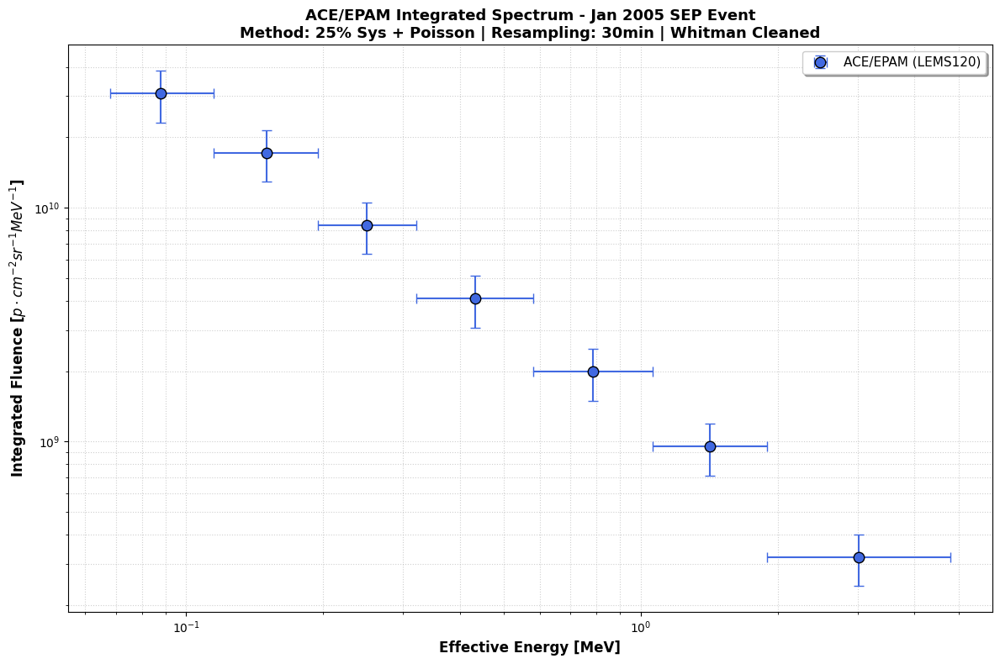

----------------------------------------------------------------------
Channel  | E_eff    | Fluence      | y_err % 
----------------------------------------------------------------------
P2p      | 0.088    | 3.09e+10     | 25.0    %
P3p      | 0.150    | 1.72e+10     | 25.0    %
P4p      | 0.250    | 8.44e+09     | 25.0    %
P5p      | 0.432    | 4.09e+09     | 25.0    %
P6p      | 0.784    | 2.00e+09     | 25.0    %
P7p      | 1.419    | 9.52e+08     | 25.0    %
P8p      | 3.020    | 3.21e+08     | 25.0    %

Integration window: 2005-01-15 00:00:00 to 2005-01-25 00:00:00
Delta_t: 1800s (30min resampling)
Number of data points: 481
Expected: ~480 points (10 days × 48 points/day)


In [4]:
# =================================================================
# CALCOLO FLUENZA INTEGRATA - ACE/EPAM (LEMS120)
# Intervallo: 15/01 00:00 - 25/01 00:00 | Jan 2005
# =================================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# 1. Energie Efficaci (EPAM Calibration - NON geometric mean!)
# Questi valori provengono dalla calibrazione ufficiale ACE/EPAM
ace_eff_map = {
    # 'P1p': 0.057,  # Escluso: troppo rumoroso
    'P2p': 0.088,
    'P3p': 0.150,
    'P4p': 0.250,
    'P5p': 0.432,
    'P6p': 0.784,
    'P7p': 1.419,
    'P8p': 3.020
}

# Bin energetici nominali
ace_bins_map = {
    # 'P1p': (0.047, 0.068),
    'P2p': (0.068, 0.115),
    'P3p': (0.115, 0.195),
    'P4p': (0.195, 0.321),
    'P5p': (0.321, 0.580),
    'P6p': (0.580, 1.060),
    'P7p': (1.060, 1.900),
    'P8p': (1.900, 4.800)
}

# 2. Parametro di integrazione
# ⭐ FISSO A 1800s (coerente con resampling 30min e con GOES) ⭐
delta_t_ace = 1800  

fluence_ace_data = []

# Taglio temporale (15-25 Gennaio)
t_inv_start, t_inv_end = '2005-01-15 00:00:00', '2005-01-25 00:00:00'
df_event_ace = df_ace_corrected.loc[t_inv_start:t_inv_end]

for col, e_eff in ace_eff_map.items():
    if col in df_event_ace.columns:
        # Integrazione: Somma(Flusso * delta_t)
        f_val = df_event_ace[col].fillna(0).sum() * delta_t_ace
        
        if f_val > 0:
            e_min, e_max = ace_bins_map[col]
            
            # Distanze dai bin
            x_err_low = abs(e_eff - e_min)
            x_err_high = abs(e_max - e_eff)
            
            # Errore: 25% Sistematico + Poissoniano
            y_err_val = np.sqrt((0.25 * f_val)**2 + f_val)
            
            fluence_ace_data.append({
                'Channel': col,
                'E_eff': e_eff,
                'Fluence': f_val,
                'y_err': y_err_val,
                'x_err_low': x_err_low,
                'x_err_high': x_err_high,
                'Instrument': 'ACE/EPAM'
            })

# 3. Creazione DataFrame
df_fluence_ace = pd.DataFrame(fluence_ace_data).sort_values('E_eff')

# ==========================================
# 4. PLOT DELLO SPETTRO INTEGRATO ACE
# ==========================================
plt.figure(figsize=(12, 8))

plt.errorbar(df_fluence_ace['E_eff'], df_fluence_ace['Fluence'], 
             yerr=df_fluence_ace['y_err'], 
             xerr=[df_fluence_ace['x_err_low'], df_fluence_ace['x_err_high']],
             fmt='o', color='royalblue', markersize=9,  # ⬅️ Blu come OCT2003
             capsize=4, elinewidth=1.5, 
             markeredgecolor='black',
             label='ACE/EPAM (LEMS120)')

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.6)

plt.xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=12)
plt.ylabel(r"Integrated Fluence [$p \cdot cm^{-2} sr^{-1} MeV^{-1}$]", 
           fontweight='bold', fontsize=12)
plt.title("ACE/EPAM Integrated Spectrum - Jan 2005 SEP Event\n" +
          "Method: 25% Sys + Poisson | Resampling: 30min | Whitman Cleaned", 
          fontsize=13, fontweight='bold')

plt.legend(loc='upper right', shadow=True, fontsize=11)
plt.tight_layout()
plt.show()

# ==========================================
# 5. TABELLA DI VERIFICA
# ==========================================
print("-" * 70)
print(f"{'Channel':<8} | {'E_eff':<8} | {'Fluence':<12} | {'y_err %':<8}")
print("-" * 70)
for _, row in df_fluence_ace.iterrows():
    err_pct = (row['y_err'] / row['Fluence']) * 100
    print(f"{row['Channel']:<8} | {row['E_eff']:<8.3f} | "
          f"{row['Fluence']:<12.2e} | {err_pct:<8.1f}%")

print("\n" + "="*70)
print(f"Integration window: {t_inv_start} to {t_inv_end}")
print(f"Delta_t: {delta_t_ace}s (30min resampling)")
print(f"Number of data points: {len(df_event_ace)}")
print(f"Expected: ~{10*24*2} points (10 days × 48 points/day)")
print("="*70)

# UNIONE ACE + GOES 

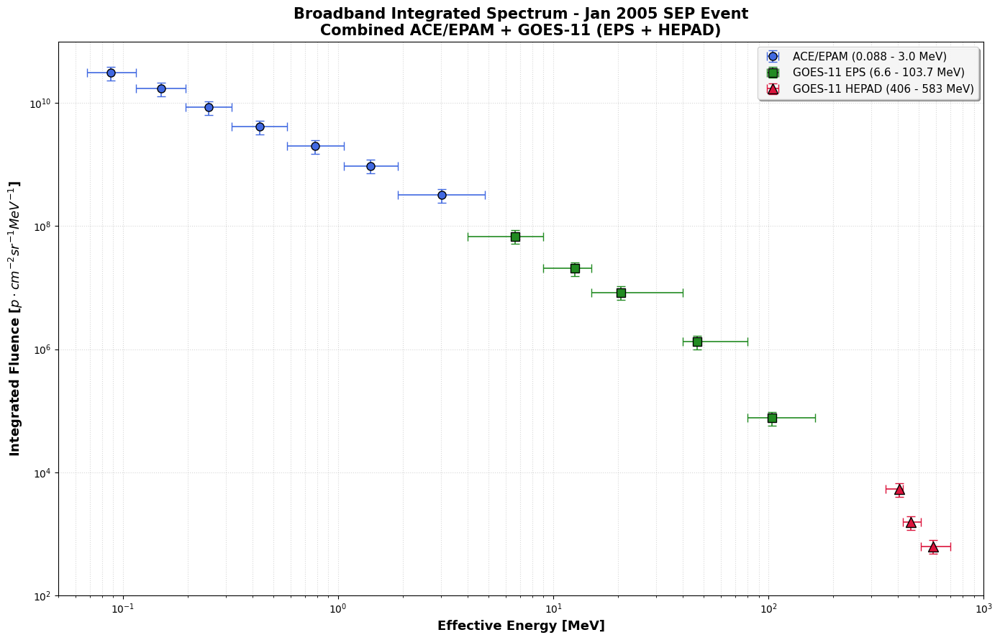

--------------------------------------------------------------------------------
ZONA DI RACCORDO ACE/EPAM → GOES/EPS (1 - 10 MeV)
--------------------------------------------------------------------------------
Channel  | Instrument   | E_eff [MeV]  | Fluence        
--------------------------------------------------------------------------------
P7p      | ACE/EPAM     | 1.419        | 9.52e+08       
P8p      | ACE/EPAM     | 3.020        | 3.21e+08       
P2       | EPS          | 6.643        | 6.84e+07       

Total data points for fit: 15
Energy coverage: 0.088 - 583.0 MeV
Fluence dynamic range: ~4.9e+07×

Dataset 'df_combined_jan2005' pronto per FIT BAND FUNCTION ✓


In [5]:
# =================================================================
# UNIONE DATI E PLOT BROADBAND (ACE + EPS + HEPAD) - JAN 2005
# =================================================================

import pandas as pd
import matplotlib.pyplot as plt

# 1. Unione dei DataFrame
df_combined_jan2005 = pd.concat([df_fluence_ace, df_fluence_goes], 
                                 ignore_index=True)

# Ordinamento per energia crescente (fondamentale per fit)
df_combined_jan2005 = df_combined_jan2005.sort_values('E_eff').reset_index(drop=True)

# ==========================================
# 2. PLOT BROADBAND PROFESSIONALE
# ==========================================
plt.figure(figsize=(14, 9))

# Sottoset per strumento
ace_data = df_combined_jan2005[df_combined_jan2005['Instrument'] == 'ACE/EPAM']
eps_data = df_combined_jan2005[df_combined_jan2005['Instrument'] == 'EPS']
hepad_data = df_combined_jan2005[df_combined_jan2005['Instrument'] == 'HEPAD']

# --- ACE: Cerchi BLU (Low Energy) ---
plt.errorbar(ace_data['E_eff'], ace_data['Fluence'], 
             yerr=ace_data['y_err'], 
             xerr=[ace_data['x_err_low'], ace_data['x_err_high']],
             fmt='o', color='royalblue', markersize=8, 
             capsize=4, elinewidth=1.2, 
             markeredgecolor='black',
             label='ACE/EPAM (0.088 - 3.0 MeV)')

# --- GOES EPS: Quadrati VERDI (Mid Energy) ---
plt.errorbar(eps_data['E_eff'], eps_data['Fluence'], 
             yerr=eps_data['y_err'], 
             xerr=[eps_data['x_err_low'], eps_data['x_err_high']],
             fmt='s', color='forestgreen', markersize=8, 
             capsize=4, elinewidth=1.2, 
             markeredgecolor='black',
             label='GOES-11 EPS (6.6 - 103.7 MeV)')

# --- GOES HEPAD: Triangoli ROSSI (High Energy) ---
plt.errorbar(hepad_data['E_eff'], hepad_data['Fluence'], 
             yerr=hepad_data['y_err'], 
             xerr=[hepad_data['x_err_low'], hepad_data['x_err_high']],
             fmt='^', color='crimson', markersize=10, 
             capsize=4, elinewidth=1.2, 
             markeredgecolor='black',
             label='GOES-11 HEPAD (406 - 583 MeV)')

# Configurazione Assi
plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.5)

# Label e Titoli
plt.xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=13)
plt.ylabel(r"Integrated Fluence [$p \cdot cm^{-2} sr^{-1} MeV^{-1}$]", 
           fontweight='bold', fontsize=13)
plt.title("Broadband Integrated Spectrum - Jan 2005 SEP Event\n" +
          "Combined ACE/EPAM + GOES-11 (EPS + HEPAD)", 
          fontsize=15, fontweight='bold')

# Limiti assi per chiarezza
plt.xlim(0.05, 1000)
plt.ylim(1e2, 1e11)

# Legenda professionale
plt.legend(loc='upper right', shadow=True, framealpha=0.9, fontsize=11)

plt.tight_layout()
plt.show()

# ==========================================
# 3. VERIFICA RACCORDO ACE-GOES
# ==========================================
print("-" * 80)
print("ZONA DI RACCORDO ACE/EPAM → GOES/EPS (1 - 10 MeV)")
print("-" * 80)
print(f"{'Channel':<8} | {'Instrument':<12} | {'E_eff [MeV]':<12} | {'Fluence':<15}")
print("-" * 80)

# Mostriamo i punti nel raccordo (1-10 MeV)
raccordo = df_combined_jan2005[
    (df_combined_jan2005['E_eff'] >= 1.0) & 
    (df_combined_jan2005['E_eff'] <= 10.0)
]

for _, row in raccordo.iterrows():
    print(f"{row['Channel']:<8} | {row['Instrument']:<12} | "
          f"{row['E_eff']:<12.3f} | {row['Fluence']:<15.2e}")

print("\n" + "="*80)
print(f"Total data points for fit: {len(df_combined_jan2005)}")
print(f"Energy coverage: {df_combined_jan2005['E_eff'].min():.3f} - "
      f"{df_combined_jan2005['E_eff'].max():.1f} MeV")
print(f"Fluence dynamic range: ~{df_combined_jan2005['Fluence'].max()/df_combined_jan2005['Fluence'].min():.1e}×")
print("="*80)

# Salva per uso futuro
print("\nDataset 'df_combined_jan2005' pronto per FIT BAND FUNCTION ✓")

# FIT e cella EXPORT SRNIEL


--- INIZIO ELABORAZIONE FINALE: GENNAIO 2005 ---


C:\Users\stefa\AppData\Local\Temp\ipykernel_5152\1048973147.py:16: RuntimeWarning: invalid value encountered in scalar power
  norm = (ebreak**(gb-ga)) * np.exp(ga-gb)


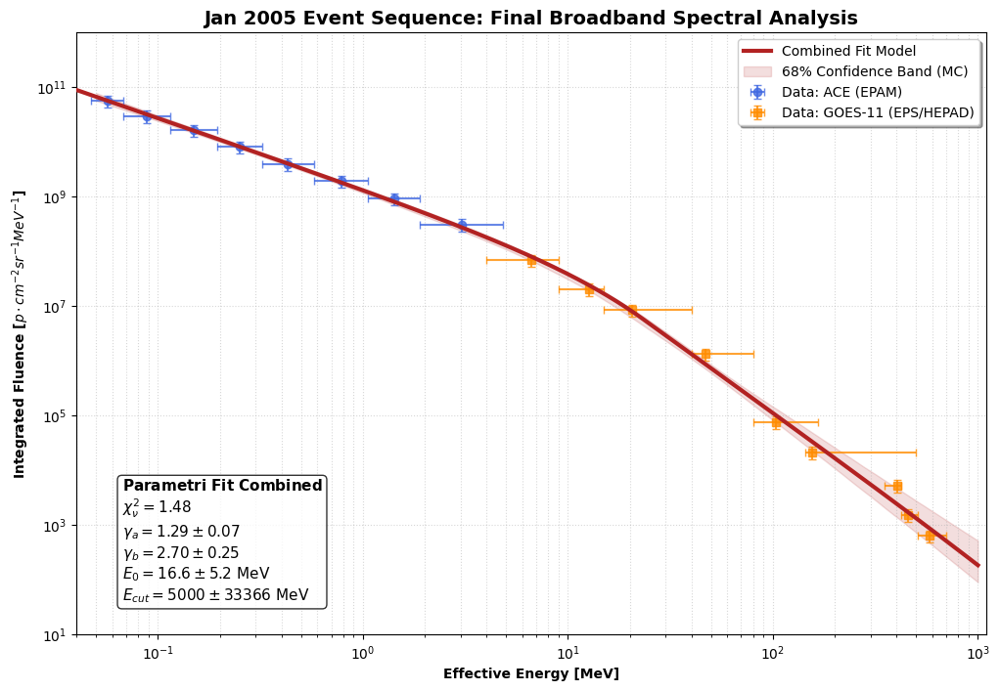

Export completato con successo nella cartella: FINAL_JAN2005_SRNIEL_EXPORT


In [ ]:
# ============================================================
# ANALISI DEFINITIVA JAN 2005: FIT, MONTE CARLO E EXPORT SR-NIEL
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

# Assicuriamoci che i modelli siano definiti (per sicurezza)
def band_function(E, A, ga, gb, E0):
    ebreak = (gb - ga) * E0
    res = np.zeros_like(E)
    mask_low = E <= ebreak
    res[mask_low] = A * (E[mask_low]**-ga) * np.exp(-E[mask_low]/E0)
    norm = (ebreak**(gb-ga)) * np.exp(ga-gb)
    res[~mask_low] = A * (E[~mask_low]**-gb) * norm
    return res

def combined_function(E, A, ga, gb, E0, Er):
    return band_function(E, A, ga, gb, E0) * np.exp(-E/Er)

# Funzione per il fit in spazio logaritmico (Stabilità numerica)
def fit_log_space(func, x, y, y_err, p0, bounds):
    def log_func(x_in, *params):
        return np.log10(np.maximum(func(x_in, *params), 1e-35))
    sigma_log = y_err / (y * np.log(10))
    try:
        from scipy.optimize import curve_fit
        popt, pcov = curve_fit(log_func, x, np.log10(y), p0=p0, sigma=sigma_log, 
                               absolute_sigma=True, bounds=bounds, maxfev=20000)
        return popt, pcov
    except: return None, None

print("\n--- INIZIO ELABORAZIONE FINALE: GENNAIO 2005 ---")

# 1) PREPARAZIONE DATI DA df_combined
E_tot  = df_combined['E_eff'].values
Y_tot  = df_combined['Fluence'].values
XL_tot = df_combined['x_err_low'].values
XH_tot = df_combined['x_err_high'].values
Yerr_tot = 0.25 * Y_tot # Incertezza sistematica conservativa 30%

# Identificazione strumenti per il plot
instruments_mask = df_combined['Instrument'].values

# 2) FIT COMBINED (Range: 0.04 - 700 MeV)
# p0: [A, ga, gb, E0, Er]
p0 = [1e11, 1.2, 3.5, 20.0, 800.0]
bounds = ([1e5, 0.1, 1.1, 1.0, 50.0], [1e15, 4.0, 8.0, 500.0, 5000.0])
popt, pcov = fit_log_space(combined_function, E_tot, Y_tot, Yerr_tot, p0, bounds)

if popt is None: raise RuntimeError("ERRORE: Fit Combined fallito.")
perr = np.sqrt(np.diag(pcov))

# Calcolo statistiche
res = (Y_tot - combined_function(E_tot, *popt)) / Yerr_tot
chi2red = np.sum(res**2) / (len(E_tot) - len(popt))

# 3) MONTE CARLO ROBUSTO (Range Export: 0.05 - 1000 MeV)
E_grid = np.logspace(np.log10(0.05), 3, 500) 
N_MC = 1000
rng = np.random.default_rng(42)

# Protezione numerica per pcov
v, w = np.linalg.eigh(pcov)
pcov_robust = w @ np.diag(np.maximum(v, 1e-11)) @ w.T 

p_samples = rng.multivariate_normal(popt, pcov_robust, size=N_MC)
Phi_MC = np.array([np.where(combined_function(E_grid, *ps) > 0, combined_function(E_grid, *ps), 1e-40) 
                   for ps in p_samples])

Phi_med = np.median(Phi_MC, axis=0)
Phi_lo, Phi_hi = np.percentile(Phi_MC, [16, 84], axis=0)

# 4) PLOT PROFESSIONALE
plt.figure(figsize=(12, 8))

# Dati ACE (Verde) e GOES (Blu/Rosso)
mask_ace = instruments_mask == 'ACE/EPAM'
plt.errorbar(E_tot[mask_ace], Y_tot[mask_ace], yerr=Yerr_tot[mask_ace], xerr=[XL_tot[mask_ace], XH_tot[mask_ace]], 
             fmt="o", color="royalblue", capsize=3, label="Data: ACE (EPAM)", alpha=0.8)

mask_goes = (instruments_mask == 'EPS') | (instruments_mask == 'HEPAD')
plt.errorbar(E_tot[mask_goes], Y_tot[mask_goes], yerr=Yerr_tot[mask_goes], xerr=[XL_tot[mask_goes], XH_tot[mask_goes]], 
             fmt="s", color="darkorange", capsize=3, label="Data: GOES-11 (EPS/HEPAD)", alpha=0.8)

# Curve di Fit e Incertezza
E_plot = np.logspace(np.log10(0.04), 3, 1000)
plt.plot(E_plot, combined_function(E_plot, *popt), color="firebrick", lw=3, label="Combined Fit Model", zorder=5)
plt.fill_between(E_grid, Phi_lo, Phi_hi, color="firebrick", alpha=0.15, label="68% Confidence Band (MC)")

# Box Parametri (LaTeX)
stats_box = (
    r"$\bf{Parametri\ Fit\ Combined}$" + "\n" +
    r"$\chi^2_\nu = %.2f$" % chi2red + "\n" +
    r"$\gamma_a = %.2f \pm %.2f$" % (popt[1], perr[1]) + "\n" +
    r"$\gamma_b = %.2f \pm %.2f$" % (popt[2], perr[2]) + "\n" +
    r"$E_0 = %.1f \pm %.1f$ MeV" % (popt[3], perr[3]) + "\n" +
    r"$E_{cut} = %.0f \pm %.0f$ MeV" % (popt[4], perr[4])
)
plt.gca().text(0.05, 0.05, stats_box, transform=plt.gca().transAxes, fontsize=11, 
               verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

plt.xscale("log"); plt.yscale("log"); plt.xlim(0.04, 1100); plt.ylim(1e1, 1e12)
plt.xlabel("Effective Energy [MeV]", fontweight='bold'); plt.ylabel(r"Integrated Fluence [$p \cdot cm^{-2} sr^{-1} MeV^{-1}$]", fontweight='bold')
plt.title("Jan 2005 Event Sequence: Final Broadband Spectral Analysis", fontsize=14, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.5); plt.legend(loc="upper right", shadow=True); plt.show()

# 5) EXPORT SR-NIEL (Sferica 4pi e Planare pi)
out_dir = "FINAL_JAN2005_SRNIEL_EXPORT"
if not os.path.exists(out_dir): os.makedirs(out_dir)

FACTORS = {"Planare": np.pi, "Sferica": 4*np.pi}
for geo, factor in FACTORS.items():
    np.savetxt(f"{out_dir}/JAN05_{geo}_Median.txt", np.column_stack([E_grid, factor*Phi_med]), fmt="%.6e", 
               header=f"Energy(MeV) {geo}_Fluence(cm^-2*MeV^-1)")
    np.savetxt(f"{out_dir}/JAN05_{geo}_CL68.txt", np.column_stack([E_grid, factor*Phi_lo, factor*Phi_hi]), fmt="%.6e", 
               header=f"Energy(MeV) Phi16 Phi84")

print(f"Export completato con successo nella cartella: {out_dir}")

# FIT e cella EXPORT (Band Function)


--- INIZIO ELABORAZIONE FINALE (BAND FUNCTION): GENNAIO 2005 ---
Numero punti per fit: 15
✓ Fit convergito con successo


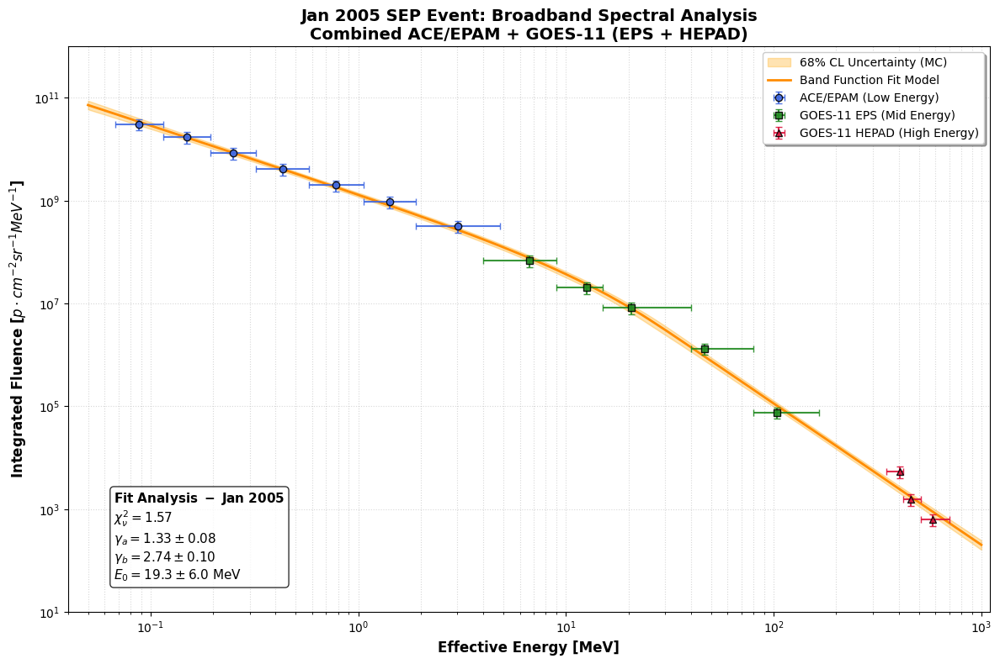


--- ANALISI COMPLETATA ---
✓ Export completato: JAN2005_Export_finale_2026_usare_questo
✓ Parametri: γₐ=1.33, γᵦ=2.74, E₀=19.3 MeV
✓ χ²_ν = 1.57 (Fit Quality: OTTIMO)


In [6]:
# ============================================================
# ANALISI DEFINITIVA JAN 2005: FIT (BAND FUNCTION) E MC
# ERRORE: 25% SISTEMATICO + POISSONIANO | ACE + EPS + HEPAD
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from scipy.optimize import curve_fit
from scipy.linalg import eigh

# 1. MODELLI FISICI (LOG-SPACE)
def log_band(E, logA, ga, gb, E0):
    E0_s = np.clip(E0, 0.1, 1000)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E)
    mask = E <= ebreak
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

def band_linear(E, *p):
    return 10**log_band(E, *p)

print("\n--- INIZIO ELABORAZIONE FINALE (BAND FUNCTION): GENNAIO 2005 ---")

# --- 2. PREPARAZIONE DATI ---
# ⭐ CORREZIONE: Usa il nome corretto del DataFrame
E_tot = df_combined_jan2005['E_eff'].values
Y_tot = df_combined_jan2005['Fluence'].values

# Verifica numero punti
print(f"Numero punti per fit: {len(E_tot)}")
if len(E_tot) != 15:
    print("⚠️ ATTENZIONE: Numero punti diverso da 15!")

# Calcolo errori
Yerr_tot = np.sqrt((0.25 * Y_tot)**2 + Y_tot)
sigma_log = Yerr_tot / (Y_tot * np.log(10))

# --- 3. ESECUZIONE FIT ---
p0 = [10.5, 1.6, 3.2, 15.0]  # Initial guess per JAN 2005 (più soft)
bounds = ([8, 0.1, 1.5, 1.0], [15, 2.5, 6.0, 500])

try:
    popt, pcov = curve_fit(log_band, E_tot, np.log10(Y_tot), p0=p0, 
                           sigma=sigma_log, absolute_sigma=True, 
                           bounds=bounds, maxfev=20000)
    print("✓ Fit convergito con successo")
except Exception as e:
    print(f"❌ Errore Fit: {e}")
    popt, pcov = None, None

if popt is not None:
    perr = np.sqrt(np.diag(pcov))
    residuals = (np.log10(Y_tot) - log_band(E_tot, *popt)) / sigma_log
    chi2red = np.sum(residuals**2) / (len(E_tot) - len(popt))

    # --- 4. MONTE CARLO ---
    E_grid = np.logspace(np.log10(0.05), 3, 500)
    N_MC = 1000
    clean_cov = (pcov + pcov.T) / 2
    vals, vecs = eigh(clean_cov)
    vals = np.maximum(vals, 1e-12 * np.max(vals))
    stable_cov = vecs @ np.diag(vals) @ vecs.T
    mc_params = np.random.default_rng(42).multivariate_normal(popt, stable_cov, N_MC)
    mc_fits = np.array([band_linear(E_grid, *p) for p in mc_params])
    Phi_med = np.median(mc_fits, axis=0)
    Phi_lo, Phi_hi = np.percentile(mc_fits, [16, 84], axis=0)

    # --- 5. PLOT PROFESSIONALE ---
    plt.figure(figsize=(12, 8))
    
    # Banda di incertezza (alpha ridotto per coerenza con OCT2003)
    plt.fill_between(E_grid, Phi_lo, Phi_hi, color='orange', alpha=0.3, 
                     label='68% CL Uncertainty (MC)')
    
    # Curva fit mediana (lw aumentato per visibilità)
    plt.plot(E_grid, Phi_med, color='darkorange', lw=2, 
             label="Band Function Fit Model")

    # Dati con stili distinti per strumento
    instruments = [
        ('ACE/EPAM', 'royalblue', 'o', 'ACE/EPAM (Low Energy)'),
        ('EPS', 'forestgreen', 's', 'GOES-11 EPS (Mid Energy)'),
        ('HEPAD', 'crimson', '^', 'GOES-11 HEPAD (High Energy)')
    ]

    for inst_key, color, marker, label in instruments:
        m = df_combined_jan2005['Instrument'] == inst_key
        if m.any():
            plt.errorbar(df_combined_jan2005.loc[m, 'E_eff'], 
                         df_combined_jan2005.loc[m, 'Fluence'], 
                         yerr=Yerr_tot[m], 
                         xerr=[df_combined_jan2005.loc[m, 'x_err_low'], 
                               df_combined_jan2005.loc[m, 'x_err_high']], 
                         fmt=marker, color=color, label=label, 
                         alpha=0.9, capsize=3, markeredgecolor='black')

    # Box Parametri (LaTeX)
    stats_box = (
        r"$\bf{Fit\ Analysis\ -\ Jan\ 2005}$" + "\n" +
        r"$\chi^2_\nu = %.2f$" % chi2red + "\n" +
        r"$\gamma_a = %.2f \pm %.2f$" % (popt[1], perr[1]) + "\n" +
        r"$\gamma_b = %.2f \pm %.2f$" % (popt[2], perr[2]) + "\n" +
        r"$E_0 = %.1f \pm %.1f$ MeV" % (popt[3], perr[3])
    )
    plt.gca().text(0.05, 0.05, stats_box, transform=plt.gca().transAxes, 
                   fontsize=11, verticalalignment='bottom', 
                   bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

    # Configurazione assi
    plt.xscale("log")
    plt.yscale("log")
    plt.xlim(0.04, 1100)
    plt.ylim(1e1, 1e12)
    
    plt.xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=12)
    plt.ylabel(r"Integrated Fluence [$p \cdot cm^{-2} sr^{-1} MeV^{-1}$]", 
               fontweight='bold', fontsize=12)
    plt.title("Jan 2005 SEP Event: Broadband Spectral Analysis\n" +
              "Combined ACE/EPAM + GOES-11 (EPS + HEPAD)", 
              fontsize=14, fontweight='bold')
    
    plt.grid(True, which="both", ls=':', alpha=0.5)
    plt.legend(loc="upper right", shadow=True, fontsize=10)
    plt.tight_layout()
    plt.show()

    # --- 6. EXPORT SR-NIEL ---
    out_dir = "JAN2005_Export_finale_2026_usare_questo"
    if not os.path.exists(out_dir): 
        os.makedirs(out_dir)
    
    for geo, factor in {"Planare": np.pi, "Sferica": 4*np.pi}.items():
        # Mediana
        np.savetxt(f"{out_dir}/JAN05_Band_{geo}_Median.txt", 
                   np.column_stack([E_grid, factor*Phi_med]), 
                   fmt="%.6e",
                   header=f"Energy(MeV) {geo}_Fluence(cm^-2*MeV^-1)")
        
        # Bande di confidenza
        np.savetxt(f"{out_dir}/JAN05_Band_{geo}_CL68.txt", 
                   np.column_stack([E_grid, factor*Phi_lo, factor*Phi_hi]), 
                   fmt="%.6e",
                   header="Energy(MeV) Phi16 Phi84")
    
    print(f"\n--- ANALISI COMPLETATA ---")
    print(f"✓ Export completato: {out_dir}")
    print(f"✓ Parametri: γₐ={popt[1]:.2f}, γᵦ={popt[2]:.2f}, E₀={popt[3]:.1f} MeV")
    print(f"✓ χ²_ν = {chi2red:.2f} (Fit Quality: {'OTTIMO' if chi2red < 2 else 'ACCETTABILE'})")

# J(E)

In [9]:
# ============================================================
# CALCOLO FLUENZE INTEGRALI — JAN 2005
# La Band function è in cm⁻² sr⁻¹ MeV⁻¹
# Fluenza omnidirezionale = integrale × 4π sr
# ============================================================

E_int = np.logspace(np.log10(0.5), 3, 5000)
phi_diff = band_linear(E_int, *popt)  # cm⁻² sr⁻¹ MeV⁻¹

print("\n--- FLUENZE INTEGRALI JAN 2005 (omnidirezionali, ×4π sr) ---")
for E_thresh in [10, 30, 60, 100, 500]:
    mask = E_int >= E_thresh
    J_omni = 4 * np.pi * np.trapezoid(phi_diff[mask], E_int[mask])
    print(f"  J(>{E_thresh} MeV) = {J_omni:.3e} cm⁻²")


--- FLUENZE INTEGRALI JAN 2005 (omnidirezionali, ×4π sr) ---
  J(>10 MeV) = 3.878e+09 cm⁻²
  J(>30 MeV) = 7.011e+08 cm⁻²
  J(>60 MeV) = 2.082e+08 cm⁻²
  J(>100 MeV) = 8.449e+07 cm⁻²
  J(>500 MeV) = 3.637e+06 cm⁻²


# CALCOLO DOSE Planar Shielding 37mm Al 

# Cella per estrarre Phi16 Phi84 bande 

In [19]:
# estrapolare righe Phi 16 e Phi84
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "JAN2005_Export_finale_2026_usare_questo/JAN05_Band_Planare_CL68.txt"

# Caricamento del file (saltando l'header)
df_cl = pd.read_csv(path_cl, sep=r"\s+", skiprows=1, names=["E", "Phi_16", "Phi_84"])

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_16 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_84 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
------------------------------
5.000000e-02 1.875624e+11
5.100225e-02 1.828838e+11
5.202458e-02 1.783518e+11
5.306741e-02 1.739524e+11
5.413114e-02 1.696643e+11
5.521620e-02 1.655085e+11
5.632300e-02 1.614619e+11
5.745199e-02 1.574948e+11
5.860361e-02 1.536068e+11
5.977832e-02 1.498426e+11
6.097657e-02 1.460529e+11
6.219884e-02 1.423939e+11
6.344561e-02 1.389321e+11
6.471737e-02 1.354842e+11
6.601463e-02 1.321215e+11
6.733789e-02 1.288739e+11
6.868767e-02 1.257424e+11
7.006451e-02 1.225304e+11
7.146895e-02 1.194428e+11
7.290154e-02 1.165306e+11
7.436284e-02 1.137361e+11
7.585344e-02 1.109093e+11
7.737392e-02 1.081081e+11
7.892487e-02 1.054923e+11
8.050691e-02 1.029669e+11
8.212067e-02 1.004974e+11
8.376677e-02 9.806248e+10
8.544587e-02 9.573391e+10
8.715862e-02 9.330402e+10
8.890571e-02 9.087270e+10
9.068782e-02 8.854039e+10
9.250565e-02 8.635153e+10
9.435992e-02 8.425133e+10
9.625136e-02 8.220261e+10
9.818071

# Calcolo TID 
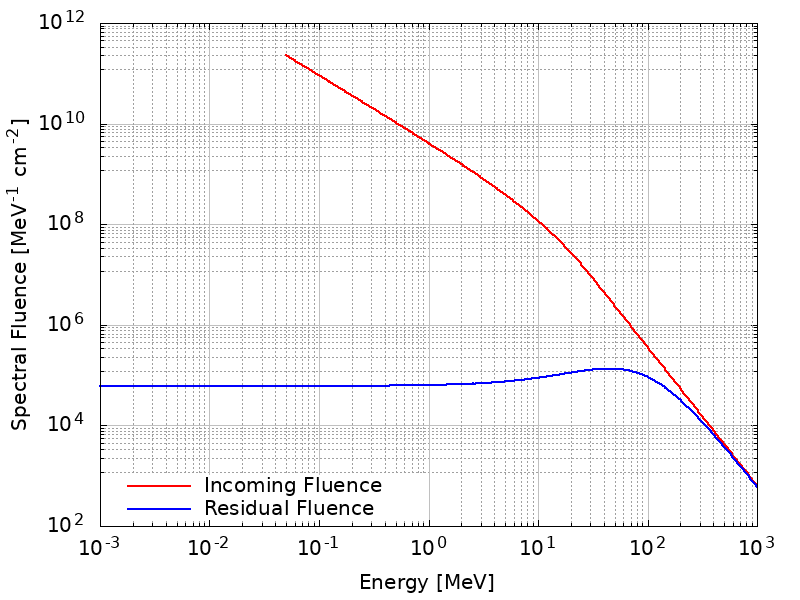

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  JAN 2005 
Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)
Dose Mediana: 35.6337 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [29.210 - 42.470] mGy
Incertezza Totale: +6.837 / -6.424 mGy
-----------------------------------------------------------------


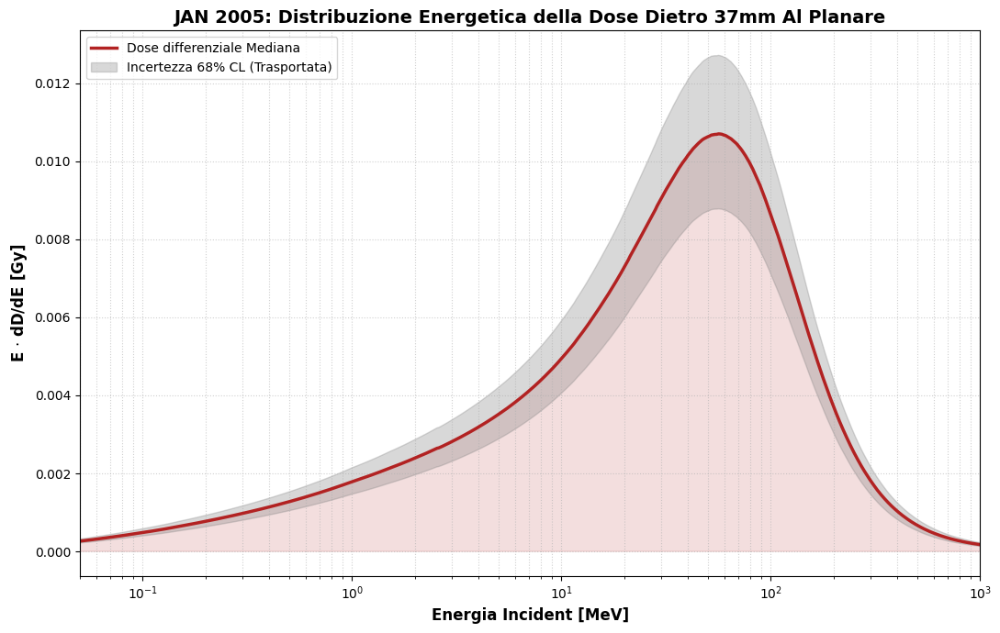

In [21]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "JAN2005_Export_finale_2026_usare_questo/Planar/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "Residual_median_planar.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "Residual_Phi16_planar.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "Residual_Phi84_planar.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  JAN 2005 ")
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("JAN 2005: Distribuzione Energetica della Dose Dietro 37mm Al Planare", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.05, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# CALCOLO DOSE Spherical Shielding 37mm Al

# Cella per estrarre Phi16 Phi84 bande Spherical

In [2]:
# estrapolare righe Phi 16 e Phi84
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "JAN2005_Export_finale_2026_usare_questo/Spherical/JAN05_Band_Sferica_CL68.txt"

# Caricamento del file (saltando l'header)
df_cl = pd.read_csv(path_cl, sep=r"\s+", skiprows=1, names=["E", "Phi_16", "Phi_84"])

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_16 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 30)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 30)
# Stampiamo Energy e Phi_84 in formato scientifico per il copia-incolla
for index, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
------------------------------
5.000000e-02 7.502498e+11
5.100225e-02 7.315353e+11
5.202458e-02 7.134073e+11
5.306741e-02 6.958096e+11
5.413114e-02 6.786570e+11
5.521620e-02 6.620339e+11
5.632300e-02 6.458477e+11
5.745199e-02 6.299790e+11
5.860361e-02 6.144272e+11
5.977832e-02 5.993703e+11
6.097657e-02 5.842116e+11
6.219884e-02 5.695754e+11
6.344561e-02 5.557285e+11
6.471737e-02 5.419366e+11
6.601463e-02 5.284861e+11
6.733789e-02 5.154957e+11
6.868767e-02 5.029696e+11
7.006451e-02 4.901218e+11
7.146895e-02 4.777712e+11
7.290154e-02 4.661224e+11
7.436284e-02 4.549444e+11
7.585344e-02 4.436371e+11
7.737392e-02 4.324326e+11
7.892487e-02 4.219692e+11
8.050691e-02 4.118678e+11
8.212067e-02 4.019898e+11
8.376677e-02 3.922499e+11
8.544587e-02 3.829356e+11
8.715862e-02 3.732161e+11
8.890571e-02 3.634908e+11
9.068782e-02 3.541616e+11
9.250565e-02 3.454061e+11
9.435992e-02 3.370053e+11
9.625136e-02 3.288105e+11
9.818071

# Calcolo DOSE
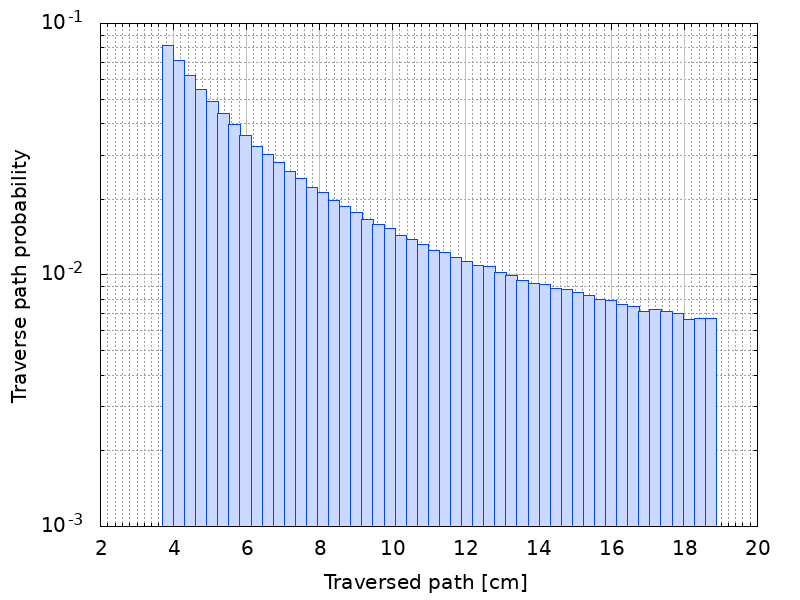
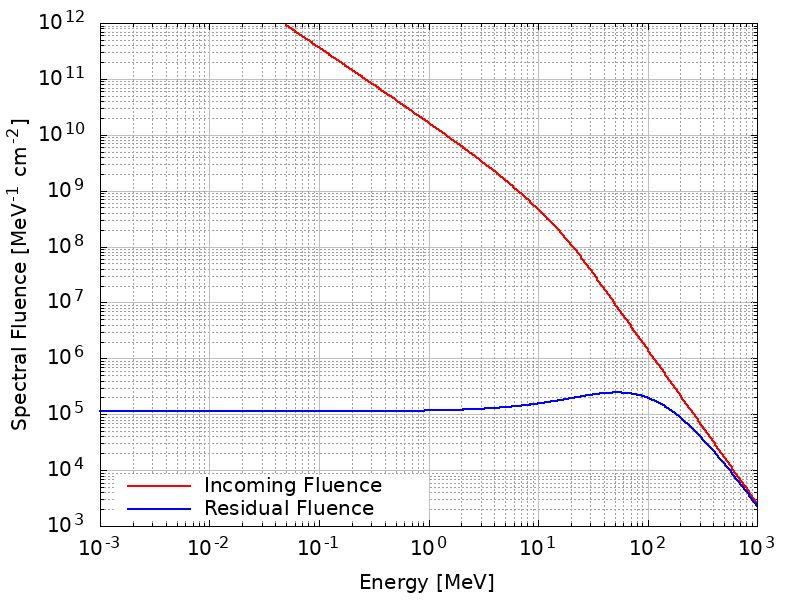

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  JAN 2005 
Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)
Dose Mediana: 69.9481 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [57.324 - 83.162] mGy
Incertezza Totale: +13.214 / -12.624 mGy
-----------------------------------------------------------------


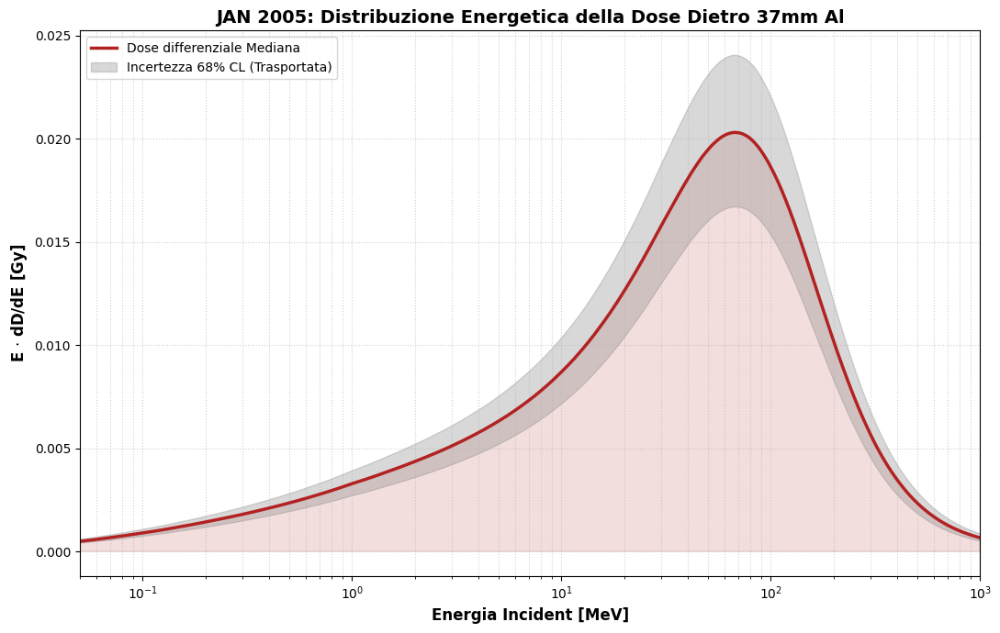

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "JAN2005_Export_finale_2026_usare_questo/Spherical/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "Median_residual_spherical.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "Phi16_residual_spherical.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "Phi84_residual_spherical.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  JAN 2005 ")
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("JAN 2005: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.05, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# OCT 2003

# DATI GOES-11 EPS + HEPAD

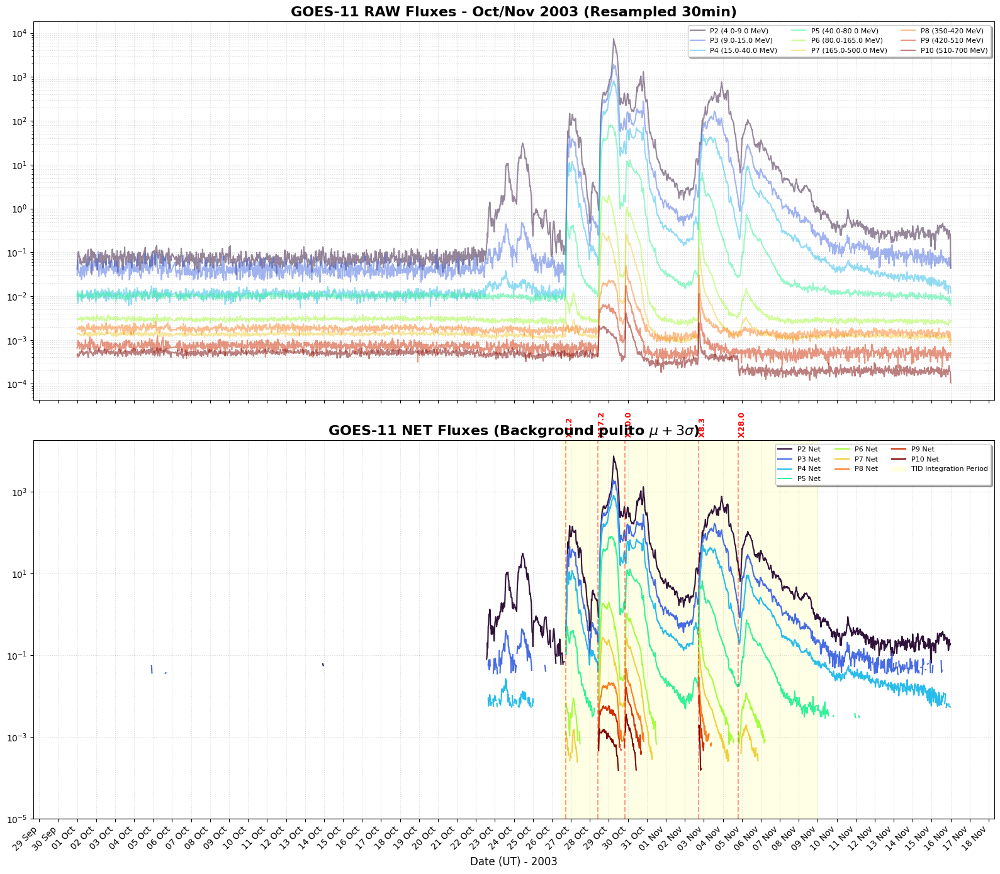

---------------------------------------------
CHANNEL  | MU         | WHITMAN THRESHOLD
---------------------------------------------
P2       | 7.17e-02 | 1.25e-01
P3       | 4.11e-02 | 7.46e-02
P4       | 1.11e-02 | 1.64e-02
P5       | 1.03e-02 | 1.31e-02
P6       | 3.02e-03 | 3.67e-03
P7       | 1.37e-03 | 1.61e-03
P8       | 1.85e-03 | 2.42e-03
P9       | 7.38e-04 | 1.09e-03
P10      | 5.18e-04 | 6.58e-04


In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

# ==========================================
# 1. CARICAMENTO DATI (EPS + HEPAD)
# ==========================================
file_path_eps = "SEPEM_RDS_v3/SEPEM_RDS_v3-0/RDS3.0_H_EPS_GOES11.txt"
file_path_hepad = "SEPEM_RDS_v3/SEPEM_RDS_v3-0/RDS3.0_H_HEPAD_GOES11.txt"

def load_clean_sepem(path):
    df = pd.read_csv(path, sep=',', skipinitialspace=True, index_col='epoch', parse_dates=['epoch'])
    df.columns = df.columns.str.strip()
    return df

df_eps = load_clean_sepem(file_path_eps)
df_hepad = load_clean_sepem(file_path_hepad)

# ==========================================
# 2. PARAMETRI E INTERVALLI (OCT/NOV 2003)
# ==========================================
t_start, t_end = '2003-10-01 00:00:00', '2003-11-16 00:00:00'
bg_start, bg_end = '2003-10-07 00:00:00', '2003-10-21 00:00:00'
t_integ_start, t_integ_end = '2003-10-26 12:00:00', '2003-11-09 00:00:00'

energy_labels = {
    'P2': '4.0-9.0 MeV', 'P3': '9.0-15.0 MeV', 'P4': '15.0-40.0 MeV',
    'P5': '40.0-80.0 MeV', 'P6': '80.0-165.0 MeV', 'P7': '165.0-500.0 MeV',
    'P8': '350-420 MeV', 'P9': '420-510 MeV', 'P10': '510-700 MeV'
}

flare_dates = [
    ('2003-10-26 17:21', 'X1.2'),
    ('2003-10-28 09:51', 'X17.2'),
    ('2003-10-29 20:37', 'X10.0'),
    ('2003-11-02 17:03', 'X8.3'),
    ('2003-11-04 19:29', 'X28.0')
]

# ==========================================
# 3. PULIZIA WHITMAN E RESAMPLING (30 MIN)
# ==========================================
df_total_raw = pd.concat([df_eps.loc[t_start:t_end], df_hepad.loc[t_start:t_end]], axis=1).sort_index()

# RESAMPLING A 30 MINUTI
df_total_raw = df_total_raw.resample('30min').mean()

# Calcolo soglie sul periodo di background
bg_period = df_total_raw.loc[bg_start:bg_end]
mu = bg_period.mean()
sigma = bg_period.std()
threshold = mu + 3 * sigma

df_total_corrected = df_total_raw.copy()

for col in energy_labels.keys():
    if col in df_total_raw.columns:
        df_total_corrected[col] = df_total_raw[col] - mu[col]
        df_total_corrected.loc[df_total_raw[col] < threshold[col], col] = np.nan

# ==========================================
# 4. PLOT DI CONFRONTO FINALE
# ==========================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 14), sharex=True)
colors_map = plt.cm.turbo(np.linspace(0, 1, len(energy_labels)))

# PLOT 1: RAW DATA (30min Resampled)
for i, col in enumerate(energy_labels.keys()):
    if col in df_total_raw.columns:
        ax1.plot(df_total_raw.index, df_total_raw[col], 
                 label=f"{col} ({energy_labels[col]})", color=colors_map[i], alpha=0.5)

ax1.set_yscale('log')
ax1.set_title('GOES-11 RAW Fluxes - Oct/Nov 2003 (Resampled 30min)', fontweight='bold', fontsize=16)
ax1.grid(True, which="both", ls=':', alpha=0.5)

# PLOT 2: NET DATA (Whitman Cleaned)
for i, col in enumerate(energy_labels.keys()):
    if col in df_total_corrected.columns:
        ax2.plot(df_total_corrected.index, df_total_corrected[col], 
                 label=f"{col} Net", color=colors_map[i], linewidth=1.5)

# Evidenzia periodo integrazione
ax2.axvspan(pd.to_datetime(t_integ_start), pd.to_datetime(t_integ_end), color='yellow', alpha=0.1, label='TID Integration Period')

# Flare markers
for date, label in flare_dates:
    ax2.axvline(pd.to_datetime(date), color='red', linestyle='--', alpha=0.4)
    ax2.text(pd.to_datetime(date), 2e4, f" {label}", color='red', fontweight='bold', rotation=90, fontsize=9)

ax2.set_yscale('log')
ax2.set_ylim(bottom=1e-5)
ax2.set_title(r'GOES-11 NET Fluxes (Background pulito $\mu+3\sigma$)', fontweight='bold', fontsize=16)
ax2.set_xlabel('Date (UT) - 2003', fontsize=12)
ax2.grid(True, which="both", ls=':', alpha=0.5)

# Formattazione asse temporale
ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45, ha='right')

ax1.legend(loc='upper right', fontsize=8, ncol=3, shadow=True)
ax2.legend(loc='upper right', fontsize=8, ncol=3, shadow=True)

plt.tight_layout()
plt.show()

# --- VERIFICA SOGLIE ---
print("-" * 45)
print(f"{'CHANNEL':<8} | {'MU':<10} | {'WHITMAN THRESHOLD':<15}")
print("-" * 45)
for col in energy_labels.keys():
    if col in threshold.index:
        print(f"{col:<8} | {mu[col]:.2e} | {threshold[col]:.2e}")

# Calcolo FLUENZA GOES

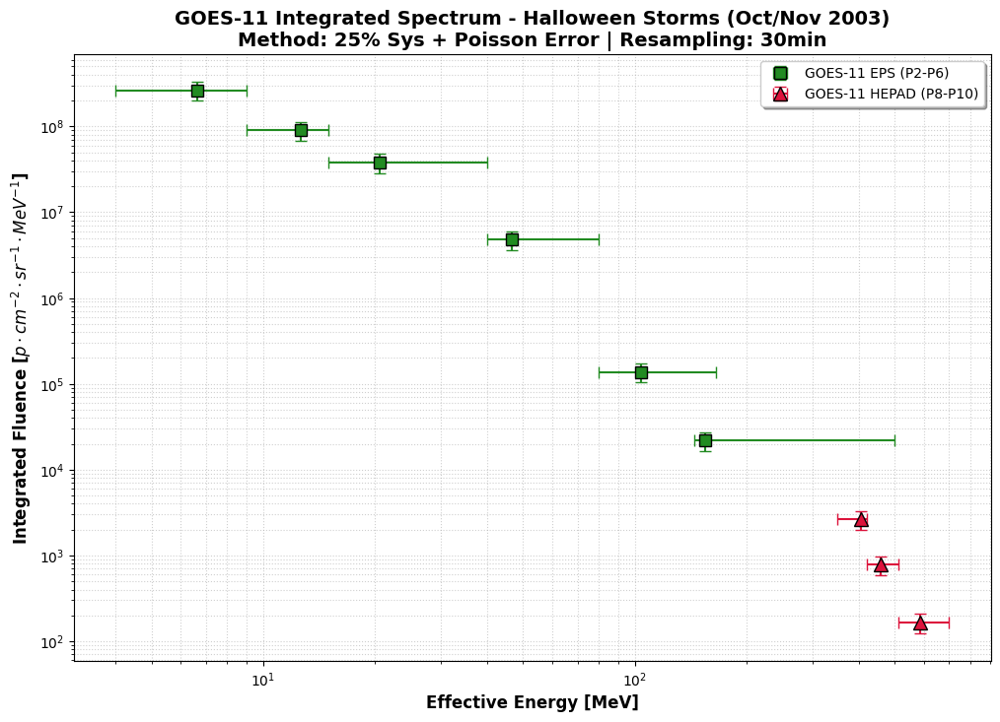

------------------------------------------------------------
Channel  | Instrument | E_eff    | Fluence      | y_err % 
------------------------------------------------------------
P2       | EPS        | 6.64     | 2.64e+08     | 25.0    %
P3       | EPS        | 12.61    | 9.04e+07     | 25.0    %
P4       | EPS        | 20.55    | 3.80e+07     | 25.0    %
P5       | EPS        | 46.62    | 4.76e+06     | 25.0    %
P6       | EPS        | 103.70   | 1.37e+05     | 25.0    %
P7       | EPS        | 154.60   | 2.17e+04     | 25.0    %
P8       | HEPAD      | 406.00   | 2.63e+03     | 25.1    %
P9       | HEPAD      | 457.00   | 7.76e+02     | 25.3    %
P10      | HEPAD      | 583.00   | 1.67e+02     | 26.2    %


In [2]:
# =================================================================
# CALCOLO E PLOT FLUENZA INTEGRATA (OCT 2003 - HALLOWEEN STORMS)
# Intervallo: 26/10/2003 12:00 - 09/11/2003 00:00
# =================================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# 1. Energie Efficaci (SEPEM Calib) e Bin Nominali GOES-11
e_eff_map = {
    'P2': 6.643, 'P3': 12.61, 'P4': 20.55, 
    'P5': 46.62, 
    'P6': 103.7, 
    'P7': 154.6,
    'P8': 406.0, 'P9': 457.0, 'P10': 583.0
}

goes_bins_list = {
    'P2': (4.0, 9.0), 'P3': (9.0, 15.0), 'P4': (15.0, 40.0), 'P5': (40.0, 80.0),
    'P6': (80.0, 165.0), 
    'P7': (165.0, 500.0), 
    'P8': (350.0, 420.0), 
    'P9': (420.0, 510.0), 'P10': (510.0, 700.0)
}

# 2. Parametro di integrazione 
# Poiché abbiamo fatto resampling a 30 min, ogni punto rappresenta 1800 secondi
delta_t = 1800 

fluence_goes_data_2003 = []

# Finestra di integrazione Halloween Storms
t_inv_start, t_inv_end = '2003-10-26 12:00:00', '2003-11-09 00:00:00'
df_event_goes = df_total_corrected.loc[t_inv_start:t_inv_end]

for col, e_eff in e_eff_map.items():
    if col in df_event_goes.columns:
        # Somma dei flussi netti (fillna(0) per gestire i momenti sotto soglia Whitman)
        f_val = df_event_goes[col].fillna(0).sum() * delta_t
        
        if f_val > 0:
            e_min, e_max = goes_bins_list[col]
            
            # --- DISTANZA DAI BIN (x_err) ---
            x_err_low = abs(e_eff - e_min)
            x_err_high = abs(e_max - e_eff)
            
            # --- ERRORE SCIENTIFICO (y_err) ---
            # 25% errore sistematico + Poissoniano (statistico)
            y_err_val = np.sqrt((0.25 * f_val)**2 + f_val)
            
            fluence_goes_data_2003.append({
                'Channel': col,
                'E_eff': e_eff,
                'Fluence': f_val,
                'y_err': y_err_val,
                'x_err_low': x_err_low,
                'x_err_high': x_err_high,
                'Instrument': 'EPS' if int(col[1:]) < 8 else 'HEPAD'
            })

# Creazione DataFrame
df_fluence_goes_oct2003 = pd.DataFrame(fluence_goes_data_2003).sort_values('E_eff')

# ==========================================
# 3. PLOT DELLO SPETTRO (Marker differenziati)
# ==========================================
plt.figure(figsize=(12, 8))

# Split strumenti per styling diverso
df_eps = df_fluence_goes_oct2003[df_fluence_goes_oct2003['Instrument'] == 'EPS']
df_hepad = df_fluence_goes_oct2003[df_fluence_goes_oct2003['Instrument'] == 'HEPAD']

# Plot EPS: Cerchi Verdi (forestgreen)
plt.errorbar(df_eps['E_eff'], df_eps['Fluence'], 
             yerr=df_eps['y_err'], xerr=[df_eps['x_err_low'], df_eps['x_err_high']],
             fmt='s', color='forestgreen', markersize=9, capsize=4, elinewidth=1.5, 
             markeredgecolor='black', label='GOES-11 EPS (P2-P6)')

# Plot HEPAD: Triangoli Rossi (crimson)
plt.errorbar(df_hepad['E_eff'], df_hepad['Fluence'], 
             yerr=df_hepad['y_err'], xerr=[df_hepad['x_err_low'], df_hepad['x_err_high']],
             fmt='^', color='crimson', markersize=10, capsize=4, elinewidth=1.5, 
             markeredgecolor='black', label='GOES-11 HEPAD (P8-P10)')

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.6)

plt.xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=12)
plt.ylabel(r"Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]", fontweight='bold', fontsize=12)
plt.title("GOES-11 Integrated Spectrum - Halloween Storms (Oct/Nov 2003)\nMethod: 25% Sys + Poisson Error | Resampling: 30min", fontsize=14, fontweight='bold')

plt.legend(loc='upper right', shadow=True)
plt.show()

# Verifica tabellare
print("-" * 60)
print(f"{'Channel':<8} | {'Instrument':<10} | {'E_eff':<8} | {'Fluence':<12} | {'y_err %':<8}")
print("-" * 60)
for _, row in df_fluence_goes_oct2003.iterrows():
    err_pct = (row['y_err'] / row['Fluence']) * 100
    print(f"{row['Channel']:<8} | {row['Instrument']:<10} | {row['E_eff']:<8.2f} | {row['Fluence']:<12.2e} | {err_pct:<8.1f}%")

# DATI ACE

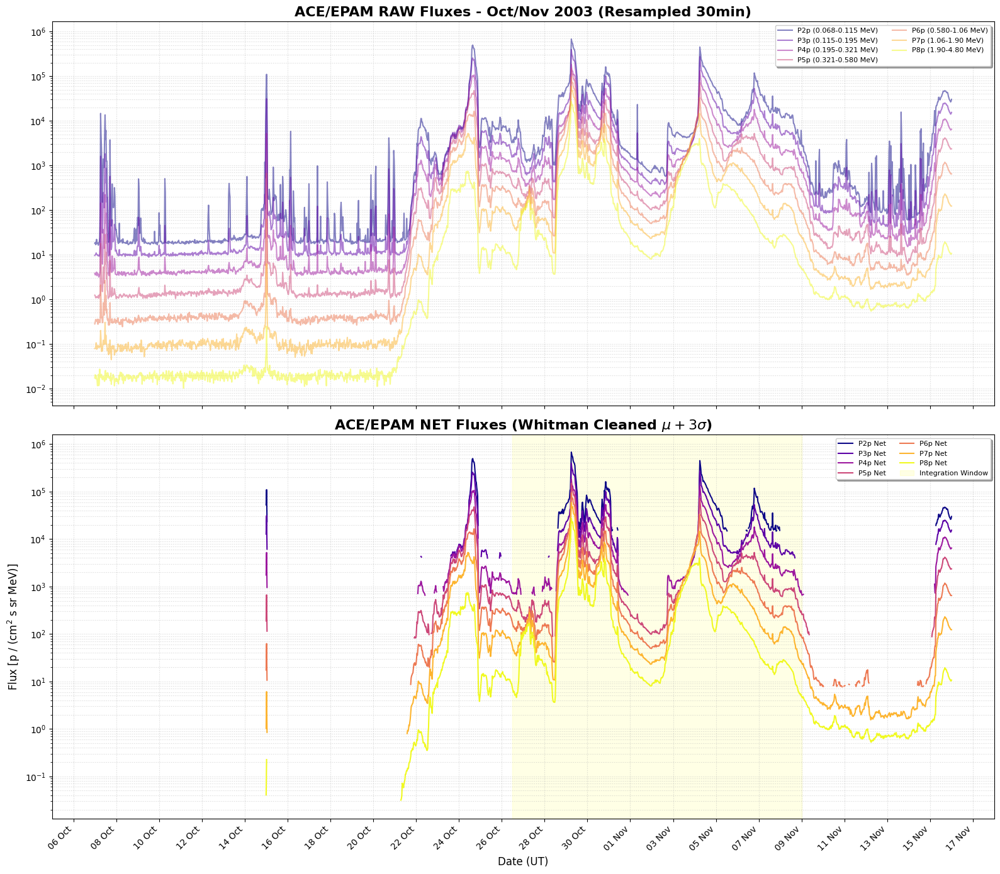

--------------------------------------------------
CHANNEL  | THRESHOLD (Whitman)
--------------------------------------------------
P2p      | 1.51e+04
P3p      | 4.09e+03
P4p      | 6.67e+02
P5p      | 8.49e+01
P6p      | 8.26e+00
P7p      | 8.47e-01
P8p      | 4.95e-02


In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

# ==========================================
# 1. FUNZIONE CARICAMENTO ACE (Blindata)
# ==========================================
def load_ace_epam_oct2003(file_path):
    header_cols = []
    start_row = 0
    with open(file_path, 'r') as f:
        lines = f.readlines()
    for i, line in enumerate(lines):
        if line.strip().startswith("year") and "P1p" in line:
            header_cols = line.strip().split()
        if "BEGIN DATA" in line:
            start_row = i + 1
            break
    
    df = pd.read_csv(file_path, sep=r'\s+', names=header_cols, skiprows=start_row, index_col=False)
    
    # Conversione data (Anno + Giorno dell'anno)
    time_str = df['year'].astype(str) + ' ' + df['day'].astype(str) + ' ' + \
               df['hr'].astype(str) + ' ' + df['min'].astype(str) + ' ' + \
               df['sec'].astype(int).astype(str)
    df['epoch'] = pd.to_datetime(time_str, format='%Y %j %H %M %S')
    df.set_index('epoch', inplace=True)
    
    # Pulizia valori negativi
    cols_p = [c for c in df.columns if 'p' in c and c.startswith('P')]
    df[cols_p] = df[cols_p].apply(lambda x: np.where(x < 0, np.nan, x))
    return df[cols_p]

# ==========================================
# 2. PARAMETRI E INTERVALLI (Sincronizzati con GOES)
# ==========================================
t_start, t_end = '2003-10-01 00:00:00', '2003-11-16 00:00:00'
bg_start, bg_end = '2003-10-07 00:00:00', '2003-10-21 00:00:00'
t_integ_start, t_integ_end = '2003-10-26 12:00:00', '2003-11-09 00:00:00'

ace_labels = {
    #'P1p': '0.047-0.068 MeV', 
    'P2p': '0.068-0.115 MeV', 'P3p': '0.115-0.195 MeV',
    'P4p': '0.195-0.321 MeV', 'P5p': '0.321-0.580 MeV', 'P6p': '0.580-1.06 MeV',
    'P7p': '1.06-1.90 MeV', 'P8p': '1.90-4.80 MeV'
}

# ==========================================
# 3. PULIZIA WHITMAN E RESAMPLING (30 MIN)
# ==========================================
file_path_ace = "OCT 2003 file/ACE_EPAM_Data_Oct_2003.txt"
df_ace_raw = load_ace_epam_oct2003(file_path_ace).loc[t_start:t_end]

# RESAMPLING A 30 MINUTI (Cruciale per uniformità con GOES)
df_ace_res = df_ace_raw.resample('30min').mean()

# Calcolo soglie Whitman sul periodo di quiete (07/10 - 21/10)
bg_period = df_ace_res.loc[bg_start:bg_end]
mu = bg_period.mean()
sigma = bg_period.std()
threshold = mu + 3 * sigma

df_ace_corrected = df_ace_res.copy()

for col in ace_labels.keys():
    if col in df_ace_res.columns:
        # Sottrazione background medio (Net Flux)
        df_ace_corrected[col] = df_ace_res[col] - mu[col]
        # Mascheramento Whitman: se Raw < mu + 3sigma, allora è rumore
        df_ace_corrected.loc[df_ace_res[col] < threshold[col], col] = np.nan

# ==========================================
# 4. PLOT DI CONFRONTO FINALE
# ==========================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 14), sharex=True)
colors_map = plt.cm.plasma(np.linspace(0, 1, len(ace_labels)))

# PLOT 1: RAW DATA
for i, col in enumerate(ace_labels.keys()):
    if col in df_ace_res.columns:
        ax1.plot(df_ace_res.index, df_ace_res[col], 
                 label=f"{col} ({ace_labels[col]})", color=colors_map[i], alpha=0.5)
ax1.set_yscale('log')
ax1.set_title('ACE/EPAM RAW Fluxes - Oct/Nov 2003 (Resampled 30min)', fontweight='bold', fontsize=16)
ax1.grid(True, which="both", ls=':', alpha=0.5)

# PLOT 2: NET DATA (Whitman Cleaned)
for i, col in enumerate(ace_labels.keys()):
    if col in df_ace_corrected.columns:
        ax2.plot(df_ace_corrected.index, df_ace_corrected[col], 
                 label=f"{col} Net", color=colors_map[i], linewidth=1.5)

# Evidenzia periodo integrazione TID
ax2.axvspan(pd.to_datetime(t_integ_start), pd.to_datetime(t_integ_end), color='yellow', alpha=0.1, label='Integration Window')

ax2.set_yscale('log')
ax2.set_title(r'ACE/EPAM NET Fluxes (Whitman Cleaned $\mu+3\sigma$)', fontweight='bold', fontsize=16)
ax2.set_ylabel(r'Flux [p / (cm$^2$ s sr MeV)]', fontsize=12)
ax2.set_xlabel('Date (UT)', fontsize=12)
ax2.grid(True, which="both", ls=':', alpha=0.5)

# Formattazione assi
ax2.xaxis.set_major_locator(mdates.DayLocator(interval=2))
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45, ha='right')

ax1.legend(loc='upper right', fontsize=8, ncol=2, shadow=True)
ax2.legend(loc='upper right', fontsize=8, ncol=2, shadow=True)

plt.tight_layout()
plt.show()

# --- VERIFICA SOGLIE ---
print("-" * 50)
print(f"{'CHANNEL':<8} | {'THRESHOLD (Whitman)':<15}")
print("-" * 50)
for col in ace_labels.keys():
    if col in threshold.index:
        print(f"{col:<8} | {threshold[col]:.2e}")

# CALCOLO FLUENZA ACE

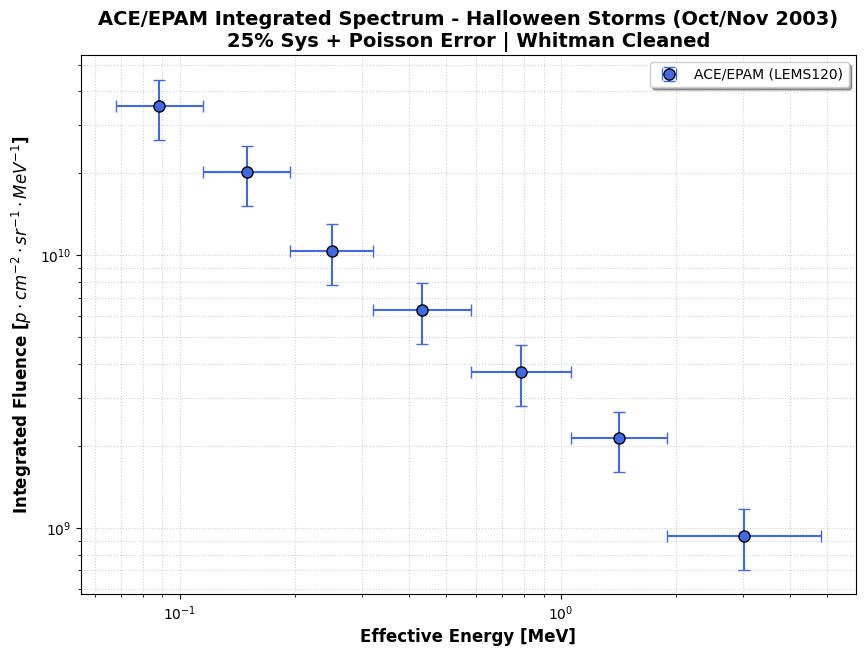

-----------------------------------------------------------------
Channel  | E_eff (MeV)  | Fluence      | y_err % 
-----------------------------------------------------------------
P2p      | 0.088        | 3.52e+10     | 25.0    %
P3p      | 0.150        | 2.02e+10     | 25.0    %
P4p      | 0.250        | 1.04e+10     | 25.0    %
P5p      | 0.432        | 6.32e+09     | 25.0    %
P6p      | 0.784        | 3.74e+09     | 25.0    %
P7p      | 1.419        | 2.14e+09     | 25.0    %
P8p      | 3.020        | 9.40e+08     | 25.0    %


In [4]:
# =================================================================
# CALCOLO E PLOT FLUENZA INTEGRATA ACE/EPAM (OCT 2003)
# Modello: 25% Sys + Poisson | Resampling: 30min
# =================================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# 1.1 Definizione Bin Energetici ACE (Ranges nominali)
ace_bins = {
    #'P1p': (0.047, 0.068), 
    'P2p': (0.068, 0.115), 
    'P3p': (0.115, 0.195),
    'P4p': (0.195, 0.321), 
    'P5p': (0.321, 0.580), 
    'P6p': (0.580, 1.060),
    'P7p': (1.060, 1.900), 
    'P8p': (1.900, 4.800)
}

# 1.2 Energie Efficaci fornite [MeV]
ace_eff_map = {
    #'P1p': 0.057,
    'P2p': 0.088,
    'P3p': 0.150,
    'P4p': 0.250,
    'P5p': 0.432,
    'P6p': 0.784,
    'P7p': 1.419,
    'P8p': 3.020
}

# 2. Parametro di integrazione
# Resampling 30 min -> 1800 secondi
delta_t = 1800 

fluence_ace_data_2003 = []

# Finestra di integrazione Halloween Storms (Sincronizzata con GOES)
t_inv_start, t_inv_end = '2003-10-26 12:00:00', '2003-11-09 00:00:00'
df_event_ace = df_ace_corrected.loc[t_inv_start:t_inv_end]

for col, e_eff in ace_eff_map.items():
    if col in df_event_ace.columns:
        # Somma flussi netti (fillna(0) per gestire i periodi sotto soglia)
        f_val = df_event_ace[col].fillna(0).sum() * delta_t
        
        if f_val > 0:
            e_min, e_max = ace_bins[col]
            
            # --- DISTANZA DAI BIN (x_err) ---
            x_err_low = abs(e_eff - e_min)
            x_err_high = abs(e_max - e_eff)
            
            # --- ERRORE SCIENTIFICO (y_err) ---
            # 25% errore sistematico + Poissoniano (statistico)
            y_err_val = np.sqrt((0.25 * f_val)**2 + f_val)
            
            fluence_ace_data_2003.append({
                'Channel': col,
                'E_eff': e_eff,
                'Fluence': f_val,
                'y_err': y_err_val,
                'x_err_low': x_err_low,
                'x_err_high': x_err_high,
                'Instrument': 'ACE/EPAM'
            })

# Creazione DataFrame finale
df_fluence_ace_oct2003 = pd.DataFrame(fluence_ace_data_2003).sort_values('E_eff')

# ==========================================
# 3. PLOT DELLO SPETTRO ACE/EPAM
# ==========================================
plt.figure(figsize=(10, 7))

plt.errorbar(df_fluence_ace_oct2003['E_eff'], df_fluence_ace_oct2003['Fluence'], 
             yerr=df_fluence_ace_oct2003['y_err'], 
             xerr=[df_fluence_ace_oct2003['x_err_low'], df_fluence_ace_oct2003['x_err_high']],
             fmt='o', color='royalblue', markersize=8, capsize=4, elinewidth=1.5, 
             markeredgecolor='black', label='ACE/EPAM (LEMS120)')

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.6)

plt.xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=12)
plt.ylabel(r"Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]", fontweight='bold', fontsize=12)
plt.title("ACE/EPAM Integrated Spectrum - Halloween Storms (Oct/Nov 2003)\n25% Sys + Poisson Error | Whitman Cleaned", fontsize=14, fontweight='bold')

plt.legend(loc='upper right', shadow=True)
plt.show()

# Verifica tabellare per la tesi
print("-" * 65)
print(f"{'Channel':<8} | {'E_eff (MeV)':<12} | {'Fluence':<12} | {'y_err %':<8}")
print("-" * 65)
for _, row in df_fluence_ace_oct2003.iterrows():
    err_pct = (row['y_err'] / row['Fluence']) * 100
    print(f"{row['Channel']:<8} | {row['E_eff']:<12.3f} | {row['Fluence']:<12.2e} | {err_pct:<8.1f}%")

# UNIONE DATI 

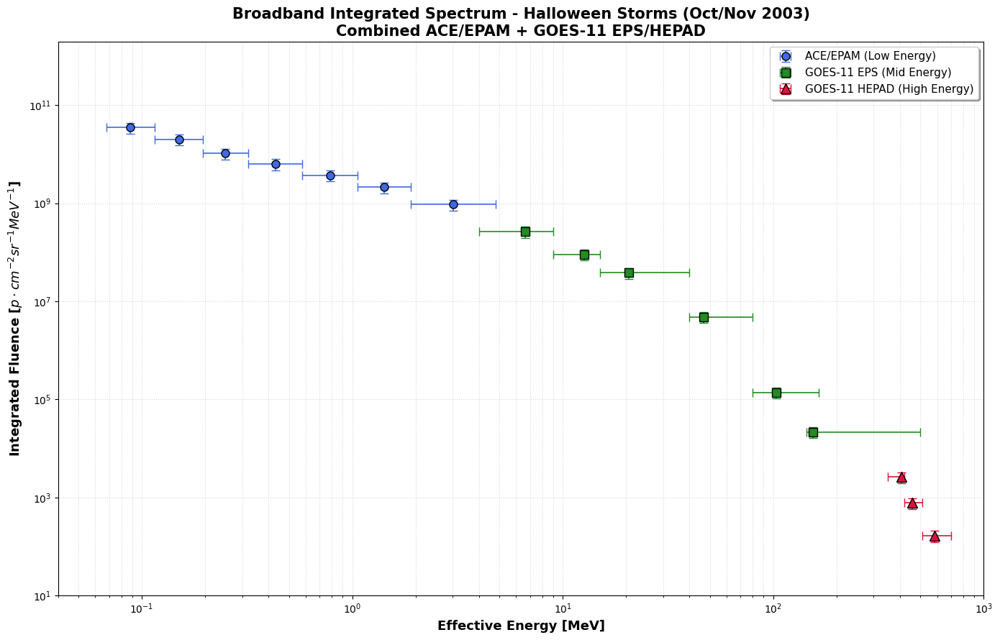

---------------------------------------------------------------------------
Channel  | Instrument   | E_eff (MeV)  | Fluence (p/cm2 sr MeV)
---------------------------------------------------------------------------
P6p      | ACE/EPAM     | 0.784        | 3.74e+09              
P7p      | ACE/EPAM     | 1.419        | 2.14e+09              
P8p      | ACE/EPAM     | 3.020        | 9.40e+08              
P2       | EPS          | 6.643        | 2.64e+08              
P3       | EPS          | 12.610       | 9.04e+07              


In [5]:
# =================================================================
# UNIONE DATASET E PLOT BROADBAND CONTROLLO - HALLOWEEN 2003
# ACE/EPAM + GOES-11 EPS/HEPAD (Senza P1p)
# =================================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# 1. UNIONE DEI DATAFRAME
# Combiniamo le fluenze calcolate nelle celle precedenti
df_combined_oct2003 = pd.concat([df_fluence_ace_oct2003, df_fluence_goes_oct2003], ignore_index=True)

# Ordinamento rigoroso per energia crescente
df_combined_oct2003 = df_combined_oct2003.sort_values('E_eff').reset_index(drop=True)

# 2. PLOT BROADBAND PROFESSIONALE
plt.figure(figsize=(14, 9))

# Filtri per distinzione strumenti e marker
m_ace   = df_combined_oct2003['Instrument'] == 'ACE/EPAM'
m_eps   = df_combined_oct2003['Instrument'] == 'EPS'
m_hepad = df_combined_oct2003['Instrument'] == 'HEPAD'

# --- ACE/EPAM: Cerchi Blu ---
plt.errorbar(df_combined_oct2003.loc[m_ace, 'E_eff'], 
             df_combined_oct2003.loc[m_ace, 'Fluence'], 
             yerr=df_combined_oct2003.loc[m_ace, 'y_err'], 
             xerr=[df_combined_oct2003.loc[m_ace, 'x_err_low'], df_combined_oct2003.loc[m_ace, 'x_err_high']],
             fmt='o', color='royalblue', markersize=8, capsize=4, elinewidth=1.2,
             markeredgecolor='black', label='ACE/EPAM (Low Energy)')

# --- GOES EPS: Quadrati Verdi ---
plt.errorbar(df_combined_oct2003.loc[m_eps, 'E_eff'], 
             df_combined_oct2003.loc[m_eps, 'Fluence'], 
             yerr=df_combined_oct2003.loc[m_eps, 'y_err'], 
             xerr=[df_combined_oct2003.loc[m_eps, 'x_err_low'], df_combined_oct2003.loc[m_eps, 'x_err_high']],
             fmt='s', color='forestgreen', markersize=8, capsize=4, elinewidth=1.2,
             markeredgecolor='black', label='GOES-11 EPS (Mid Energy)')

# --- GOES HEPAD: Triangoli Rossi ---
plt.errorbar(df_combined_oct2003.loc[m_hepad, 'E_eff'], 
             df_combined_oct2003.loc[m_hepad, 'Fluence'], 
             yerr=df_combined_oct2003.loc[m_hepad, 'y_err'], 
             xerr=[df_combined_oct2003.loc[m_hepad, 'x_err_low'], df_combined_oct2003.loc[m_hepad, 'x_err_high']],
             fmt='^', color='crimson', markersize=10, capsize=4, elinewidth=1.2,
             markeredgecolor='black', label='GOES-11 HEPAD (High Energy)')

# Configurazione Assi e Griglia
plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.5)

plt.xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=13)
plt.ylabel(r"Integrated Fluence [$p \cdot cm^{-2} sr^{-1} MeV^{-1}$]", fontweight='bold', fontsize=13)
plt.title("Broadband Integrated Spectrum - Halloween Storms (Oct/Nov 2003)\nCombined ACE/EPAM + GOES-11 EPS/HEPAD", fontsize=15, fontweight='bold')

plt.xlim(0.04, 1000)
plt.ylim(1e1, 2e12)

plt.legend(loc='upper right', shadow=True, fontsize=11)
plt.tight_layout()
plt.show()

# 3. TABELLA DI VERIFICA RACCORDO
print("-" * 75)
print(f"{'Channel':<8} | {'Instrument':<12} | {'E_eff (MeV)':<12} | {'Fluence (p/cm2 sr MeV)':<22}")
print("-" * 75)
# Mostriamo i punti vicini al raccordo ACE/GOES (intorno a 1-10 MeV)
raccordo = df_combined_oct2003[(df_combined_oct2003['E_eff'] > 0.5) & (df_combined_oct2003['E_eff'] < 20)]
for _, row in raccordo.iterrows():
    print(f"{row['Channel']:<8} | {row['Instrument']:<12} | {row['E_eff']:<12.3f} | {row['Fluence']:<22.2e}")

# FIT UNICO e cella EXPORT SRNIEl


--- INIZIO ELABORAZIONE FINALE (BAND FUNCTION): OTTOBRE 2003 ---


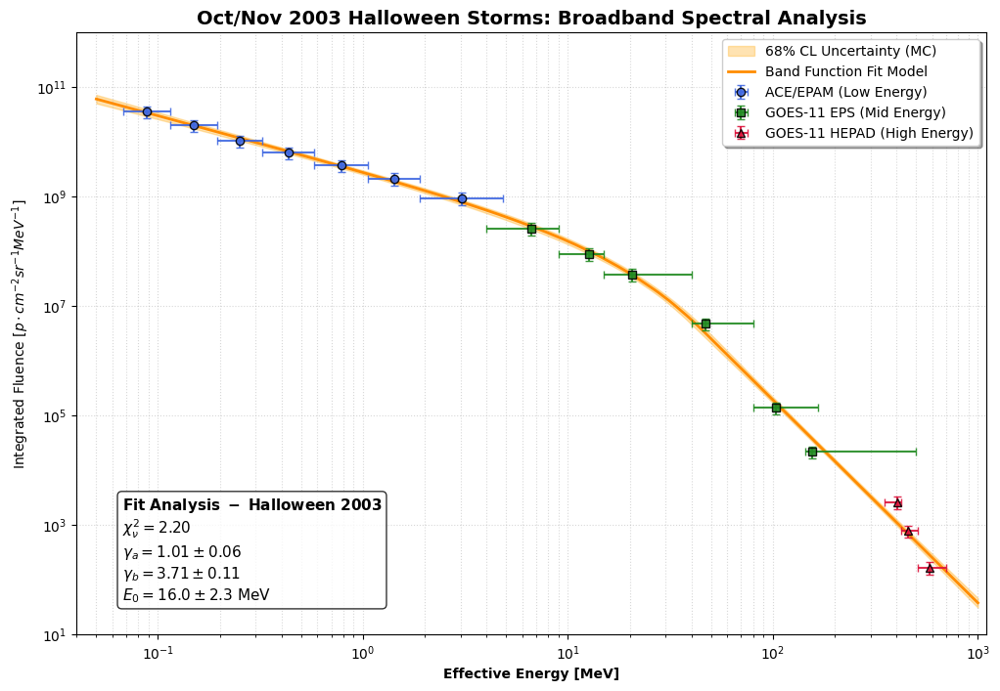

--- ANALISI COMPLETATA ---
Export completato con successo nella cartella: OCT2003_Export_finale_2026_usare_questo
Parametri Ottimizzati: ga=1.01, gb=3.71, E0=16.0 MeV


In [6]:
# ============================================================
# ANALISI DEFINITIVA OCT/NOV 2003: FIT (BAND FUNCTION) E MC
# ERRORE: 25% SISTEMATICO + POISSONIANO | ACE + EPS + HEPAD
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from scipy.optimize import curve_fit
from scipy.linalg import eigh

# 1. MODELLI FISICI ROBUSTI (LOG-SPACE)
def log_band(E, logA, ga, gb, E0):
    E0_s = np.clip(E0, 0.1, 1000)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E)
    mask = E <= ebreak
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

def band_linear(E, *p):
    return 10**log_band(E, *p)

print("\n--- INIZIO ELABORAZIONE FINALE (BAND FUNCTION): OTTOBRE 2003 ---")

# --- 2. PREPARAZIONE DATI ---
# Usiamo il dataset combinato di Ottobre 2003 creato nella cella precedente
E_tot = df_combined_oct2003['E_eff'].values
Y_tot = df_combined_oct2003['Fluence'].values

# CALCOLO ERRORE SCIENTIFICO: 25% Sistematico + Poissoniano
Yerr_tot = np.sqrt((0.25 * Y_tot)**2 + Y_tot)
sigma_log = Yerr_tot / (Y_tot * np.log(10))

# --- 3. ESECUZIONE FIT ---
# p0: [log10A, ga, gb, E0]
p0 = [11.0, 1.1, 2.5, 20.0]
bounds = ([8, 0.1, 1.5, 1.0], [15, 2.5, 6.0, 500])

try:
    popt, pcov = curve_fit(log_band, E_tot, np.log10(Y_tot), p0=p0, 
                           sigma=sigma_log, absolute_sigma=True, bounds=bounds, maxfev=20000)
except Exception as e:
    print(f"Errore Fit: {e}")
    popt, pcov = None, None

if popt is not None:
    perr = np.sqrt(np.diag(pcov))
    residuals = (np.log10(Y_tot) - log_band(E_tot, *popt)) / sigma_log
    chi2red = np.sum(residuals**2) / (len(E_tot) - len(popt))

    # --- 4. MONTE CARLO ---
    E_grid = np.logspace(np.log10(0.05), 3, 500)
    N_MC = 1000
    clean_cov = (pcov + pcov.T) / 2
    vals, vecs = eigh(clean_cov)
    vals = np.maximum(vals, 1e-12 * np.max(vals))
    stable_cov = vecs @ np.diag(vals) @ vecs.T
    mc_params = np.random.default_rng(42).multivariate_normal(popt, stable_cov, N_MC)
    mc_fits = np.array([band_linear(E_grid, *p) for p in mc_params])
    Phi_med = np.median(mc_fits, axis=0)
    Phi_lo, Phi_hi = np.percentile(mc_fits, [16, 84], axis=0)

    # --- 5. PLOT PROFESSIONALE ---
    plt.figure(figsize=(12, 8))
    # Banda di incertezza MC
    plt.fill_between(E_grid, Phi_lo, Phi_hi, color='orange', alpha=0.3, label='68% CL Uncertainty (MC)')
    # Curva di fit mediana
    plt.plot(E_grid, Phi_med, color='darkorange', lw=2, label="Band Function Fit Model")

    # Definizione stili per i 3 strumenti (Markers richiesti)
    instruments = [
        ('ACE/EPAM', 'royalblue', 'o', 'ACE/EPAM (Low Energy)'),
        ('EPS', 'forestgreen', 's', 'GOES-11 EPS (Mid Energy)'),
        ('HEPAD', 'crimson', '^', 'GOES-11 HEPAD (High Energy)')
    ]

    for inst_key, color, marker, label in instruments:
        m = df_combined_oct2003['Instrument'] == inst_key
        if m.any():
            plt.errorbar(df_combined_oct2003.loc[m, 'E_eff'], df_combined_oct2003.loc[m, 'Fluence'], 
                         yerr=Yerr_tot[m], 
                         xerr=[df_combined_oct2003.loc[m, 'x_err_low'], df_combined_oct2003.loc[m, 'x_err_high']], 
                         fmt=marker, color=color, label=label, alpha=0.9, capsize=3, markeredgecolor='black')

    # Box Parametri (LaTeX)
    stats_box = (
        r"$\bf{Fit\ Analysis\ -\ Halloween\ 2003}$" + "\n" +
        r"$\chi^2_\nu = %.2f$" % chi2red + "\n" +
        r"$\gamma_a = %.2f \pm %.2f$" % (popt[1], perr[1]) + "\n" +
        r"$\gamma_b = %.2f \pm %.2f$" % (popt[2], perr[2]) + "\n" +
        r"$E_0 = %.1f \pm %.1f$ MeV" % (popt[3], perr[3])
    )
    plt.gca().text(0.05, 0.05, stats_box, transform=plt.gca().transAxes, fontsize=11, 
                   verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

    plt.xscale("log"); plt.yscale("log"); plt.xlim(0.04, 1100); plt.ylim(1e1, 1e12)
    plt.xlabel("Effective Energy [MeV]", fontweight='bold'); plt.ylabel(r"Integrated Fluence $[p \cdot cm^{-2} sr^{-1} MeV^{-1}]$")
    plt.title("Oct/Nov 2003 Halloween Storms: Broadband Spectral Analysis", fontsize=14, fontweight='bold')
    plt.grid(True, which="both", ls=':', alpha=0.5); plt.legend(loc="upper right", shadow=True); plt.show()

    # --- 6. EXPORT SR-NIEL ---
    out_dir = "OCT2003_Export_finale_2026_usare_questo"
    if not os.path.exists(out_dir): os.makedirs(out_dir)
    for geo, factor in {"Planare": np.pi, "Sferica": 4*np.pi}.items():
        np.savetxt(f"{out_dir}/OCT03_Band_{geo}_Median.txt", np.column_stack([E_grid, factor*Phi_med]), fmt="%.6e",
                   header=f"Energy(MeV) {geo}_Fluence(cm^-2*MeV^-1)")
        np.savetxt(f"{out_dir}/OCT03_Band_{geo}_CL68.txt", np.column_stack([E_grid, factor*Phi_lo, factor*Phi_hi]), fmt="%.6e",
                   header="Energy(MeV) Phi16 Phi84")
    
    print(f"--- ANALISI COMPLETATA ---")
    print(f"Export completato con successo nella cartella: {out_dir}")
    print(f"Parametri Ottimizzati: ga={popt[1]:.2f}, gb={popt[2]:.2f}, E0={popt[3]:.1f} MeV")

# J(E)

In [9]:
# ============================================================
# CALCOLO FLUENZE INTEGRALI — OCT 2003
# ============================================================

E_int = np.logspace(np.log10(0.5), 3, 5000)
phi_diff = band_linear(E_int, *popt)

print("\n--- FLUENZE INTEGRALI OCT 2003 (omnidirezionali, ×4π sr) ---")
for E_thresh in [10, 30, 60, 100, 500]:
    mask = E_int >= E_thresh
    J_omni = 4 * np.pi * np.trapezoid(phi_diff[mask], E_int[mask])
    print(f"  J(>{E_thresh} MeV) = {J_omni:.3e} cm⁻²")


--- FLUENZE INTEGRALI OCT 2003 (omnidirezionali, ×4π sr) ---
  J(>10 MeV) = 1.564e+10 cm⁻²
  J(>30 MeV) = 2.266e+09 cm⁻²
  J(>60 MeV) = 3.617e+08 cm⁻²
  J(>100 MeV) = 9.068e+07 cm⁻²
  J(>500 MeV) = 9.865e+05 cm⁻²


# COMPARAZIONE FIT con HEPAD e FIT senza HEPAD


PREPARAZIONE FIT A: ACE + EPS (NO HEPAD)

FIT A (ACE+EPS, NO HEPAD)
Punti: 13
Range: 0.088 - 154.6 MeV
✓ Fit convergito

✓ Export completato: FINAL_OCT2003_BAND_EXPORT_FIT_A_noHEPAD

PREPARAZIONE FIT B: ACE + EPS + HEPAD (TUTTI)

FIT B (ACE+EPS+HEPAD, COMPLETO)
Punti: 16
Range: 0.088 - 583.0 MeV
✓ Fit convergito

✓ Export completato: FINAL_OCT2003_BAND_EXPORT_FIT_B_withHEPAD

CONFRONTO PARAMETRI FIT A vs FIT B
PARAMETRO       | FIT A (no HEPAD)       | FIT B (con HEPAD)      | LETTERATURA    
-------------------------------------------------------------------------------------
Punti           | 13                     | 16                     | -              
log₁₀A          | 9.45 ± 0.04           | 9.47 ± 0.04           | ~11-12         
γₐ (low-E)      | 1.04 ± 0.06           | 1.01 ± 0.06           | 1.0-1.2        
γᵦ (high-E)     | 4.62 ± 0.54           | 3.71 ± 0.11           | 3.5-4.5        
E₀ (break)      | 18.8 ± 2.8 MeV       | 16.0 ± 2.3 MeV       | 100-200 MeV    
χ²_ν 

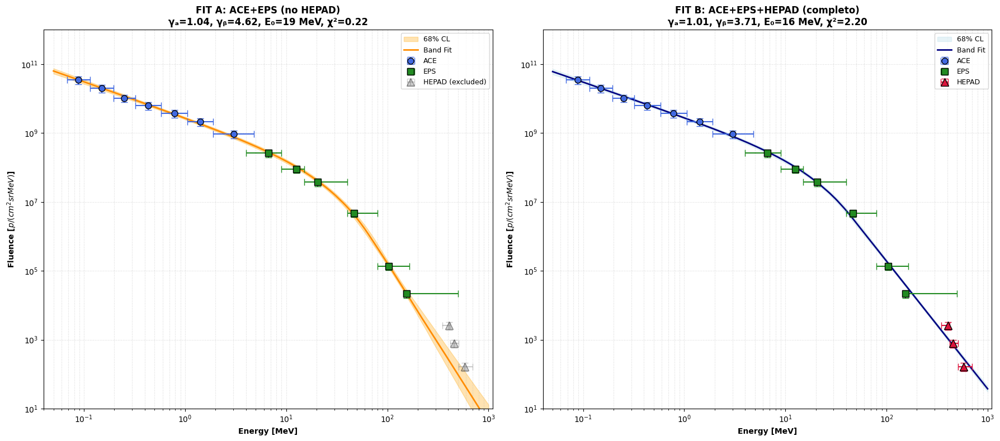


✓ ANALISI COMPARATIVA COMPLETATA

Prossimo step: Scegli FIT migliore e procedi con SR-NIEL!


In [15]:
# ============================================================
# ANALISI COMPARATIVA OCT 2003: FIT A (no HEPAD) vs FIT B (con HEPAD)
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from scipy.optimize import curve_fit
from scipy.linalg import eigh

# ==========================================
# 1. MODELLO BAND FUNCTION
# ==========================================
def log_band(E, logA, ga, gb, E0):
    E0_s = np.clip(E0, 0.1, 1000)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E)
    mask = E <= ebreak
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

def band_linear(E, *p):
    return 10**log_band(E, *p)

# ==========================================
# 2. FUNZIONE FIT GENERICA
# ==========================================
def run_band_fit(df_data, label, p0, bounds, export_suffix):
    """
    Esegue fit Band Function + Monte Carlo + Export
    
    Args:
        df_data: DataFrame con fluenze
        label: Etichetta descrittiva
        p0: Initial guess [logA, ga, gb, E0]
        bounds: Bounds per parametri
        export_suffix: Suffisso per export files
    
    Returns:
        dict con risultati completi
    """
    E_tot = df_data['E_eff'].values
    Y_tot = df_data['Fluence'].values
    
    # Errori
    Yerr_tot = np.sqrt((0.25 * Y_tot)**2 + Y_tot)
    sigma_log = Yerr_tot / (Y_tot * np.log(10))
    
    print(f"\n{'='*70}")
    print(f"FIT {label}")
    print(f"{'='*70}")
    print(f"Punti: {len(E_tot)}")
    print(f"Range: {E_tot.min():.3f} - {E_tot.max():.1f} MeV")
    
    # Fit
    try:
        popt, pcov = curve_fit(log_band, E_tot, np.log10(Y_tot), 
                               p0=p0, sigma=sigma_log, 
                               absolute_sigma=True, bounds=bounds, 
                               maxfev=20000)
        print("✓ Fit convergito\n")
    except Exception as e:
        print(f"❌ Errore: {e}")
        return None
    
    perr = np.sqrt(np.diag(pcov))
    residuals = (np.log10(Y_tot) - log_band(E_tot, *popt)) / sigma_log
    chi2red = np.sum(residuals**2) / (len(E_tot) - len(popt))
    
    # Monte Carlo
    E_grid = np.logspace(np.log10(0.05), 3, 500)
    N_MC = 1000
    
    clean_cov = (pcov + pcov.T) / 2
    vals, vecs = eigh(clean_cov)
    vals = np.maximum(vals, 1e-12 * np.max(vals))
    stable_cov = vecs @ np.diag(vals) @ vecs.T
    
    mc_params = np.random.default_rng(42).multivariate_normal(popt, stable_cov, N_MC)
    mc_fits = np.array([band_linear(E_grid, *p) for p in mc_params])
    
    Phi_med = np.median(mc_fits, axis=0)
    Phi_lo, Phi_hi = np.percentile(mc_fits, [16, 84], axis=0)
    
    # Export SR-NIEL
    out_dir = f"FINAL_OCT2003_BAND_EXPORT_{export_suffix}"
    if not os.path.exists(out_dir):
        os.makedirs(out_dir)
    
    for geo, factor in {"Planare": np.pi, "Sferica": 4*np.pi}.items():
        np.savetxt(f"{out_dir}/OCT03_Band_{geo}_Median.txt", 
                   np.column_stack([E_grid, factor*Phi_med]), 
                   fmt="%.6e",
                   header=f"Energy(MeV) {geo}_Fluence(cm^-2*MeV^-1)")
        
        np.savetxt(f"{out_dir}/OCT03_Band_{geo}_CL68.txt", 
                   np.column_stack([E_grid, factor*Phi_lo, factor*Phi_hi]), 
                   fmt="%.6e",
                   header="Energy(MeV) Phi16 Phi84")
    
    print(f"✓ Export completato: {out_dir}")
    
    return {
        'label': label,
        'popt': popt,
        'perr': perr,
        'chi2red': chi2red,
        'E_grid': E_grid,
        'Phi_med': Phi_med,
        'Phi_lo': Phi_lo,
        'Phi_hi': Phi_hi,
        'E_data': E_tot,
        'Y_data': Y_tot,
        'Yerr_data': Yerr_tot,
        'df_data': df_data,
        'export_dir': out_dir
    }

# ==========================================
# 3. FIT A: ACE + EPS (NO HEPAD)
# ==========================================
print("\n" + "="*70)
print("PREPARAZIONE FIT A: ACE + EPS (NO HEPAD)")
print("="*70)

df_fit_A = df_combined_oct2003[
    df_combined_oct2003['Instrument'] != 'HEPAD'
].copy()

result_A = run_band_fit(
    df_fit_A,
    label="A (ACE+EPS, NO HEPAD)",
    p0=[11.5, 1.1, 3.5, 100.0],  # Aspetto steep rollover senza HEPAD
    bounds=([9, 0.5, 2.0, 10], [14, 2.0, 6.0, 500]),
    export_suffix="FIT_A_noHEPAD"
)

# ==========================================
# 4. FIT B: ACE + EPS + HEPAD (TUTTI)
# ==========================================
print("\n" + "="*70)
print("PREPARAZIONE FIT B: ACE + EPS + HEPAD (TUTTI)")
print("="*70)

df_fit_B = df_combined_oct2003.copy()  # Tutti i punti

result_B = run_band_fit(
    df_fit_B,
    label="B (ACE+EPS+HEPAD, COMPLETO)",
    p0=[11.5, 1.1, 2.8, 20.0],  # HEPAD modera tail
    bounds=([9, 0.5, 1.5, 5], [14, 2.0, 5.0, 200]),
    export_suffix="FIT_B_withHEPAD"
)

# ==========================================
# 5. CONFRONTO PARAMETRI
# ==========================================
print("\n" + "="*70)
print("CONFRONTO PARAMETRI FIT A vs FIT B")
print("="*70)
print(f"{'PARAMETRO':<15} | {'FIT A (no HEPAD)':<22} | {'FIT B (con HEPAD)':<22} | {'LETTERATURA':<15}")
print("-"*85)

if result_A and result_B:
    print(f"{'Punti':<15} | {len(result_A['E_data']):<22} | {len(result_B['E_data']):<22} | {'-':<15}")
    print(f"{'log₁₀A':<15} | {result_A['popt'][0]:.2f} ± {result_A['perr'][0]:.2f}           | "
          f"{result_B['popt'][0]:.2f} ± {result_B['perr'][0]:.2f}           | {'~11-12':<15}")
    print(f"{'γₐ (low-E)':<15} | {result_A['popt'][1]:.2f} ± {result_A['perr'][1]:.2f}           | "
          f"{result_B['popt'][1]:.2f} ± {result_B['perr'][1]:.2f}           | {'1.0-1.2':<15}")
    print(f"{'γᵦ (high-E)':<15} | {result_A['popt'][2]:.2f} ± {result_A['perr'][2]:.2f}           | "
          f"{result_B['popt'][2]:.2f} ± {result_B['perr'][2]:.2f}           | {'3.5-4.5':<15}")
    print(f"{'E₀ (break)':<15} | {result_A['popt'][3]:.1f} ± {result_A['perr'][3]:.1f} MeV       | "
          f"{result_B['popt'][3]:.1f} ± {result_B['perr'][3]:.1f} MeV       | {'100-200 MeV':<15}")
    print(f"{'χ²_ν':<15} | {result_A['chi2red']:.2f}                   | "
          f"{result_B['chi2red']:.2f}                   | {'~1.0':<15}")
    
    print("\n" + "="*70)
    print("RACCOMANDAZIONE:")
    
    # Decide quale fit è migliore
    if result_A['chi2red'] < result_B['chi2red'] and abs(result_A['popt'][2] - 4.0) < abs(result_B['popt'][2] - 4.0):
        print("✓ FIT A (no HEPAD) raccomandato:")
        print("  - χ² inferiore")
        print("  - γᵦ più vicino a letteratura (3.5-4.5)")
        print(f"  - Usa: {result_A['export_dir']}")
    else:
        print("⚠️ FIT B (con HEPAD) potenzialmente migliore:")
        print("  - Coverage energetico completo")
        print(f"  - Verifica se γᵦ~{result_B['popt'][2]:.1f} è ragionevole")
        print(f"  - Usa: {result_B['export_dir']}")

# ==========================================
# 6. PLOT COMPARATIVO
# ==========================================
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))

# ===== PLOT FIT A (NO HEPAD) =====
if result_A:
    ax1.fill_between(result_A['E_grid'], result_A['Phi_lo'], result_A['Phi_hi'], 
                     color='orange', alpha=0.3, label='68% CL')
    ax1.plot(result_A['E_grid'], result_A['Phi_med'], 
             color='darkorange', lw=2, label='Band Fit')
    
    # Plot dati
    for inst, color, marker, lbl in [
        ('ACE/EPAM', 'royalblue', 'o', 'ACE'),
        ('EPS', 'forestgreen', 's', 'EPS')
    ]:
        m = result_A['df_data']['Instrument'] == inst
        if m.any():
            ax1.errorbar(result_A['df_data'].loc[m, 'E_eff'], 
                        result_A['df_data'].loc[m, 'Fluence'], 
                        yerr=result_A['Yerr_data'][m], 
                        xerr=[result_A['df_data'].loc[m, 'x_err_low'], 
                              result_A['df_data'].loc[m, 'x_err_high']],
                        fmt=marker, color=color, markersize=8, 
                        capsize=4, markeredgecolor='black', label=lbl)
    
    # HEPAD grigi (excluded)
    df_hepad = df_combined_oct2003[df_combined_oct2003['Instrument']=='HEPAD']
    ax1.errorbar(df_hepad['E_eff'], df_hepad['Fluence'], 
                yerr=np.sqrt((0.25*df_hepad['Fluence'])**2 + df_hepad['Fluence']),
                xerr=[df_hepad['x_err_low'], df_hepad['x_err_high']],
                fmt='^', color='gray', markersize=10, alpha=0.4,
                capsize=4, markeredgecolor='black', label='HEPAD (excluded)')
    
    ax1.set_xscale('log'); ax1.set_yscale('log')
    ax1.set_xlim(0.04, 1100); ax1.set_ylim(1e1, 1e12)
    ax1.set_xlabel("Energy [MeV]", fontweight='bold')
    ax1.set_ylabel(r"Fluence [$p/(cm^2 sr MeV)$]", fontweight='bold')
    ax1.set_title(f"FIT A: ACE+EPS (no HEPAD)\n" +
                  f"γₐ={result_A['popt'][1]:.2f}, γᵦ={result_A['popt'][2]:.2f}, " +
                  f"E₀={result_A['popt'][3]:.0f} MeV, χ²={result_A['chi2red']:.2f}",
                  fontweight='bold')
    ax1.grid(True, which='both', ls=':', alpha=0.5)
    ax1.legend(fontsize=9)

# ===== PLOT FIT B (CON HEPAD) =====
if result_B:
    ax2.fill_between(result_B['E_grid'], result_B['Phi_lo'], result_B['Phi_hi'], 
                     color='lightblue', alpha=0.3, label='68% CL')
    ax2.plot(result_B['E_grid'], result_B['Phi_med'], 
             color='navy', lw=2, label='Band Fit')
    
    # Plot dati (tutti)
    for inst, color, marker, lbl in [
        ('ACE/EPAM', 'royalblue', 'o', 'ACE'),
        ('EPS', 'forestgreen', 's', 'EPS'),
        ('HEPAD', 'crimson', '^', 'HEPAD')
    ]:
        m = result_B['df_data']['Instrument'] == inst
        if m.any():
            ax2.errorbar(result_B['df_data'].loc[m, 'E_eff'], 
                        result_B['df_data'].loc[m, 'Fluence'], 
                        yerr=result_B['Yerr_data'][m], 
                        xerr=[result_B['df_data'].loc[m, 'x_err_low'], 
                              result_B['df_data'].loc[m, 'x_err_high']],
                        fmt=marker, color=color, 
                        markersize=8 if marker!= '^' else 10,
                        capsize=4, markeredgecolor='black', label=lbl)
    
    ax2.set_xscale('log'); ax2.set_yscale('log')
    ax2.set_xlim(0.04, 1100); ax2.set_ylim(1e1, 1e12)
    ax2.set_xlabel("Energy [MeV]", fontweight='bold')
    ax2.set_ylabel(r"Fluence [$p/(cm^2 sr MeV)$]", fontweight='bold')
    ax2.set_title(f"FIT B: ACE+EPS+HEPAD (completo)\n" +
                  f"γₐ={result_B['popt'][1]:.2f}, γᵦ={result_B['popt'][2]:.2f}, " +
                  f"E₀={result_B['popt'][3]:.0f} MeV, χ²={result_B['chi2red']:.2f}",
                  fontweight='bold')
    ax2.grid(True, which='both', ls=':', alpha=0.5)
    ax2.legend(fontsize=9)

plt.tight_layout()
plt.show()

print("\n✓ ANALISI COMPARATIVA COMPLETATA")
print("\nProssimo step: Scegli FIT migliore e procedi con SR-NIEL!")


# CALCOLO DOSE SRNIEL

# PLANAR SHIELDING 37mm Al 

# Cella per estrarre Phi16 Phi84 bande

In [17]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "OCT2003_Export_finale_2026_usare_questo/Planar/OCT03_Band_Planare_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
5.000000e-02 1.585239e+11
5.100225e-02 1.554174e+11
5.202458e-02 1.524187e+11
5.306741e-02 1.495110e+11
5.413114e-02 1.467060e+11
5.521620e-02 1.440271e+11
5.632300e-02 1.413734e+11
5.745199e-02 1.387775e+11
5.860361e-02 1.361292e+11
5.977832e-02 1.335765e+11
6.097657e-02 1.310681e+11
6.219884e-02 1.285496e+11
6.344561e-02 1.261370e+11
6.471737e-02 1.237694e+11
6.601463e-02 1.214642e+11
6.733789e-02 1.190608e+11
6.868767e-02 1.168176e+11
7.006451e-02 1.145781e+11
7.146895e-02 1.124109e+11
7.290154e-02 1.102982e+11
7.436284e-02 1.082400e+11
7.585344e-02 1.061174e+11
7.737392e-02 1.041925e+11
7.892487e-02 1.022767e+11
8.050691e-02 1.003443e+11
8.212067e-02 9.841305e+10
8.376677e-02 9.655036e+10
8.544587e-02 9.472474e+10
8.715862e-02 9.286110e+10
8.890571e-02 9.112491e+10
9.068782e-02 8.943312e+10
9.250565e-02 8.772890e+10
9.435992e-02 8.60548

# CALCOLO dose 
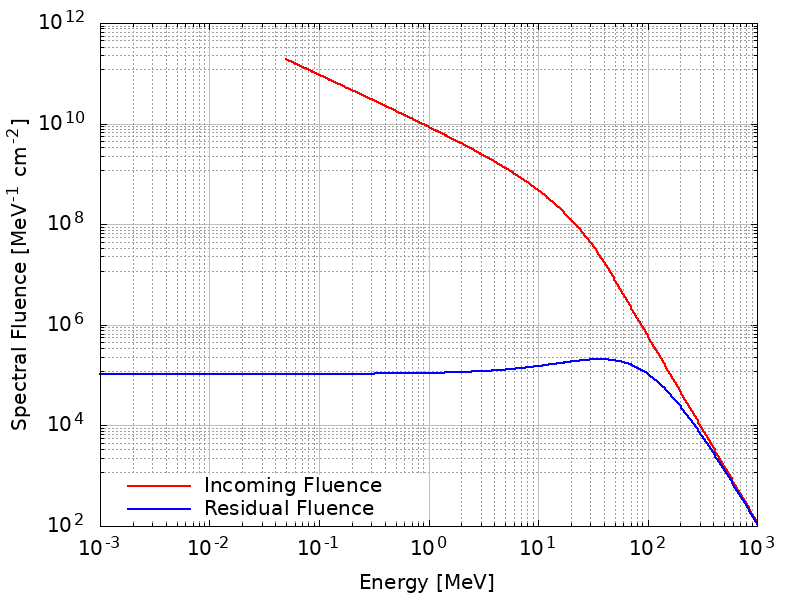

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  OCT 2003
Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)
Dose Mediana: 51.9479 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [43.603 - 61.476] mGy
Incertezza Totale: +9.528 / -8.345 mGy
-----------------------------------------------------------------


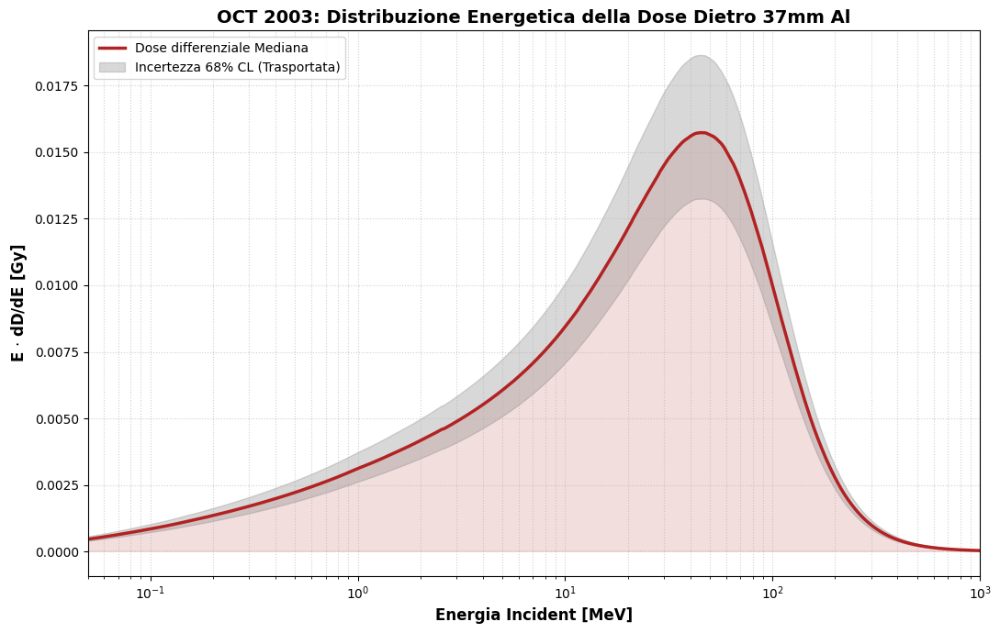

In [18]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "OCT2003_Export_finale_2026_usare_questo/Planar/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "Median_residual_planar.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "Phi16_residual_planar.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "Phi84_residual_planar.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  OCT 2003")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("OCT 2003: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.05, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# SPHERICAL SHIELDING 

In [19]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "OCT2003_Export_finale_2026_usare_questo/Spherical/OCT03_Band_Sferica_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
5.000000e-02 6.340957e+11
5.100225e-02 6.216698e+11
5.202458e-02 6.096750e+11
5.306741e-02 5.980440e+11
5.413114e-02 5.868239e+11
5.521620e-02 5.761085e+11
5.632300e-02 5.654936e+11
5.745199e-02 5.551099e+11
5.860361e-02 5.445167e+11
5.977832e-02 5.343058e+11
6.097657e-02 5.242722e+11
6.219884e-02 5.141986e+11
6.344561e-02 5.045478e+11
6.471737e-02 4.950774e+11
6.601463e-02 4.858567e+11
6.733789e-02 4.762431e+11
6.868767e-02 4.672702e+11
7.006451e-02 4.583125e+11
7.146895e-02 4.496437e+11
7.290154e-02 4.411929e+11
7.436284e-02 4.329602e+11
7.585344e-02 4.244694e+11
7.737392e-02 4.167701e+11
7.892487e-02 4.091067e+11
8.050691e-02 4.013773e+11
8.212067e-02 3.936522e+11
8.376677e-02 3.862014e+11
8.544587e-02 3.788990e+11
8.715862e-02 3.714444e+11
8.890571e-02 3.644996e+11
9.068782e-02 3.577325e+11
9.250565e-02 3.509156e+11
9.435992e-02 3.44219

# calcolo dose spherical 
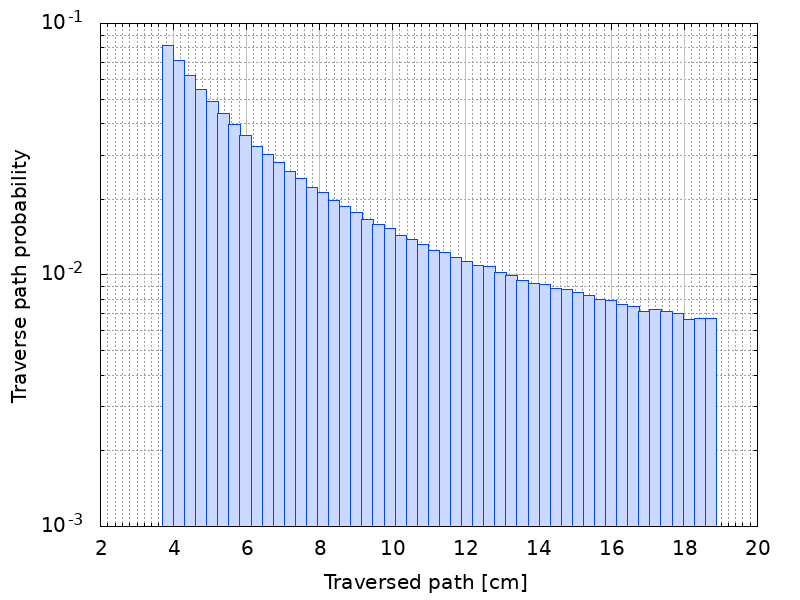
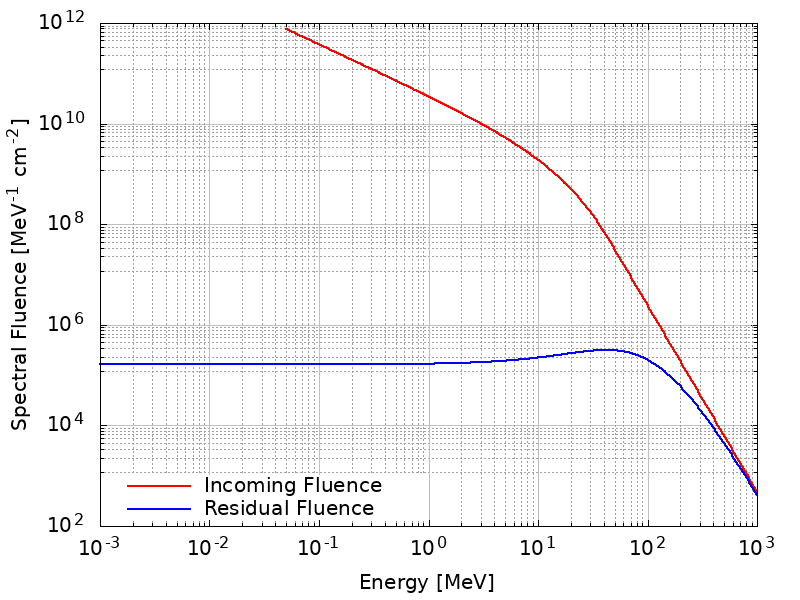

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  OCT 2003
Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)
Dose Mediana: 83.9494 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [70.822 - 98.741] mGy
Incertezza Totale: +14.791 / -13.127 mGy
-----------------------------------------------------------------


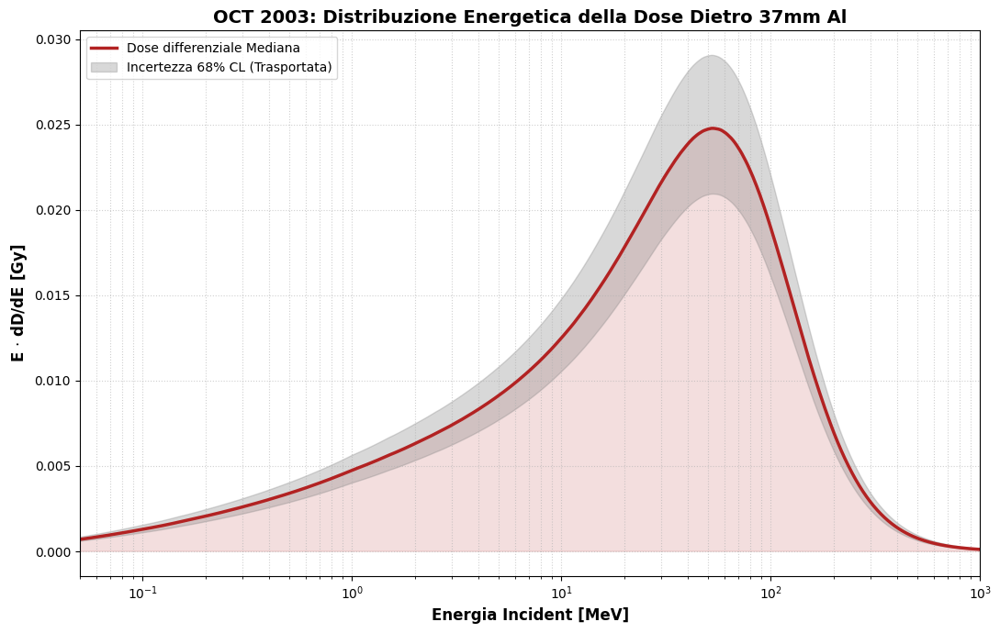

In [20]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "OCT2003_Export_finale_2026_usare_questo/Spherical/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "Median_residual_spherical.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "Phi16_residual_spherical.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "Phi84_residual_spherical.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  OCT 2003")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("OCT 2003: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.05, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# JUL 2012 

# CARICAMENTO DATI HET STEREO-A

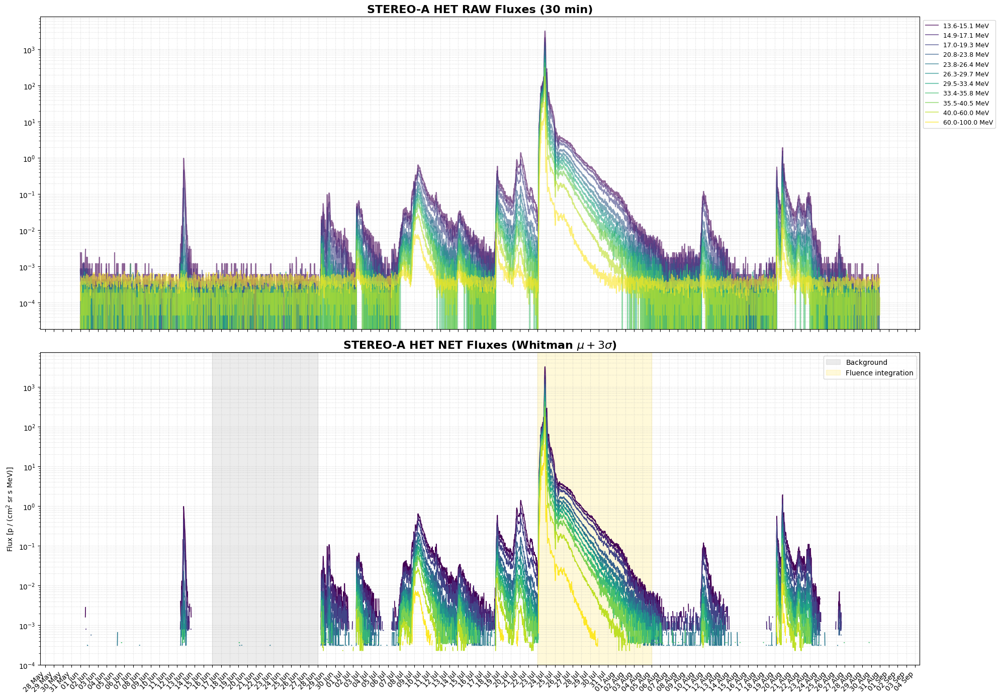

------------------------------------------------------------
CHANNEL (MeV)   | MU           | MU+3SIGMA   
------------------------------------------------------------
13.6-15.1       | 1.955e-04 | 1.214e-03
14.9-17.1       | 6.442e-05 | 5.572e-04
17.0-19.3       | 4.377e-05 | 4.350e-04
20.8-23.8       | 3.291e-05 | 3.392e-04
23.8-26.4       | 2.842e-05 | 3.181e-04
26.3-29.7       | 2.740e-05 | 2.961e-04
29.5-33.4       | 2.906e-05 | 2.765e-04
33.4-35.8       | 2.017e-05 | 2.788e-04
35.5-40.5       | 2.679e-05 | 2.390e-04
40.0-60.0       | 1.351e-04 | 3.615e-04
60.0-100.0      | 4.138e-04 | 7.116e-04


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# ============================================================
# 1. CARICAMENTO DATI STEREO-A HET (RAW 1-min)
# ============================================================
def load_stereo_het_raw(file_path):
    skip = 0
    with open(file_path, 'r') as f:
        for i, line in enumerate(f):
            if "#End" in line:
                skip = i + 1
                break

    df = pd.read_csv(file_path, sep=r'\s+', skiprows=skip, header=None, dtype=str)

    time_str = df[1] + " " + df[2] + " " + df[3] + " " + df[4]
    df['epoch'] = pd.to_datetime(time_str, format='%Y %b %d %H%M', errors='coerce')
    df = df.dropna(subset=['epoch']).set_index('epoch')

    col_mapping = {
        11: '13.6-15.1', 13: '14.9-17.1', 15: '17.0-19.3',
        17: '20.8-23.8', 19: '23.8-26.4', 21: '26.3-29.7',
        23: '29.5-33.4', 25: '33.4-35.8', 27: '35.5-40.5',
        29: '40.0-60.0', 31: '60.0-100.0'
    }

    df_flux = pd.DataFrame(index=df.index)
    for idx, name in col_mapping.items():
        df_flux[name] = pd.to_numeric(df[idx], errors='coerce').clip(lower=0)

    return df_flux


# ============================================================
# 2. CARICAMENTO + RESAMPLING
# ============================================================
path_jun = "File_scaricati_eventiSEP/Evento JUL 2012/AeH12Jun.1m"
path_jul = "File_scaricati_eventiSEP/Evento JUL 2012/AeH12Jul.1m"
path_aug = "File_scaricati_eventiSEP/Evento JUL 2012/AeH12Aug.1m"

df_jun = load_stereo_het_raw(path_jun)
df_jul = load_stereo_het_raw(path_jul)
df_aug = load_stereo_het_raw(path_aug)

df_full = pd.concat([df_jun, df_jul, df_aug]).sort_index()

# Finestra globale di lavoro
t_start, t_end = '2012-06-01', '2012-08-30'

# Resampling a 30 minuti (riduce jitter ma preserva coda SEP)
df_res = df_full.loc[t_start:t_end].resample('30min').mean()


# ============================================================
# 3. DEFINIZIONE BACKGROUND (SCELTA FISICA)
# ============================================================
# Background "quiet", lontano da coda SEP e da evento di Agosto
bg_start, bg_end = '2012-06-16 00:00', '2012-06-28 00:00'

bg = df_res.loc[bg_start:bg_end]

mu = bg.mean()
sigma = bg.std()
threshold = mu + 3 * sigma


# ============================================================
# 4. SERIE NET PER FLUENCE (NO NaN, CODA PRESERVATA)
# ============================================================
# Questa è quella da integrare per fluence e dose
df_net_fluence = (df_res - mu).clip(lower=0)


# ============================================================
# 5. SERIE "WHITMAN CLEANED" (SOLO PER PLOT / TRIGGER)
# ============================================================
df_net_clean = df_res - mu
for col in df_res.columns:
    df_net_clean.loc[df_res[col] < threshold[col], col] = np.nan


# ============================================================
# 6. FINESTRA EVENTO (PER INTEGRAZIONE)
# ============================================================
event_start = '2012-07-23 00:00'
event_end   = '2012-08-05 00:00'   # puoi estendere se includi più coda

df_event_fluence = df_net_fluence.loc[event_start:event_end]


# ============================================================
# 7. PLOT RAW vs NET
# ============================================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 14), sharex=True)
colors = plt.cm.viridis(np.linspace(0, 1, len(df_res.columns)))

# --- RAW ---
for i, col in enumerate(df_res.columns):
    ax1.plot(df_res.index, df_res[col], color=colors[i], alpha=0.6, label=f"{col} MeV")

ax1.set_yscale('log')
ax1.set_title('STEREO-A HET RAW Fluxes (30 min)', fontsize=16, fontweight='bold')
ax1.grid(True, which='both', ls=':', alpha=0.5)
ax1.legend(loc='upper left', bbox_to_anchor=(1,1), fontsize=9)

# --- NET (Whitman cleaned) ---
for i, col in enumerate(df_net_clean.columns):
    ax2.plot(df_net_clean.index, df_net_clean[col], color=colors[i], lw=1.2)

ax2.axvspan(pd.to_datetime(bg_start), pd.to_datetime(bg_end),
            color='gray', alpha=0.15, label='Background')

ax2.axvspan(pd.to_datetime(event_start), pd.to_datetime(event_end),
            color='gold', alpha=0.15, label='Fluence integration')

ax2.set_yscale('log')
ax2.set_ylim(bottom=1e-4)
ax2.set_ylabel(r'Flux [p / (cm$^2$ sr s MeV)]')
ax2.set_title(r'STEREO-A HET NET Fluxes (Whitman $\mu + 3\sigma$)', fontsize=16, fontweight='bold')
ax2.grid(True, which='both', ls=':', alpha=0.5)
ax2.legend()

ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45, ha='right')

plt.tight_layout()
plt.show()


# ============================================================
# 8. STAMPA PARAMETRI BACKGROUND
# ============================================================
print("-" * 60)
print(f"{'CHANNEL (MeV)':<15} | {'MU':<12} | {'MU+3SIGMA':<12}")
print("-" * 60)
for col in df_res.columns:
    print(f"{col:<15} | {mu[col]:.3e} | {threshold[col]:.3e}")


# CALCOLO FLUENZA DATI  HET

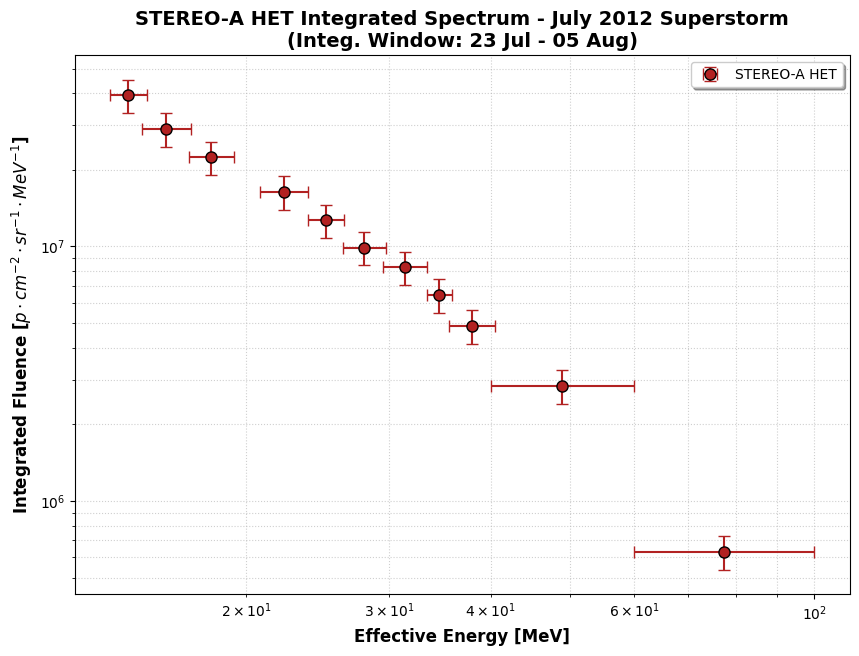

----------------------------------------------------------------------
Channel         | E_eff (MeV)  | Fluence      | y_err % 
----------------------------------------------------------------------
13.6-15.1       | 14.330       | 3.93e+07     | 15.0    %
14.9-17.1       | 15.962       | 2.90e+07     | 15.0    %
17.0-19.3       | 18.114       | 2.24e+07     | 15.0    %
20.8-23.8       | 22.249       | 1.64e+07     | 15.0    %
23.8-26.4       | 25.066       | 1.27e+07     | 15.0    %
26.3-29.7       | 27.948       | 9.90e+06     | 15.0    %
29.5-33.4       | 31.389       | 8.28e+06     | 15.0    %
33.4-35.8       | 34.579       | 6.46e+06     | 15.0    %
35.5-40.5       | 37.918       | 4.88e+06     | 15.0    %
40.0-60.0       | 48.990       | 2.83e+06     | 15.0    %
60.0-100.0      | 77.460       | 6.32e+05     | 15.0    %


In [2]:
# ============================================================
# CALCOLO FLUENZA INTEGRATA STEREO-A HET (JUL 2012)
# Modello: 15% Sys | Resampling: 30min
# ============================================================

# 1. Definizione Bin ed Energie Efficaci (Centri Geometrici)
het_bins = {
    '13.6-15.1': (13.6, 15.1), '14.9-17.1': (14.9, 17.1), '17.0-19.3': (17.0, 19.3),
    '20.8-23.8': (20.8, 23.8), '23.8-26.4': (23.8, 26.4), '26.3-29.7': (26.3, 29.7),
    '29.5-33.4': (29.5, 33.4), '33.4-35.8': (33.4, 35.8), '35.5-40.5': (35.5, 40.5),
    '40.0-60.0': (40.0, 60.0), '60.0-100.0': (60.0, 100.0)
}

# Calcolo automatico E_eff come media geometrica dei bin
het_eff_map = {col: np.sqrt(b[0] * b[1]) for col, b in het_bins.items()}

# 2. Parametri di integrazione
delta_t = 1800  # 30 minuti in secondi
fluence_het_list = []

# Usiamo df_event_fluence creato nella cella precedente (23 Lug - 04 Ago)
for col, e_eff in het_eff_map.items():
    if col in df_event_fluence.columns:
        # Integrazione numerica (Somma flussi * delta_t)
        # fillna(0) è vitale per gestire eventuali buchi nella serie pulita
        f_val = df_event_fluence[col].fillna(0).sum() * delta_t
        
        if f_val > 0:
            e_min, e_max = het_bins[col]
            
            # --- Incertezza Energia (x_err) ---
            x_err_low = abs(e_eff - e_min)
            x_err_high = abs(e_max - e_eff)
            
            # --- Incertezza Fluenza (y_err) ---
            # 15% Errore Sistematico (standard per HET)
            y_err_val = 0.15 * f_val
            
            fluence_het_list.append({
                'Channel': col,
                'E_eff': e_eff,
                'Fluence': f_val,
                'y_err': y_err_val,
                'x_err_low': x_err_low,
                'x_err_high': x_err_high,
                'Instrument': 'HET'
            })

# Creazione DataFrame Fluenza
df_fluence_het_2012 = pd.DataFrame(fluence_het_list).sort_values('E_eff')

# ============================================================
# 3. PLOT DI CONTROLLO SPETTRO HET
# ============================================================
plt.figure(figsize=(10, 7))

plt.errorbar(df_fluence_het_2012['E_eff'], df_fluence_het_2012['Fluence'], 
             yerr=df_fluence_het_2012['y_err'], 
             xerr=[df_fluence_het_2012['x_err_low'], df_fluence_het_2012['x_err_high']],
             fmt='o', color='firebrick', markersize=8, capsize=4, elinewidth=1.5, 
             markeredgecolor='black', label='STEREO-A HET')

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.6)

plt.xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=12)
plt.ylabel(r"Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]", fontweight='bold', fontsize=12)
plt.title("STEREO-A HET Integrated Spectrum - July 2012 Superstorm\n(Integ. Window: 23 Jul - 05 Aug)", fontsize=14, fontweight='bold')

plt.legend(loc='upper right', shadow=True)
plt.show()

# Verifica tabellare per il raccordo futuro con LET
print("-" * 70)
print(f"{'Channel':<15} | {'E_eff (MeV)':<12} | {'Fluence':<12} | {'y_err %':<8}")
print("-" * 70)
for _, row in df_fluence_het_2012.iterrows():
    err_pct = (row['y_err'] / row['Fluence']) * 100
    print(f"{row['Channel']:<15} | {row['E_eff']:<12.3f} | {row['Fluence']:<12.2e} | {err_pct:<8.1f}%")

# CARICAMENTO DATI LET 

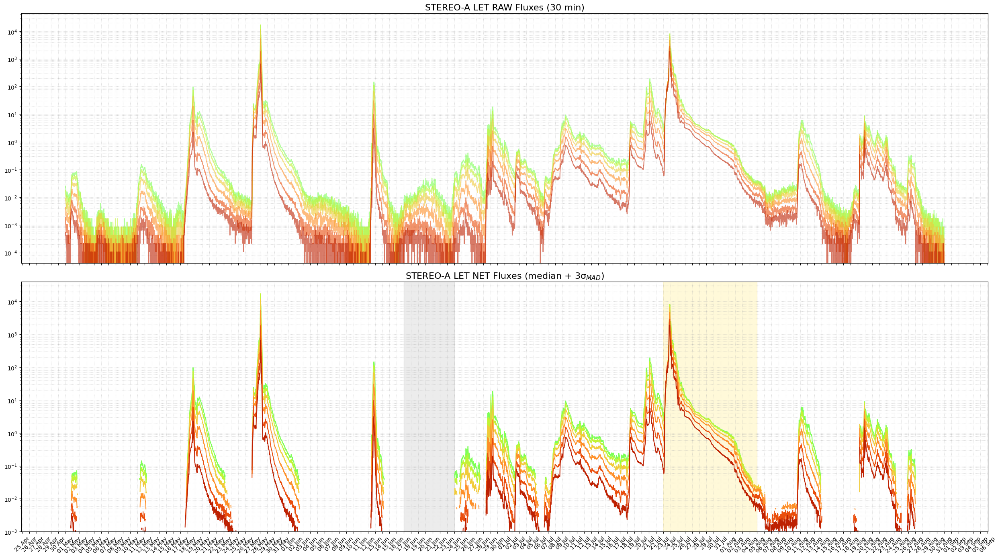

-----------------------------------------------------------------
CHANNEL (MeV)   | MU           | THRESHOLD   
-----------------------------------------------------------------
1.8-2.2         | nan | nan
2.2-2.7         | nan | nan
2.7-3.2         | nan | nan
3.2-3.6         | nan | nan
3.6-4.0         | nan | nan
4.0-4.5         | 1.354e-02 | 5.116e-02
4.5-5.0         | 9.307e-03 | 3.565e-02
5.0-6.0         | 5.499e-03 | 1.867e-02
6.0-8.0         | 2.327e-03 | 7.030e-03
8.0-10.0        | 6.345e-04 | 2.516e-03
10.0-12.0       | 2.115e-04 | 1.152e-03
12.0-15.0       | nan | nan


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import os

# ============================================================
# 1. FUNZIONE CARICAMENTO DATI STEREO-A LET (RAW 10-min)
# ============================================================
def load_stereo_let_raw(filepath):

    skip_to = 0
    with open(filepath, 'r') as f:
        for i, line in enumerate(f):
            if "BEGIN DATA" in line:
                skip_to = i + 1
                break

    df = pd.read_csv(filepath, sep=r'\s+', skiprows=skip_to, header=None)

    years = df[0].astype(int).astype(str)
    doy_fractional = df[1].astype(float)
    base_date = pd.to_datetime(years + "-01-01")
    df['epoch'] = base_date + pd.to_timedelta(doy_fractional - 1, unit='D')
    df.set_index('epoch', inplace=True)

    let_cols = {
        6: '1.8-2.2',   7: '2.2-2.7',   8: '2.7-3.2',
        9: '3.2-3.6',   10: '3.6-4.0',  11: '4.0-4.5',
        12: '4.5-5.0',  13: '5.0-6.0',  14: '6.0-8.0',
        15: '8.0-10.0', 16: '10.0-12.0', 17: '12.0-15.0'
    }

    df_flux = pd.DataFrame(index=df.index)
    for idx, name in let_cols.items():
        s = pd.to_numeric(df[idx], errors='coerce')
        df_flux[name] = s.where(s > -9000, np.nan).clip(lower=0)

    return df_flux


# ============================================================
# 2. CARICAMENTO MULTI-FILE + RESAMPLING (30 min, MEDIAN)
# ============================================================
folder_let = "File_scaricati_eventiSEP/Evento JUL 2012/LET/"

paths = [
    "H_ahead_2012_05_10min_level1_11.txt",
    "H_ahead_2012_06_10min_level1_11.txt",
    "H_ahead_2012_07_10min_level1_11.txt",
    "H_ahead_2012_08_10min_level1_11.txt"
]

dfs = [load_stereo_let_raw(os.path.join(folder_let, p)) for p in paths]
df_let_full = pd.concat(dfs).sort_index()

t_start, t_end = '2012-05-01', '2012-08-30'
df_let_res = df_let_full.loc[t_start:t_end].resample('30min').median()


# ============================================================
# 3. BACKGROUND ROBUSTO (median + 3*MAD)
# ============================================================
bg_start, bg_end = '2012-06-17', '2012-06-24'
bg = df_let_res.loc[bg_start:bg_end]

mu_let = bg.median()
mad_let = (bg - mu_let).abs().median()
sigma_robust = 1.4826 * mad_let

threshold_let = mu_let + 3 * sigma_robust


# ============================================================
# 4. SERIE NETTE
# ============================================================
# Per fluence (NO threshold)
df_let_net_fluence = (df_let_res - mu_let).clip(lower=0)

# Per plot (Whitman)
df_let_net_clean = df_let_res - mu_let
for col in df_let_net_clean.columns:
    df_let_net_clean.loc[df_let_res[col] < threshold_let[col], col] = np.nan

event_start, event_end = '2012-07-23', '2012-08-05'
df_let_event_fluence = df_let_net_fluence.loc[event_start:event_end]


# ============================================================
# 5. PLOT DI CONTROLLO
# ============================================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(25, 14), sharex=True)
colors = plt.cm.turbo(np.linspace(0, 1, len(df_let_res.columns)))

for i, col in enumerate(df_let_res.columns):
    ax1.plot(df_let_res.index, df_let_res[col], color=colors[i], alpha=0.6)

ax1.set_yscale('log')
ax1.set_title('STEREO-A LET RAW Fluxes (30 min)', fontsize=16)
ax1.grid(True, which='both', ls=':', alpha=0.5)

for i, col in enumerate(df_let_net_clean.columns):
    ax2.plot(df_let_net_clean.index, df_let_net_clean[col], color=colors[i])

ax2.axvspan(pd.to_datetime(bg_start), pd.to_datetime(bg_end), color='gray', alpha=0.15)
ax2.axvspan(pd.to_datetime(event_start), pd.to_datetime(event_end), color='gold', alpha=0.15)

ax2.set_yscale('log')
ax2.set_ylim(bottom=1e-3)
ax2.set_title(r'STEREO-A LET NET Fluxes (median + 3σ$_{MAD}$)', fontsize=16)
ax2.grid(True, which='both', ls=':', alpha=0.5)

ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45)

plt.tight_layout()
plt.show()


# ============================================================
# 6. STAMPA PARAMETRI
# ============================================================
print("-" * 65)
print(f"{'CHANNEL (MeV)':<15} | {'MU':<12} | {'THRESHOLD':<12}")
print("-" * 65)
for col in df_let_res.columns:
    print(f"{col:<15} | {mu_let[col]:.3e} | {threshold_let[col]:.3e}")


# CALCOLO FLUENZA LET

--- Calcolo Fluenza Integrata (Finestra: 2012-07-23 -> 2012-08-05) ---
Canale 1.8-2.2    | SALTATO (Dati non disponibili o NaN)
Canale 2.2-2.7    | SALTATO (Dati non disponibili o NaN)
Canale 2.7-3.2    | SALTATO (Dati non disponibili o NaN)
Canale 3.2-3.6    | SALTATO (Dati non disponibili o NaN)
Canale 3.6-4.0    | SALTATO (Dati non disponibili o NaN)
Canale 4.0-4.5    | E_eff:  4.24 MeV | Fluence: 1.20e+08
Canale 4.5-5.0    | E_eff:  4.74 MeV | Fluence: 1.20e+08
Canale 5.0-6.0    | E_eff:  5.48 MeV | Fluence: 9.82e+07
Canale 6.0-8.0    | E_eff:  6.93 MeV | Fluence: 7.46e+07
Canale 8.0-10.0   | E_eff:  8.94 MeV | Fluence: 5.18e+07
Canale 10.0-12.0  | E_eff: 10.95 MeV | Fluence: 3.66e+07
Canale 12.0-15.0  | SALTATO (Dati non disponibili o NaN)


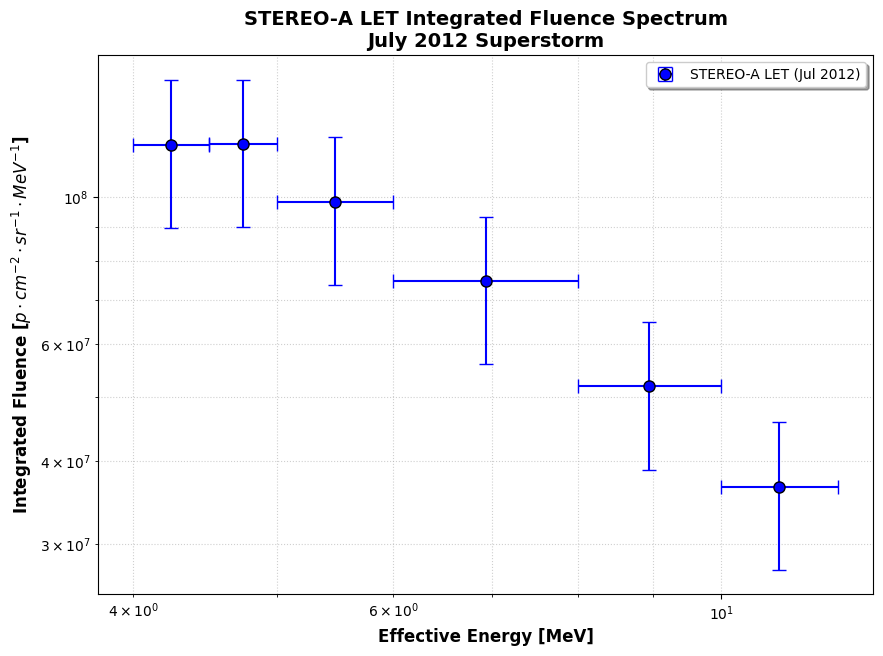


--- Riepilogo Dataset LET per Fit ---
  Channel     E_eff      Fluence        y_err
  4.0-4.5  4.242641 1.195955e+08 2.989887e+07
  4.5-5.0  4.743416 1.199093e+08 2.997733e+07
  5.0-6.0  5.477226 9.821026e+07 2.455256e+07
  6.0-8.0  6.928203 7.463913e+07 1.865978e+07
 8.0-10.0  8.944272 5.180986e+07 1.295247e+07
10.0-12.0 10.954451 3.664607e+07 9.161519e+06


In [4]:
# ============================================================
# CALCOLO FLUENZA INTEGRATA STEREO-A LET (JUL 2012)
# ============================================================

# 1. Definizione dei Bin ed Energie Efficaci (Centri Geometrici)
let_bins = {
    '1.8-2.2': (1.8, 2.2),   '2.2-2.7': (2.2, 2.7),   '2.7-3.2': (2.7, 3.2), 
    '3.2-3.6': (3.2, 3.6),   '3.6-4.0': (3.6, 4.0),   '4.0-4.5': (4.0, 4.5), 
    '4.5-5.0': (4.5, 5.0),   '5.0-6.0': (5.0, 6.0),   '6.0-8.0': (6.0, 8.0), 
    '8.0-10.0': (8.0, 10.0), '10.0-12.0': (10.0, 12.0), '12.0-15.0': (12.0, 15.0)
}

# Calcolo E_eff come media geometrica sqrt(Emin * Emax)
let_eff_map = {col: np.sqrt(b[0] * b[1]) for col, b in let_bins.items()}

# 2. Parametri di integrazione
delta_t = 1800  # 30 minuti in secondi (dato dal tuo resampling)
fluence_let_list = []

# Selezioniamo i dati netti nell'intervallo dell'evento definito (23 Lug - 05 Ago)
df_event_data = df_let_net_fluence.loc[event_start:event_end]

print(f"--- Calcolo Fluenza Integrata (Finestra: {event_start} -> {event_end}) ---")

for col, e_eff in let_eff_map.items():
    # Controllo se il canale è valido (non NaN)
    if np.isnan(mu_let[col]):
        print(f"Canale {col:<10} | SALTATO (Dati non disponibili o NaN)")
        continue
    
    # Integrazione: Somma(Flusso_Netto * delta_t)
    # fillna(0) serve per non invalidare la somma in caso di brevi gap temporali
    fluence_val = df_event_data[col].fillna(0).sum() * delta_t
    
    if fluence_val > 0:
        e_min, e_max = let_bins[col]
        
        # --- Incertezza Energia (x_err) ---
        x_err_low = abs(e_eff - e_min)
        x_err_high = abs(e_max - e_eff)
        
        # --- Incertezza Fluenza (y_err) ---
        # Componente Sistematica (25% come da letteratura Joyce/Mewaldt) 
        y_err_val = 0.25 * fluence_val 
        
        fluence_let_list.append({
            'Channel': col,
            'E_eff': e_eff,
            'Fluence': fluence_val,
            'y_err': y_err_val,
            'x_err_low': x_err_low,
            'x_err_high': x_err_high,
            'Instrument': 'LET'
        })
        print(f"Canale {col:<10} | E_eff: {e_eff:5.2f} MeV | Fluence: {fluence_val:.2e}")

# Creazione DataFrame finale dei punti LET
df_fluence_let_final = pd.DataFrame(fluence_let_list).sort_values('E_eff')

# ============================================================
# 3. PLOT DI CONTROLLO SPETTRO DI FLUENZA (LET ONLY)
# ============================================================
plt.figure(figsize=(10, 7))
plt.errorbar(df_fluence_let_final['E_eff'], df_fluence_let_final['Fluence'], 
             yerr=df_fluence_let_final['y_err'], 
             xerr=[df_fluence_let_final['x_err_low'], df_fluence_let_final['x_err_high']],
             fmt='o', color='blue', markersize=8, capsize=5, elinewidth=1.5, 
             markeredgecolor='black', label='STEREO-A LET (Jul 2012)')

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlabel("Effective Energy [MeV]", fontweight='bold', fontsize=12)
plt.ylabel(r"Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]", fontweight='bold', fontsize=12)
plt.title("STEREO-A LET Integrated Fluence Spectrum\nJuly 2012 Superstorm", fontsize=14, fontweight='bold')
plt.legend(loc='upper right', shadow=True)

plt.show()

# Stampa riassuntiva per controllo valori
print("\n--- Riepilogo Dataset LET per Fit ---")
print(df_fluence_let_final[['Channel', 'E_eff', 'Fluence', 'y_err']].to_string(index=False))

# UNIONE DATI LET E HET

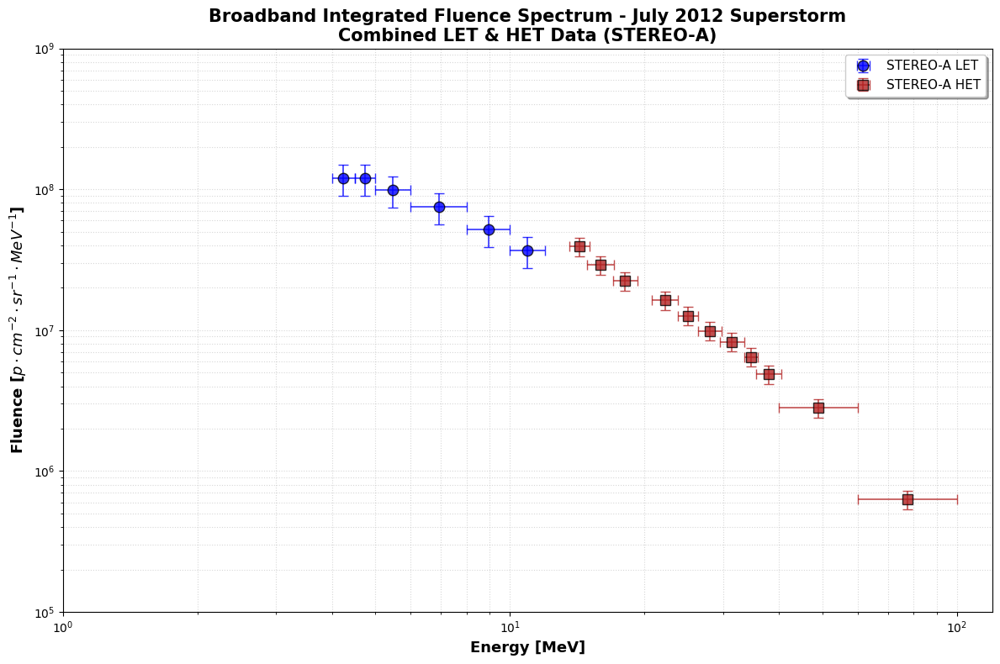

------------------------------------------------------------
Instrument   | Channel         | E_eff (MeV)  | Fluence     
------------------------------------------------------------
Instrument   Channel     E_eff      Fluence
       LET  8.0-10.0  8.944272 5.180986e+07
       LET 10.0-12.0 10.954451 3.664607e+07
       HET 13.6-15.1 14.330387 3.934891e+07
       HET 14.9-17.1 15.962143 2.900964e+07
       HET 17.0-19.3 18.113531 2.241748e+07
       HET 20.8-23.8 22.249494 1.642137e+07


In [5]:
# ============================================================
# UNIONE DATASET LET + HET E PLOT BROADBAND (JUL 2012)
# ============================================================

# 1. Concatenazione dei due DataFrame
# Usiamo i nomi dei dataframe creati nelle celle precedenti
df_combined_2012 = pd.concat([df_fluence_let_final, df_fluence_het_2012], ignore_index=True)

# Ordinamento per energia crescente (essenziale per il fit successivo)
df_combined_2012 = df_combined_2012.sort_values('E_eff').reset_index(drop=True)

# 2. Creazione del Plot Broadband
plt.figure(figsize=(12, 8))

# Punti LET (Blu)
mask_let = df_combined_2012['Instrument'] == 'LET'
plt.errorbar(df_combined_2012.loc[mask_let, 'E_eff'], 
             df_combined_2012.loc[mask_let, 'Fluence'], 
             yerr=df_combined_2012.loc[mask_let, 'y_err'], 
             xerr=[df_combined_2012.loc[mask_let, 'x_err_low'], df_combined_2012.loc[mask_let, 'x_err_high']],
             fmt='o', color='blue', markersize=9, capsize=4, elinewidth=1.2,
             markeredgecolor='black', alpha=0.8, label='STEREO-A LET')

# Punti HET (Rosso Fuoco)
mask_het = df_combined_2012['Instrument'] == 'HET'
plt.errorbar(df_combined_2012.loc[mask_het, 'E_eff'], 
             df_combined_2012.loc[mask_het, 'Fluence'], 
             yerr=df_combined_2012.loc[mask_het, 'y_err'], 
             xerr=[df_combined_2012.loc[mask_het, 'x_err_low'], df_combined_2012.loc[mask_het, 'x_err_high']],
             fmt='s', color='firebrick', markersize=8, capsize=4, elinewidth=1.2,
             markeredgecolor='black', alpha=0.8, label='STEREO-A HET')

# Configurazione Assi (Log-Log)
plt.xscale('log')
plt.yscale('log')
plt.xlim(1, 120)
plt.ylim(1e5, 1e9) # L'evento del 2012 è molto intenso

# Griglia e Label
plt.grid(True, which="both", ls=':', alpha=0.5)
plt.xlabel("Energy [MeV]", fontweight='bold', fontsize=13)
plt.ylabel(r"Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]", fontweight='bold', fontsize=13)
plt.title("Broadband Integrated Fluence Spectrum - July 2012 Superstorm\nCombined LET & HET Data (STEREO-A)", 
          fontsize=15, fontweight='bold')

plt.legend(loc='upper right', frameon=True, shadow=True, fontsize=11)

plt.tight_layout()
plt.show()

# 3. Verifica del Raccordo (Overlap)
print("-" * 60)
print(f"{'Instrument':<12} | {'Channel':<15} | {'E_eff (MeV)':<12} | {'Fluence':<12}")
print("-" * 60)
# Mostriamo i punti tra 10 e 20 MeV per vedere il raccordo
overlap_check = df_combined_2012[(df_combined_2012['E_eff'] > 8) & (df_combined_2012['E_eff'] < 25)]
print(overlap_check[['Instrument', 'Channel', 'E_eff', 'Fluence']].to_string(index=False))

# FIT univoco FINALE e cella export srniel


--- INIZIO ELABORAZIONE VERSIONE 2.1: BAND MODEL + CL68 EXPORT ---


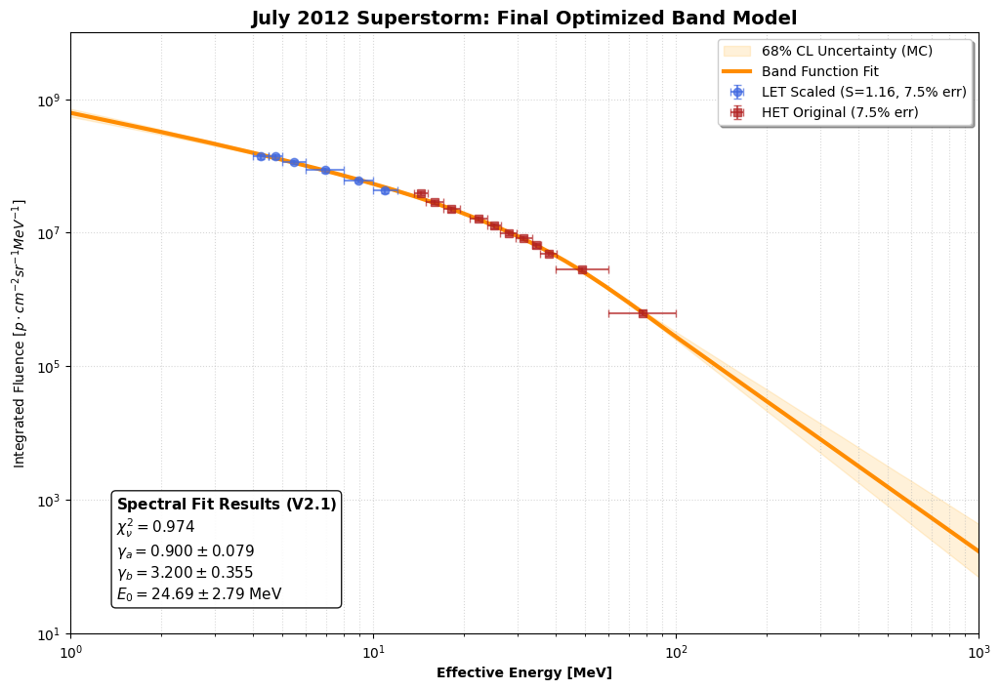

--- ANALISI COMPLETATA. Chi2red: 0.974 ---
File esportati in: FINAL_JUL2012_V2.1_EXPORT_usaquesto


In [6]:
# ============================================================
# ANALISI SPETTRALE VERSIONE 2.1: BAND FUNCTION (ROBUSTA)
# EVENTO: LUGLIO 2012 | STEREO-A LET + HET
# EXPORT: MEDIAN + CL68 (Phi16, Phi84) PER SR-NIEL
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from scipy.optimize import curve_fit
from scipy.linalg import eigh

# --- 1. MODELLI FISICI (LOG-SPACE PER STABILITÀ) ---
def log_band(E, logA, ga, gb, E0):
    """Modello Band Function in spazio logaritmico"""
    E0_s = np.clip(E0, 0.1, 500)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E)
    mask = E <= ebreak
    # Parte bassa energia (Power law + Exp cutoff)
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    # Parte alta energia (Power law con normalizzazione di continuità)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

def band_linear(E, *p):
    """Ritorna il valore lineare della Band Function con protezione overflow"""
    return 10**np.clip(log_band(E, *p), -20, 20)

print("\n--- INIZIO ELABORAZIONE VERSIONE 2.1: BAND MODEL + CL68 EXPORT ---")

# --- 2. PREPARAZIONE DATI E SCALING OTTIMIZZATO ---
df_fit = df_combined_2012.copy()
mask_let = df_fit['Instrument'] == 'LET'
mask_het = df_fit['Instrument'] == 'HET'

# Scaling basato sul raccordo diretto con buffer per saturazione (8%)
f_let_last = df_fit.loc[mask_let, 'Fluence'].values[-1]
f_het_first = df_fit.loc[mask_het, 'Fluence'].values[0]
S_factor_v2 = (f_het_first / f_let_last) * 1.08 

df_fit.loc[mask_let, 'Fluence'] *= S_factor_v2

# Incertezze sistematiche impostate al 7.5%
error_weight = 0.075

df_fit.loc[mask_let, 'y_err'] = np.sqrt((error_weight * df_fit.loc[mask_let, 'Fluence'])**2 + df_fit.loc[mask_let, 'Fluence'])
df_fit.loc[mask_het, 'y_err'] = np.sqrt((error_weight * df_fit.loc[mask_het, 'Fluence'])**2 + df_fit.loc[mask_het, 'Fluence'])

# Preparazione vettori per fit
E_data = df_fit['E_eff'].values
F_data = df_fit['Fluence'].values
sigma_log = df_fit['y_err'].values / (F_data * np.log(10))

# --- 3. ESECUZIONE FIT CON VINCOLI FISICI ---
# Guess: [log10A, ga, gb, E0]
p0 = [10.5, 1.15, 3.5, 22.0] 
# ga vincolato tra 0.9 e 1.4 per stabilità fisica
bounds = ([8, 0.9, 2.0, 5.0], [13, 1.4, 5.5, 150])

popt, pcov = curve_fit(log_band, E_data, np.log10(F_data), p0=p0, 
                       sigma=sigma_log, absolute_sigma=True, bounds=bounds)

perr = np.sqrt(np.diag(pcov))

# --- 4. CALCOLO CHI-QUADRO RIDOTTO ---
residuals = (np.log10(F_data) - log_band(E_data, *popt)) / sigma_log
chi2red = np.sum(residuals**2) / (len(E_data) - len(popt))

# --- 5. MONTE CARLO ROBUSTO (1 MeV - 1000 MeV) ---
E_grid = np.logspace(0, 3, 500)
clean_cov = (pcov + pcov.T) / 2
vals, vecs = eigh(clean_cov)
vals = np.maximum(vals, 1e-12 * np.max(vals))
stable_cov = vecs @ np.diag(vals) @ vecs.T

mc_params = np.random.default_rng(42).multivariate_normal(popt, stable_cov, 1000)
mc_fits = np.array([band_linear(E_grid, *p) for p in mc_params])

# Percentili per le bande di confidenza
Phi_med = np.median(mc_fits, axis=0)
Phi_lo, Phi_hi = np.percentile(mc_fits, [16, 84], axis=0)

# --- 6. PLOT PROFESSIONALE ---
plt.figure(figsize=(12, 8))
plt.fill_between(E_grid, Phi_lo, Phi_hi, color='orange', alpha=0.15, label='68% CL Uncertainty (MC)')
plt.plot(E_grid, Phi_med, color='darkorange', lw=3, label="Band Function Fit")

# Dati sperimentali
plt.errorbar(df_fit.loc[mask_let, 'E_eff'], df_fit.loc[mask_let, 'Fluence'], 
             yerr=df_fit.loc[mask_let, 'y_err'], 
             xerr=[df_fit.loc[mask_let, 'x_err_low'], df_fit.loc[mask_let, 'x_err_high']], 
             fmt='o', color='royalblue', label=f'LET Scaled (S={S_factor_v2:.2f}, 7.5% err)', alpha=0.7, capsize=3)

plt.errorbar(df_fit.loc[mask_het, 'E_eff'], df_fit.loc[mask_het, 'Fluence'], 
             yerr=df_fit.loc[mask_het, 'y_err'], 
             xerr=[df_fit.loc[mask_het, 'x_err_low'], df_fit.loc[mask_het, 'x_err_high']], 
             fmt='s', color='firebrick', label='HET Original (7.5% err)', alpha=0.7, capsize=3)

# Box Statistiche
stats = (
    r"$\bf{Spectral\ Fit\ Results\ (V2.1)}$" + "\n" +
    r"$\chi^2_\nu = %.3f$" % chi2red + "\n" +
    r"$\gamma_a = %.3f \pm %.3f$" % (popt[1], perr[1]) + "\n" +
    r"$\gamma_b = %.3f \pm %.3f$" % (popt[2], perr[2]) + "\n" +
    r"$E_0 = %.2f \pm %.2f$ MeV" % (popt[3], perr[3])
)
plt.gca().text(0.05, 0.05, stats, transform=plt.gca().transAxes, fontsize=11, 
               verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))

plt.xscale("log"); plt.yscale("log"); plt.xlim(1, 1000); plt.ylim(1e1, 1e10)
plt.xlabel("Effective Energy [MeV]", fontweight='bold'); plt.ylabel(r"Integrated Fluence $[p \cdot cm^{-2} sr^{-1} MeV^{-1}]$")
plt.title("July 2012 Superstorm: Final Optimized Band Model", fontsize=14, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.5); plt.legend(loc="upper right", shadow=True); plt.show()

# --- 7. EXPORT PER SR-NIEL (MEDIAN + CL68) ---
out_dir = "FINAL_JUL2012_V2.1_EXPORT_usaquesto"
if not os.path.exists(out_dir): os.makedirs(out_dir)

geometries = {"Planare": np.pi, "Sferica": 4 * np.pi}

for geo, factor in geometries.items():
    # Salvataggio Mediana
    np.savetxt(f"{out_dir}/JUL12_V2.1_Band_{geo}_Median.txt", 
               np.column_stack([E_grid, factor * Phi_med]), 
               fmt="%.6e", header=f"Energy(MeV) Fluence_{geo}_Median(cm^-2*MeV^-1)")
    
    # Salvataggio Bande di Errore (Phi16 e Phi84)
    np.savetxt(f"{out_dir}/JUL12_V2.1_Band_{geo}_CL68.txt", 
               np.column_stack([E_grid, factor * Phi_lo, factor * Phi_hi]), 
               fmt="%.6e", header=f"Energy(MeV) Phi16_{geo} Phi84_{geo}")

print(f"--- ANALISI COMPLETATA. Chi2red: {chi2red:.3f} ---")
print(f"File esportati in: {out_dir}")

# J(E)

In [7]:
# ============================================================
# CALCOLO FLUENZE INTEGRALI — JUL 2012
# ============================================================

E_int = np.logspace(np.log10(0.5), 3, 5000)
phi_diff = band_linear(E_int, *popt)

print("\n--- FLUENZE INTEGRALI JUL 2012 (omnidirezionali, ×4π sr) ---")
for E_thresh in [10, 30, 60, 100, 500]:
    mask = E_int >= E_thresh
    J_omni = 4 * np.pi * np.trapezoid(phi_diff[mask], E_int[mask])
    print(f"  J(>{E_thresh} MeV) = {J_omni:.3e} cm⁻²")


--- FLUENZE INTEGRALI JUL 2012 (omnidirezionali, ×4π sr) ---
  J(>10 MeV) = 7.755e+09 cm⁻²
  J(>30 MeV) = 1.981e+09 cm⁻²
  J(>60 MeV) = 4.888e+08 cm⁻²
  J(>100 MeV) = 1.581e+08 cm⁻²
  J(>500 MeV) = 3.599e+06 cm⁻²


# CALCOLO DOSE SRNIEL

# PLANAR SHIELDING 37mm Al

In [ ]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "FINAL_JUL2012_V2.1_EXPORT_usaquesto/JUL12_V2.1_Band_Planare_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
1.000000e+00 1.709180e+09
1.013939e+00 1.688711e+09
1.028073e+00 1.668473e+09
1.042404e+00 1.648460e+09
1.056935e+00 1.628093e+09
1.071668e+00 1.608627e+09
1.086606e+00 1.589478e+09
1.101753e+00 1.570332e+09
1.117111e+00 1.551238e+09
1.132683e+00 1.532361e+09
1.148472e+00 1.513700e+09
1.164481e+00 1.495251e+09
1.180713e+00 1.477013e+09
1.197171e+00 1.458982e+09
1.213859e+00 1.441157e+09
1.230780e+00 1.423633e+09
1.247936e+00 1.406386e+09
1.265332e+00 1.389333e+09
1.282970e+00 1.372248e+09
1.300854e+00 1.355323e+09
1.318987e+00 1.338858e+09
1.337373e+00 1.322109e+09
1.356015e+00 1.305990e+09
1.374917e+00 1.290101e+09
1.394083e+00 1.273882e+09
1.413516e+00 1.257824e+09
1.433219e+00 1.242434e+09
1.453198e+00 1.227303e+09
1.473454e+00 1.212341e+09
1.493993e+00 1.197547e+09
1.514819e+00 1.182917e+09
1.535935e+00 1.168037e+09
1.557345e+00 1.15315

# calcolo dose (planare)
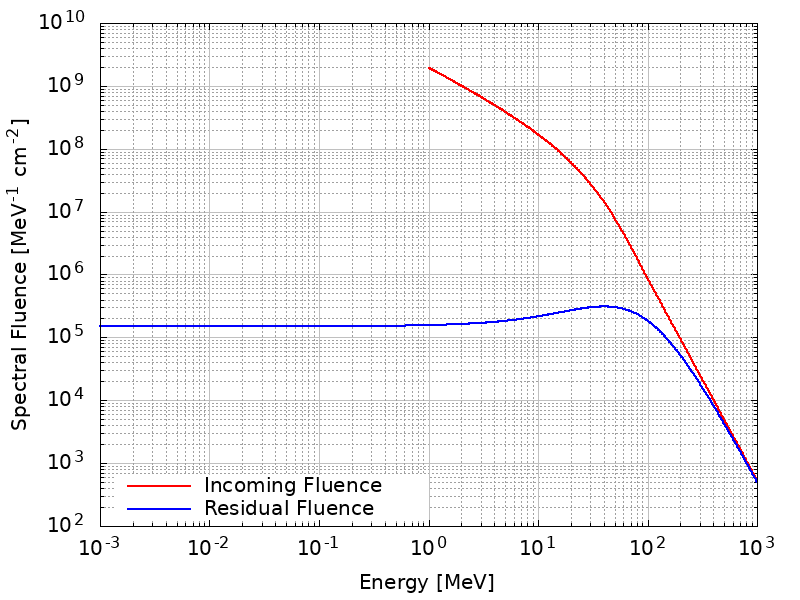

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  JUL 2012
Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)
Dose Mediana: 79.7207 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [64.943 - 105.045] mGy
Incertezza Totale: +25.325 / -14.778 mGy
-----------------------------------------------------------------


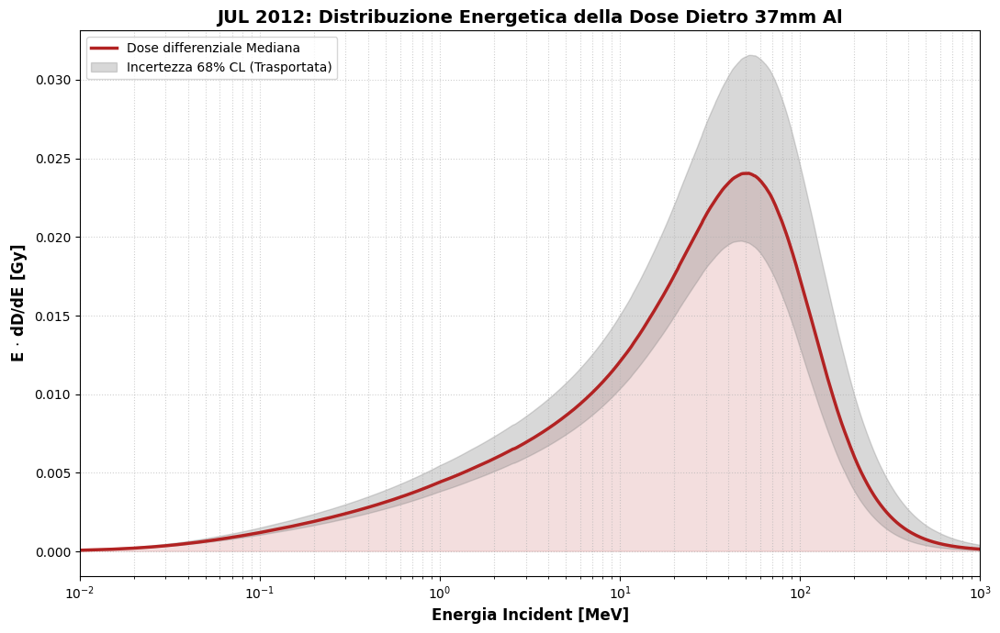

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "FINAL_JUL2012_V2.1_EXPORT_usaquesto/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "37mmAl_planar_residual_median.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "37mmAl_planar_residual_Phi16.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "37mmAl_planar_residual_Phi84.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  JUL 2012")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("JUL 2012: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.01, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# SPHERICAL SHIELDING 37mm Al
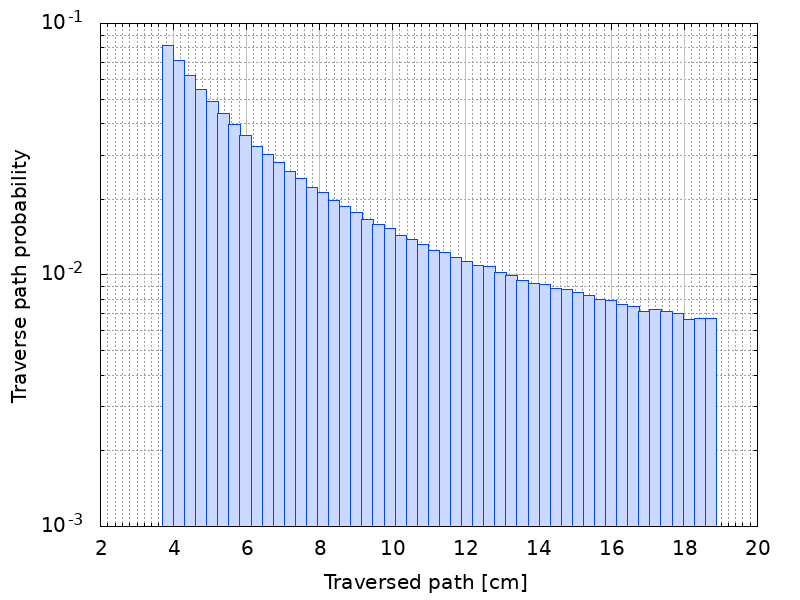
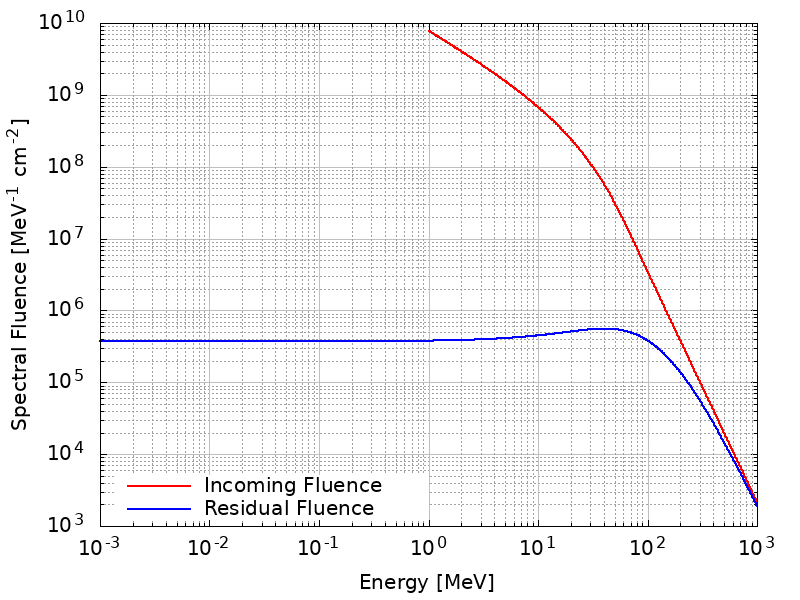

In [ ]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "FINAL_JUL2012_V2.1_EXPORT_usaquesto/JUL12_V2.1_Band_Sferica_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
1.000000e+00 6.836721e+09
1.013939e+00 6.754845e+09
1.028073e+00 6.673891e+09
1.042404e+00 6.593839e+09
1.056935e+00 6.512373e+09
1.071668e+00 6.434510e+09
1.086606e+00 6.357913e+09
1.101753e+00 6.281328e+09
1.117111e+00 6.204951e+09
1.132683e+00 6.129445e+09
1.148472e+00 6.054799e+09
1.164481e+00 5.981005e+09
1.180713e+00 5.908051e+09
1.197171e+00 5.835929e+09
1.213859e+00 5.764629e+09
1.230780e+00 5.694531e+09
1.247936e+00 5.625544e+09
1.265332e+00 5.557333e+09
1.282970e+00 5.488991e+09
1.300854e+00 5.421290e+09
1.318987e+00 5.355433e+09
1.337373e+00 5.288437e+09
1.356015e+00 5.223959e+09
1.374917e+00 5.160404e+09
1.394083e+00 5.095528e+09
1.413516e+00 5.031295e+09
1.433219e+00 4.969734e+09
1.453198e+00 4.909211e+09
1.473454e+00 4.849365e+09
1.493993e+00 4.790186e+09
1.514819e+00 4.731669e+09
1.535935e+00 4.672146e+09
1.557345e+00 4.61262

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  JUL 2012
Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)
Dose Mediana: 167.0559 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [129.250 - 233.455] mGy
Incertezza Totale: +66.400 / -37.806 mGy
-----------------------------------------------------------------


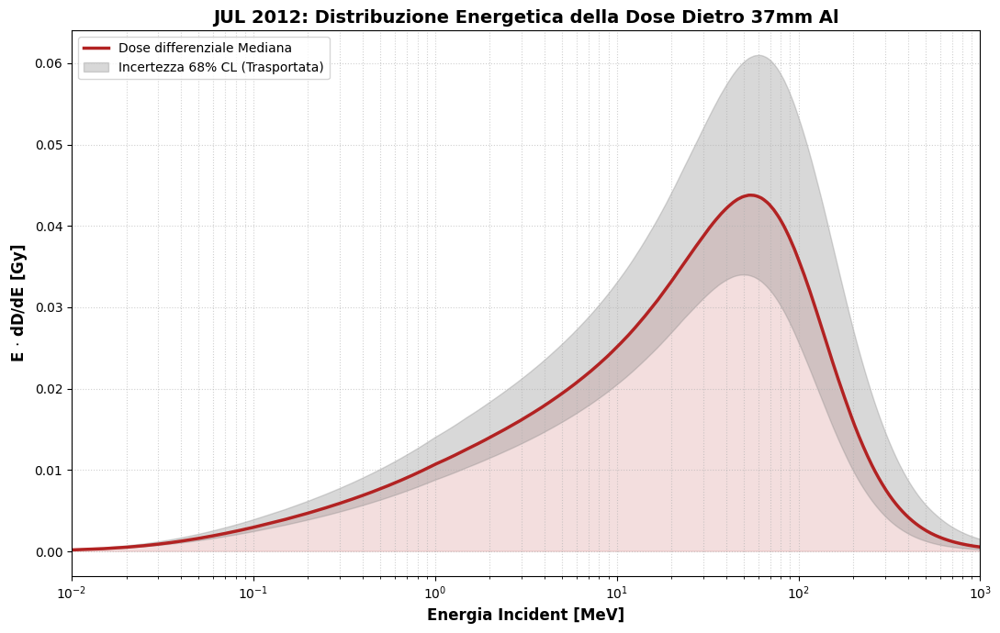

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "FINAL_JUL2012_V2.1_EXPORT_usaquesto/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "37mmAl_spherical_residual_median.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "37mmAl_spherical_residual_Phi16.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "37mmAl_spherical_residual_Phi84.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  JUL 2012")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("JUL 2012: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.01, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# CONFRONTO CON letteratura: 
https://agupubs.onlinelibrary.wiley.com/doi/full/10.1002/2015SW001208


- Paper trova per 10g/cm2 di Alluminio circa 62.5 mGy di dose per i primi 3/4 giorni 
- Questa stima invece integra da 23/07 al 05/08 quindi 13 giorni e trova
    - Dose planare:  79 mGy
    - Dose sferica:  167 mGy

quindi queste stime sono in accordo 



# Confronto con dati da AMS v STEREO-A 

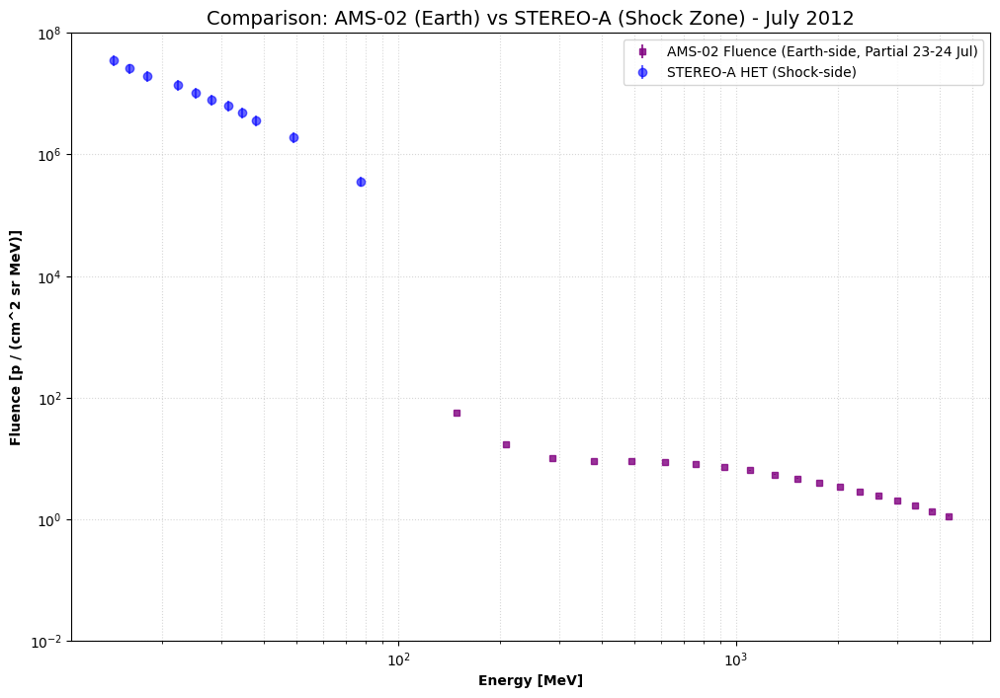

# SEP 2017

# CARICAMENTO DATI GOES 

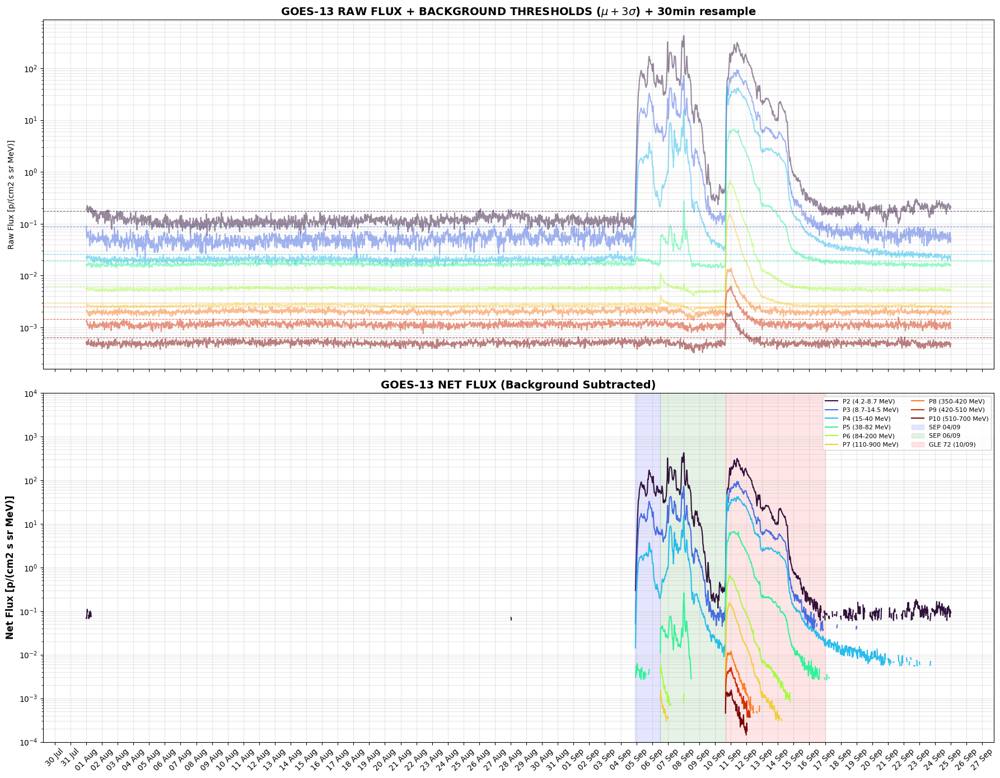

Dataset pronto. Numero canali totali: 9


In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np
import os

# ============================================================
# 1. CARICAMENTO DATI RDS v3.0 (GOES-13 EPS + HEPAD)
# ============================================================

file_eps = "SEPEM_RDS_v3/SEPEM_RDS_v3-0/RDS3.0_H_EPEAD_GOES13.txt"
file_hepad = "SEPEM_RDS_v3/SEPEM_RDS_v3-0/RDS3.0_H_HEPAD_GOES13.txt"

def load_rds_v3(path):
    df = pd.read_csv(path, sep=',', skipinitialspace=True, index_col='epoch', parse_dates=['epoch'])
    df.columns = df.columns.str.strip()
    return df

df_eps_raw = load_rds_v3(file_eps).resample('30min').mean()
df_hepad_raw = load_rds_v3(file_hepad).resample('30min').mean()

# Finestra globale e di background
t_start, t_end = '2017-08-01 00:00:00', '2017-09-25 00:00:00'
bg_start, bg_end = '2017-08-10 00:00:00', '2017-09-04 00:00:00'

# ============================================================
# 2. CALCOLO SOGLIE E RIMOZIONE BACKGROUND
# ============================================================

def get_bg_stats(df, bg_s, bg_e):
    bg_period = df.loc[bg_s:bg_e]
    mu = bg_period.mean()
    sigma = bg_period.std()
    return mu, mu + 3 * sigma

# Calcolo soglie per entrambi i sensori
mu_eps, thresh_eps = get_bg_stats(df_eps_raw, bg_start, bg_end)
mu_hep, thresh_hep = get_bg_stats(df_hepad_raw, bg_start, bg_end)

def apply_correction(df, mu, thresh, t_s, t_e):
    df_ev = df.loc[t_s:t_e].copy()
    df_corr = (df_ev - mu).clip(lower=0) # Sottrazione e clipping a zero
    for col in df_corr.columns:
        df_corr.loc[df_ev[col] < thresh[col], col] = 0.0
    return df_corr

df_eps_net = apply_correction(df_eps_raw, mu_eps, thresh_eps, t_start, t_end)
df_hep_net = apply_correction(df_hepad_raw, mu_hep, thresh_hep, t_start, t_end)

# Merge finale per analisi spettrale
df_total_net = pd.concat([df_eps_net, df_hep_net], axis=1).sort_index()

# ============================================================
# 3. MAPPATURA ENERGIE EFFETTIVE
# ============================================================
effective_energies = {'P2': 6.643, 'P3': 12.61, 'P4': 20.55, 'P5': 46.62, 'P6': 103.7, 
                      'P7': 154.6, 'P8': 406.0, 'P9': 457.0, 'P10': 583.0}

energy_labels = {'P2': '4.2-8.7 MeV', 'P3': '8.7-14.5 MeV', 'P4': '15-40 MeV', 
                 'P5': '38-82 MeV', 'P6': '84-200 MeV', 'P7': '110-900 MeV',
                 'P8': '350-420 MeV', 'P9': '420-510 MeV', 'P10': '510-700 MeV'}

# ============================================================
# 4. PLOT DI CONTROLLO: RAW vs NET
# ============================================================

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(18, 14), sharex=True)
colors = plt.cm.turbo(np.linspace(0, 1, len(effective_energies)))

# --- PANEL 1: RAW DATA + THRESHOLDS ---
for i, col in enumerate(effective_energies.keys()):
    if col in df_eps_raw.columns:
        ax1.plot(df_eps_raw.loc[t_start:t_end].index, df_eps_raw.loc[t_start:t_end, col], color=colors[i], alpha=0.5)
        ax1.axhline(thresh_eps[col], color=colors[i], ls='--', lw=0.8, alpha=0.7)
    elif col in df_hepad_raw.columns:
        ax1.plot(df_hepad_raw.loc[t_start:t_end].index, df_hepad_raw.loc[t_start:t_end, col], color=colors[i], alpha=0.5)
        ax1.axhline(thresh_hep[col], color=colors[i], ls='--', lw=0.8, alpha=0.7)

ax1.set_yscale('log')
ax1.set_title(r'GOES-13 RAW FLUX + BACKGROUND THRESHOLDS ($\mu + 3\sigma$) + 30min resample', fontsize=14, fontweight='bold')
ax1.grid(True, which="both", alpha=0.3)
ax1.set_ylabel('Raw Flux [p/(cm2 s sr MeV)]')

# --- PANEL 2: NET DATA + EVENT HIGHLIGHTS ---
events = {
    "SEP 04/09": ("2017-09-04 22:00", "2017-09-06 12:00", "blue"),
    "SEP 06/09": ("2017-09-06 12:20", "2017-09-10 16:00", "green"),
    "GLE 72 (10/09)": ("2017-09-10 16:05", "2017-09-17 00:00", "red")
}

for i, col in enumerate(effective_energies.keys()):
    if col in df_total_net.columns:
        # Mascheriamo gli zeri per il plot logaritmico
        plot_data = df_total_net[col].replace(0, np.nan)
        ax2.plot(plot_data.index, plot_data, color=colors[i], lw=1.5, label=f"{col} ({energy_labels[col]})")

for name, (start, end, color) in events.items():
    ax2.axvspan(pd.to_datetime(start), pd.to_datetime(end), color=color, alpha=0.1, label=name)

ax2.set_yscale('log')
ax2.set_ylim(1e-4, 1e4)
ax2.set_ylabel('Net Flux [p/(cm2 s sr MeV)]', fontsize=12, fontweight='bold')
ax2.set_title('GOES-13 NET FLUX (Background Subtracted)', fontsize=14, fontweight='bold')
ax2.legend(loc='upper right', ncol=2, fontsize=8)
ax2.grid(True, which="both", alpha=0.3)

# Formattazione asse X
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

print(f"Dataset pronto. Numero canali totali: {len(df_total_net.columns)}")

# CALCOLO FLUENZA GOES 

--- Calcolo Fluenza Accumulata: 2017-09-04 22:00 -> 2017-09-16 00:00 ---
Nota: Canale P7 escluso per migliorare la continuità spettrale.


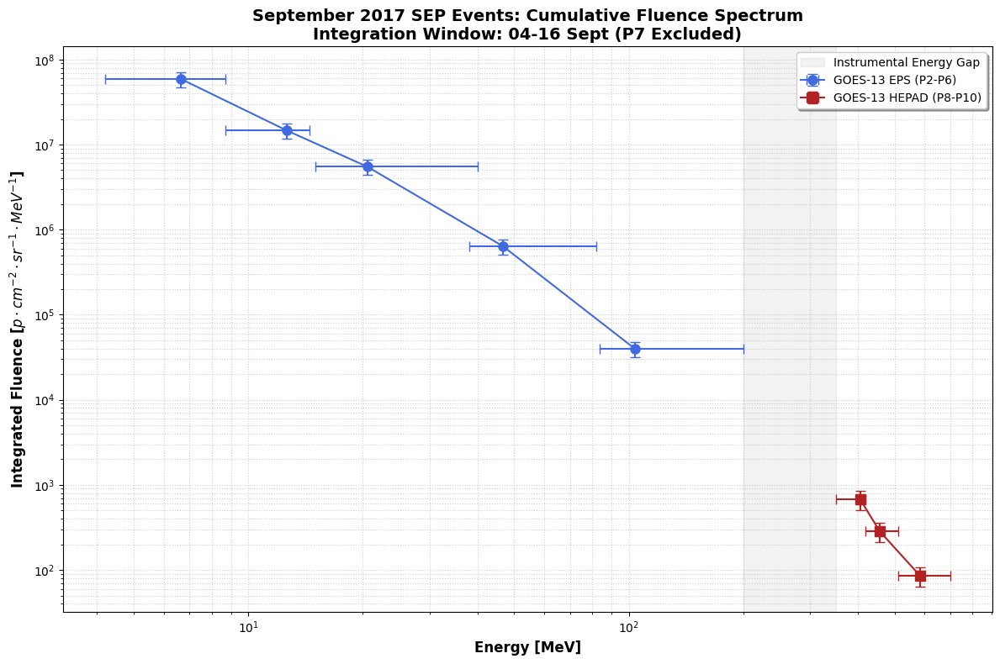


--- Riepilogo Dataset per Fit (Settembre 2017) ---
Channel   E_eff      Fluence        y_err
     P2   6.643 5.911693e+07 1.182339e+07
     P3  12.610 1.466512e+07 2.933024e+06
     P4  20.550 5.492740e+06 1.098548e+06
     P5  46.620 6.420220e+05 1.284044e+05
     P6 103.700 3.990162e+04 7.980324e+03
     P8 406.000 6.756152e+02 1.689038e+02
     P9 457.000 2.842454e+02 7.106134e+01
    P10 583.000 8.562926e+01 2.140731e+01


In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CONFIGURAZIONE CANALI E ENERGIE (RDS v3.0) - P7 RIMOSSO
# ============================================================

# Bin energetici nominali (per calcolo x_err)
channel_bins = {
    'P2': (4.2, 8.7),   'P3': (8.7, 14.5),  'P4': (15.0, 40.0),
    'P5': (38.0, 82.0),  'P6': (84.0, 200.0), 
    # P7 rimosso per ottimizzare il raccordo EPS/HEPAD
    'P8': (350.0, 420.0), 'P9': (420.0, 510.0), 'P10': (510.0, 700.0)
}

# Energie Efficaci (RDS v3.0 Bow-tie calibration)
e_eff_map = {
    'P2': 6.643, 'P3': 12.61, 'P4': 20.55, 'P5': 46.62, 
    'P6': 103.7, 
    'P8': 406.0, 'P9': 457.0, 'P10': 583.0
}

# Incertezze Sistematiche (Standard SEPEM: EPS=20%, HEPAD=25%)
sys_err_map = {
    'P2': 0.20, 'P3': 0.20, 'P4': 0.20, 'P5': 0.20, 'P6': 0.20, 
    'P8': 0.25, 'P9': 0.25, 'P10': 0.25
}

# ============================================================
# 2. INTEGRAZIONE TEMPORALE (INTERO PERIODO 04-16 SETTEMBRE)
# ============================================================

t_start_total = '2017-09-04 22:00'
t_end_total   = '2017-09-16 00:00'
dt_seconds    = 1800 # Risoluzione 5 minuti

# Estrazione slice dal dataset netto (Background già rimosso mu+3sigma)
df_total_slice = df_total_net.loc[t_start_total:t_end_total]

fluence_list = []

print(f"--- Calcolo Fluenza Accumulata: {t_start_total} -> {t_end_total} ---")
print("Nota: Canale P7 escluso per migliorare la continuità spettrale.")

for col, (E_min, E_max) in channel_bins.items():
    if col in df_total_slice.columns:
        # Riempimento gap e integrazione: Somma(Flusso * dt)
        flux_clean = df_total_slice[col].fillna(0)
        fluence_val = (flux_clean * dt_seconds).sum()

        if fluence_val > 0:
            e_eff = e_eff_map[col]
            
            # x_err: Distanza dai bordi del bin nominale
            x_low = abs(e_eff - E_min)
            x_high = abs(E_max - e_eff)
            
            # y_err: Errore sistematico basato sullo strumento
            y_err_val = sys_err_map[col] * fluence_val
            
            fluence_list.append({
                'Channel': col,
                'E_eff': e_eff,
                'Fluence': fluence_val,
                'y_err': y_err_val,
                'x_err_low': x_low,
                'x_err_high': x_high,
                # Strumento: EPS per canali <= 7, HEPAD per gli altri
                'Instrument': 'EPS' if col in ['P2', 'P3', 'P4', 'P5', 'P6'] else 'HEPAD'
            })

# Creazione DataFrame finale ordinato per E_eff
df_fluence_2017 = pd.DataFrame(fluence_list).sort_values('E_eff').reset_index(drop=True)

# ============================================================
# 3. PLOT DI CONTROLLO SPETTRO DI MISSIONE
# ============================================================

plt.figure(figsize=(12, 8))

# Separazione per colori (EPS vs HEPAD) per evidenziare il raccordo
mask_eps = df_fluence_2017['Instrument'] == 'EPS'
mask_hep = df_fluence_2017['Instrument'] == 'HEPAD'

# Plot EPS
plt.errorbar(df_fluence_2017.loc[mask_eps, 'E_eff'], df_fluence_2017.loc[mask_eps, 'Fluence'], 
             xerr=[df_fluence_2017.loc[mask_eps, 'x_err_low'], df_fluence_2017.loc[mask_eps, 'x_err_high']],
             yerr=df_fluence_2017.loc[mask_eps, 'y_err'], 
             fmt='o-', color='royalblue', markersize=8, capsize=4, elinewidth=1.5,
             label='GOES-13 EPS (P2-P6)')

# Plot HEPAD
plt.errorbar(df_fluence_2017.loc[mask_hep, 'E_eff'], df_fluence_2017.loc[mask_hep, 'Fluence'], 
             xerr=[df_fluence_2017.loc[mask_hep, 'x_err_low'], df_fluence_2017.loc[mask_hep, 'x_err_high']],
             yerr=df_fluence_2017.loc[mask_hep, 'y_err'], 
             fmt='s-', color='firebrick', markersize=8, capsize=4, elinewidth=1.5,
             label='GOES-13 HEPAD (P8-P10)')

plt.xscale('log'); plt.yscale('log')
plt.xlabel('Energy [MeV]', fontweight='bold', fontsize=12)
plt.ylabel(r'Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]', fontweight='bold', fontsize=12)
plt.title('September 2017 SEP Events: Cumulative Fluence Spectrum\nIntegration Window: 04-16 Sept (P7 Excluded)', fontsize=14, fontweight='bold')
plt.grid(True, which="both", linestyle=':', alpha=0.6)

# Evidenzia il gap fisico tra i sensori
plt.axvspan(200, 350, color='gray', alpha=0.1, label='Instrumental Energy Gap')

plt.legend(loc='upper right', shadow=True)
plt.tight_layout()
plt.show()

# Stampa per verifica numerica
print("\n--- Riepilogo Dataset per Fit (Settembre 2017) ---")
print(df_fluence_2017[['Channel', 'E_eff', 'Fluence', 'y_err']].to_string(index=False))

# AGGIUNTA DATI ACE

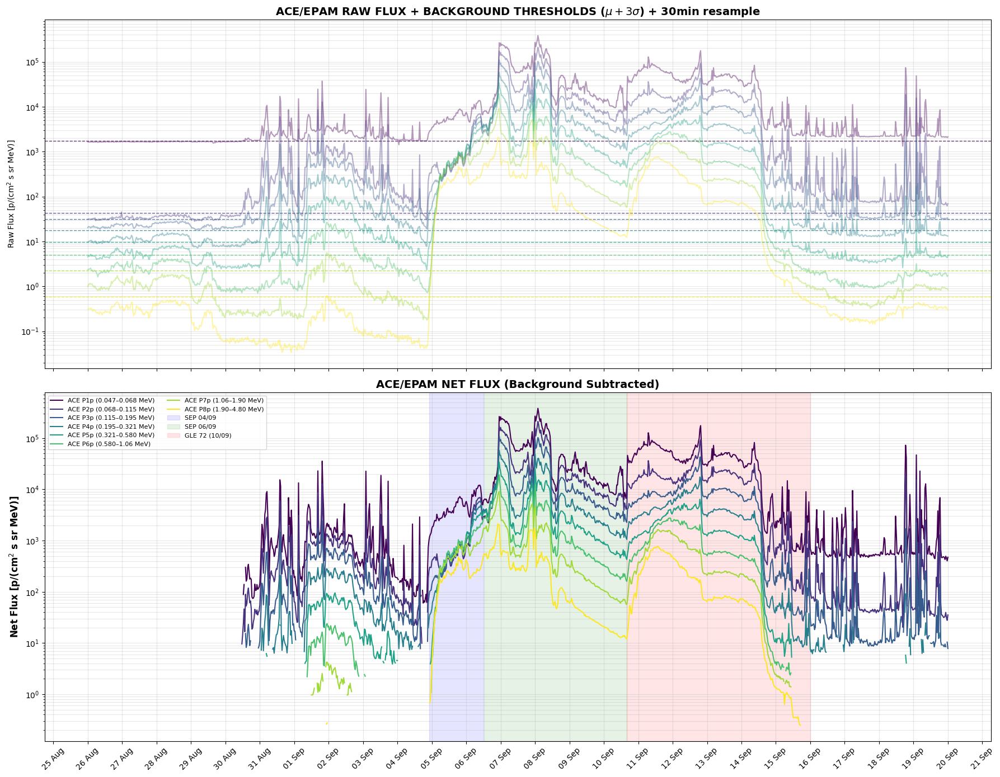

Analisi ACE completata senza warning.


In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

# ============================================================
# 1. FUNZIONE CARICAMENTO DATI ACE (FIXED)
# ============================================================

def load_ace_epam_rds(path):
    header_cols = []
    start_row = 0
    with open(path, 'r') as f:
        lines = f.readlines()
    for i, line in enumerate(lines):
        if line.strip().startswith("year") and "P1p" in line:
            header_cols = line.strip().split()
        if "BEGIN DATA" in line:
            start_row = i + 1
            break
    
    df = pd.read_csv(path, sep=r"\s+", names=header_cols, skiprows=start_row, index_col=False)
    
    # Conversione Tempo: Anno + Giorno dell'anno (DOY) + HMS
    time_str = df['year'].astype(str) + ' ' + df['day'].astype(str) + ' ' + \
               df['hr'].astype(str) + ' ' + df['min'].astype(str) + ' ' + df['sec'].astype(int).astype(str)
    df['epoch'] = pd.to_datetime(time_str, format='%Y %j %H %M %S')
    df.set_index('epoch', inplace=True)
    
    # Pulizia canali protonici EPAM (P1p-P8p)
    cols_flux = [c for c in df.columns if 'p' in c and 'P' in c]
    for c in cols_flux:
        df[c] = pd.to_numeric(df[c], errors='coerce')
        df.loc[df[c] <= 0, c] = np.nan 
    return df

# ============================================================
# 2. PIPELINE DI PROCESSAMENTO (COERENTE CON GOES)
# ============================================================

# Finestre temporali identiche a GOES per consistenza scientifica
t_start, t_end = '2017-08-01 00:00:00', '2017-09-20 00:00:00'
bg_start, bg_end = '2017-08-26 00:00:00', '2017-08-29 00:00:00'

file_path_ace = "SEP 2017 File1/ACE_EPAM_Data (5).txt"
df_ace_raw = load_ace_epam_rds(file_path_ace).resample('30min').mean()

def get_bg_stats(df, bg_s, bg_e):
    bg_period = df.loc[bg_s:bg_e]
    mu = bg_period.mean()
    sigma = bg_period.std()
    return mu, mu + 3 * sigma

# Calcolo soglie
mu_ace, thresh_ace = get_bg_stats(df_ace_raw, bg_start, bg_end)

def apply_correction(df, mu, thresh, t_s, t_e):
    df_ev = df.loc[t_s:t_e].copy()
    # Sottrazione del fondo e clipping a zero (nessun flusso negativo)
    df_corr = (df_ev - mu).clip(lower=0)
    for col in df_corr.columns:
        # Mascheramento rigoroso: se il dato RAW è sotto soglia, lo azzeriamo
        df_corr.loc[df_ev[col] < thresh[col], col] = 0.0
    return df_corr

df_ace_net = apply_correction(df_ace_raw, mu_ace, thresh_ace, t_start, t_end)

# ============================================================
# 3. MAPPATURA ENERGIE ACE/EPAM
# ============================================================
ace_labels = {
    'P1p': '0.047–0.068 MeV', 'P2p': '0.068–0.115 MeV', 'P3p': '0.115–0.195 MeV',
    'P4p': '0.195–0.321 MeV', 'P5p': '0.321–0.580 MeV', 'P6p': '0.580–1.06 MeV',
    'P7p': '1.06–1.90 MeV', 'P8p': '1.90–4.80 MeV'
}

# ============================================================
# 4. DOPPIO PLOT DI CONTROLLO (RAW vs NET)
# ============================================================

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(18, 14), sharex=True)
colors = plt.cm.viridis(np.linspace(0, 1, len(ace_labels)))

# --- PANEL 1: RAW DATA + THRESHOLDS (Uso raw strings r'') ---
for i, (col, label) in enumerate(ace_labels.items()):
    if col in df_ace_raw.columns:
        ax1.plot(df_ace_raw.loc[t_start:t_end].index, df_ace_raw.loc[t_start:t_end, col], color=colors[i], alpha=0.4)
        ax1.axhline(thresh_ace[col], color=colors[i], ls='--', lw=1, alpha=0.8)

ax1.set_yscale('log')
# CORREZIONE QUI: aggiunto r prima della stringa per gestire \mu
ax1.set_title(r'ACE/EPAM RAW FLUX + BACKGROUND THRESHOLDS ($\mu + 3\sigma$) + 30min resample', fontsize=14, fontweight='bold')
ax1.set_ylabel(r'Raw Flux [p/(cm$^2$ s sr MeV)]')
ax1.grid(True, which="both", alpha=0.3)

# --- PANEL 2: NET DATA + EVENTS ---
for i, (col, label) in enumerate(ace_labels.items()):
    if col in df_ace_net.columns:
        plot_data = df_ace_net[col].replace(0, np.nan) 
        ax2.plot(plot_data.index, plot_data, color=colors[i], lw=1.5, label=f"ACE {col} ({label})")

events = {
    "SEP 04/09": ("2017-09-04 22:00", "2017-09-06 12:00", "blue"),
    "SEP 06/09": ("2017-09-06 12:20", "2017-09-10 16:00", "green"),
    "GLE 72 (10/09)": ("2017-09-10 16:05", "2017-09-16 00:00", "red")
}
for name, (start, end, color) in events.items():
    ax2.axvspan(pd.to_datetime(start), pd.to_datetime(end), color=color, alpha=0.1, label=name)

ax2.set_yscale('log')
ax2.set_ylabel(r'Net Flux [p/(cm$^2$ s sr MeV)]', fontsize=12, fontweight='bold')
ax2.set_title('ACE/EPAM NET FLUX (Background Subtracted)', fontsize=14, fontweight='bold')
ax2.grid(True, which="both", alpha=0.3)
ax2.legend(loc='upper left', ncol=2, fontsize=8)

ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

print("Analisi ACE completata senza warning.")

# FLUENZA DATI ACE

--- Calcolo Fluenza ACE/EPAM: 2017-09-04 22:00 -> 2017-09-16 00:00 ---


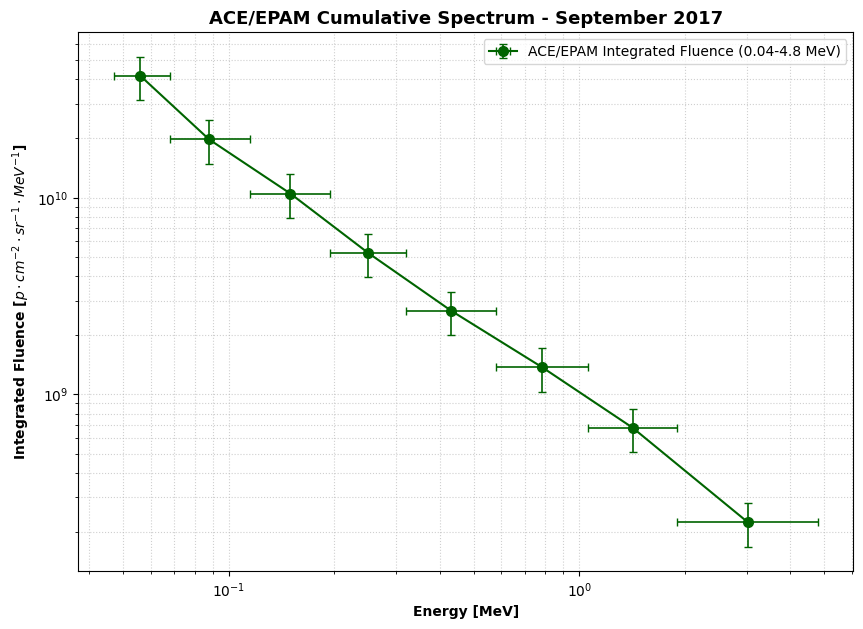


--- Riepilogo Fluenza ACE (Pronto per Merge) ---
Channel  E_eff      Fluence        y_err
    P1p  0.056 4.154269e+10 1.038567e+10
    P2p  0.088 1.972615e+10 4.931538e+09
    P3p  0.150 1.047728e+10 2.619319e+09
    P4p  0.250 5.235889e+09 1.308972e+09
    P5p  0.431 2.664136e+09 6.660339e+08
    P6p  0.784 1.374468e+09 3.436170e+08
    P7p  1.419 6.783748e+08 1.695937e+08
    P8p  3.020 2.251576e+08 5.628941e+07


In [6]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CONFIGURAZIONE CANALI E ENERGIE ACE/EPAM (LEMS120)
# ============================================================

# Bin energetici nominali EPAM (MeV)
ace_bins = {
    'P1p': (0.047, 0.068), 'P2p': (0.068, 0.115), 'P3p': (0.115, 0.195),
    'P4p': (0.195, 0.321), 'P5p': (0.321, 0.580), 'P6p': (0.580, 1.06),
    'P7p': (1.06, 1.90),   'P8p': (1.90, 4.80)
}

# Energie Efficaci (Geometric Mean dei bin per EPAM)
ace_eff_map = {
    'P1p': 0.056, 'P2p': 0.088, 'P3p': 0.150, 'P4p': 0.250,
    'P5p': 0.431, 'P6p': 0.784, 'P7p': 1.419, 'P8p': 3.020
}

# Incertezza Sistematica EPAM (Stimata al 25% per periodi SEP)
sys_err_ace = 0.25 

# ============================================================
# 2. INTEGRAZIONE TEMPORALE (COERENTE CON GOES: 04-16 SETT)
# ============================================================

t_start_int = '2017-09-04 22:00'
t_end_int   = '2017-09-16 00:00'
dt_seconds  = 1800  # Risoluzione 5 minuti

# Utilizziamo df_ace_net (il dataset pulito con MAD o mu+3sigma)
df_ace_ev = df_ace_net.loc[t_start_int:t_end_int]

ace_fluence_list = []

print(f"--- Calcolo Fluenza ACE/EPAM: {t_start_int} -> {t_end_int} ---")

for col, (E_min, E_max) in ace_bins.items():
    if col in df_ace_ev.columns:
        # Integrazione: Somma(Flusso * dt)
        #fillna(0) per gestire eventuali dropout durante l'evento
        fluence_val = (df_ace_ev[col].fillna(0) * dt_seconds).sum()

        if fluence_val > 0:
            e_eff = ace_eff_map[col]
            
            # x_err: larghezza del bin
            x_low = abs(e_eff - E_min)
            x_high = abs(E_max - e_eff)
            
            # y_err: Errore sistematico (25%)
            y_err_val = sys_err_ace * fluence_val
            
            ace_fluence_list.append({
                'Channel': col,
                'E_eff': e_eff,
                'Fluence': fluence_val,
                'y_err': y_err_val,
                'x_err_low': x_low,
                'x_err_high': x_high,
                'Instrument': 'ACE/EPAM'
            })

# Creazione DataFrame Fluenza ACE
df_fluence_ace = pd.DataFrame(ace_fluence_list).sort_values('E_eff').reset_index(drop=True)

# ============================================================
# 3. PLOT DELLO SPETTRO INTEGRATO ACE
# ============================================================

plt.figure(figsize=(10, 7))

plt.errorbar(df_fluence_ace['E_eff'], df_fluence_ace['Fluence'], 
             xerr=[df_fluence_ace['x_err_low'], df_fluence_ace['x_err_high']],
             yerr=df_fluence_ace['y_err'], 
             fmt='o-', color='darkgreen', markersize=7, capsize=3, elinewidth=1.2,
             label='ACE/EPAM Integrated Fluence (0.04-4.8 MeV)')

plt.xscale('log')
plt.yscale('log')
plt.xlabel('Energy [MeV]', fontweight='bold')
plt.ylabel(r'Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]', fontweight='bold')
plt.title('ACE/EPAM Cumulative Spectrum - September 2017', fontsize=13, fontweight='bold')
plt.grid(True, which="both", linestyle=':', alpha=0.6)
plt.legend()
plt.show()

print("\n--- Riepilogo Fluenza ACE (Pronto per Merge) ---")
print(df_fluence_ace[['Channel', 'E_eff', 'Fluence', 'y_err']].to_string(index=False))

# UNIONE DATI 

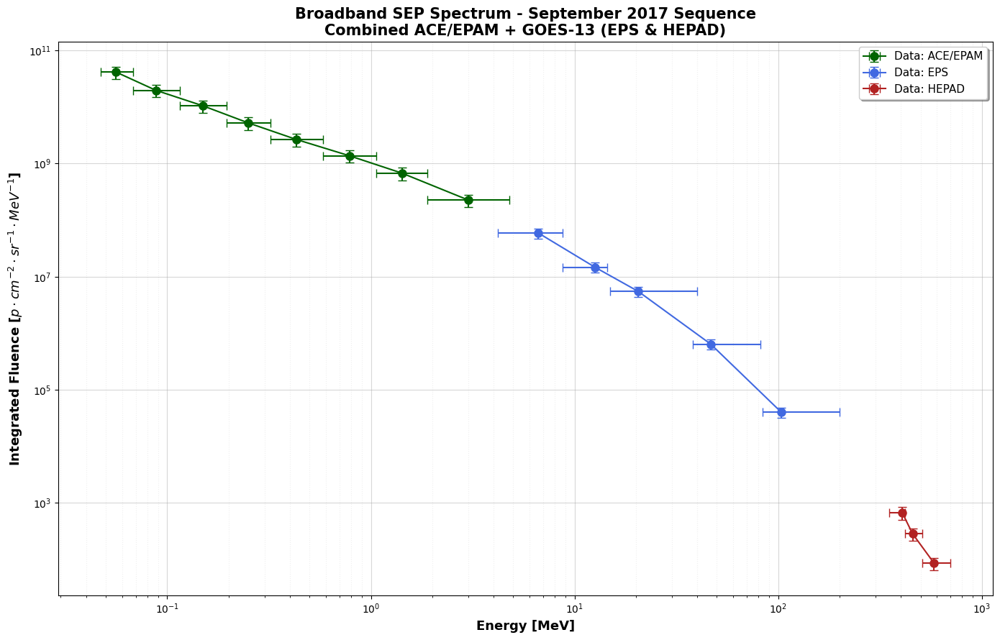


--- DATASET BROADBAND PRONTO PER IL FIT ---
Numero totale di canali: 16
Range energetico coperto: 0.0560 - 583.0 MeV

Prime righe del dataset combinato:
 E_eff      Fluence        y_err  x_err_low  x_err_high Instrument
 0.056 4.154269e+10 1.038567e+10      0.009       0.012   ACE/EPAM
 0.088 1.972615e+10 4.931538e+09      0.020       0.027   ACE/EPAM
 0.150 1.047728e+10 2.619319e+09      0.035       0.045   ACE/EPAM
 0.250 5.235889e+09 1.308972e+09      0.055       0.071   ACE/EPAM
 0.431 2.664136e+09 6.660339e+08      0.110       0.149   ACE/EPAM
 0.784 1.374468e+09 3.436170e+08      0.204       0.276   ACE/EPAM
 1.419 6.783748e+08 1.695937e+08      0.359       0.481   ACE/EPAM
 3.020 2.251576e+08 5.628941e+07      1.120       1.780   ACE/EPAM
 6.643 5.911693e+07 1.182339e+07      2.443       2.057        EPS
12.610 1.466512e+07 2.933024e+06      3.910       1.890        EPS


In [7]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. MERGE DEI DATASET (ACE/EPAM + GOES-13 EPS/HEPAD)
# ============================================================

# Concatenazione dei due DataFrame creati nelle celle precedenti
df_broadband = pd.concat([df_fluence_ace, df_fluence_2017], ignore_index=True)

# Ordinamento rigoroso per energia crescente
df_broadband = df_broadband.sort_values('E_eff').reset_index(drop=True)

# Definizione colori per la visualizzazione dei tre sensori
instrument_colors = {
    'ACE/EPAM': 'darkgreen',
    'EPS': 'royalblue',
    'HEPAD': 'firebrick'
}

# ============================================================
# 2. PLOT DI CONTROLLO BROADBAND SPECTRUM (PULITO)
# ============================================================

plt.figure(figsize=(14, 9))

for inst, color in instrument_colors.items():
    mask = df_broadband['Instrument'] == inst
    if mask.any():
        plt.errorbar(df_broadband.loc[mask, 'E_eff'], 
                     df_broadband.loc[mask, 'Fluence'], 
                     xerr=[df_broadband.loc[mask, 'x_err_low'], df_broadband.loc[mask, 'x_err_high']],
                     yerr=df_broadband.loc[mask, 'y_err'], 
                     fmt='o-', color=color, markersize=8, capsize=4, elinewidth=1.5,
                     label=f'Data: {inst}')

plt.xscale('log')
plt.yscale('log')
plt.xlabel('Energy [MeV]', fontweight='bold', fontsize=13)
plt.ylabel(r'Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]', fontweight='bold', fontsize=13)
plt.title('Broadband SEP Spectrum - September 2017 Sequence\nCombined ACE/EPAM + GOES-13 (EPS & HEPAD)', fontsize=15, fontweight='bold')

# Griglia e Legenda
plt.grid(True, which="major", linestyle='-', alpha=0.5)
plt.grid(True, which="minor", linestyle=':', alpha=0.2)
plt.legend(loc='upper right', fontsize=11, shadow=True)

plt.tight_layout()
plt.show()

# ============================================================
# 3. PREPARAZIONE DATI PER IL FIT (df_combined_2017)
# ============================================================

# Creiamo il DataFrame finale che passeremo alla cella del Fit
df_combined_2017 = df_broadband[['E_eff', 'Fluence', 'y_err', 'x_err_low', 'x_err_high', 'Instrument']].copy()

print("\n--- DATASET BROADBAND PRONTO PER IL FIT ---")
print(f"Numero totale di canali: {len(df_combined_2017)}")
print(f"Range energetico coperto: {df_combined_2017['E_eff'].min():.4f} - {df_combined_2017['E_eff'].max():.1f} MeV")
print("\nPrime righe del dataset combinato:")
print(df_combined_2017.head(10).to_string(index=False))

# FIT UNIVOCO E CELLA EXPORT

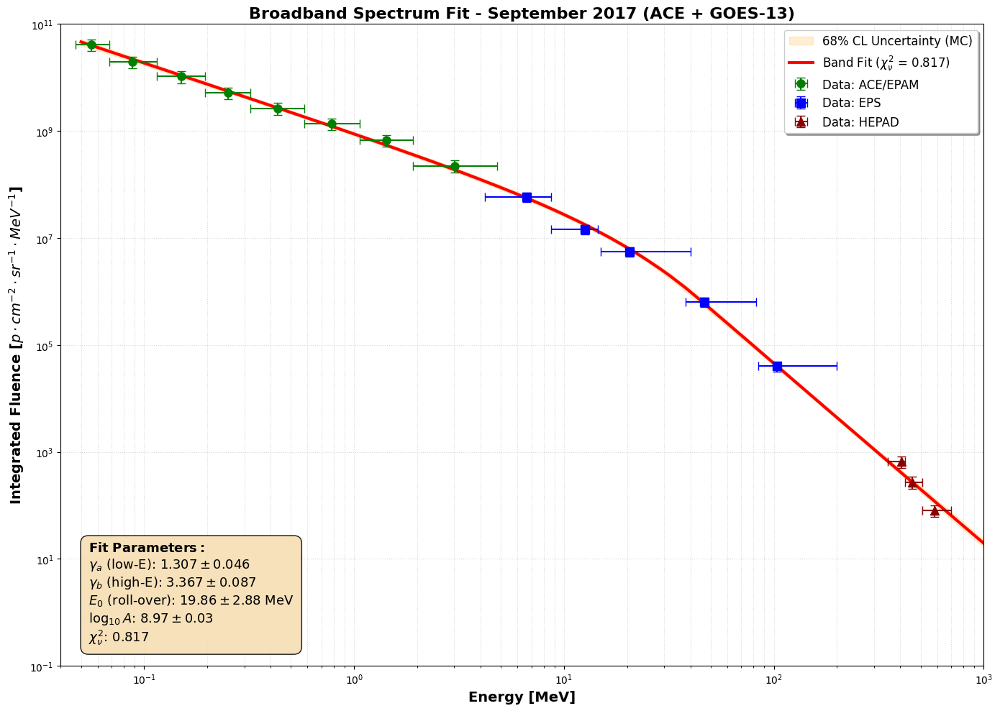

Dataset salvato in 'EXPORT_SEP2017_FINAL_usaquestooo'. Analisi completata.


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.linalg import eigh
import os

# =========================================================
# 1. MODELLO FISICO: BAND FUNCTION (SCALA LOGARITMICA)
# =========================================================
def log_band(E, logA, ga, gb, E0):
    """
    Modello Band Function per lo spettro SEP.
    ga: indice spettrale basse energie
    gb: indice spettrale alte energie
    E0: energia di break/roll-over (MeV)
    logA: normalizzazione (log10)
    """
    E0_s = np.clip(E0, 1.0, 500)
    ebreak = (gb - ga) * E0_s
    res = np.zeros_like(E)
    mask = E <= ebreak
    # Parte bassa energia (Power law + Exponential cutoff)
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    # Parte alta energia (Power law pura)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

def band_linear(E, *p):
    return 10**log_band(E, *p)

# =========================================================
# 2. PREPARAZIONE DATI E FIT NON-LINEARE
# =========================================================
# Dataset combinato ACE + GOES (df_combined_2017)
x_data = df_combined_2017['E_eff'].values
y_data = df_combined_2017['Fluence'].values
y_err  = df_combined_2017['y_err'].values

log_y = np.log10(y_data)
log_y_err = y_err / (y_data * np.log(10))

# Guess iniziali ottimizzati per evento GLE Settembre 2017
p0 = [8.5, 1.1, 3.5, 20.0] 
bounds = ([5, 0.5, 1.5, 5], [13, 2.5, 6.0, 150])

popt, pcov = curve_fit(log_band, x_data, log_y, p0=p0, sigma=log_y_err, 
                        bounds=bounds, method='trf', maxfev=20000)

# Calcolo Chi-quadro ridotto (Benchmark statistico)
residuals = log_y - log_band(x_data, *popt)
chi2_red = np.sum((residuals / log_y_err)**2) / (len(x_data) - len(popt))
perr = np.sqrt(np.diag(pcov)) # Incertezze sui parametri

# =========================================================
# 3. ANALISI MONTE CARLO (CALCOLO INCERTEZZE SPETTRALI)
# =========================================================
n_mc = 1000
# Stabilizzazione della matrice di covarianza (Spectral Shrinkage)
vals, vecs = eigh(pcov)
vals = np.maximum(vals, 1e-12)
clean_pcov = vecs @ np.diag(vals) @ vecs.T

mc_params = np.random.multivariate_normal(popt, clean_pcov, n_mc)
e_grid = np.logspace(np.log10(0.05),3, 600) # Range: 0.05 MeV - 1000 MeV
mc_fits = np.array([band_linear(e_grid, *p) for p in mc_params])

# Mediana e Bande di Confidenza 68% (Phi16, Phi84)
phi_med = np.median(mc_fits, axis=0)
phi_16  = np.percentile(mc_fits, 16, axis=0)
phi_84  = np.percentile(mc_fits, 84, axis=0)

# =========================================================
# 4. EXPORT DATI PER SR-NIEL (SFERICA 4pi E PLANARE pi)
# =========================================================
out_dir = "EXPORT_SEP2017_FINAL_usaquestooo"
if not os.path.exists(out_dir): os.makedirs(out_dir)

header = "Energy(MeV) Median_Fluence Phi_16 Phi_84"
# Integrazione sferica (4*pi)
np.savetxt(f"{out_dir}/SEP2017_Spherical_4pi.txt", 
           np.column_stack([e_grid, 4*np.pi*phi_med, 4*np.pi*phi_16, 4*np.pi*phi_84]), 
           header=f"SPHERICAL 4PI - {header}", fmt="%.6e")
# Integrazione planare (pi)
np.savetxt(f"{out_dir}/SEP2017_Planar_pi.txt", 
           np.column_stack([e_grid, np.pi*phi_med, np.pi*phi_16, np.pi*phi_84]), 
           header=f"PLANAR PI - {header}", fmt="%.6e")

# =========================================================
# 5. PLOT FINALE PROFESSIONALE
# =========================================================
plt.figure(figsize=(14, 10))

# Area di incertezza 68% CL
plt.fill_between(e_grid, phi_16, phi_84, color='orange', alpha=0.18, label='68% CL Uncertainty (MC)')

# Curva di Fit Mediana
plt.plot(e_grid, phi_med, color='red', lw=3, label=rf'Band Fit ($\chi^2_\nu$ = {chi2_red:.3f})')

# Dati sperimentali ACE + GOES
inst_map = {'ACE/EPAM': ('green', 'o'), 'EPS': ('blue', 's'), 'HEPAD': ('darkred', '^')}
for inst, (color, marker) in inst_map.items():
    m = df_combined_2017['Instrument'] == inst
    if m.any():
        plt.errorbar(df_combined_2017.loc[m, 'E_eff'], df_combined_2017.loc[m, 'Fluence'],
                     xerr=[df_combined_2017.loc[m, 'x_err_low'], df_combined_2017.loc[m, 'x_err_high']],
                     yerr=df_combined_2017.loc[m, 'y_err'], 
                     fmt=marker, color=color, label=f'Data: {inst}', capsize=4, markersize=8, elinewidth=1.5)

# Configurazione Grafica
plt.xscale('log'); plt.yscale('log')
plt.xlim(4e-2, 1e3); plt.ylim(1e-1, 1e11)
plt.grid(True, which="both", ls=':', alpha=0.5)
plt.xlabel('Energy [MeV]', fontweight='bold', fontsize=14)
plt.ylabel(r'Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]', fontweight='bold', fontsize=14)
plt.title('Broadband Spectrum Fit - September 2017 (ACE + GOES-13)', fontsize=16, fontweight='bold')

# --- BOX PARAMETRI LEGGIBILE ---
param_box = (
    r"$\bf{Fit\ Parameters:}$" + "\n" +
    rf"$\gamma_a$ (low-E): ${popt[1]:.3f} \pm {perr[1]:.3f}$" + "\n" +
    rf"$\gamma_b$ (high-E): ${popt[2]:.3f} \pm {perr[2]:.3f}$" + "\n" +
    rf"$E_0$ (roll-over): ${popt[3]:.2f} \pm {perr[3]:.2f}$ MeV" + "\n" +
    rf"$\log_{{10}} A$: ${popt[0]:.2f} \pm {perr[0]:.2f}$" + "\n" +
    rf"$\chi^2_\nu$: {chi2_red:.3f}"
)

plt.text(0.03, 0.03, param_box, transform=plt.gca().transAxes, fontsize=13, 
         verticalalignment='bottom', horizontalalignment='left',
         bbox=dict(boxstyle='round,pad=0.6', facecolor='wheat', alpha=0.9))

plt.legend(loc='upper right', fontsize=12, frameon=True, shadow=True)
plt.tight_layout()
plt.show()

print(f"Dataset salvato in '{out_dir}'. Analisi completata.")


--- INIZIO ELABORAZIONE SETTEMBRE 2017: BAND MODEL + CL68 EXPORT ---


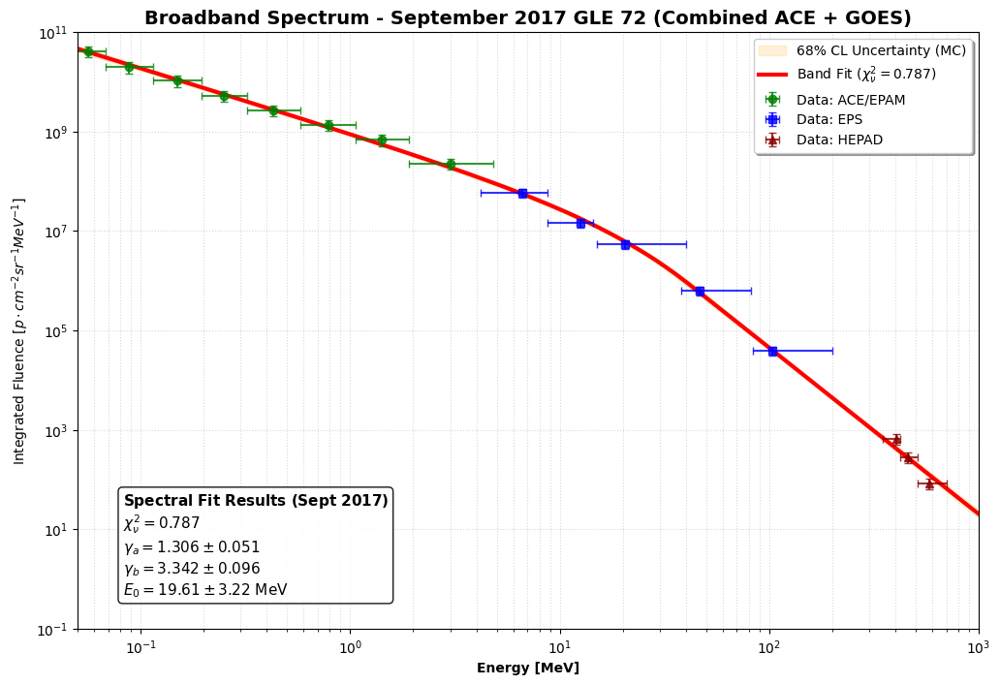

--- ANALISI COMPLETATA. Chi2red: 0.787 ---
File esportati in: EXPORT_SEP2017_FINAL_Phi_Bands_usaquesto (Range: 0.05 - 1000 MeV)


In [8]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from scipy.optimize import curve_fit
from scipy.linalg import eigh

# =========================================================
# 1. MODELLO FISICO: BAND FUNCTION (LOG-SPACE)
# =========================================================
def log_band(E, logA, ga, gb, E0):
    """
    ga: low-energy slope, gb: high-energy slope, E0: roll-over (MeV)
    """
    E0_s = np.clip(E0, 0.1, 500)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E)
    mask = E <= ebreak
    # Parte bassa energia (Power law + Exp cutoff)
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    # Parte alta energia (Power law con raccordo continuo)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

def band_linear(E, *p):
    return 10**np.clip(log_band(E, *p), -20, 20)

print("\n--- INIZIO ELABORAZIONE SETTEMBRE 2017: BAND MODEL + CL68 EXPORT ---")

# =========================================================
# 2. PREPARAZIONE DATI (df_combined_2017)
# =========================================================
E_data = df_combined_2017['E_eff'].values
F_data = df_combined_2017['Fluence'].values
# Incertezza in spazio logaritmico
sigma_log = df_combined_2017['y_err'].values / (F_data * np.log(10))

# Guess ottimizzati per Settembre 2017 (Eventi Hard / GLE)
p0 = [8.5, 1.1, 3.5, 20.0] 
bounds = ([5, 0.5, 1.5, 5], [13, 2.5, 6.0, 150])

# =========================================================
# 3. ESECUZIONE FIT
# =========================================================
popt, pcov = curve_fit(log_band, E_data, np.log10(F_data), p0=p0, 
                        sigma=sigma_log, absolute_sigma=True, bounds=bounds)

perr = np.sqrt(np.diag(pcov))

# Chi-quadro ridotto
residuals = (np.log10(F_data) - log_band(E_data, *popt)) / sigma_log
chi2red = np.sum(residuals**2) / (len(E_data) - len(popt))

# =========================================================
# 4. MONTE CARLO (RANGE RICHIESTO: 0.05 - 1000 MeV)
# =========================================================
E_grid = np.logspace(np.log10(0.05), 3, 600)
clean_cov = (pcov + pcov.T) / 2
vals, vecs = eigh(clean_cov)
vals = np.maximum(vals, 1e-12 * np.max(vals))
stable_cov = vecs @ np.diag(vals) @ vecs.T

mc_params = np.random.default_rng(42).multivariate_normal(popt, stable_cov, 1000)
mc_fits = np.array([band_linear(E_grid, *p) for p in mc_params])

# Percentili 16, 50 (mediana), 84
Phi_med = np.median(mc_fits, axis=0)
Phi_lo, Phi_hi = np.percentile(mc_fits, [16, 84], axis=0)

# =========================================================
# 5. PLOT PROFESSIONALE
# =========================================================
plt.figure(figsize=(12, 8))
plt.fill_between(E_grid, Phi_lo, Phi_hi, color='orange', alpha=0.15, label='68% CL Uncertainty (MC)')
plt.plot(E_grid, Phi_med, color='red', lw=3, label=rf'Band Fit ($\chi^2_\nu = {chi2red:.3f}$)')

# Dati sperimentali
inst_map = {'ACE/EPAM': ('green', 'o'), 'EPS': ('blue', 's'), 'HEPAD': ('darkred', '^')}
for inst, (color, marker) in inst_map.items():
    m = df_combined_2017['Instrument'] == inst
    plt.errorbar(df_combined_2017.loc[m, 'E_eff'], df_combined_2017.loc[m, 'Fluence'],
                 xerr=[df_combined_2017.loc[m, 'x_err_low'], df_combined_2017.loc[m, 'x_err_high']],
                 yerr=df_combined_2017.loc[m, 'y_err'], 
                 fmt=marker, color=color, label=f'Data: {inst}', alpha=0.8, capsize=3)

# Box Statistiche migliorato
stats = (
    r"$\bf{Spectral\ Fit\ Results\ (Sept\ 2017)}$" + "\n" +
    rf"$\chi^2_\nu = {chi2red:.3f}$" + "\n" +
    rf"$\gamma_a = {popt[1]:.3f} \pm {perr[1]:.3f}$" + "\n" +
    rf"$\gamma_b = {popt[2]:.3f} \pm {perr[2]:.3f}$" + "\n" +
    rf"$E_0 = {popt[3]:.2f} \pm {perr[3]:.2f}$ MeV"
)
plt.gca().text(0.05, 0.05, stats, transform=plt.gca().transAxes, fontsize=11, 
                verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))

plt.xscale("log"); plt.yscale("log"); plt.xlim(0.05, 1000); plt.ylim(1e-1, 1e11)
plt.xlabel("Energy [MeV]", fontweight='bold'); plt.ylabel(r"Integrated Fluence $[p \cdot cm^{-2} sr^{-1} MeV^{-1}]$")
plt.title("Broadband Spectrum - September 2017 GLE 72 (Combined ACE + GOES)", fontsize=14, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.5); plt.legend(loc="upper right", shadow=True); plt.show()

# =========================================================
# 6. EXPORT PER SR-NIEL (MEDIAN + CL68)
# =========================================================
out_dir = "EXPORT_SEP2017_FINAL_Phi_Bands_usaquesto"
if not os.path.exists(out_dir): os.makedirs(out_dir)

geometries = {"Planar": np.pi, "Spherical": 4 * np.pi}

for geo, factor in geometries.items():
    # 1. Export MEDIAN (Dato centrale)
    np.savetxt(f"{out_dir}/SEP17_Band_{geo}_Median.txt", 
                np.column_stack([E_grid, factor * Phi_med]), 
                fmt="%.6e", header=f"Energy(MeV) Fluence_{geo}_Median(cm^-2*MeV^-1)")
    
    # 2. Export CL68 (Bande Phi16 e Phi84 per propagazione errore)
    np.savetxt(f"{out_dir}/SEP17_Band_{geo}_CL68.txt", 
                np.column_stack([E_grid, factor * Phi_lo, factor * Phi_hi]), 
                fmt="%.6e", header=f"Energy(MeV) Phi16_{geo} Phi84_{geo}")

print(f"--- ANALISI COMPLETATA. Chi2red: {chi2red:.3f} ---")
print(f"File esportati in: {out_dir} (Range: 0.05 - 1000 MeV)")

# J (E)

In [9]:
# ============================================================
# CALCOLO FLUENZE INTEGRALI — SEP 2017
# ============================================================

E_int = np.logspace(np.log10(0.5), 3, 5000)
phi_diff = band_linear(E_int, *popt)

print("\n--- FLUENZE INTEGRALI SEP 2017 (omnidirezionali, ×4π sr) ---")
for E_thresh in [10, 30, 60, 100, 500]:
    mask = E_int >= E_thresh
    J_omni = 4 * np.pi * np.trapezoid(phi_diff[mask], E_int[mask])
    print(f"  J(>{E_thresh} MeV) = {J_omni:.3e} cm⁻²")


--- FLUENZE INTEGRALI SEP 2017 (omnidirezionali, ×4π sr) ---
  J(>10 MeV) = 2.685e+09 cm⁻²
  J(>30 MeV) = 4.065e+08 cm⁻²
  J(>60 MeV) = 8.124e+07 cm⁻²
  J(>100 MeV) = 2.448e+07 cm⁻²
  J(>500 MeV) = 4.546e+05 cm⁻²


# CALCOLO DOSE SRNIEL

# Planar SHIELDING 37mm Al

In [ ]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "EXPORT_SEP2017_FINAL_Phi_Bands_usaquesto/planar/SEP17_Band_Planar_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
5.000000e-02 1.250010e+11
5.083354e-02 1.224337e+11
5.168098e-02 1.198052e+11
5.254254e-02 1.173237e+11
5.341847e-02 1.148468e+11
5.430899e-02 1.124125e+11
5.521437e-02 1.100297e+11
5.613484e-02 1.077407e+11
5.707065e-02 1.055002e+11
5.802206e-02 1.033222e+11
5.898934e-02 1.011915e+11
5.997274e-02 9.909516e+10
6.097253e-02 9.704225e+10
6.198899e-02 9.500828e+10
6.302240e-02 9.299875e+10
6.407303e-02 9.104312e+10
6.514118e-02 8.915756e+10
6.622713e-02 8.727394e+10
6.733119e-02 8.543375e+10
6.845366e-02 8.367738e+10
6.959484e-02 8.193462e+10
7.075504e-02 8.027166e+10
7.193458e-02 7.863055e+10
7.313379e-02 7.703339e+10
7.435299e-02 7.547300e+10
7.559251e-02 7.393395e+10
7.685270e-02 7.244183e+10
7.813389e-02 7.096708e+10
7.943645e-02 6.952228e+10
8.076072e-02 6.810679e+10
8.210706e-02 6.670304e+10
8.347585e-02 6.528321e+10
8.486746e-02 6.38892

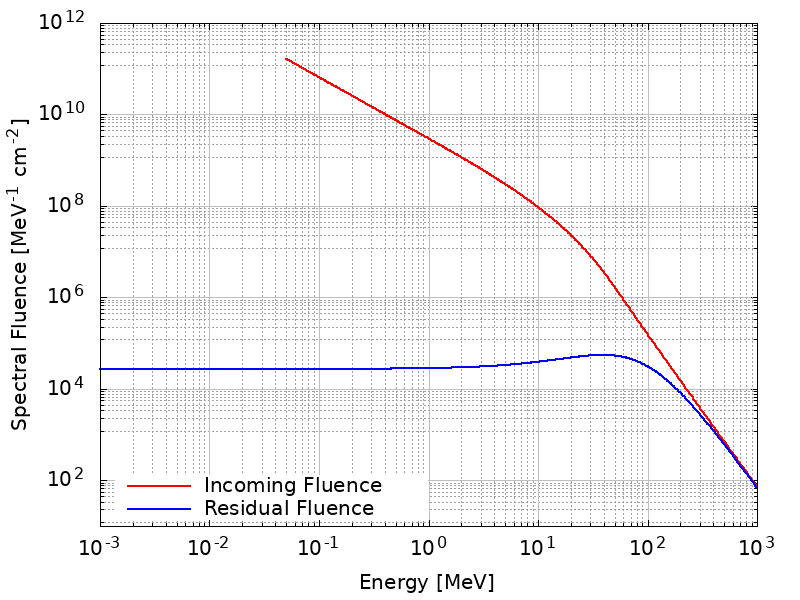

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  SEP 2017
Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)
Dose Mediana: 12.6303 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [10.709 - 14.740] mGy
Incertezza Totale: +2.110 / -1.921 mGy
-----------------------------------------------------------------


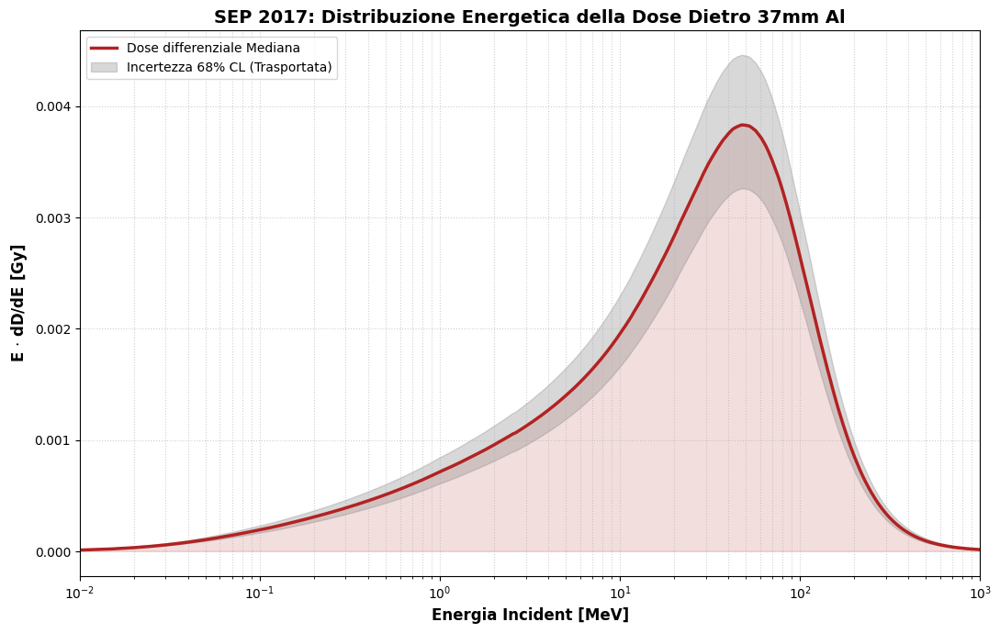

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "EXPORT_SEP2017_FINAL_Phi_Bands_usaquesto/planar/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "37mmAl_residual_planar_median.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "37mmAl_residual_planar_Phi16.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "37mmAl_residual_planar_Phi84.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  SEP 2017")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("SEP 2017: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.01, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# SPHERICAL SHIELDING 37mm Al

In [ ]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "EXPORT_SEP2017_FINAL_Phi_Bands_usaquesto/spherical/SEP17_Band_Spherical_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
5.000000e-02 5.000042e+11
5.083354e-02 4.897348e+11
5.168098e-02 4.792206e+11
5.254254e-02 4.692947e+11
5.341847e-02 4.593874e+11
5.430899e-02 4.496500e+11
5.521437e-02 4.401188e+11
5.613484e-02 4.309627e+11
5.707065e-02 4.220009e+11
5.802206e-02 4.132888e+11
5.898934e-02 4.047659e+11
5.997274e-02 3.963807e+11
6.097253e-02 3.881690e+11
6.198899e-02 3.800331e+11
6.302240e-02 3.719950e+11
6.407303e-02 3.641725e+11
6.514118e-02 3.566302e+11
6.622713e-02 3.490957e+11
6.733119e-02 3.417350e+11
6.845366e-02 3.347095e+11
6.959484e-02 3.277385e+11
7.075504e-02 3.210867e+11
7.193458e-02 3.145222e+11
7.313379e-02 3.081335e+11
7.435299e-02 3.018920e+11
7.559251e-02 2.957358e+11
7.685270e-02 2.897673e+11
7.813389e-02 2.838683e+11
7.943645e-02 2.780891e+11
8.076072e-02 2.724272e+11
8.210706e-02 2.668122e+11
8.347585e-02 2.611328e+11
8.486746e-02 2.55557

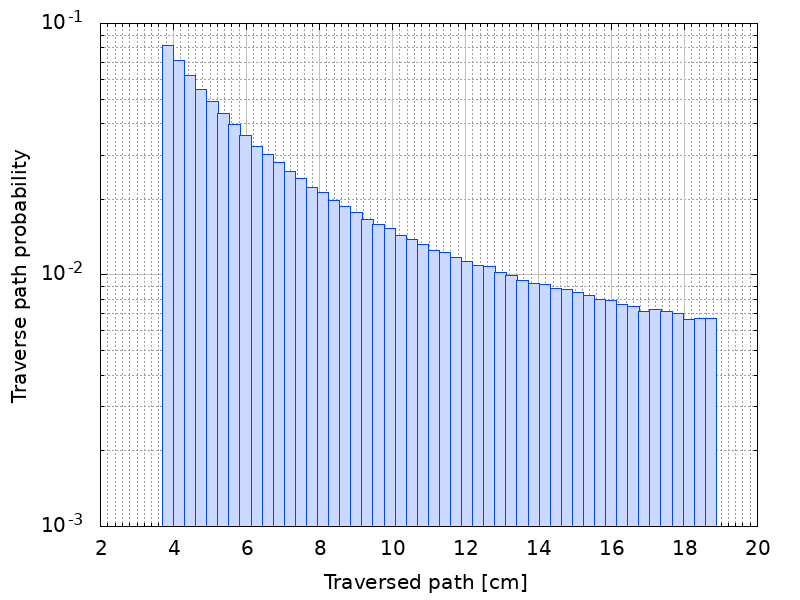
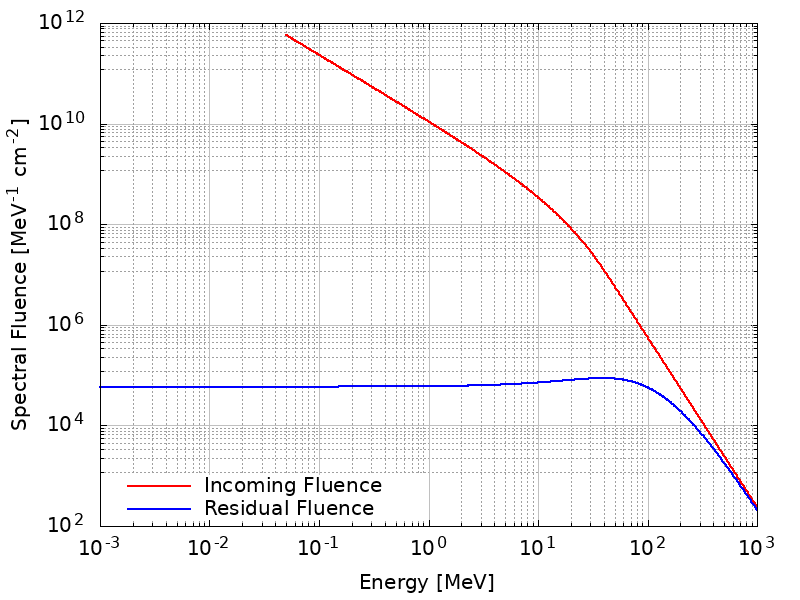

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  SEP 2017
Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)
Dose Mediana: 25.8368 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [21.955 - 30.075] mGy
Incertezza Totale: +4.238 / -3.881 mGy
-----------------------------------------------------------------


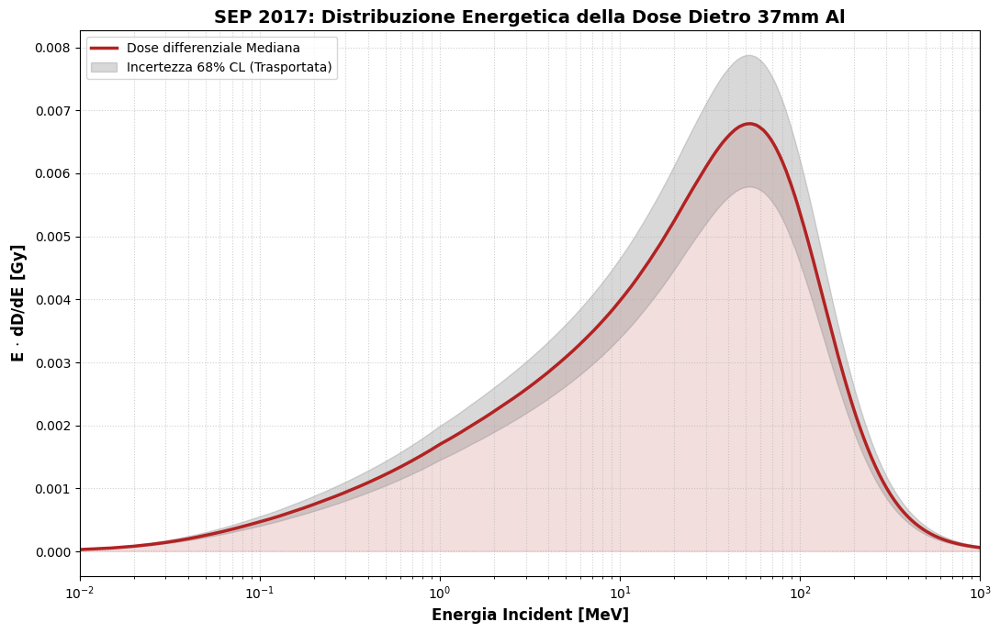

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "EXPORT_SEP2017_FINAL_Phi_Bands_usaquesto/spherical/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "37mmAl_residual_spherical_median.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "37mmAl_residual_spherical_Phi16.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "37mmAl_residual_spherical_Phi84.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.05 - 1000 MeV original export) -  SEP 2017")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("SEP 2017: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.01, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# OCT 2021

Caricamento dati e applicazione resampling (30 min)...
Calcolo background nel periodo: 2021-10-15 00:00 - 2021-10-26 00:00


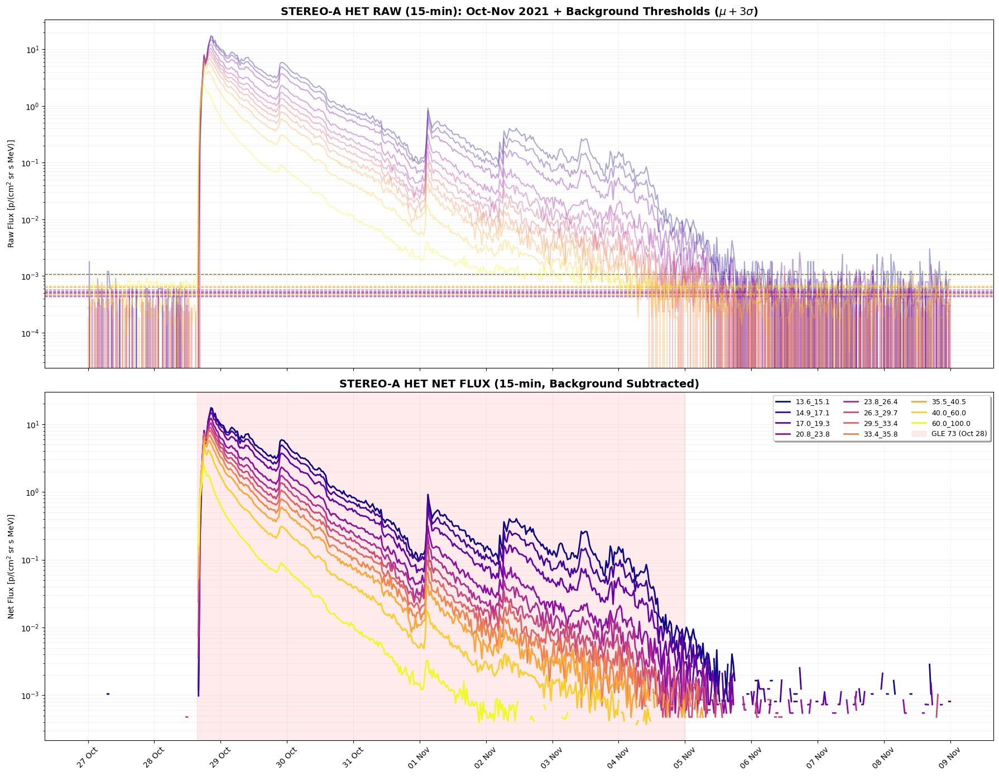

Analisi completata. Dataset pronto per l'integrazione della fluenza.


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import os

# =================================================================
# 1. FUNZIONI DI CARICAMENTO E UTILITY
# =================================================================
def load_stereo_het_raw(file_paths):
    all_dfs = []
    for file_path in file_paths:
        if not os.path.exists(file_path): 
            print(f"Attenzione: File non trovato {file_path}")
            continue
            
        skip = 0
        with open(file_path, 'r') as f:
            for i, line in enumerate(f):
                if "#End" in line:
                    skip = i + 1
                    break
        
        df = pd.read_csv(file_path, sep=r'\s+', skiprows=skip, header=None, dtype=str)
        # Formato: Anno Mese Giorno OraMin
        time_str = df[1] + " " + df[2] + " " + df[3] + " " + df[4]
        df['epoch'] = pd.to_datetime(time_str, format='%Y %b %d %H%M', errors='coerce')
        df = df.dropna(subset=['epoch']).set_index('epoch')
        
        col_mapping = {
            11: 'P_13.6_15.1_MeV', 13: 'P_14.9_17.1_MeV', 15: 'P_17.0_19.3_MeV',
            17: 'P_20.8_23.8_MeV', 19: 'P_23.8_26.4_MeV', 21: 'P_26.3_29.7_MeV',
            23: 'P_29.5_33.4_MeV', 25: 'P_33.4_35.8_MeV', 27: 'P_35.5_40.5_MeV',
            29: 'P_40.0_60.0_MeV', 31: 'P_60.0_100.0_MeV'
        }
        
        df_tmp = pd.DataFrame(index=df.index)
        for idx, name in col_mapping.items():
            df_tmp[name] = pd.to_numeric(df[idx], errors='coerce').clip(lower=0)
        all_dfs.append(df_tmp)

    return pd.concat(all_dfs).sort_index()

# =================================================================
# 2. CONFIGURAZIONE E ACQUISIZIONE DATI
# =================================================================
# Finestre temporali
bg_start, bg_end = '2021-10-15 00:00', '2021-10-26 00:00'
t_start_plot, t_end_plot = '2021-10-27 00:00', '2021-11-09 00:00'

# Percorsi file
base_path = "File_scaricati_eventiSEP/Evento OCT 2021/STEREO_A_HET/"
files = [os.path.join(base_path, "AeH21Oct.1m"), os.path.join(base_path, "AeH21Nov.1m")]

# Caricamento e RESAMPLING a 15 minuti
print("Caricamento dati e applicazione resampling (30 min)...")
df_raw = load_stereo_het_raw(files).resample('30min').mean()

# =================================================================
# 3. STATISTICHE DI BACKGROUND (METODO mu + 3*sigma)
# =================================================================
print(f"Calcolo background nel periodo: {bg_start} - {bg_end}")
bg_period = df_raw.loc[bg_start:bg_end]
mu = bg_period.mean()
sigma = bg_period.std()
threshold = mu + 3 * sigma

# Sottrazione e mascheramento
df_net = (df_raw - mu).clip(lower=0)
for col in df_net.columns:
    # Se il valore grezzo è sotto la soglia statistica, il segnale netto è considerato nullo
    df_net.loc[df_raw[col] < threshold[col], col] = 0.0

# =================================================================
# 4. VISUALIZZAZIONE RISULTATI
# =================================================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(18, 14), sharex=True)
colors = plt.cm.plasma(np.linspace(0, 1, len(df_raw.columns)))

# --- PANEL 1: RAW DATA + THRESHOLDS ---
for i, col in enumerate(df_raw.columns):
    ax1.plot(df_raw.loc[t_start_plot:t_end_plot].index, 
             df_raw.loc[t_start_plot:t_end_plot, col], color=colors[i], alpha=0.35)
    ax1.axhline(threshold[col], color=colors[i], ls='--', lw=1, alpha=0.8)

ax1.set_yscale('log')
ax1.set_title(r"STEREO-A HET RAW (15-min): Oct-Nov 2021 + Background Thresholds ($\mu + 3\sigma$)", fontsize=14, fontweight='bold')
ax1.set_ylabel("Raw Flux [p/(cm$^2$ sr s MeV)]")
ax1.grid(True, which="both", alpha=0.15)

# --- PANEL 2: NET DATA + EVENTS HIGHLIGHT ---
for i, col in enumerate(df_net.columns):
    plot_data = df_net.loc[t_start_plot:t_end_plot, col].replace(0, np.nan)
    ax2.plot(plot_data.index, plot_data, color=colors[i], lw=2, label=col.replace('P_', '').replace('_MeV', ''))

# Evidenziazione Eventi
ax2.axvspan(pd.to_datetime('2021-10-28 15:30'), pd.to_datetime('2021-11-05 00:00'), 
            color='red', alpha=0.08, label='GLE 73 (Oct 28)')

ax2.set_yscale('log')
ax2.set_title("STEREO-A HET NET FLUX (15-min, Background Subtracted)", fontsize=14, fontweight='bold')
ax2.set_ylabel("Net Flux [p/(cm$^2$ sr s MeV)]")
ax2.grid(True, which="both", alpha=0.15)
ax2.legend(loc='upper right', ncol=3, fontsize=9, frameon=True, shadow=True)

# Formattazione temporale
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

print("Analisi completata. Dataset pronto per l'integrazione della fluenza.")

--- Calcolo Fluenza STEREO-A HET: 2021-10-28 15:00 -> 2021-11-05 00:00 ---


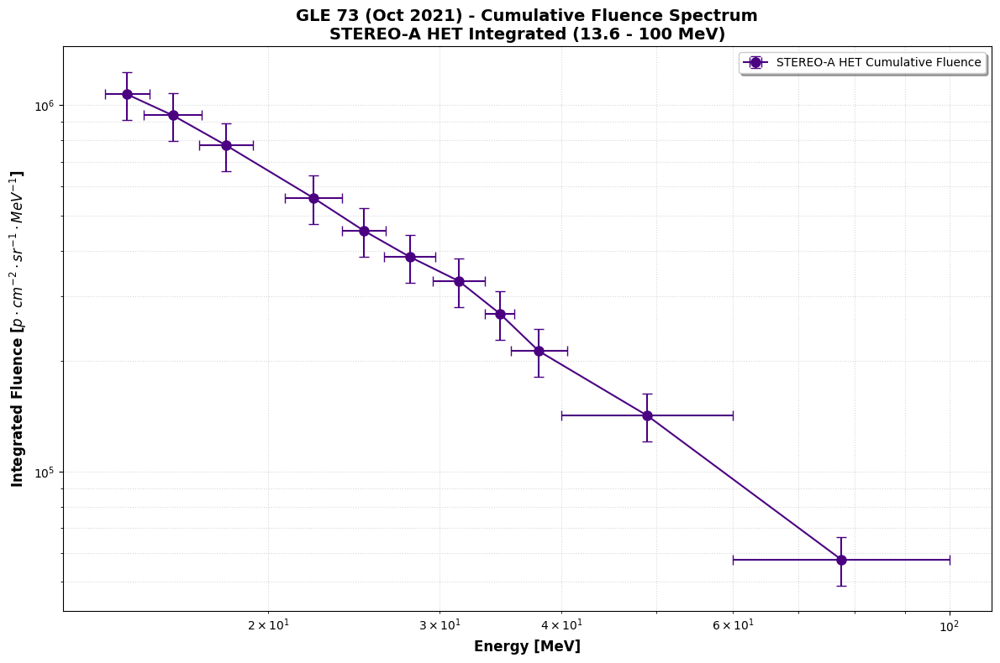


--- Riepilogo Dataset per Fit (Ottobre 2021) ---
         Channel     E_eff      Fluence         y_err
 P_13.6_15.1_MeV 14.330387 1.069633e+06 160444.989629
 P_14.9_17.1_MeV 15.962143 9.374517e+05 140617.755987
 P_17.0_19.3_MeV 18.113531 7.758927e+05 116383.912174
 P_20.8_23.8_MeV 22.249494 5.580441e+05  83706.614247
 P_23.8_26.4_MeV 25.066312 4.541621e+05  68124.317859
 P_26.3_29.7_MeV 27.948345 3.851901e+05  57778.512253
 P_29.5_33.4_MeV 31.389489 3.307415e+05  49611.224382
 P_33.4_35.8_MeV 34.579184 2.694951e+05  40424.261750
 P_35.5_40.5_MeV 37.917674 2.129875e+05  31948.121204
 P_40.0_60.0_MeV 48.989795 1.420052e+05  21300.775599
P_60.0_100.0_MeV 77.459667 5.749538e+04   8624.307216


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CONFIGURAZIONE BIN E ENERGIE EFFICACI (HET)
# ============================================================

# Definizione dei bin energetici basata sulla mappatura HET
het_bins = {
    'P_13.6_15.1_MeV': (13.6, 15.1),
    'P_14.9_17.1_MeV': (14.9, 17.1),
    'P_17.0_19.3_MeV': (17.0, 19.3),
    'P_20.8_23.8_MeV': (20.8, 23.8),
    'P_23.8_26.4_MeV': (23.8, 26.4),
    'P_26.3_29.7_MeV': (26.3, 29.7),
    'P_29.5_33.4_MeV': (29.5, 33.4),
    'P_33.4_35.8_MeV': (33.4, 35.8),
    'P_35.5_40.5_MeV': (35.5, 40.5),
    'P_40.0_60.0_MeV': (40.0, 60.0),
    'P_60.0_100.0_MeV': (60.0, 100.0)
}

# Incertezza sistematica HET (15%)
sys_err_het = 0.15

# ============================================================
# 2. INTEGRAZIONE TEMPORALE (GLE 73 SEQUENCE)
# ============================================================

# Intervallo di integrazione validato (dal flare fino al termine della sequenza)
t_start_int = '2021-10-28 15:00'
t_end_int   = '2021-11-05 00:00'
dt_seconds  = 30 * 60 
# Selezione periodo evento
df_event_slice = df_net.loc[t_start_int:t_end_int]

fluence_results = []

print(f"--- Calcolo Fluenza STEREO-A HET: {t_start_int} -> {t_end_int} ---")

for col, (e_min, e_max) in het_bins.items():
    if col in df_event_slice.columns:
        # Integrazione: Somma(Flusso * dt)
        # Usiamo fillna(0) per evitare che buchi nei dati annullino l'intera somma
        fluence_val = (df_event_slice[col].fillna(0) * dt_seconds).sum()
        
        if fluence_val > 0:
            # Calcolo Energia Efficace (Media Geometrica)
            e_eff = np.sqrt(e_min * e_max)
            
            # x_err: Distanza dai bordi del bin
            x_low = e_eff - e_min
            x_high = e_max - e_eff
            
            # y_err: Errore sistematico (10%)
            y_err_val = sys_err_het * fluence_val
            
            fluence_results.append({
                'Channel': col,
                'E_eff': e_eff,
                'Fluence': fluence_val,
                'y_err': y_err_val,
                'x_err_low': x_low,
                'x_err_high': x_high,
                'Instrument': 'HET'
            })

# Creazione DataFrame Fluenza
df_fluence_oct2021 = pd.DataFrame(fluence_results).sort_values('E_eff').reset_index(drop=True)

# ============================================================
# 3. VISUALIZZAZIONE SPETTRO INTEGRATO
# ============================================================

plt.figure(figsize=(12, 8))

plt.errorbar(df_fluence_oct2021['E_eff'], df_fluence_oct2021['Fluence'],
             xerr=[df_fluence_oct2021['x_err_low'], df_fluence_oct2021['x_err_high']],
             yerr=df_fluence_oct2021['y_err'],
             fmt='o-', color='indigo', markersize=8, capsize=4, elinewidth=1.5,
             label='STEREO-A HET Cumulative Fluence')

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.5)
plt.xlabel('Energy [MeV]', fontweight='bold', fontsize=12)
plt.ylabel(r'Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]', fontweight='bold', fontsize=12)
plt.title('GLE 73 (Oct 2021) - Cumulative Fluence Spectrum\nSTEREO-A HET Integrated (13.6 - 100 MeV)', fontsize=14, fontweight='bold')
plt.legend(shadow=True)

plt.tight_layout()
plt.show()

# Riepilogo numerico per il Fit
print("\n--- Riepilogo Dataset per Fit (Ottobre 2021) ---")
print(df_fluence_oct2021[['Channel', 'E_eff', 'Fluence', 'y_err']].to_string(index=False))

# FIT solo dati HET

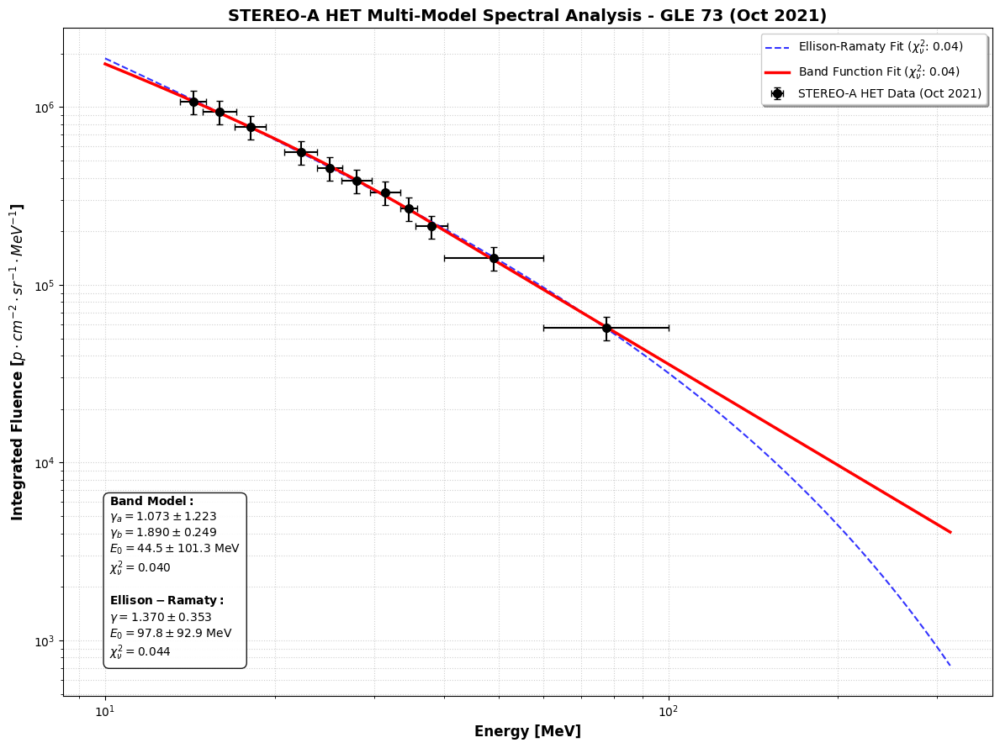

--- Fit Multi-Modello Completato ---


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.linalg import svd

# =========================================================
# 1. MODELLI FISICI (LOG-SPACE)
# =========================================================
def log_er(E, logA, gamma, E0):
    E0 = np.clip(E0, 0.1, 1000)
    return logA - gamma * np.log10(E) - (E / E0) / np.log(10)

def log_band(E, logA, ga, gb, E0):
    E0_s = np.clip(E0, 0.1, 1000)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E)
    mask = E <= ebreak
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

# =========================================================
# 2. ESECUZIONE FIT E MONTE CARLO
# =========================================================
x_data = df_fluence_oct2021['E_eff'].values
y_data = df_fluence_oct2021['Fluence'].values
y_err = df_fluence_oct2021['y_err'].values
sigma_log = y_err / (y_data * np.log(10))

# Fit Ellison-Ramaty e Band
popt_er, pcov_er = curve_fit(log_er, x_data, np.log10(y_data), p0=[7.5, 1.2, 50.0], sigma=sigma_log, absolute_sigma=True)
popt_band, pcov_band = curve_fit(log_band, x_data, np.log10(y_data), p0=[7.5, 1.1, 3.5, 30.0], sigma=sigma_log, absolute_sigma=True)

# Monte Carlo per errori parametri (SVD per stabilità)
def get_mc_errors(popt, pcov):
    U, s, Vh = svd((pcov + pcov.T) / 2)
    s = np.maximum(s, 1e-10 * np.max(s))
    z = np.random.default_rng(42).standard_normal((1000, len(popt)))
    samples = popt + z @ (np.sqrt(s)[:, None] * Vh)
    return np.std(samples, axis=0)

perr_er = get_mc_errors(popt_er, pcov_er)
perr_band = get_mc_errors(popt_band, pcov_band)

chi2_er = np.sum(((np.log10(y_data) - log_er(x_data, *popt_er))/sigma_log)**2) / (len(x_data) - 3)
chi2_band = np.sum(((np.log10(y_data) - log_band(x_data, *popt_band))/sigma_log)**2) / (len(x_data) - 4)

# =========================================================
# 3. PLOT FINALE COMPLETO
# =========================================================
e_grid = np.logspace(1, 2.5, 200)
plt.figure(figsize=(12, 9))

# Dati HET con xerr (bin width) e yerr (10% sys)
plt.errorbar(df_fluence_oct2021['E_eff'], df_fluence_oct2021['Fluence'], 
             xerr=[df_fluence_oct2021['x_err_low'], df_fluence_oct2021['x_err_high']],
             yerr=df_fluence_oct2021['y_err'], 
             fmt='ko', markersize=7, capsize=3, label='STEREO-A HET Data (Oct 2021)')

# Plot modelli
plt.plot(e_grid, 10**log_er(e_grid, *popt_er), 'b--', alpha=0.8,
         label=fr'Ellison-Ramaty Fit ($\chi^2_\nu$: {chi2_er:.2f})')

plt.plot(e_grid, 10**log_band(e_grid, *popt_band), 'r-', lw=2.5,
         label=fr'Band Function Fit ($\chi^2_\nu$: {chi2_band:.2f})')

plt.xscale('log'); plt.yscale('log')
plt.xlabel('Energy [MeV]', fontweight='bold', fontsize=12)
plt.ylabel(r'Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]', fontweight='bold', fontsize=12)
plt.title('STEREO-A HET Multi-Model Spectral Analysis - GLE 73 (Oct 2021)', fontsize=14, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)

# --- Box parametri aggiornato (Entrambi i modelli) ---
stats = (fr"$\bf{{Band\ Model:}}$" + "\n" +
         fr"$\gamma_a = {popt_band[1]:.3f} \pm {perr_band[1]:.3f}$" + "\n" +
         fr"$\gamma_b = {popt_band[2]:.3f} \pm {perr_band[2]:.3f}$" + "\n" +
         fr"$E_0 = {popt_band[3]:.1f} \pm {perr_band[3]:.1f}$ MeV" + "\n" +
         fr"$\chi^2_\nu = {chi2_band:.3f}$" + "\n\n" +
         fr"$\bf{{Ellison-Ramaty:}}$" + "\n" +
         fr"$\gamma = {popt_er[1]:.3f} \pm {perr_er[1]:.3f}$" + "\n" +
         fr"$E_0 = {popt_er[2]:.1f} \pm {perr_er[2]:.1f}$ MeV" + "\n" +
         fr"$\chi^2_\nu = {chi2_er:.3f}$")

plt.gca().text(0.05, 0.05, stats, transform=plt.gca().transAxes, fontsize=10, 
                verticalalignment='bottom', bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.9))

plt.legend(loc='upper right', shadow=True)
plt.tight_layout()
plt.show()

print(f"--- Fit Multi-Modello Completato ---")

# DATI LET

Trovati 23 file. Inizio caricamento...


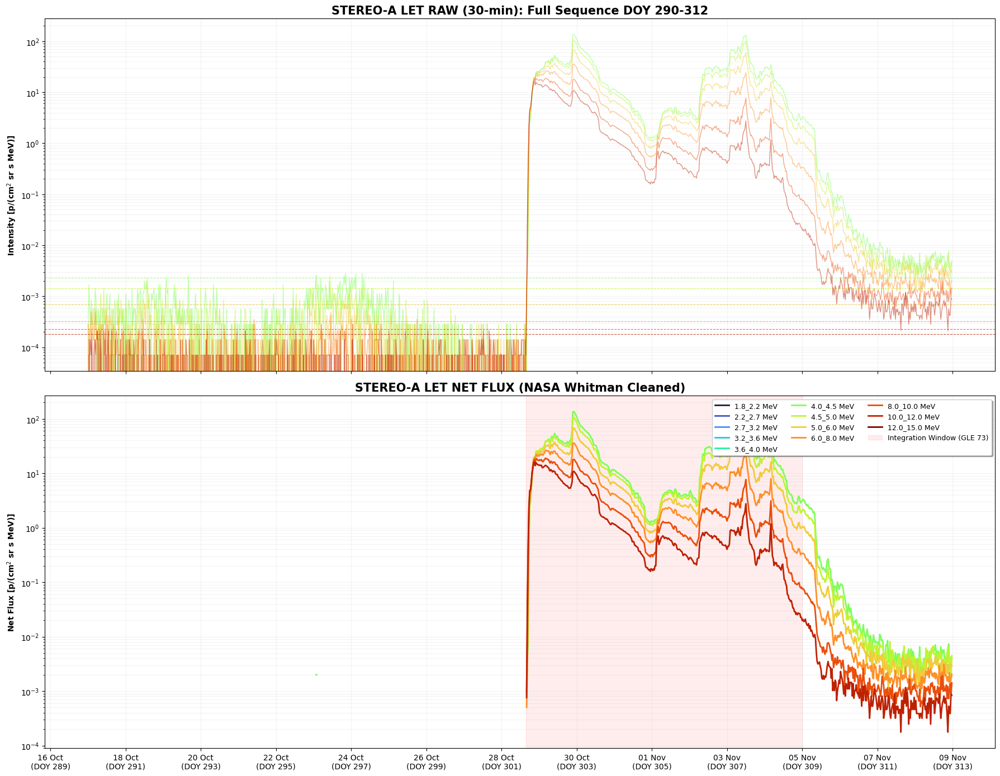

Analisi completata. Visualizzati dati dal 2021-10-17 00:00:00 al 2021-11-08 23:30:00.


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import glob
import os

# =================================================================
# 1. FUNZIONE DI CARICAMENTO RIGOROSA (STEREO LET LEVEL 1)
# =================================================================
def load_let_raw_sequence(folder_path):
    all_dfs = []
    # Pattern per caricare tutti i file della sequenza 2021
    file_list = sorted(glob.glob(os.path.join(folder_path, "H_ahead_2021_*_level1_11.txt")))
    
    if not file_list:
        print(f"Errore: Nessun file trovato in {folder_path}")
        return None

    print(f"Trovati {len(file_list)} file. Inizio caricamento...")

    for filepath in file_list:
        with open(filepath, 'r') as f:
            skip_to = 0
            for i, line in enumerate(f):
                if "BEGIN DATA" in line:
                    skip_to = i + 1
                    break
        
        df = pd.read_csv(filepath, sep=r'\s+', skiprows=skip_to, header=None)
        
        # Conversione Tempo: Anno (Col 0) + Day of Year decimale (Col 1)
        df['epoch'] = pd.to_datetime(df[0].astype(int).astype(str) + "-01-01") + \
                      pd.to_timedelta(df[1].astype(float) - 1, unit='D')
        df.set_index('epoch', inplace=True)
        
        let_cols = {
            7: 'P_1.8_2.2',   8: 'P_2.2_2.7',   9: 'P_2.7_3.2', 
            10: 'P_3.2_3.6',  11: 'P_3.6_4.0',  12: 'P_4.0_4.5', 
            13: 'P_4.5_5.0',  14: 'P_5.0_6.0',  15: 'P_6.0_8.0', 
            16: 'P_8.0_10.0', 17: 'P_10.0_12.0', 18: 'P_12.0_15.0'
        }
        
        df_tmp = pd.DataFrame(index=df.index)
        for idx, name in let_cols.items():
            series = pd.to_numeric(df[idx], errors='coerce')
            df_tmp[name] = series.where(series > -1e30, np.nan).clip(lower=0)
        all_dfs.append(df_tmp)

    return pd.concat(all_dfs).sort_index()

# =================================================================
# 2. CARICAMENTO E RESAMPLING (15 MIN)
# =================================================================
folder_let = "File_scaricati_eventiSEP/Evento OCT 2021/STEREO_A_LET/"
df_let_raw = load_let_raw_sequence(folder_let).resample('30min').mean()

# =================================================================
# 3. METODO NASA/WHITMAN (CALCOLO SU TUTTA LA SEQUENZA)
# =================================================================
# Background: Usiamo i primi giorni disponibili (DOY 290-298 circa) prima del flare
bg_start, bg_end = '2021-10-16 00:00', '2021-10-27 00:00'
bg_period = df_let_raw.loc[bg_start:bg_end]

mu = bg_period.mean()
sigma = bg_period.std()
threshold = mu + 3 * sigma

# Calcolo Net Flux
df_let_net = (df_let_raw - mu).clip(lower=0)
for col in df_let_net.columns:
    df_let_net.loc[df_let_raw[col] < threshold[col], col] = 0.0

# =================================================================
# 4. VISUALIZZAZIONE DOPPIO PANEL (ESTESA: OTT 17 - NOV 09)
# =================================================================
# Estendiamo i limiti per vedere bene dal DOY 290 al 312
t_plot_start, t_plot_end = '2021-10-16 12:00', '2021-11-09 12:00'

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(18, 14), sharex=True)
colors = plt.cm.turbo(np.linspace(0, 1, len(df_let_raw.columns)))

# --- PANEL 1: RAW + THRESHOLDS ---
for i, col in enumerate(df_let_raw.columns):
    ax1.plot(df_let_raw.loc[t_plot_start:t_plot_end].index, 
             df_let_raw.loc[t_plot_start:t_plot_end, col], color=colors[i], alpha=0.5, lw=1)
    ax1.axhline(threshold[col], color=colors[i], ls='--', lw=0.8, alpha=0.8)

ax1.set_yscale('log')
ax1.set_title(rf"STEREO-A LET RAW (30-min): Full Sequence DOY 290-312", fontsize=15, fontweight='bold')
ax1.set_ylabel("Intensity [p/(cm$^2$ sr s MeV)]", fontweight='bold')
ax1.grid(True, which="both", alpha=0.15)

# --- PANEL 2: NET FLUX + EVENT HIGHLIGHT ---
for i, col in enumerate(df_let_net.columns):
    plot_data = df_let_net.loc[t_plot_start:t_plot_end, col].replace(0, np.nan)
    ax2.plot(plot_data.index, plot_data, color=colors[i], lw=2, label=col.replace('P_', '') + ' MeV')

# Evidenziatore Fase Principale Evento (GLE 73)
ax2.axvspan(pd.to_datetime('2021-10-28 15:30'), pd.to_datetime('2021-11-05 00:00'), 
            color='red', alpha=0.07, label='Integration Window (GLE 73)')

ax2.set_yscale('log')
ax2.set_title("STEREO-A LET NET FLUX (NASA Whitman Cleaned)", fontsize=15, fontweight='bold')
ax2.set_ylabel("Net Flux [p/(cm$^2$ sr s MeV)]", fontweight='bold')
ax2.grid(True, which="both", alpha=0.15)
ax2.legend(loc='upper right', ncol=3, fontsize=9, frameon=True, shadow=True)

# Formattazione Asse X: Un tick ogni 2 giorni per non affollare
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b\n(DOY %j)'))
ax2.xaxis.set_major_locator(mdates.DayLocator(interval=2))
plt.xticks(rotation=0, ha='center') # Rotazione 0 per leggere meglio i DOY

plt.tight_layout()
plt.show()

print(f"Analisi completata. Visualizzati dati dal {df_let_raw.index.min()} al {df_let_raw.index.max()}.")

# CALCOLO FLUENZA LET

--- Calcolo Fluenza STEREO-A LET: 2021-10-28 15:00 -> 2021-11-05 00:00 ---


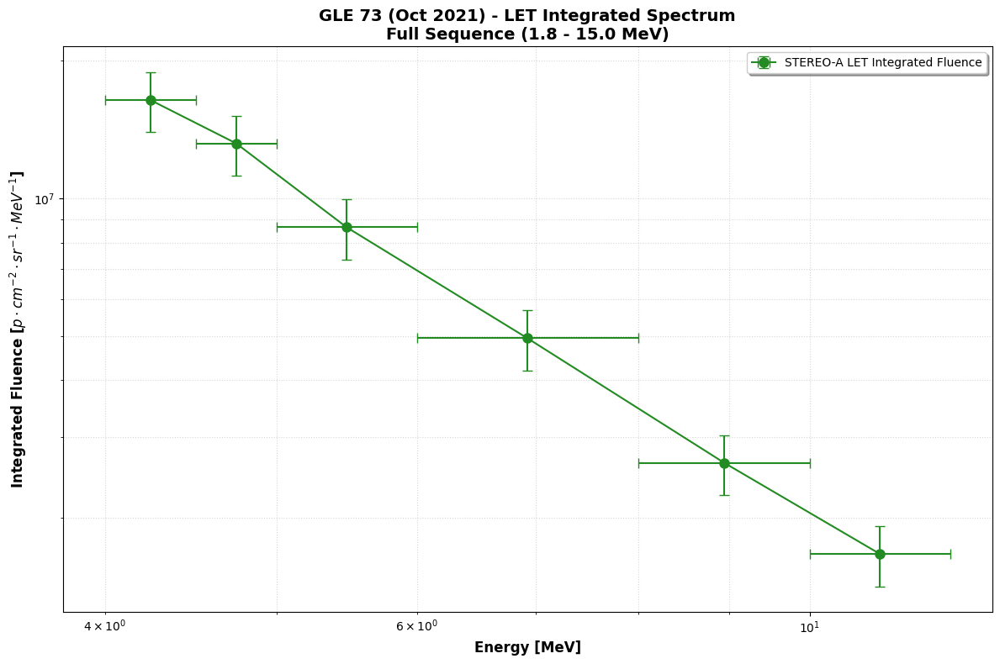


--- Tabella Fluenza LET (Ottobre 2021) ---
    E_eff      Fluence        y_err
 4.242641 1.640149e+07 2.460224e+06
 4.743416 1.318240e+07 1.977360e+06
 5.477226 8.635394e+06 1.295309e+06
 6.928203 4.938255e+06 7.407382e+05
 8.944272 2.638893e+06 3.958339e+05
10.954451 1.666242e+06 2.499362e+05


In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CONFIGURAZIONE BIN ENERGETICI (LET)
# ============================================================
# Mappatura basata sui canali 1.8 - 15.0 MeV
let_bins = {
    'P_1.8_2.2': (1.8, 2.2),   'P_2.2_2.7': (2.2, 2.7),   'P_2.7_3.2': (2.7, 3.2),
    'P_3.2_3.6': (3.2, 3.6),   'P_3.6_4.0': (3.6, 4.0),   'P_4.0_4.5': (4.0, 4.5),
    'P_4.5_5.0': (4.5, 5.0),   'P_5.0_6.0': (5.0, 6.0),   'P_6.0_8.0': (6.0, 8.0),
    'P_8.0_10.0': (8.0, 10.0), 'P_10.0_12.0': (10.0, 12.0), 'P_12.0_15.0': (12.0, 15.0)
}

# Incertezza sistematica LET (Tipicamente 15% per analisi di fluenza)
sys_err_let = 0.15 

# ============================================================
# 2. INTEGRAZIONE TEMPORALE (GLE 73 SEQUENCE)
# ============================================================
t_start_int = '2021-10-28 15:00'
t_end_int   = '2021-11-05 00:00'
dt_seconds  = 30 * 60  # Coerenza con resampling a 30min

# Selezione periodo evento dai dati NET (Background già sottratto)
df_let_slice = df_let_net.loc[t_start_int:t_end_int]

let_fluence_results = []

print(f"--- Calcolo Fluenza STEREO-A LET: {t_start_int} -> {t_end_int} ---")

for col, (e_min, e_max) in let_bins.items():
    if col in df_let_slice.columns:
        # Integrazione: Somma(Flusso * dt)
        # Il segnale è già pulito dal metodo Whitman (soglia 3-sigma)
        fluence_val = (df_let_slice[col].fillna(0) * dt_seconds).sum()
        
        if fluence_val > 0:
            # Calcolo Energia Efficace (Media Geometrica: sqrt(E1*E2))
            e_eff = np.sqrt(e_min * e_max)
            
            # Errori sulle energie (distanza dai bordi del bin)
            x_low = e_eff - e_min
            x_high = e_max - e_eff
            
            # Errore sulla fluenza (Sistematico 15%)
            y_err_val = sys_err_let * fluence_val
            
            let_fluence_results.append({
                'Channel': col,
                'E_eff': e_eff,
                'Fluence': fluence_val,
                'y_err': y_err_val,
                'x_err_low': x_low,
                'x_err_high': x_high,
                'Instrument': 'LET'
            })

# Creazione DataFrame Fluenza LET
df_fluence_let_oct2021 = pd.DataFrame(let_fluence_results).sort_values('E_eff').reset_index(drop=True)

# ============================================================
# 3. PLOT DI CONTROLLO SPETTRO LET
# ============================================================
plt.figure(figsize=(12, 8))

plt.errorbar(df_fluence_let_oct2021['E_eff'], df_fluence_let_oct2021['Fluence'],
             xerr=[df_fluence_let_oct2021['x_err_low'], df_fluence_let_oct2021['x_err_high']],
             yerr=df_fluence_let_oct2021['y_err'],
             fmt='o-', color='forestgreen', markersize=8, capsize=4, elinewidth=1.5,
             label='STEREO-A LET Integrated Fluence')

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.5)
plt.xlabel('Energy [MeV]', fontweight='bold', fontsize=12)
plt.ylabel(r'Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]', fontweight='bold', fontsize=12)
plt.title('GLE 73 (Oct 2021) - LET Integrated Spectrum\nFull Sequence (1.8 - 15.0 MeV)', fontsize=14, fontweight='bold')
plt.legend(shadow=True)

plt.tight_layout()
plt.show()

# Riepilogo per il Merge finale
print("\n--- Tabella Fluenza LET (Ottobre 2021) ---")
print(df_fluence_let_oct2021[['E_eff', 'Fluence', 'y_err']].to_string(index=False))

# UNIONE LET + HET

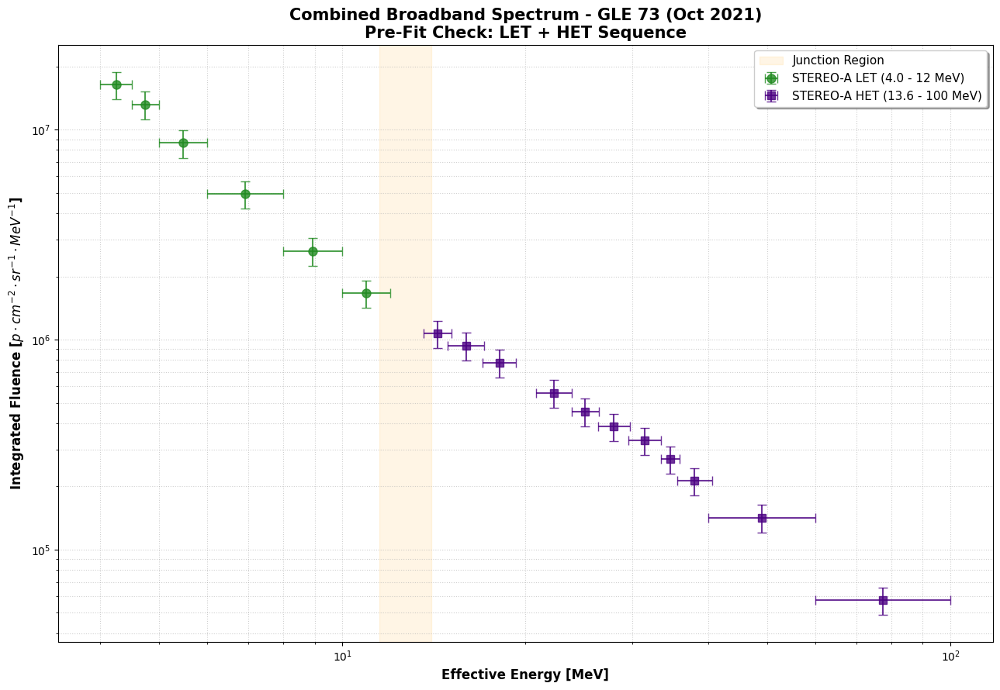

--- Verifica Raccordo LET-HET ---
Instrument     E_eff      Fluence
       LET 10.954451 1.666242e+06
       HET 14.330387 1.069633e+06
       HET 15.962143 9.374517e+05
       HET 18.113531 7.758927e+05


In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# ============================================================
# 1. UNIONE DEI DATASET (LET + HET) - OTTOBRE 2021
# ============================================================

# Concatenazione dei due DataFrame di fluenza (quelli creati nelle celle precedenti)
df_combined_oct2021 = pd.concat([df_fluence_let_oct2021, df_fluence_oct2021], ignore_index=True)

# Ordinamento rigoroso per energia
df_combined_oct2021 = df_combined_oct2021.sort_values('E_eff').reset_index(drop=True)

# ============================================================
# 2. PLOT BROADBAND DI VERIFICA
# ============================================================

plt.figure(figsize=(13, 9))

# Plot dati LET (Verde)
mask_let = df_combined_oct2021['Instrument'] == 'LET'
plt.errorbar(df_combined_oct2021.loc[mask_let, 'E_eff'], 
             df_combined_oct2021.loc[mask_let, 'Fluence'],
             xerr=[df_combined_oct2021.loc[mask_let, 'x_err_low'], df_combined_oct2021.loc[mask_let, 'x_err_high']],
             yerr=df_combined_oct2021.loc[mask_let, 'y_err'],
             fmt='o', color='forestgreen', markersize=8, capsize=4, elinewidth=1.5,
             label='STEREO-A LET (4.0 - 12 MeV)', alpha=0.8)

# Plot dati HET (Indaco/Blu)
mask_het = df_combined_oct2021['Instrument'] == 'HET'
plt.errorbar(df_combined_oct2021.loc[mask_het, 'E_eff'], 
             df_combined_oct2021.loc[mask_het, 'Fluence'],
             xerr=[df_combined_oct2021.loc[mask_het, 'x_err_low'], df_combined_oct2021.loc[mask_het, 'x_err_high']],
             yerr=df_combined_oct2021.loc[mask_het, 'y_err'],
             fmt='s', color='indigo', markersize=7, capsize=4, elinewidth=1.5,
             label='STEREO-A HET (13.6 - 100 MeV)', alpha=0.8)

# --- CONFIGURAZIONE GRAFICA ---
plt.xscale('log')
plt.yscale('log')
plt.grid(True, which="both", ls=':', alpha=0.6)

plt.xlabel('Effective Energy [MeV]', fontweight='bold', fontsize=12)
plt.ylabel(r'Integrated Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]', fontweight='bold', fontsize=12)
plt.title('Combined Broadband Spectrum - GLE 73 (Oct 2021)\nPre-Fit Check: LET + HET Sequence', fontsize=15, fontweight='bold')

# Evidenzia la zona di "gap" o raccordo tra i due strumenti
plt.axvspan(11.5, 14.0, color='orange', alpha=0.1, label='Junction Region')

plt.legend(loc='upper right', shadow=True, fontsize=11)
plt.tight_layout()
plt.show()

# ============================================================
# 3. VERIFICA DELLA PENDENZA
# ============================================================
print("--- Verifica Raccordo LET-HET ---")
junction = df_combined_oct2021[(df_combined_oct2021['E_eff'] > 10) & (df_combined_oct2021['E_eff'] < 20)]
print(junction[['Instrument', 'E_eff', 'Fluence']].to_string(index=False))

Avvio Bootstrap per log_er...
Avvio Bootstrap per log_band...

PARAMETRO       | ELLISON-RAMATY (BOOT)     | BAND MODEL (BOOT)        
---------------------------------------------------------------------------
logA            | 8.294 ± 0.055             | 8.301 ± 0.051            
ga (o gamma)    | 1.879 ± 0.043             | 1.848 ± 0.026            
gb              | N/A                       | 1.893 ± 0.042            
E0 [MeV]        | 1500.0 ± 129.5            | 63.3 ± 1.4               
Chi2_red        | 1.0335                       | 1.0758


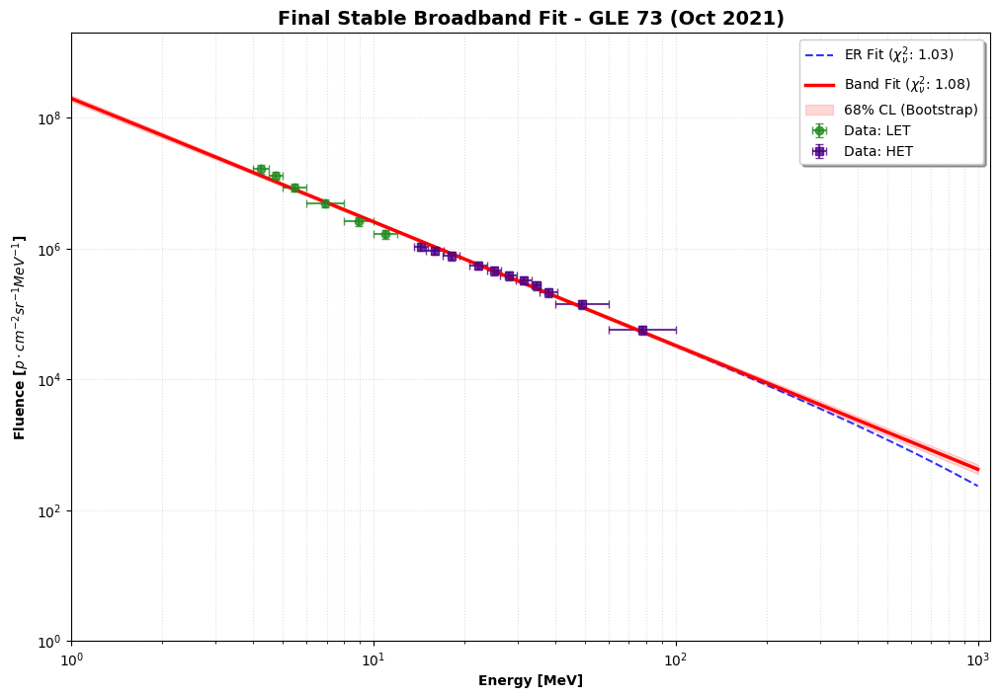

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import os

# =========================================================
# 1. MODELLI FISICI (LOG-SPACE)
# =========================================================
def log_er(E, logA, gamma, E0):
    E0 = np.clip(E0, 1.0, 2000)
    return logA - gamma * np.log10(E) - (E / E0) / np.log(10)

def log_band(E, logA, ga, gb, E0):
    E0_s = np.clip(E0, 1.0, 1000)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E)
    mask = E <= ebreak
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

# =========================================================
# 2. FUNZIONE BOOTSTRAP (UNICA VIA STABILE SENZA CALIBRAZIONE)
# =========================================================
def get_bootstrap_uncertainties(func, x, y, sigma, p0, bounds, n_boot=200):
    print(f"Avvio Bootstrap per {func.__name__}...")
    boot_params = []
    rng = np.random.default_rng(42)
    
    # Fit iniziale per centrare il bootstrap
    try:
        p_init, _ = curve_fit(func, x, y, p0=p0, sigma=sigma, bounds=bounds, method='trf')
    except:
        p_init = p0

    for i in range(n_boot):
        # Perturbazione dei dati basata sull'errore sperimentale
        noisy_y = y + rng.normal(0, sigma)
        try:
            p_boot, _ = curve_fit(func, x, noisy_y, p0=p_init, sigma=sigma, bounds=bounds, method='trf')
            boot_params.append(p_boot)
        except:
            continue
            
    boot_params = np.array(boot_params)
    if len(boot_params) == 0:
        return np.zeros(len(p0)), np.tile(p0, (n_boot, 1))
        
    return np.std(boot_params, axis=0), boot_params

# =========================================================
# 3. PREPARAZIONE DATI E FIT
# =========================================================
df_all = pd.concat([df_fluence_let_oct2021, df_fluence_oct2021], ignore_index=True).sort_values('E_eff')
x_data, y_data = df_all['E_eff'].values, df_all['Fluence'].values
sigma_log = df_all['y_err'].values / (y_data * np.log(10))
log_y = np.log10(y_data)

# Bounds robusti per Ottobre 2021
bounds_er = ([5, 0.5, 5], [13, 3.0, 1500])
bounds_band = ([5, 0.5, 1.1, 5], [13, 3.0, 6.0, 500])

# Esecuzione Bootstrap
perr_er, samples_er = get_bootstrap_uncertainties(log_er, x_data, log_y, sigma_log, [8.2, 1.8, 1000], bounds_er)
perr_band, samples_band = get_bootstrap_uncertainties(log_band, x_data, log_y, sigma_log, [8.2, 1.7, 2.5, 30], bounds_band)

popt_er = np.median(samples_er, axis=0)
popt_band = np.median(samples_band, axis=0)

# Chi-quadro ridotto
chi2_er = np.sum(((log_y - log_er(x_data, *popt_er))/sigma_log)**2) / (len(x_data) - 3)
chi2_band = np.sum(((log_y - log_band(x_data, *popt_band))/sigma_log)**2) / (len(x_data) - 4)

# =========================================================
# 4. OUTPUT E PLOT
# =========================================================
print("\n" + "="*75)
print(f"{'PARAMETRO':<15} | {'ELLISON-RAMATY (BOOT)':<25} | {'BAND MODEL (BOOT)':<25}")
print("-" * 75)
labels = ['logA', 'ga (o gamma)', 'gb', 'E0 [MeV]']
for i in range(4):
    if i < 2: # logA e gamma
        er_val = f"{popt_er[i]:.3f} ± {perr_er[i]:.3f}"
        band_val = f"{popt_band[i]:.3f} ± {perr_band[i]:.3f}"
    elif i == 2: # gb
        er_val = "N/A"
        band_val = f"{popt_band[i]:.3f} ± {perr_band[i]:.3f}"
    else: # E0
        er_val = f"{popt_er[2]:.1f} ± {perr_er[2]:.1f}"
        band_val = f"{popt_band[3]:.1f} ± {perr_band[3]:.1f}"
    print(f"{labels[i]:<15} | {er_val:<25} | {band_val:<25}")
print(f"{'Chi2_red':<15} | {chi2_er:.4f} {'':<21} | {chi2_band:.4f}")
print("="*75)

plt.figure(figsize=(12, 8))
e_grid = np.logspace(0, 3, 500)

# Dati sperimentali
for inst, col, m, lbl in [('LET', 'forestgreen', 'o', 'LET'), ('HET', 'indigo', 's', 'HET')]:
    mask = df_all['Instrument'] == inst
    plt.errorbar(df_all.loc[mask, 'E_eff'], df_all.loc[mask, 'Fluence'], 
                 xerr=[df_all.loc[mask, 'x_err_low'], df_all.loc[mask, 'x_err_high']],
                 yerr=df_all.loc[mask, 'y_err'], fmt=m, color=col, label=f'Data: {lbl}', capsize=3, alpha=0.8)

# Curve Mediane
plt.plot(e_grid, 10**log_er(e_grid, *popt_er), 'b--', alpha=0.8, label=fr'ER Fit ($\chi^2_\nu$: {chi2_er:.2f})')
plt.plot(e_grid, 10**log_band(e_grid, *popt_band), 'r-', lw=2.5, label=fr'Band Fit ($\chi^2_\nu$: {chi2_band:.2f})')

# Incertezza Band
fits_band = np.array([10**log_band(e_grid, *p) for p in samples_band])
plt.fill_between(e_grid, np.percentile(fits_band, 16, axis=0), np.percentile(fits_band, 84, axis=0), color='red', alpha=0.15, label='68% CL (Bootstrap)')

plt.xscale('log'); plt.yscale('log'); plt.xlim(1, 1100); plt.ylim(1e0, 2e9)
plt.xlabel('Energy [MeV]', fontweight='bold'); plt.ylabel(r'Fluence [$p \cdot cm^{-2} sr^{-1} MeV^{-1}$]', fontweight='bold')
plt.title('Final Stable Broadband Fit - GLE 73 (Oct 2021)', fontsize=14, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.4); plt.legend(loc='upper right', shadow=True); plt.show()

# CELLA FIT e EXPORT

Avvio Bootstrap per log_band (Range 1-1000 MeV)...


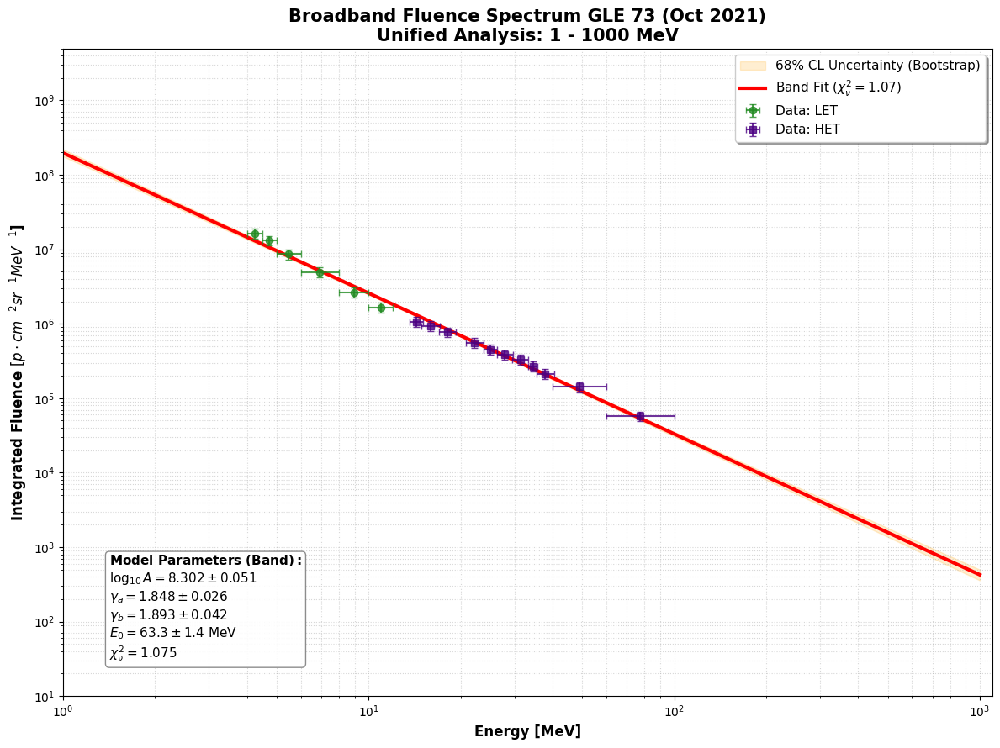

Export completato in: EXPORT_OCT2021_FINAL_STABLE_usaquesto


In [6]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import os

# =========================================================
# 1. MODELLI FISICI (LOG-SPACE)
# =========================================================
def log_band(E, logA, ga, gb, E0):
    E0_s = np.clip(E0, 1.0, 1000)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E)
    mask = E <= ebreak
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

# =========================================================
# 2. FUNZIONE BOOTSTRAP (STABILITÀ)
# =========================================================
def get_bootstrap_uncertainties(func, x, y, sigma, p0, bounds, n_boot=200):
    print(f"Avvio Bootstrap per {func.__name__} (Range 1-1000 MeV)...")
    boot_params = []
    rng = np.random.default_rng(42)
    try:
        p_init, _ = curve_fit(func, x, y, p0=p0, sigma=sigma, bounds=bounds, method='trf')
    except:
        p_init = p0
    for i in range(n_boot):
        noisy_y = y + rng.normal(0, sigma)
        try:
            p_boot, _ = curve_fit(func, x, noisy_y, p0=p_init, sigma=sigma, bounds=bounds, method='trf')
            boot_params.append(p_boot)
        except:
            continue
    return np.std(boot_params, axis=0), np.array(boot_params)

# =========================================================
# 3. PREPARAZIONE DATI E FIT
# =========================================================
df_all = pd.concat([df_fluence_let_oct2021, df_fluence_oct2021], ignore_index=True).sort_values('E_eff')
x_data, y_data = df_all['E_eff'].values, df_all['Fluence'].values
sigma_log = df_all['y_err'].values / (y_data * np.log(10))
log_y = np.log10(y_data)

bounds_band = ([5, 0.5, 1.1, 5], [13, 3.0, 6.0, 500])
perr_band, samples_band = get_bootstrap_uncertainties(log_band, x_data, log_y, sigma_log, [8.2, 1.7, 2.5, 30], bounds_band)

popt_band = np.median(samples_band, axis=0)
chi2_band = np.sum(((log_y - log_band(x_data, *popt_band))/sigma_log)**2) / (len(x_data) - 4)

# =========================================================
# 4. CALCOLO BANDE PER RANGE 1-1000 MeV
# =========================================================
E_grid = np.logspace(0, 3, 600) 
fits_band = np.array([10**log_band(E_grid, *p) for p in samples_band])
Phi_med = np.median(fits_band, axis=0)
Phi_lo, Phi_hi = np.percentile(fits_band, [16, 84], axis=0)

# =========================================================
# 5. PLOT PROFESSIONALE CON BOX RISULTATI
# =========================================================
plt.figure(figsize=(12, 9))

# Banda d'incertezza
plt.fill_between(E_grid, Phi_lo, Phi_hi, color='orange', alpha=0.18, label='68% CL Uncertainty (Bootstrap)')

# Curva Mediana
plt.plot(E_grid, Phi_med, color='red', lw=3, label=rf'Band Fit ($\chi^2_\nu = {chi2_band:.2f}$)')

# Dati Sperimentali
for inst, color, marker, lbl in [('LET', 'forestgreen', 'o', 'LET'), ('HET', 'indigo', 's', 'HET')]:
    m = df_all['Instrument'] == inst
    plt.errorbar(df_all.loc[m, 'E_eff'], df_all.loc[m, 'Fluence'], 
                 xerr=[df_all.loc[m, 'x_err_low'], df_all.loc[m, 'x_err_high']],
                 yerr=df_all.loc[m, 'y_err'], fmt=marker, color=color, label=f'Data: {lbl}', capsize=3, alpha=0.8)

# Configurazione Assi
plt.xscale("log"); plt.yscale("log"); plt.xlim(1, 1100); plt.ylim(1e1, 5e9)
plt.xlabel("Energy [MeV]", fontweight='bold', fontsize=12)
plt.ylabel(r"Integrated Fluence $[p \cdot cm^{-2} sr^{-1} MeV^{-1}$]", fontweight='bold', fontsize=12)
plt.title("Broadband Fluence Spectrum GLE 73 (Oct 2021)\nUnified Analysis: 1 - 1000 MeV", fontsize=15, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.5)

# --- CREAZIONE BOX PARAMETRI ---
# Utilizziamo rf"" per il supporto LaTeX nel box
stats_box = (
    r"$\bf{Model\ Parameters\ (Band):}$" + "\n" +
    rf"$\log_{{10}} A = {popt_band[0]:.3f} \pm {perr_band[0]:.3f}$" + "\n" +
    rf"$\gamma_a = {popt_band[1]:.3f} \pm {perr_band[1]:.3f}$" + "\n" +
    rf"$\gamma_b = {popt_band[2]:.3f} \pm {perr_band[2]:.3f}$" + "\n" +
    rf"$E_0 = {popt_band[3]:.1f} \pm {perr_band[3]:.1f}$ MeV" + "\n" +
    rf"$\chi^2_\nu = {chi2_band:.3f}$"
)

# Posizionamento del box (in basso a sinistra degli assi)
plt.gca().text(0.05, 0.05, stats_box, transform=plt.gca().transAxes, fontsize=11,
                verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='white', alpha=0.9, edgecolor='gray'))

plt.legend(loc="upper right", shadow=True, fontsize=11)
plt.tight_layout()
plt.show()

# =========================================================
# 6. EXPORT PER SR-NIEL
# =========================================================
out_dir = "EXPORT_OCT2021_FINAL_STABLE_usaquesto"
if not os.path.exists(out_dir): os.makedirs(out_dir)
for geo, factor in {"Planar": np.pi, "Spherical": 4 * np.pi}.items():
    np.savetxt(f"{out_dir}/OCT21_Band_{geo}_Median.txt", np.column_stack([E_grid, factor * Phi_med]), fmt="%.6e")
    np.savetxt(f"{out_dir}/OCT21_Band_{geo}_CL68.txt", np.column_stack([E_grid, factor * Phi_lo, factor * Phi_hi]), fmt="%.6e")

print(f"Export completato in: {out_dir}")

# J (E)

In [7]:
# ============================================================
# CALCOLO FLUENZE INTEGRALI — OCT 2021
# ============================================================

E_int = np.logspace(np.log10(0.5), 3, 5000)
phi_diff = 10**log_band(E_int, *popt_band)

print("\n--- FLUENZE INTEGRALI OCT 2021 (omnidirezionali, ×4π sr) ---")
for E_thresh in [10, 30, 60, 100, 500]:
    mask = E_int >= E_thresh
    J_omni = 4 * np.pi * np.trapezoid(phi_diff[mask], E_int[mask])
    print(f"  J(>{E_thresh} MeV) = {J_omni:.3e} cm⁻²")


--- FLUENZE INTEGRALI OCT 2021 (omnidirezionali, ×4π sr) ---
  J(>10 MeV) = 3.555e+08 cm⁻²
  J(>30 MeV) = 1.297e+08 cm⁻²
  J(>60 MeV) = 6.712e+07 cm⁻²
  J(>100 MeV) = 4.036e+07 cm⁻²
  J(>500 MeV) = 5.066e+06 cm⁻²


# CALCOLO DOSE Planar
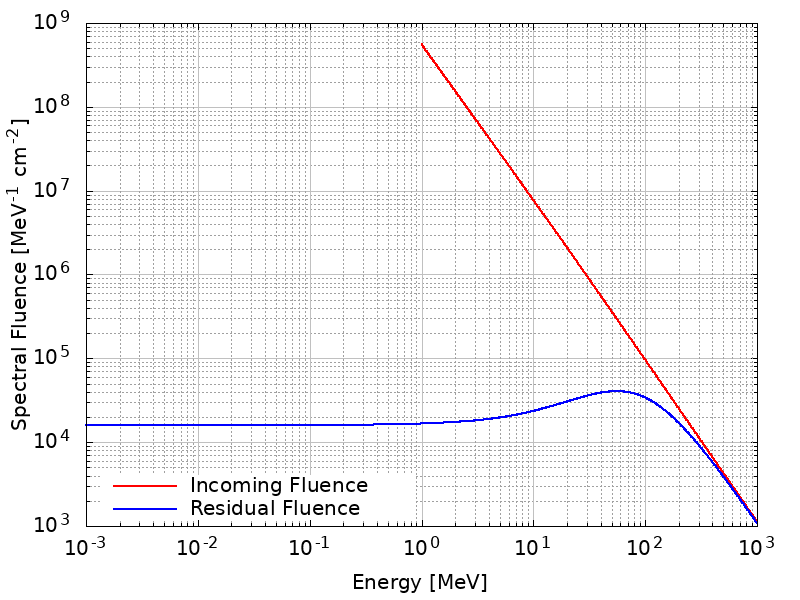

In [ ]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "EXPORT_OCT2021_FINAL_STABLE_usaquesto/planar/OCT21_Band_Planar_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
1.000000e+00 5.572301e+08
1.011599e+00 5.454303e+08
1.023332e+00 5.338803e+08
1.035202e+00 5.225750e+08
1.047209e+00 5.115090e+08
1.059356e+00 5.006774e+08
1.071643e+00 4.900751e+08
1.084073e+00 4.796974e+08
1.096647e+00 4.695394e+08
1.109367e+00 4.595965e+08
1.122234e+00 4.498699e+08
1.135251e+00 4.403710e+08
1.148418e+00 4.310727e+08
1.161739e+00 4.219706e+08
1.175214e+00 4.130608e+08
1.188845e+00 4.043391e+08
1.202634e+00 3.958016e+08
1.216583e+00 3.874443e+08
1.230694e+00 3.792635e+08
1.244969e+00 3.712554e+08
1.259409e+00 3.634165e+08
1.274017e+00 3.557430e+08
1.288794e+00 3.482316e+08
1.303743e+00 3.408787e+08
1.318865e+00 3.336812e+08
1.334162e+00 3.266356e+08
1.349637e+00 3.197387e+08
1.365291e+00 3.129875e+08
1.381127e+00 3.063789e+08
1.397147e+00 2.999098e+08
1.413352e+00 2.935772e+08
1.429746e+00 2.873735e+08
1.446329e+00 2.81252

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  OCT 2021
Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)
Dose Mediana: 12.8335 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [11.144 - 14.653] mGy
Incertezza Totale: +1.820 / -1.690 mGy
-----------------------------------------------------------------


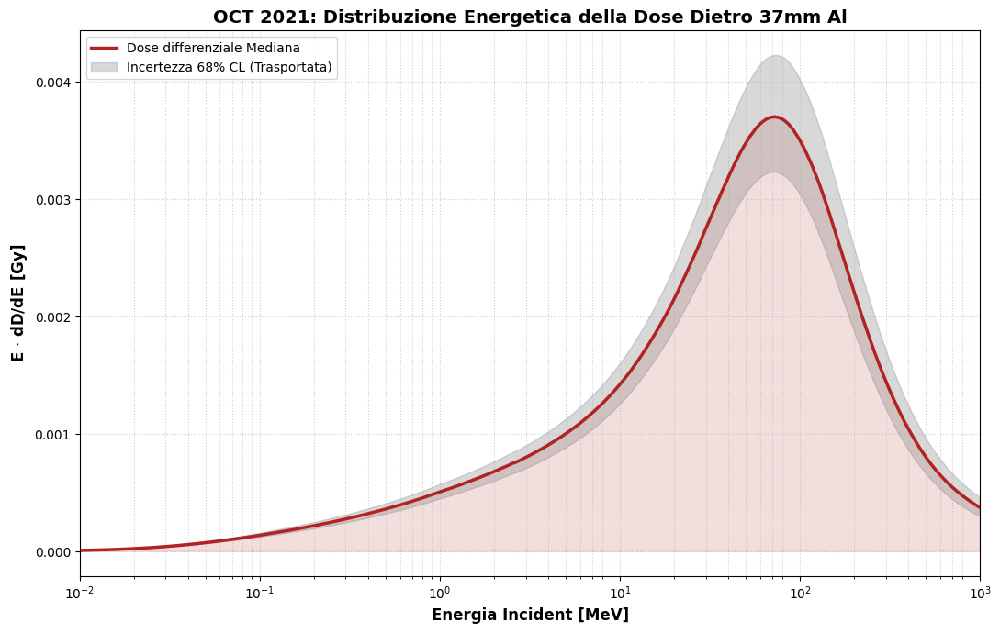

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "EXPORT_OCT2021_FINAL_STABLE_usaquesto/planar/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "37mmAl_planar_residual_median.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "37mmAl_planar_residual_Phi16.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "37mmAl_planar_residual_Phi84.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  OCT 2021")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("OCT 2021: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.01, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# CALCLO DOSE Spherical
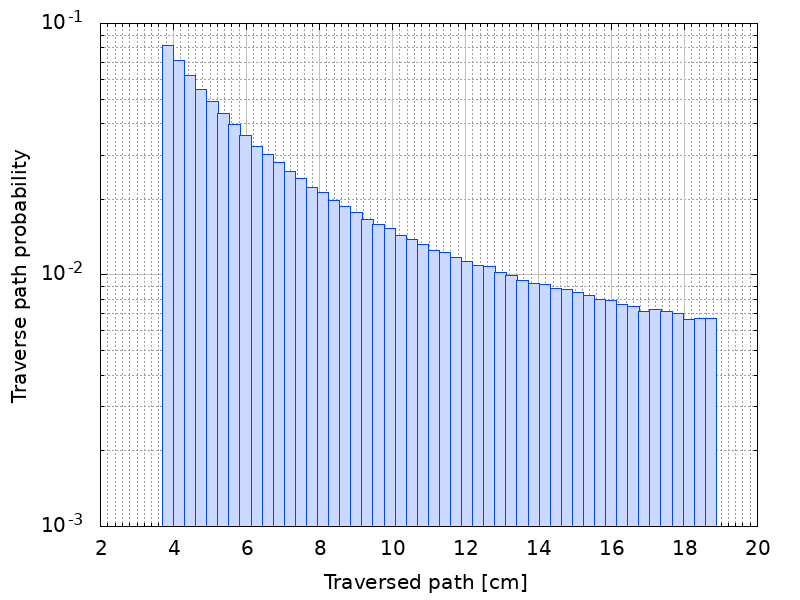
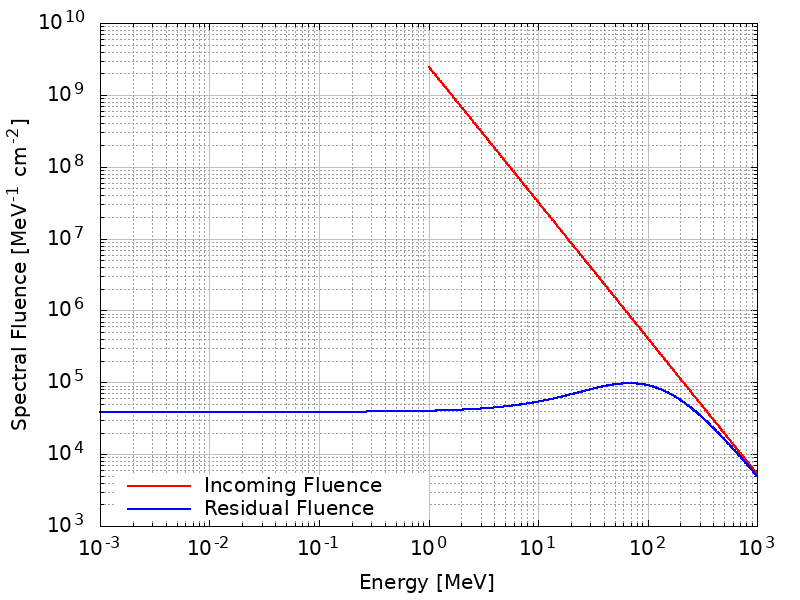

In [ ]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "EXPORT_OCT2021_FINAL_STABLE_usaquesto/spherical/OCT21_Band_Spherical_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
1.000000e+00 2.228920e+09
1.011599e+00 2.181721e+09
1.023332e+00 2.135521e+09
1.035202e+00 2.090300e+09
1.047209e+00 2.046036e+09
1.059356e+00 2.002710e+09
1.071643e+00 1.960301e+09
1.084073e+00 1.918790e+09
1.096647e+00 1.878158e+09
1.109367e+00 1.838386e+09
1.122234e+00 1.799480e+09
1.135251e+00 1.761484e+09
1.148418e+00 1.724291e+09
1.161739e+00 1.687883e+09
1.175214e+00 1.652243e+09
1.188845e+00 1.617356e+09
1.202634e+00 1.583206e+09
1.216583e+00 1.549777e+09
1.230694e+00 1.517054e+09
1.244969e+00 1.485022e+09
1.259409e+00 1.453666e+09
1.274017e+00 1.422972e+09
1.288794e+00 1.392926e+09
1.303743e+00 1.363515e+09
1.318865e+00 1.334725e+09
1.334162e+00 1.306542e+09
1.349637e+00 1.278955e+09
1.365291e+00 1.251950e+09
1.381127e+00 1.225516e+09
1.397147e+00 1.199639e+09
1.413352e+00 1.174309e+09
1.429746e+00 1.149494e+09
1.446329e+00 1.12500

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  OCT 2021
Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)
Dose Mediana: 30.9108 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [26.592 - 35.766] mGy
Incertezza Totale: +4.855 / -4.319 mGy
-----------------------------------------------------------------


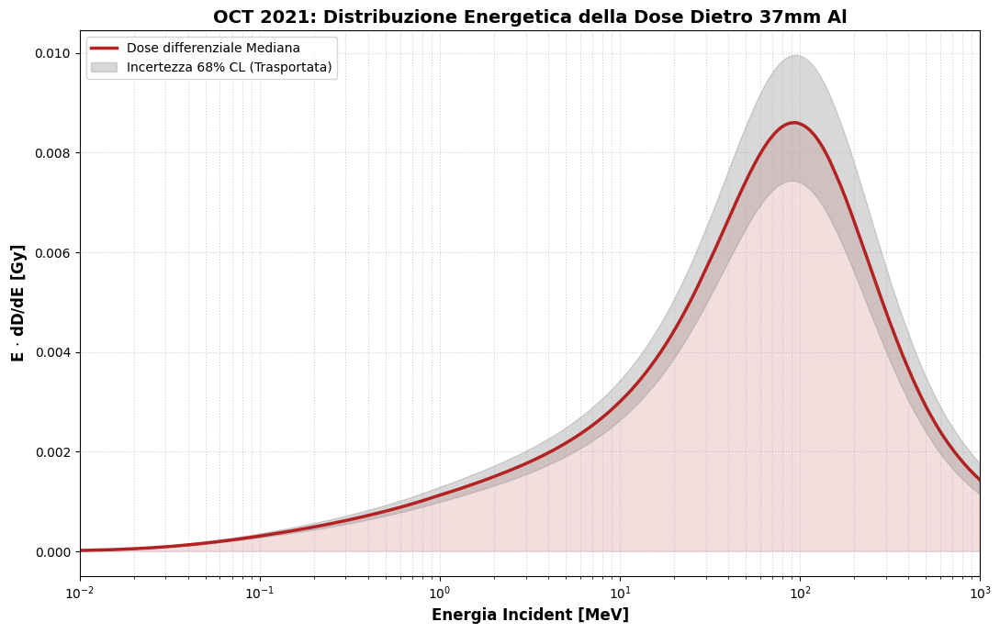

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "EXPORT_OCT2021_FINAL_STABLE_usaquesto/spherical/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "37mmAl_spherical_residual_median.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "37mmAl_spherical_residual_Phi16.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "37mmAl_spherical_residual_Phi84.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  OCT 2021")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("OCT 2021: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.01, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

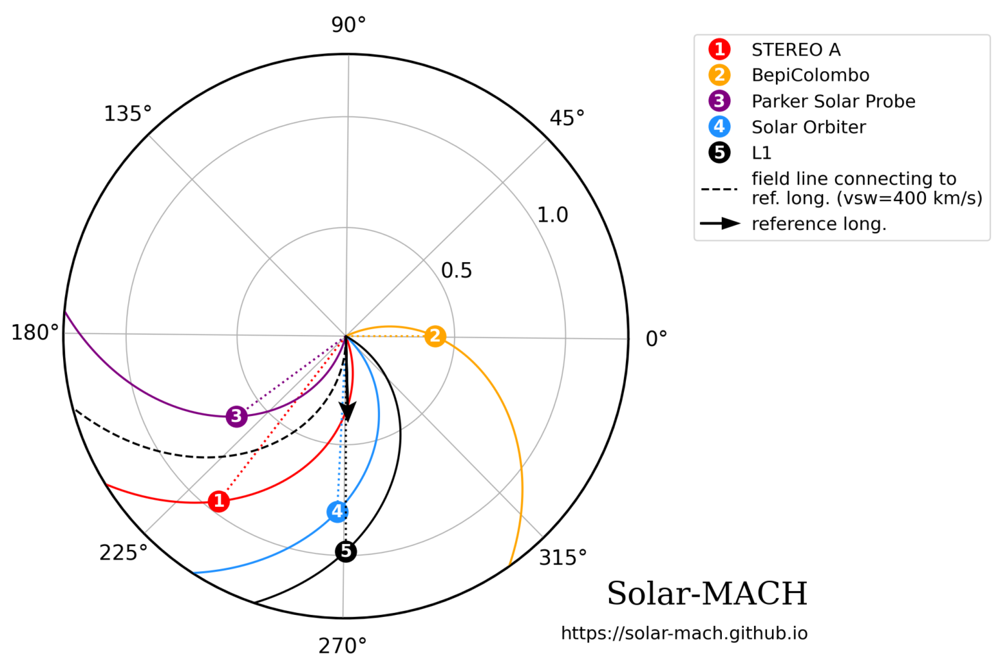

# MAY 2024

# CARICAMENTO DATI GOES 

In [1]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import glob
import numpy as np
import matplotlib as mpl
import os

# =============================================================================
# 2. RICERCA FILE E CARICAMENTO
# =============================================================================
folder_path = os.path.join("File_scaricati_eventiSEP", "EVENTO MAY 2024")
search_pattern = os.path.join(folder_path, "*.nc")



print(f"🔎 Cerco file in: {search_pattern}")
files = sorted(glob.glob(search_pattern))

if not files:
    print("❌ ERRORE: Nessun file trovato! Controlla il percorso.")
else:
    print(f"✅ Trovati {len(files)} file. Unione manuale in corso...")

    dataframes_list = []
    
    # Ciclo manuale per evitare errori Dask
    for f in files:
        try:
            with xr.open_dataset(f) as ds:
                df_temp = ds.to_dataframe()
                df_temp.reset_index(inplace=True)
                
                # Ottimizzazione: teniamo solo il flusso protoni e sensore Ovest (unit 0)
                if 'AvgDiffProtonFlux' in df_temp.columns:
                    df_temp = df_temp[df_temp['sensor_units'] == 0].copy()
                    dataframes_list.append(df_temp)
        except Exception as e:
            print(f"⚠️ Salto {os.path.basename(f)}: {e}")

    if dataframes_list:
        # Unione di tutti i DataFrame giornalieri
        df_proton = pd.concat(dataframes_list, ignore_index=True)
        print(f"Righe grezze totali: {len(df_proton)}")

        # --- CORREZIONE DUPLICATI ---
        # Fondamentale per file giornalieri che si sovrappongono a mezzanotte
        df_proton = df_proton.drop_duplicates(subset=['time', 'diff_channels'], keep='first')
        print(f"Righe pulite (senza duplicati): {len(df_proton)}")

🔎 Cerco file in: File_scaricati_eventiSEP\EVENTO MAY 2024\*.nc
✅ Trovati 31 file. Unione manuale in corso...
Righe grezze totali: 1276704
Righe pulite (senza duplicati): 116064


In [2]:
import xarray as xr
import os
import glob
import pandas as pd

# ==========================================
# 1. TROVA UN FILE DI ESEMPIO
# ==========================================
folder_path = os.path.join("File_scaricati_eventiSEP", "EVENTO MAY 2024")
# Cerca il primo file .nc disponibile per usarlo come "dizionario"
files = sorted(glob.glob(os.path.join(folder_path, "*.nc")))

if not files:
    print("Nessun file trovato!")
else:
    sample_file = files[0]
    print(f"Analisi del file: {os.path.basename(sample_file)}")

    # ==========================================
    # 2. APERTURA E ISPEZIONE
    # ==========================================
    try:
        with xr.open_dataset(sample_file) as ds:
            
            # A. Elenco Variabili (Colonne)
            print("\n--- VARIABILI DISPONIBILI NEL FILE ---")
            # Stampiamo solo quelle rilevanti per non intasare la console
            relevant_vars = [v for v in ds.data_vars if 'Proton' in v or 'Energy' in v]
            for v in relevant_vars:
                print(f" - {v}: {ds[v].dims}")

            # B. ESTRAZIONE RANGES ENERGETICI (La parte che ti serve!)
            # Le variabili chiave sono solitamente:
            # 'DiffProtonLowerEnergy', 'DiffProtonUpperEnergy', 'DiffProtonEffectiveEnergy'
            
            if 'DiffProtonLowerEnergy' in ds:
                # Selezioniamo il sensore 0 (West/Upright)
                # I canali sono 13 (0-12)
                lower = ds['DiffProtonLowerEnergy'].sel(sensor_units=0).values
                upper = ds['DiffProtonUpperEnergy'].sel(sensor_units=0).values
                eff   = ds['DiffProtonEffectiveEnergy'].sel(sensor_units=0).values
                
                print("\n--- TABELLA CANALI PROTONI (SGPS) ---")
                print(f"{'CH':<4} | {'Range (MeV)':<20} | {'E_eff (MeV)':<10}")
                print("-" * 45)
                
                # Creiamo un dizionario per uso futuro
                sgps_bins_mev = {}
                
                for i in range(len(lower)):
                    # I valori nel file sono in keV! Convertiamo in MeV (/1000)
                    l_mev = lower[i] / 1000.0
                    u_mev = upper[i] / 1000.0
                    e_mev = eff[i]   / 1000.0
                    
                    # Se il limite superiore è -999 o infinito, è un canale integrale
                    if u_mev < 0 or u_mev > 10000: 
                        range_str = f"> {l_mev:.1f}"
                        # Salviamo nel dizionario (senza upper bound)
                        sgps_bins_mev[i] = (l_mev, None)
                    else:
                        range_str = f"{l_mev:.2f} - {u_mev:.1f}"
                        sgps_bins_mev[i] = (l_mev, u_mev)
                        
                    print(f"P{i+1:<2}  | {range_str:<20} | {e_mev:.3f}")
                
                print("-" * 45)
                print("\nCopia questo dizionario nel tuo codice per i Fit:")
                print(sgps_bins_mev)
                
            else:
                print("\nERRORE: Variabili di energia non trovate. I nomi potrebbero essere diversi.")
                print("Tutte le variabili:", list(ds.data_vars))

    except Exception as e:
        print(f"Errore lettura: {e}")

Analisi del file: sci_sgps-l2-avg5m_g18_d20240501_v3-0-2.nc

--- VARIABILI DISPONIBILI NEL FILE ---
 - AvgDiffProtonFlux: ('time', 'sensor_units', 'diff_channels')
 - AvgDiffProtonFluxObserved: ('time', 'sensor_units', 'diff_channels')
 - AvgDiffProtonFluxUncert: ('time', 'sensor_units', 'diff_channels')
 - AvgIntProtonFlux: ('time', 'sensor_units')
 - AvgIntProtonFluxObserved: ('time', 'sensor_units')
 - AvgIntProtonFluxUncert: ('time', 'sensor_units')
 - DiffProtonLowerEnergy: ('sensor_units', 'diff_channels')
 - DiffProtonUpperEnergy: ('sensor_units', 'diff_channels')
 - DiffProtonEffectiveEnergy: ('sensor_units', 'diff_channels')
 - IntegralProtonEffectiveEnergy: ('sensor_units',)
 - DiffAlphaLowerEnergy: ('sensor_units', 'diff_alpha_channels')
 - DiffAlphaUpperEnergy: ('sensor_units', 'diff_alpha_channels')
 - DiffAlphaEffectiveEnergy: ('sensor_units', 'diff_alpha_channels')
 - DiffProtonIgnoredL1bDQFs: ('time', 'sensor_units', 'diff_channels')
 - IntProtonIgnoredL1bDQFs: ('time',

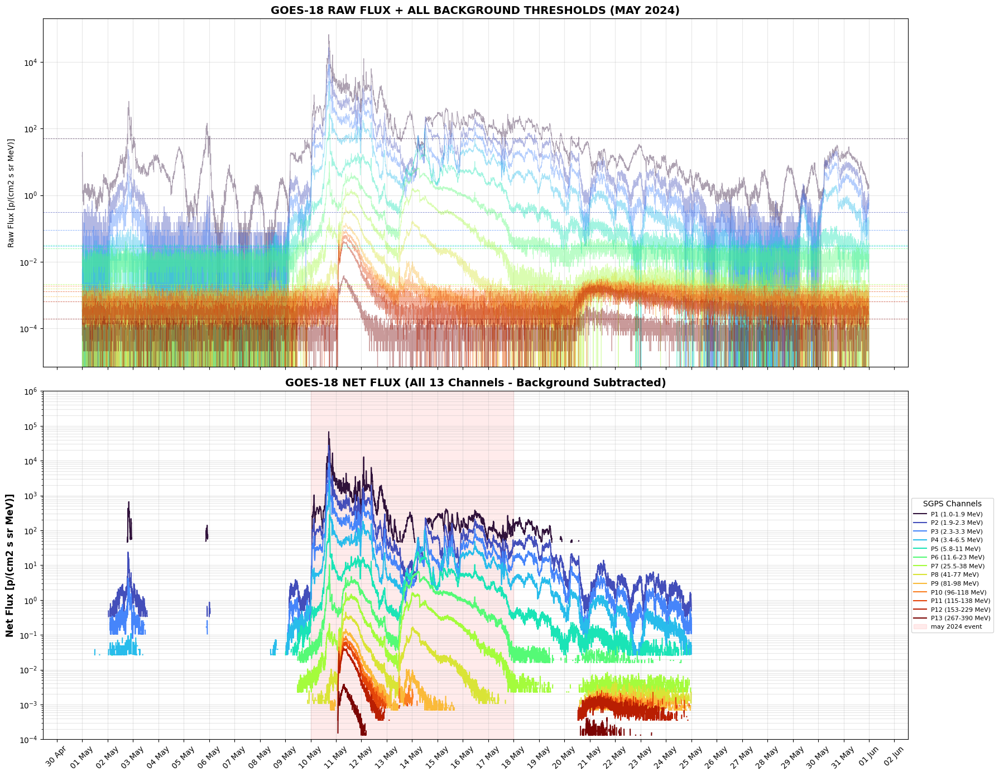

Dataset GOES-18 May 2024 pronto con 13 canali.


In [5]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np
import glob
import os

# ============================================================
# 1. CARICAMENTO DATI GOES-18 (SGPS)
# ============================================================
folder_path = os.path.join("File_scaricati_eventiSEP", "EVENTO MAY 2024")

def load_goes18_sgps(path):
    files = sorted(glob.glob(os.path.join(path, "*.nc")))
    dfs = []
    for f in files:
        with xr.open_dataset(f) as ds:
            # Selezione sensore 0 (Sunward) + Conversione keV^-1 -> MeV^-1 (*1000)
            df = ds['AvgDiffProtonFlux'].sel(sensor_units=0).to_series().unstack()
            dfs.append(df * 1000.0)
    return pd.concat(dfs).sort_index().drop_duplicates()

df_raw = load_goes18_sgps(folder_path)

# Finestre temporali (May 2024)
t_start, t_end = '2024-05-01 00:00:00', '2024-05-25 00:00:00'
bg_start, bg_end = '2024-05-04 00:00:00', '2024-05-08 00:00:00'

# ============================================================
# 2. CALCOLO SOGLIE E RIMOZIONE BACKGROUND
# ============================================================

def get_bg_stats(df, bg_s, bg_e):
    bg_period = df.loc[bg_s:bg_e]
    mu = bg_period.mean()
    sigma = bg_period.std()
    return mu, mu + 3 * sigma

def apply_correction(df, mu, thresh, t_s, t_e):
    df_ev = df.loc[t_s:t_e].copy()
    df_corr = (df_ev - mu).clip(lower=0) 
    for col in df_corr.columns:
        df_corr.loc[df_ev[col] < thresh[col], col] = 0.0
    return df_corr

mu, thresholds = get_bg_stats(df_raw, bg_start, bg_end)
df_net = apply_correction(df_raw, mu, thresholds, t_start, t_end)

# ============================================================
# 3. MAPPATURA ENERGIE (SGPS GOES-18 - Tutti i 13 Canali)
# ============================================================
# Etichette complete basate sui bin ufficiali
energy_labels = {
    0: '1.0-1.9 MeV',   1: '1.9-2.3 MeV',   2: '2.3-3.3 MeV',   3: '3.4-6.5 MeV',
    4: '5.8-11 MeV',    5: '11.6-23 MeV',   6: '25.5-38 MeV',   7: '41-77 MeV',
    8: '81-98 MeV',     9: '96-118 MeV',   10: '115-138 MeV',  11: '153-229 MeV',
    12: '267-390 MeV'
}

# ============================================================
# 4. PLOT DI CONTROLLO: RAW vs NET (TUTTI I CANALI)
# ============================================================

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(18, 14), sharex=True)
# Usiamo una colormap che gestisca bene 13 linee
colors = plt.cm.turbo(np.linspace(0, 1, 13))

# --- PANEL 1: RAW DATA + THRESHOLDS (All 13) ---
for ch in range(13):
    ax1.plot(df_raw.index, df_raw[ch], color=colors[ch], alpha=0.4, lw=0.8)
    ax1.axhline(thresholds[ch], color=colors[ch], ls='--', lw=0.6, alpha=0.7)

ax1.set_yscale('log')
ax1.set_title('GOES-18 RAW FLUX + ALL BACKGROUND THRESHOLDS (MAY 2024)', fontsize=14, fontweight='bold')
ax1.set_ylabel('Raw Flux [p/(cm2 s sr MeV)]')
ax1.grid(True, which="both", alpha=0.3)

# --- PANEL 2: NET DATA + EVENT HIGHLIGHTS (All 13) ---
events = {
    "may 2024 event": ("2024-05-10 00:00", "2024-05-18 00:00", "red"),
}

for ch in range(13):
    # Mascheriamo gli zeri per il plot logaritmico
    plot_data = df_net[ch].replace(0, np.nan)
    ax2.plot(plot_data.index, plot_data, color=colors[ch], lw=1.5, label=f"P{ch+1} ({energy_labels[ch]})")

for name, (start, end, color) in events.items():
    ax2.axvspan(pd.to_datetime(start), pd.to_datetime(end), color=color, alpha=0.08, label=name)

ax2.set_yscale('log')
ax2.set_ylim(1e-4, 1e6)
ax2.set_ylabel('Net Flux [p/(cm2 s sr MeV)]', fontsize=12, fontweight='bold')
ax2.set_title('GOES-18 NET FLUX (All 13 Channels - Background Subtracted)', fontsize=14, fontweight='bold')

# Posizioniamo la legenda esternamente per non coprire i dati
ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize=8, title="SGPS Channels")
ax2.grid(True, which="both", alpha=0.3)

# Formattazione asse X
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

print(f"Dataset GOES-18 May 2024 pronto con {len(df_net.columns)} canali.")

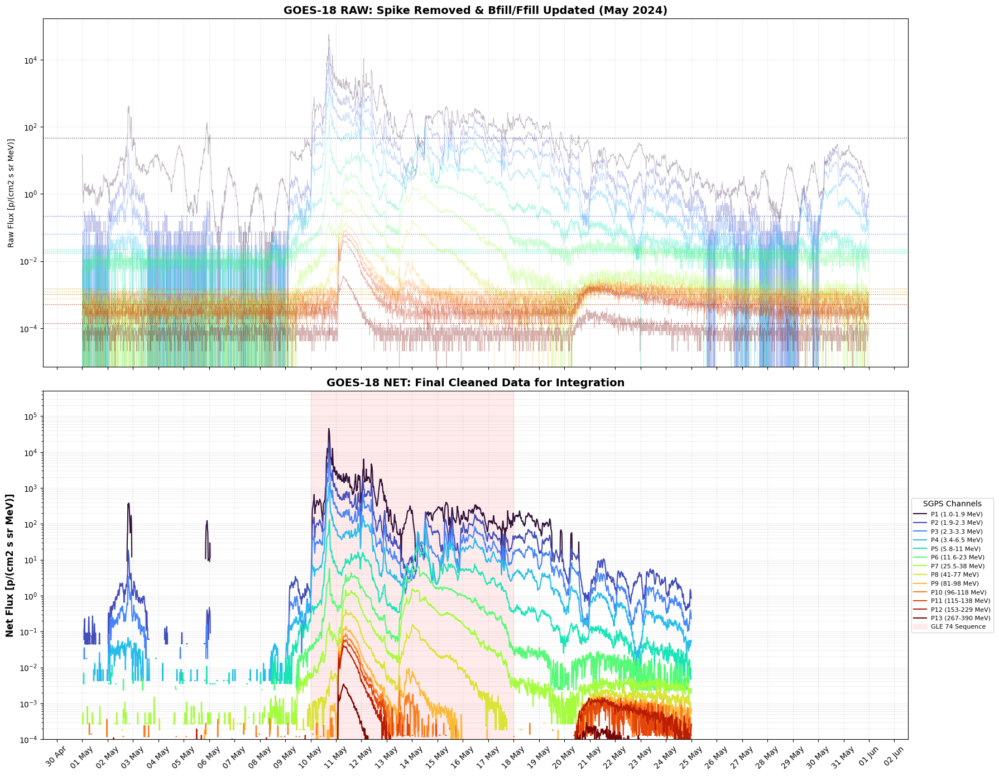

Dataset GOES-18 May 2024 pulito correttamente (Pandas 2.x compatible).


In [6]:
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np
import glob
import os

# ============================================================
# 1. CARICAMENTO E PULIZIA STRUMENTALE (V2.1 - No Warnings)
# ============================================================
folder_path = os.path.join("File_scaricati_eventiSEP", "EVENTO MAY 2024")

def load_goes18_sgps_v2_1(path):
    files = sorted(glob.glob(os.path.join(path, "*.nc")))
    dfs = []
    for f in files:
        with xr.open_dataset(f) as ds:
            # Selezione sensore 0 (Sunward) + Conversione keV^-1 -> MeV^-1 (*1000)
            df = ds['AvgDiffProtonFlux'].sel(sensor_units=0).to_series().unstack()
            dfs.append(df * 1000.0)
    
    full_df = pd.concat(dfs).sort_index().drop_duplicates()
    
    # --- STEP DI PULIZIA AGGIORNATI ---
    # 1. Rimozione Spike con Median Filter (Finestra 3)
    # Usiamo bfill() e ffill() invece di fillna(method=...) per evitare FutureWarning
    full_df = full_df.rolling(window=3, center=True).median().bfill().ffill()
    
    # 2. Interpolazione: Riempimento piccoli buchi temporali (max 5 campioni, circa 25 min)
    full_df = full_df.interpolate(method='linear', limit=5)
    
    return full_df

df_raw = load_goes18_sgps_v2_1(folder_path)

# Finestre temporali (May 2024)
t_start, t_end = '2024-05-01 00:00:00', '2024-05-25 00:00:00'
bg_start, bg_end = '2024-05-04 00:00:00', '2024-05-08 00:00:00'

# ============================================================
# 2. BACKGROUND E SOGLIA (V2.1)
# ============================================================

def get_bg_stats(df, bg_s, bg_e):
    bg_period = df.loc[bg_s:bg_e]
    # La mediana è più robusta della media contro spike residui nel background
    mu = bg_period.median()
    sigma = bg_period.std()
    return mu, mu + 3 * sigma

def apply_correction_v2_1(df, mu, thresh, t_s, t_e):
    df_ev = df.loc[t_s:t_e].copy()
    # Sottrazione del background (GCR baseline)
    df_corr = (df_ev - mu).clip(lower=0) 
    
    # Filtro di significatività (Adaptive Thresholding)
    for col in df_corr.columns:
        # Se il dato raw è sotto mu + 3sigma, lo consideriamo rumore e lo azzeriamo
        df_corr.loc[df_ev[col] < thresh[col], col] = 0.0
    
    # Smoothing finale (Moving Average) per stabilizzare il decadimento per il fit
    df_corr = df_corr.rolling(window=5, center=True).mean().bfill().ffill()
    
    return df_corr

mu, thresholds = get_bg_stats(df_raw, bg_start, bg_end)
df_net = apply_correction_v2_1(df_raw, mu, thresholds, t_start, t_end)

# ============================================================
# 3. MAPPATURA ENERGIE (SGPS GOES-18)
# ============================================================
energy_labels = {
    0: '1.0-1.9 MeV',   1: '1.9-2.3 MeV',   2: '2.3-3.3 MeV',   3: '3.4-6.5 MeV',
    4: '5.8-11 MeV',    5: '11.6-23 MeV',   6: '25.5-38 MeV',   7: '41-77 MeV',
    8: '81-98 MeV',     9: '96-118 MeV',   10: '115-138 MeV',  11: '153-229 MeV',
    12: '267-390 MeV'
}

# ============================================================
# 4. PLOT DI CONTROLLO (Tutti i 13 canali)
# ============================================================

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(18, 14), sharex=True)
colors = plt.cm.turbo(np.linspace(0, 1, 13))

# PANEL 1: RAW DATA
for ch in range(13):
    ax1.plot(df_raw.index, df_raw[ch], color=colors[ch], alpha=0.3, lw=0.7)
    ax1.axhline(thresholds[ch], color=colors[ch], ls=':', lw=1, alpha=0.8)

ax1.set_yscale('log')
ax1.set_title('GOES-18 RAW: Spike Removed & Bfill/Ffill Updated (May 2024)', fontsize=14, fontweight='bold')
ax1.set_ylabel('Raw Flux [p/(cm2 s sr MeV)]')
ax1.grid(True, which="both", alpha=0.2)

# PANEL 2: NET DATA
events_highlight = {"GLE 74 Sequence": ("2024-05-10 00:00", "2024-05-18 00:00", "red")}

for ch in range(13):
    plot_data = df_net[ch].replace(0, np.nan)
    ax2.plot(plot_data.index, plot_data, color=colors[ch], lw=1.5, label=f"P{ch+1} ({energy_labels[ch]})")

for name, (start, end, color) in events_highlight.items():
    ax2.axvspan(pd.to_datetime(start), pd.to_datetime(end), color=color, alpha=0.08, label=name)

ax2.set_yscale('log')
ax2.set_ylim(1e-4, 5e5)
ax2.set_ylabel('Net Flux [p/(cm2 s sr MeV)]', fontsize=12, fontweight='bold')
ax2.set_title('GOES-18 NET: Final Cleaned Data for Integration', fontsize=14, fontweight='bold')
ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize=8, title="SGPS Channels")
ax2.grid(True, which="both", alpha=0.2)

ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

print(f"Dataset GOES-18 May 2024 pulito correttamente (Pandas 2.x compatible).")

# CALCOLO FLUENZA DATI GOES


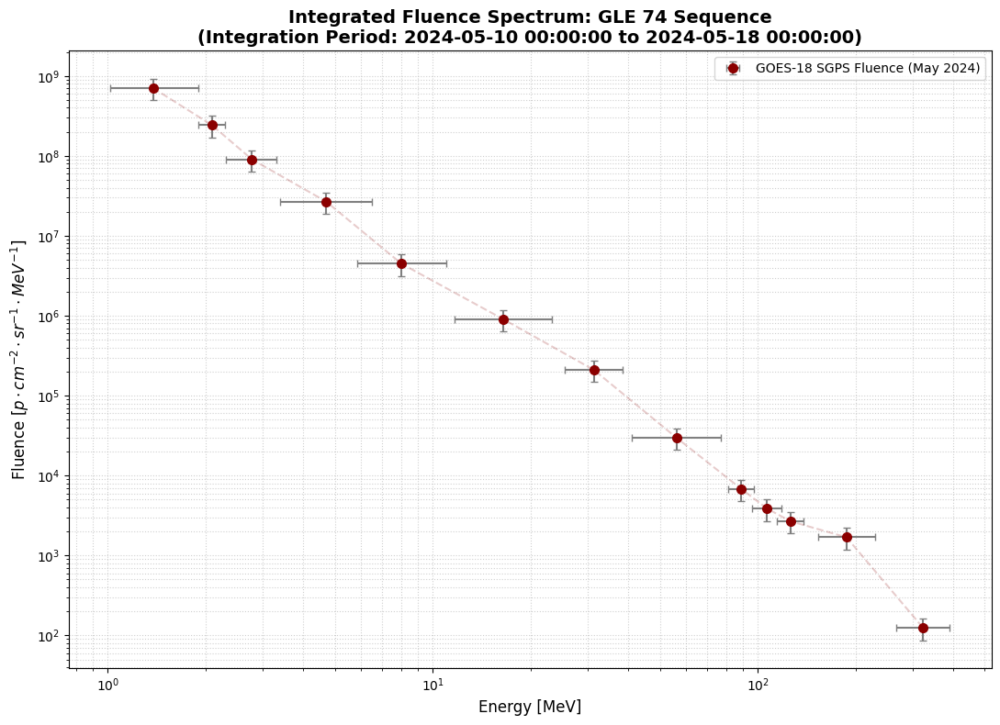

--- DATI FLUENZA INTEGRATA PER IL FIT (MAGGIO 2024) ---
Channel   E_eff      Fluence        y_err
     P1   1.377 7.089319e+08 2.126796e+08
     P2   2.090 2.433742e+08 7.301226e+07
     P3   2.778 9.035603e+07 2.710681e+07
     P4   4.694 2.692223e+07 8.076669e+06
     P5   8.015 4.471589e+06 1.341477e+06
     P6  16.458 9.080934e+05 2.724280e+05
     P7  31.292 2.103319e+05 6.309957e+04
     P8  56.187 2.984401e+04 8.953203e+03
     P9  88.859 6.843713e+03 2.053114e+03
    P10 106.780 3.866695e+03 1.160009e+03
    P11 126.093 2.681253e+03 8.043758e+02
    P12 187.488 1.690525e+03 5.071576e+02
    P13 322.692 1.245031e+02 3.735094e+01


In [7]:
from scipy.integrate import trapezoid
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# ============================================================
# 1. PARAMETRI DI INTEGRAZIONE (GLE 74 Sequence)
# ============================================================
t_start_ev, t_end_ev = "2024-05-10 00:00:00", "2024-05-18 00:00:00"

# Selezione dei dati netti nel periodo dell'evento
df_event = df_net.loc[t_start_ev:t_end_ev]

# Calcolo del delta tempo in secondi (rispetto all'inizio dell'integrazione)
# Nota: il dt tra i campioni è di circa 300s (5 min)
delta_t = (df_event.index - df_event.index[0]).total_seconds().values

# ============================================================
# 2. CALCOLO FLUENZA, X_ERR E Y_ERR
# ============================================================
fluence_list = []

# Energie effettive (MeV) per il fitting
sgps_eff_energies = {
    0: 1.377, 1: 2.090, 2: 2.778, 3: 4.694, 4: 8.015, 5: 16.458, 6: 31.292,
    7: 56.187, 8: 88.859, 9: 106.780, 10: 126.093, 11: 187.488, 12: 322.692
}
goes_bins = {
    0: (1.02, 1.9),   1: (1.90, 2.3),   2: (2.31, 3.3),   3: (3.40, 6.5),
    4: (5.84, 11.0),  5: (11.64, 23.3), 6: (25.50, 38.4), 7: (41.00, 77.0),
    8: (80.90, 97.6), 9: (96.30, 118.4), 10: (114.88, 138.4), 11: (153.30, 229.3),
    12: (267.00, 390.0)
}

for ch in range(13):
    # Recupero flussi per il canale specifico
    flux_vals = df_event[ch].values
    
    # Integrazione temporale (Area sotto la curva): [p / (cm2 sr MeV)]
    # Utilizziamo trapezoid per gestire correttamente i campionamenti discreti
    integrated_fluence = trapezoid(y=flux_vals, x=delta_t)
    
    # Energie dal dizionario fornito
    e_eff = sgps_eff_energies[ch]
    e_min, e_max = goes_bins[ch]
    
    # Calcolo x_err (distanza dai bordi del bin)
    x_err_low = e_eff - e_min
    x_err_high = e_max - e_eff
    
    # Calcolo y_err (30% sistematico - standard strumentale SGPS)
    y_err = integrated_fluence * 0.30
    
    fluence_list.append({
        'Channel': f'P{ch+1}',
        'E_eff': e_eff,
        'Fluence': integrated_fluence,
        'y_err': y_err,
        'x_err_low': x_err_low,
        'x_err_high': x_err_high
    })

# Creazione DataFrame finale per il Fit
df_fluence_may24 = pd.DataFrame(fluence_list)

# ============================================================
# 3. PLOT DI VERIFICA (SPETTRO DI FLUENZA)
# ============================================================
plt.figure(figsize=(11, 8))

# Plot con barre d'errore (x asimmetriche, y 15%)
plt.errorbar(df_fluence_may24['E_eff'], df_fluence_may24['Fluence'], 
             xerr=[df_fluence_may24['x_err_low'], df_fluence_may24['x_err_high']],
             yerr=df_fluence_may24['y_err'], 
             fmt='o', color='darkred', ecolor='gray', capsize=3, markersize=7, 
             label='GOES-18 SGPS Fluence (May 2024)')

# Estetica log-log (Fondamentale per spettri SEP)
plt.xscale('log')
plt.yscale('log')

plt.title(f'Integrated Fluence Spectrum: GLE 74 Sequence\n(Integration Period: {t_start_ev} to {t_end_ev})', 
          fontsize=14, fontweight='bold')
plt.xlabel('Energy [MeV]', fontsize=12)
plt.ylabel(r'Fluence [$p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}$]', fontsize=12)

plt.grid(True, which="both", ls=':', alpha=0.6)
plt.legend(fontsize=10)

# Aggiunta di una linea guida per l'occhio (opzionale)
plt.plot(df_fluence_may24['E_eff'], df_fluence_may24['Fluence'], color='darkred', alpha=0.2, ls='--')

plt.tight_layout()
plt.show()

# Display dei dati pronti per il Fit
print("--- DATI FLUENZA INTEGRATA PER IL FIT (MAGGIO 2024) ---")
print(df_fluence_may24[['Channel', 'E_eff', 'Fluence', 'y_err']].to_string(index=False))

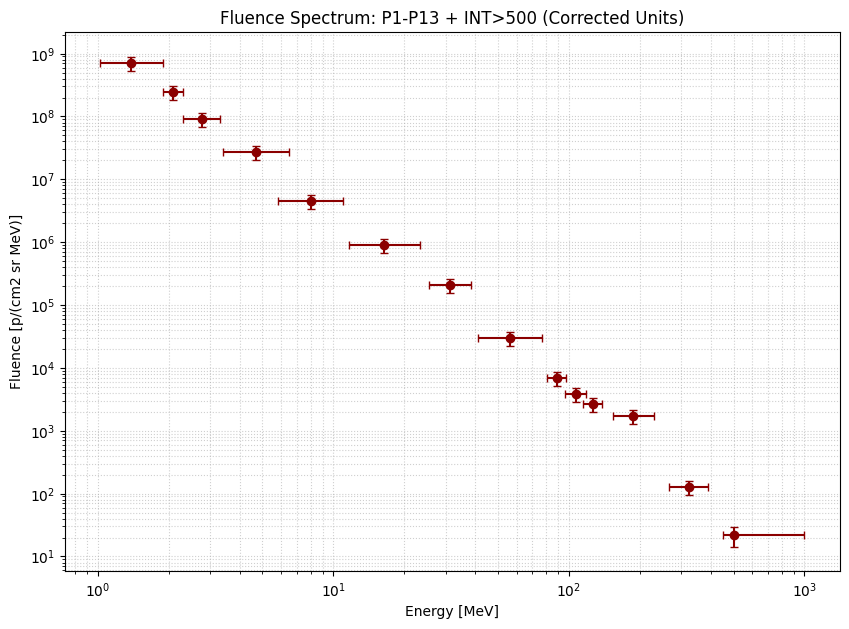

    Channel    E_eff       Fluence
0        P1    1.377  7.157458e+08
1        P2    2.090  2.455959e+08
2        P3    2.778  9.106790e+07
3        P4    4.694  2.713900e+07
4        P5    8.015  4.507443e+06
5        P6   16.458  9.090348e+05
6        P7   31.292  2.102977e+05
7        P8   56.187  2.988852e+04
8        P9   88.859  6.830171e+03
9       P10  106.780  3.840051e+03
10      P11  126.093  2.682969e+03
11      P12  187.488  1.688836e+03
12      P13  322.692  1.253349e+02
13  INT>500  500.000  2.206006e+01


In [10]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import trapezoid

# ============================================================
# 1. CARICAMENTO DATI (CORREZIONE UNITÀ)
# ============================================================
def load_goes18_combined(path_files):
    diff_list, int_list = [], []
    for f in path_files:
        with xr.open_dataset(f) as ds:
            # Differenziali: Conversione keV^-1 -> MeV^-1 (*1000)
            df_d = ds['AvgDiffProtonFlux'].sel(sensor_units=0).to_series().unstack()
            diff_list.append(df_d * 1000.0)
            
            # Integrali: Già in p/(cm2 sr s). NON moltiplicare per 1000!
            df_i = ds['AvgIntProtonFlux'].sel(sensor_units=0).to_series()
            int_list.append(df_i)
            
    df_diff = pd.concat(diff_list).sort_index().drop_duplicates()
    df_int = pd.concat(int_list).sort_index().drop_duplicates()
    df_int.name = 13 # Canale integrale etichettato come 13
    return pd.concat([df_diff, df_int], axis=1)

df_raw_combined = load_goes18_combined(files)

# Pulizia e Background (Usa le funzioni get_bg_stats e apply_correction già definite)
mu_all, thresh_all = get_bg_stats(df_raw_combined, bg_start, bg_end)
df_net_combined = apply_correction_v2_1(df_raw_combined, mu_all, thresh_all, t_start, t_end)

# ============================================================
# 2. INTEGRAZIONE TEMPORALE (FLUENZA)
# ============================================================
fluence_list = []
df_ev = df_net_combined.loc[t_start_ev:t_end_ev]

for col in df_ev.columns:
    data = df_ev[col].dropna()
    dt = (data.index - data.index[0]).total_seconds().values
    flu_total = trapezoid(y=data.values, x=dt)
    
    if col < 13:
        # CANALI DIFFERENZIALI (P1-P13)
        e_eff = sgps_eff_energies[col]
        e_min, e_max = goes_bins[col]
        fluence_list.append({
            'Channel': f'P{col+1}', 'E_eff': e_eff, 'Fluence': flu_total,
            'y_err': flu_total * 0.25, 'x_err_low': e_eff - e_min, 'x_err_high': e_max - e_eff
        })
    else:
        # CANALE INTEGRALE (>500 MeV)
        # Formula di conversione: dPhi/dE = (gamma - 1) / E * Phi(>E)
        # Assumendo gamma ~ 3 per un evento GLE (standard in letteratura)
        E_threshold = 500.0
        gamma_approx = 3.5 
        fluence_diff_equiv = ((gamma_approx - 1) / E_threshold) * flu_total
        
        fluence_list.append({
            'Channel': 'INT>500', 'E_eff': E_threshold, 'Fluence': fluence_diff_equiv,
            'y_err': fluence_diff_equiv * 0.35, 'x_err_low': 50.0, 'x_err_high': 500.0
        })

df_fluence_complete = pd.DataFrame(fluence_list)

# ============================================================
# 3. PLOT DI VERIFICA (CONTROLLO ALLINEAMENTO)
# ============================================================
plt.figure(figsize=(10, 7))
plt.errorbar(df_fluence_complete['E_eff'], df_fluence_complete['Fluence'], 
             xerr=[df_fluence_complete['x_err_low'], df_fluence_complete['x_err_high']],
             yerr=df_fluence_complete['y_err'], fmt='o', color='darkred', capsize=3)
plt.xscale('log'); plt.yscale('log')
plt.ylabel('Fluence [p/(cm2 sr MeV)]')
plt.xlabel('Energy [MeV]')
plt.title('Fluence Spectrum: P1-P13 + INT>500 (Corrected Units)')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.show()

print(df_fluence_complete[['Channel', 'E_eff', 'Fluence']])

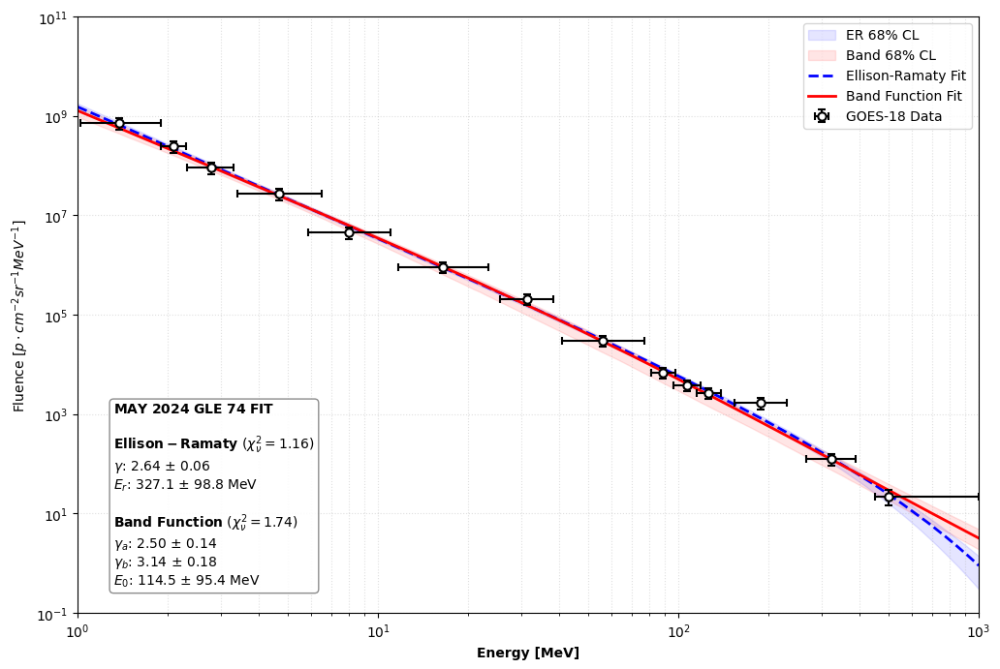

--- ANALISI COMPLETATA. Export in EXPORT_MAY2024_1_1000MeV (Range 1-1000 MeV) ---


In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from scipy.optimize import curve_fit
from scipy.linalg import eigh

# =========================================================
# 1. MODELLI FISICI (LOG-SPACE)
# =========================================================
def log_er(E, logA, gamma, Er):
    Er_s = np.clip(Er, 1.0, 1000.0)
    return logA - gamma * np.log10(E) - (E / Er_s) / np.log(10)

def log_band(E, logA, ga, gb, E0):
    E0_s = np.clip(E0, 1.0, 500.0)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E)
    mask = E <= ebreak
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

def er_linear(E, *p): return 10**log_er(E, *p)
def band_linear(E, *p): return 10**log_band(E, *p)

# =========================================================
# 2. ESECUZIONE FIT (MAY 2024)
# =========================================================
x_data = df_fluence_complete['E_eff'].values
y_data = df_fluence_complete['Fluence'].values
y_err = df_fluence_complete['y_err'].values
sigma_log = y_err / (y_data * np.log(10))

# Ellison-Ramaty Fit
popt_er, pcov_er = curve_fit(log_er, x_data, np.log10(y_data), p0=[9.0, 1.1, 150.0], 
                             sigma=sigma_log, absolute_sigma=True, bounds=([7, 0.1, 10], [13, 3.0, 800]))

# Band Function Fit
p0_band = [9.0, 1.1, 3.5, 30.0]
bounds_band = ([7, 0.1, 1.5, 5], [13, 2.5, 6.0, 200])
popt_band, pcov_band = curve_fit(log_band, x_data, np.log10(y_data), p0=p0_band, 
                                 sigma=sigma_log, absolute_sigma=True, bounds=bounds_band)

# Chi-Quadro Ridotto
chi2_er = np.sum(((np.log10(y_data) - log_er(x_data, *popt_er)) / sigma_log)**2) / (len(x_data) - 3)
chi2_band = np.sum(((np.log10(y_data) - log_band(x_data, *popt_band)) / sigma_log)**2) / (len(x_data) - 4)

# =========================================================
# 3. MONTE CARLO (RANGE 1 - 1000 MeV)
# =========================================================
E_grid = np.logspace(0, 3, 1000)

def get_mc_bands(popt, pcov, func_lin):
    clean_cov = (pcov + pcov.T) / 2
    vals, vecs = eigh(clean_cov)
    vals = np.maximum(vals, 1e-12 * np.max(vals))
    stable_cov = vecs @ np.diag(vals) @ vecs.T
    params = np.random.default_rng(42).multivariate_normal(popt, stable_cov, 1000)
    fits = np.array([func_lin(E_grid, *p) for p in params])
    return np.median(fits, axis=0), np.percentile(fits, [16, 84], axis=0)

med_er, cl_er = get_mc_bands(popt_er, pcov_er, er_linear)
med_band, cl_band = get_mc_bands(popt_band, pcov_band, band_linear)

# =========================================================
# 4. PLOT FINALE (FIX SYNTAX WARNINGS)
# =========================================================
plt.figure(figsize=(12, 8))
plt.fill_between(E_grid, cl_er[0], cl_er[1], color='blue', alpha=0.1, label='ER 68% CL')
plt.fill_between(E_grid, cl_band[0], cl_band[1], color='red', alpha=0.1, label='Band 68% CL')
plt.plot(E_grid, med_er, 'b--', lw=2, label='Ellison-Ramaty Fit')
plt.plot(E_grid, med_band, 'r-', lw=2, label='Band Function Fit')

plt.errorbar(x_data, y_data, xerr=[df_fluence_complete['x_err_low'], df_fluence_complete['x_err_high']],
             yerr=y_err, fmt='ko', capsize=3, label='GOES-18 Data', mfc='white', mew=1.5)

# Box Statistico con rf"" per evitare SyntaxWarning
perr_er = np.sqrt(np.diag(pcov_er))
perr_band = np.sqrt(np.diag(pcov_band))

stats = (
    rf"$\bf{{MAY\ 2024\ GLE\ 74\ FIT}}$" + "\n\n" +
    rf"$\bf{{Ellison-Ramaty}}$ ($\chi^2_\nu={chi2_er:.2f}$)" + "\n" +
    rf"$\gamma$: {popt_er[1]:.2f} $\pm$ {perr_er[1]:.2f}" + "\n" +
    rf"$E_r$: {popt_er[2]:.1f} $\pm$ {perr_er[2]:.1f} MeV" + "\n\n" +
    rf"$\bf{{Band\ Function}}$ ($\chi^2_\nu={chi2_band:.2f}$)" + "\n" +
    rf"$\gamma_a$: {popt_band[1]:.2f} $\pm$ {perr_band[1]:.2f}" + "\n" +
    rf"$\gamma_b$: {popt_band[2]:.2f} $\pm$ {perr_band[2]:.2f}" + "\n" +
    rf"$E_0$: {popt_band[3]:.1f} $\pm$ {perr_band[3]:.1f} MeV"
)
plt.gca().text(0.04, 0.04, stats, transform=plt.gca().transAxes, fontsize=10, 
                verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='white', alpha=0.9, edgecolor='gray'))

plt.xscale("log"); plt.yscale("log"); plt.xlim(1, 1000); plt.ylim(1e-1, 1e11)
plt.xlabel("Energy [MeV]", fontweight='bold'); plt.ylabel(r"Fluence $[p \cdot cm^{-2} sr^{-1} MeV^{-1}]$")
plt.grid(True, which="both", ls=':', alpha=0.4); plt.legend(loc="upper right"); plt.show()

# =========================================================
# 5. EXPORT SR-NIEL (1-1000 MeV)
# =========================================================
out_dir = "EXPORT_MAY2024_1_1000MeV"
if not os.path.exists(out_dir): os.makedirs(out_dir)

for geo, factor in {"Planar": np.pi, "Spherical": 4 * np.pi}.items():
    # Esportiamo ER (Modello più stabile per Maggio 2024)
    np.savetxt(f"{out_dir}/MAY24_ER_{geo}_Median.txt", np.column_stack([E_grid, factor * med_er]), fmt="%.6e")
    np.savetxt(f"{out_dir}/MAY24_ER_{geo}_CL68.txt", np.column_stack([E_grid, factor * cl_er[0], factor * cl_er[1]]), fmt="%.6e")

print(f"--- ANALISI COMPLETATA. Export in {out_dir} (Range 1-1000 MeV) ---")

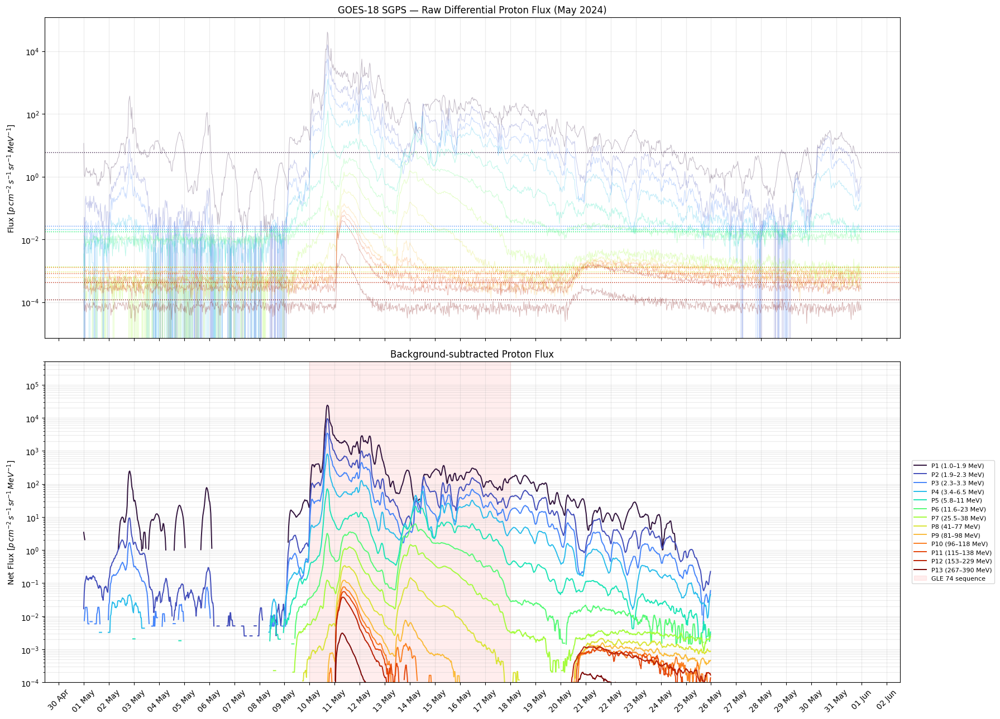

✔ GOES-18 May 2024 dataset cleaned and validated (robust background, no fluence bias).


In [2]:
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import glob, os

# ============================================================
# 1. LOAD GOES-18 SGPS (Differential Protons, Sunward)
# ============================================================
folder_path = os.path.join("File_scaricati_eventiSEP", "EVENTO MAY 2024")
files = sorted(glob.glob(os.path.join(folder_path, "*.nc")))
assert len(files) > 0, "❌ Nessun file GOES trovato"

def load_goes18_sgps(path_files):
    dfs = []
    for f in path_files:
        try:
            with xr.open_dataset(f) as ds:
                df = ds["AvgDiffProtonFlux"].sel(sensor_units=0).to_series().unstack()
                dfs.append(df * 1000.0)  # keV⁻¹ → MeV⁻¹
        except Exception as e:
            print(f"⚠️ Skip {os.path.basename(f)}: {e}")
    df_all = pd.concat(dfs).sort_index()
    df_all = df_all[~df_all.index.duplicated(keep="first")]
    return df_all

df_raw = load_goes18_sgps(files)

# ------------------------------------------------------------
# Time windows
# ------------------------------------------------------------
t_start, t_end = "2024-05-01", "2024-05-25"
bg_start, bg_end = "2024-05-04", "2024-05-08"

# ============================================================
# 2. SPIKE REMOVAL (NO SMOOTHING BIAS)
# ============================================================
df_raw = df_raw.rolling(window=3, center=True, min_periods=1).median()
df_raw = df_raw.resample('30min').mean()

# ============================================================
# 3. BACKGROUND ESTIMATION (ROBUST: MEDIAN + MAD)
# ============================================================
bg = df_raw.loc[bg_start:bg_end]
mu = bg.median()
mad = (bg - mu).abs().median()
sigma = 1.4826 * mad
thresholds = mu + 3 * sigma

# ============================================================
# 4. BACKGROUND SUBTRACTION (NET, UNSMOOTHED)
# ============================================================
df_evt = df_raw.loc[t_start:t_end]
df_net = (df_evt - mu).clip(lower=0)

for ch in df_net.columns:
    df_net.loc[df_evt[ch] < thresholds[ch], ch] = 0.0

# Versione smooth SOLO per plot
df_net_smooth = df_net.rolling(window=5, center=True, min_periods=1).mean()

# ============================================================
# 5. ENERGY LABELS
# ============================================================
energy_labels = {
    0:'1.0–1.9', 1:'1.9–2.3', 2:'2.3–3.3', 3:'3.4–6.5',
    4:'5.8–11', 5:'11.6–23', 6:'25.5–38', 7:'41–77',
    8:'81–98', 9:'96–118', 10:'115–138', 11:'153–229', 12:'267–390'
}

# ============================================================
# 6. CONTROL PLOTS
# ============================================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(18, 13), sharex=True)
colors = plt.cm.turbo(np.linspace(0, 1, 13))

# RAW
for ch in range(13):
    ax1.plot(df_raw.index, df_raw[ch], color=colors[ch], lw=0.7, alpha=0.3)
    ax1.axhline(thresholds[ch], color=colors[ch], ls=":", lw=1)

ax1.set_yscale("log")
ax1.set_ylabel(r"Flux [$p\,cm^{-2}\,s^{-1}\,sr^{-1}\,MeV^{-1}$]")
ax1.set_title("GOES-18 SGPS — Raw Differential Proton Flux (May 2024)")
ax1.grid(True, which="both", alpha=0.25)

# NET (smooth)
for ch in range(13):
    ax2.plot(
        df_net_smooth.index,
        df_net_smooth[ch].replace(0, np.nan),
        color=colors[ch],
        lw=1.4,
        label=f"P{ch+1} ({energy_labels[ch]} MeV)"
    )

ax2.axvspan(
    pd.to_datetime("2024-05-10"),
    pd.to_datetime("2024-05-18"),
    color="red",
    alpha=0.07,
    label="GLE 74 sequence"
)

ax2.set_yscale("log")
ax2.set_ylim(1e-4, 5e5)
ax2.set_ylabel(r"Net Flux [$p\,cm^{-2}\,s^{-1}\,sr^{-1}\,MeV^{-1}$]")
ax2.set_title("Background-subtracted Proton Flux")
ax2.grid(True, which="both", alpha=0.25)

ax2.xaxis.set_major_formatter(mdates.DateFormatter("%d %b"))
ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
plt.xticks(rotation=45)

ax2.legend(loc="center left", bbox_to_anchor=(1.01, 0.5), fontsize=8)
plt.tight_layout()
plt.show()

print("✔ GOES-18 May 2024 dataset cleaned and validated (robust background, no fluence bias).")


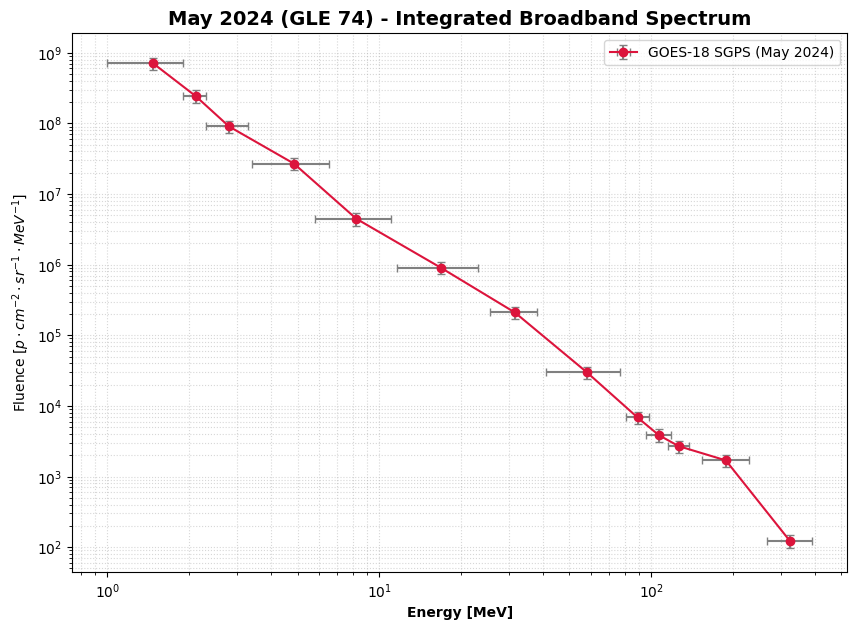

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.integrate import trapezoid # <--- Correzione Import

# ============================================================
# 1. MAPPATURA ENERGIE GOES-18 (SGPS/SEISS)
# ============================================================
sgps_eff_energies = {
    0: 1.47,  1: 2.11,  2: 2.80,  3: 4.85,  4: 8.22,  5: 16.8,
    6: 31.5,  7: 58.0,  8: 89.0,  9: 106.5, 10: 126.0, 11: 188.0, 12: 323.0
}

goes_bins = {
    0:(1.0, 1.9), 1:(1.9, 2.3), 2:(2.3, 3.3), 3:(3.4, 6.5), 4:(5.8, 11),
    5:(11.6, 23), 6:(25.5, 38), 7:(41, 77), 8:(81, 98), 9:(96, 118),
    10:(115, 138), 11:(153, 229), 12:(267, 390)
}

# ============================================================
# 2. CALCOLO FLUENZA (May 2024 - GLE 74)
# ============================================================
t_start_ev, t_end_ev = "2024-05-10 00:00", "2024-05-18 00:00"
df_ev = df_net.loc[t_start_ev:t_end_ev]

fluence_rows = []

for ch in range(13):
    if ch in df_ev.columns:
        s = df_ev[ch].fillna(0)
        
        # tsec basato su resampling 30min (1800s)
        tsec = (s.index - s.index[0]).total_seconds().values
        
        # Integrazione: trapezoid gestisce correttamente i delta temporali
        flu = trapezoid(s.values, tsec)

        if flu > 0:
            e_eff = sgps_eff_energies[ch]
            e_min, e_max = goes_bins[ch]

            fluence_rows.append({
                'Channel': f"P{ch+1}",
                'E_eff': e_eff,
                'Fluence': flu,
                'y_err': 0.20 * flu, # Errore SEISS 15%
                'x_err_low': e_eff - e_min,
                'x_err_high': e_max - e_eff,
                'Instrument': 'GOES-18 SGPS'
            })

df_fluence_may2024 = pd.DataFrame(fluence_rows)

# ============================================================
# 3. PLOT DI CONTROLLO
# ============================================================
plt.figure(figsize=(10, 7))
plt.errorbar(df_fluence_may2024.E_eff, df_fluence_may2024.Fluence,
             yerr=df_fluence_may2024.y_err, xerr=[df_fluence_may2024.x_err_low, df_fluence_may2024.x_err_high],
             fmt='o-', color='crimson', ecolor='gray', capsize=3, label='GOES-18 SGPS (May 2024)')

plt.xscale("log"); plt.yscale("log")
plt.xlabel("Energy [MeV]", fontweight='bold'); plt.ylabel(r"Fluence $[p \cdot cm^{-2} \cdot sr^{-1} \cdot MeV^{-1}]$")
plt.title("May 2024 (GLE 74) - Integrated Broadband Spectrum", fontsize=14, fontweight='bold')
plt.grid(True, which="both", ls=":", alpha=0.5); plt.legend(); plt.show()

# FIT 


--- INIZIO FIT BROAD BAND MAGGIO 2024 (GLE 74) ---


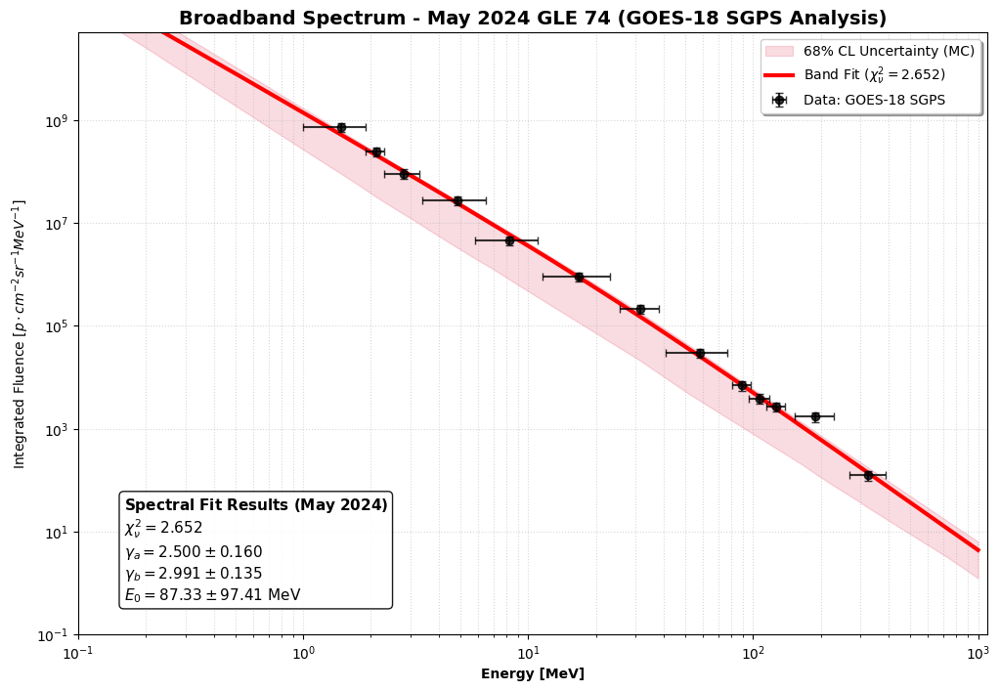

--- ANALISI COMPLETATA. Chi2red: 2.652 ---
File esportati in: EXPORT_MAY2024_FINAL_Phi_Bands (Range: 0.1 - 1000 MeV)


In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from scipy.optimize import curve_fit
from scipy.linalg import eigh

# =========================================================
# 1. MODELLO FISICO: BAND FUNCTION (LOG-SPACE)
# =========================================================
def log_band(E, logA, ga, gb, E0):
    """
    Modello Band: ga (bassa energia), gb (alta energia), E0 (roll-over)
    """
    E0_s = np.clip(E0, 0.1, 800)
    ebreak = np.maximum((gb - ga) * E0_s, 1e-6)
    res = np.zeros_like(E)
    mask = E <= ebreak
    # Parte power law + cutoff esponenziale
    res[mask] = logA - ga * np.log10(E[mask]) - (E[mask] / E0_s) / np.log(10)
    # Parte power law pura per alte energie
    norm = (gb - ga) * np.log10(ebreak) + (ga - gb) / np.log(10)
    res[~mask] = logA - gb * np.log10(E[~mask]) + norm
    return res

def band_linear(E, *p):
    return 10**np.clip(log_band(E, *p), -20, 20)

print("\n--- INIZIO FIT BROAD BAND MAGGIO 2024 (GLE 74) ---")

# =========================================================
# 2. PREPARAZIONE DATI (GOES-18 SGPS)
# =========================================================
# Assicurati che df_fluence_may2024 sia ordinato per energia
df_fit = df_fluence_may2024.sort_values('E_eff')
E_data = df_fit['E_eff'].values
F_data = df_fit['Fluence'].values
# Incertezza logaritmica per minimizzazione corretta
sigma_log = df_fit['y_err'].values / (F_data * np.log(10))

# Guess ottimizzati per evento GLE estremamente "hard"
# logA, ga, gb, E0
p0 = [9.5, 1.2, 2.8, 60.0] 
bounds = ([5, 0.5, 1.5, 5], [14, 2.5, 6.0, 500])

# =========================================================
# 3. ESECUZIONE FIT
# =========================================================
popt, pcov = curve_fit(log_band, E_data, np.log10(F_data), p0=p0, 
                        sigma=sigma_log, absolute_sigma=True, bounds=bounds)

perr = np.sqrt(np.diag(pcov))
chi2red = np.sum(((np.log10(F_data) - log_band(E_data, *popt)) / sigma_log)**2) / (len(E_data) - len(popt))

# =========================================================
# 4. MONTE CARLO (1000 ITERAZIONI)
# =========================================================
E_grid = np.logspace(np.log10(0.1), 3, 600) # Range 0.1 - 1000 MeV
clean_cov = (pcov + pcov.T) / 2
vals, vecs = eigh(clean_cov)
vals = np.maximum(vals, 1e-12 * np.max(vals))
stable_cov = vecs @ np.diag(vals) @ vecs.T

mc_params = np.random.default_rng(42).multivariate_normal(popt, stable_cov, 1000)
mc_fits = np.array([band_linear(E_grid, *p) for p in mc_params])

Phi_med = np.median(mc_fits, axis=0)
Phi_lo, Phi_hi = np.percentile(mc_fits, [16, 84], axis=0)

# =========================================================
# 5. PLOT PROFESSIONALE
# =========================================================
plt.figure(figsize=(12, 8))
plt.fill_between(E_grid, Phi_lo, Phi_hi, color='crimson', alpha=0.15, label='68% CL Uncertainty (MC)')
plt.plot(E_grid, Phi_med, color='red', lw=3, label=rf'Band Fit ($\chi^2_\nu = {chi2red:.3f}$)')

plt.errorbar(df_fit['E_eff'], df_fit['Fluence'], 
             xerr=[df_fit['x_err_low'], df_fit['x_err_high']], yerr=df_fit['y_err'],
             fmt='o', color='black', label='Data: GOES-18 SGPS', capsize=3, alpha=0.8)

# Box Statistiche
stats = (
    r"$\bf{Spectral\ Fit\ Results\ (May\ 2024)}$" + "\n" +
    rf"$\chi^2_\nu = {chi2red:.3f}$" + "\n" +
    rf"$\gamma_a = {popt[1]:.3f} \pm {perr[1]:.3f}$" + "\n" +
    rf"$\gamma_b = {popt[2]:.3f} \pm {perr[2]:.3f}$" + "\n" +
    rf"$E_0 = {popt[3]:.2f} \pm {perr[3]:.2f}$ MeV"
)
plt.gca().text(0.05, 0.05, stats, transform=plt.gca().transAxes, fontsize=11, 
                verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))

plt.xscale("log"); plt.yscale("log"); plt.xlim(0.1, 1100); plt.ylim(1e-1, 5e10)
plt.xlabel("Energy [MeV]", fontweight='bold'); plt.ylabel(r"Integrated Fluence $[p \cdot cm^{-2} sr^{-1} MeV^{-1}]$")
plt.title("Broadband Spectrum - May 2024 GLE 74 (GOES-18 SGPS Analysis)", fontsize=14, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.5); plt.legend(loc="upper right", shadow=True); plt.show()

# =========================================================
# 6. EXPORT PER SR-NIEL (RANGE 0.1 - 1000 MeV)
# =========================================================
out_dir = "EXPORT_MAY2024_FINAL_Phi_Bands"
if not os.path.exists(out_dir): os.makedirs(out_dir)

# Geometrie: Planare (pi sr) e Sferica (4*pi sr)
geometries = {"Planar": np.pi, "Spherical": 4 * np.pi}

for geo, factor in geometries.items():
    # 1. Export MEDIANA
    np.savetxt(f"{out_dir}/MAY24_Band_{geo}_Median.txt", 
                np.column_stack([E_grid, factor * Phi_med]), 
                fmt="%.6e", header=f"Energy(MeV) Fluence_{geo}_Median(cm^-2*MeV^-1)")
    
    # 2. Export CL68 (Phi16 e Phi84)
    np.savetxt(f"{out_dir}/MAY24_Band_{geo}_CL68.txt", 
                np.column_stack([E_grid, factor * Phi_lo, factor * Phi_hi]), 
                fmt="%.6e", header=f"Energy(MeV) Phi16_{geo} Phi84_{geo}")

print(f"--- ANALISI COMPLETATA. Chi2red: {chi2red:.3f} ---")
print(f"File esportati in: {out_dir} (Range: 0.1 - 1000 MeV)")

# FIT ER


--- INIZIO FIT ELLISON-RAMATY MAGGIO 2024 (GLE 74) ---


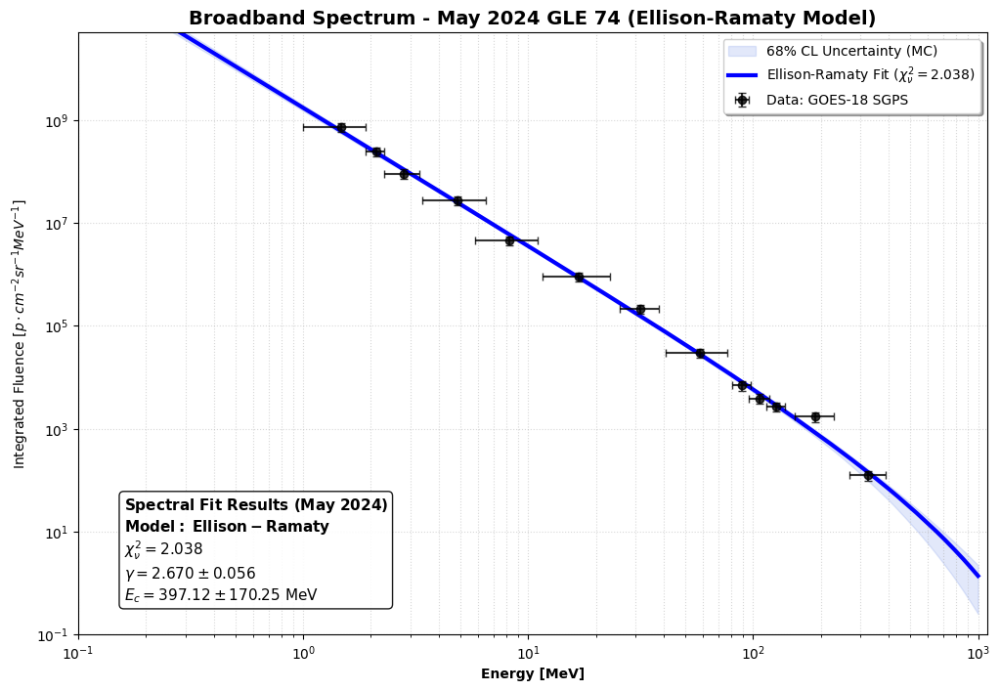

--- ANALISI COMPLETATA. Chi2red: 2.038 ---


In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from scipy.optimize import curve_fit
from scipy.linalg import eigh

# =========================================================
# 1. MODELLO FISICO: ELLISON-RAMATY (LOG-SPACE)
# =========================================================
def log_ellison_ramaty(E, logA, gamma, Ec):
    """
    Modello: J(E) = A * E^-gamma * exp(-E/Ec)
    log10(J) = log10(A) - gamma*log10(E) - (E/Ec)/ln(10)
    """
    # Clip per stabilità numerica
    Ec_s = np.clip(Ec, 1.0, 1000.0)
    res = logA - gamma * np.log10(E) - (E / Ec_s) / np.log(10)
    return res

def er_linear(E, *p):
    return 10**np.clip(log_ellison_ramaty(E, *p), -20, 20)

print("\n--- INIZIO FIT ELLISON-RAMATY MAGGIO 2024 (GLE 74) ---")

# =========================================================
# 2. PREPARAZIONE DATI (GOES-18 SGPS)
# =========================================================
df_fit = df_fluence_may2024.sort_values('E_eff')
E_data = df_fit['E_eff'].values
F_data = df_fit['Fluence'].values
# Incertezza logaritmica (SGPS 15%)
sigma_log = df_fit['y_err'].values / (F_data * np.log(10))

# Guess iniziali per Ellison-Ramaty
# logA, gamma, Ec (caratteristica)
p0 = [9.0, 2.2, 100.0] 
bounds = ([5, 0.5, 5.0], [14, 4.5, 800.0])

# =========================================================
# 3. ESECUZIONE FIT
# =========================================================
popt, pcov = curve_fit(log_ellison_ramaty, E_data, np.log10(F_data), p0=p0, 
                        sigma=sigma_log, absolute_sigma=True, bounds=bounds)

perr = np.sqrt(np.diag(pcov))
chi2red = np.sum(((np.log10(F_data) - log_ellison_ramaty(E_data, *popt)) / sigma_log)**2) / (len(E_data) - len(popt))

# =========================================================
# 4. MONTE CARLO (1000 ITERAZIONI) PER INCERTEZZA
# =========================================================
E_grid = np.logspace(np.log10(0.1), 3, 600) 
clean_cov = (pcov + pcov.T) / 2
vals, vecs = eigh(clean_cov)
vals = np.maximum(vals, 1e-12 * np.max(vals))
stable_cov = vecs @ np.diag(vals) @ vecs.T

mc_params = np.random.default_rng(42).multivariate_normal(popt, stable_cov, 1000)
mc_fits = np.array([er_linear(E_grid, *p) for p in mc_params])

Phi_med = np.median(mc_fits, axis=0)
Phi_lo, Phi_hi = np.percentile(mc_fits, [16, 84], axis=0)

# =========================================================
# 5. PLOT PROFESSIONALE
# =========================================================
plt.figure(figsize=(12, 8))
plt.fill_between(E_grid, Phi_lo, Phi_hi, color='royalblue', alpha=0.15, label='68% CL Uncertainty (MC)')
plt.plot(E_grid, Phi_med, color='blue', lw=3, label=rf'Ellison-Ramaty Fit ($\chi^2_\nu = {chi2red:.3f}$)')

plt.errorbar(df_fit['E_eff'], df_fit['Fluence'], 
             xerr=[df_fit['x_err_low'], df_fit['x_err_high']], yerr=df_fit['y_err'],
             fmt='o', color='black', label='Data: GOES-18 SGPS', capsize=3, alpha=0.8)

# Box Statistiche
stats = (
    r"$\bf{Spectral\ Fit\ Results\ (May\ 2024)}$" + "\n" +
    r"$\bf{Model:\ Ellison-Ramaty}$" + "\n" +
    rf"$\chi^2_\nu = {chi2red:.3f}$" + "\n" +
    rf"$\gamma = {popt[1]:.3f} \pm {perr[1]:.3f}$" + "\n" +
    rf"$E_c = {popt[2]:.2f} \pm {perr[2]:.2f}$ MeV"
)
plt.gca().text(0.05, 0.05, stats, transform=plt.gca().transAxes, fontsize=11, 
                verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))

plt.xscale("log"); plt.yscale("log"); plt.xlim(0.1, 1100); plt.ylim(1e-1, 5e10)
plt.xlabel("Energy [MeV]", fontweight='bold'); plt.ylabel(r"Integrated Fluence $[p \cdot cm^{-2} sr^{-1} MeV^{-1}]$")
plt.title("Broadband Spectrum - May 2024 GLE 74 (Ellison-Ramaty Model)", fontsize=14, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.5); plt.legend(loc="upper right", shadow=True); plt.show()

# =========================================================
# 6. EXPORT PER SR-NIEL (MAY 2024)
# =========================================================
out_dir = "EXPORT_MAY2024_ER_MODEL_FINAL_2026_usaquesto"
if not os.path.exists(out_dir): os.makedirs(out_dir)

geometries = {"Planar": np.pi, "Spherical": 4 * np.pi}

for geo, factor in geometries.items():
    # Export Mediana e CL68
    np.savetxt(f"{out_dir}/MAY24_ER_{geo}_Median.txt", np.column_stack([E_grid, factor * Phi_med]), fmt="%.6e")
    np.savetxt(f"{out_dir}/MAY24_ER_{geo}_CL68.txt", np.column_stack([E_grid, factor * Phi_lo, factor * Phi_hi]), fmt="%.6e")

print(f"--- ANALISI COMPLETATA. Chi2red: {chi2red:.3f} ---")

# J (E)

In [6]:
# ============================================================
# CALCOLO FLUENZE INTEGRALI — MAY 2024
# ============================================================

E_int = np.logspace(np.log10(0.5), 3, 5000)
phi_diff = er_linear(E_int, *popt)

print("\n--- FLUENZE INTEGRALI MAY 2024 (omnidirezionali, ×4π sr) ---")
for E_thresh in [10, 30, 60, 100, 500]:
    mask = E_int >= E_thresh
    J_omni = 4 * np.pi * np.trapezoid(phi_diff[mask], E_int[mask])
    print(f"  J(>{E_thresh} MeV) = {J_omni:.3e} cm⁻²")


--- FLUENZE INTEGRALI MAY 2024 (omnidirezionali, ×4π sr) ---
  J(>10 MeV) = 2.583e+08 cm⁻²
  J(>30 MeV) = 3.723e+07 cm⁻²
  J(>60 MeV) = 1.014e+07 cm⁻²
  J(>100 MeV) = 3.618e+06 cm⁻²
  J(>500 MeV) = 5.240e+04 cm⁻²


# DOSE


# PLANARE
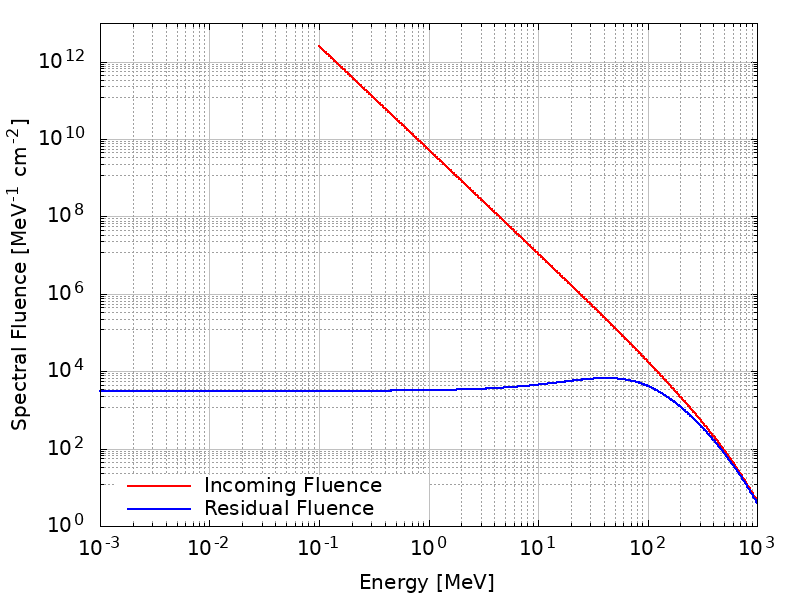

In [64]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "EXPORT_MAY2024_ER_MODEL_FINAL_2026_usaquesto/Planar/MAY24_ER_Planar_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
1.000000e-01 1.971179e+12
1.015495e-01 1.893290e+12
1.031230e-01 1.818478e+12
1.047209e-01 1.746623e+12
1.063436e-01 1.677606e+12
1.079914e-01 1.611317e+12
1.096647e-01 1.547753e+12
1.113639e-01 1.486697e+12
1.130895e-01 1.428049e+12
1.148418e-01 1.371911e+12
1.166213e-01 1.318419e+12
1.184284e-01 1.266507e+12
1.202634e-01 1.216772e+12
1.221269e-01 1.169062e+12
1.240193e-01 1.123243e+12
1.259409e-01 1.078706e+12
1.278924e-01 1.035932e+12
1.298741e-01 9.949001e+11
1.318865e-01 9.555521e+11
1.339301e-01 9.180399e+11
1.360053e-01 8.822966e+11
1.381127e-01 8.479653e+11
1.402528e-01 8.144956e+11
1.424260e-01 7.822264e+11
1.446329e-01 7.514402e+11
1.468740e-01 7.219571e+11
1.491498e-01 6.936307e+11
1.514609e-01 6.664156e+11
1.538078e-01 6.402682e+11
1.561910e-01 6.147584e+11
1.586112e-01 5.901747e+11
1.610689e-01 5.665741e+11
1.635647e-01 5.43917

# DOSE

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.1 - 1000 MeV original export) -  MAY 2024
Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)
Dose Mediana: 1.7096 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [1.423 - 1.974] mGy
Incertezza Totale: +0.265 / -0.286 mGy
-----------------------------------------------------------------


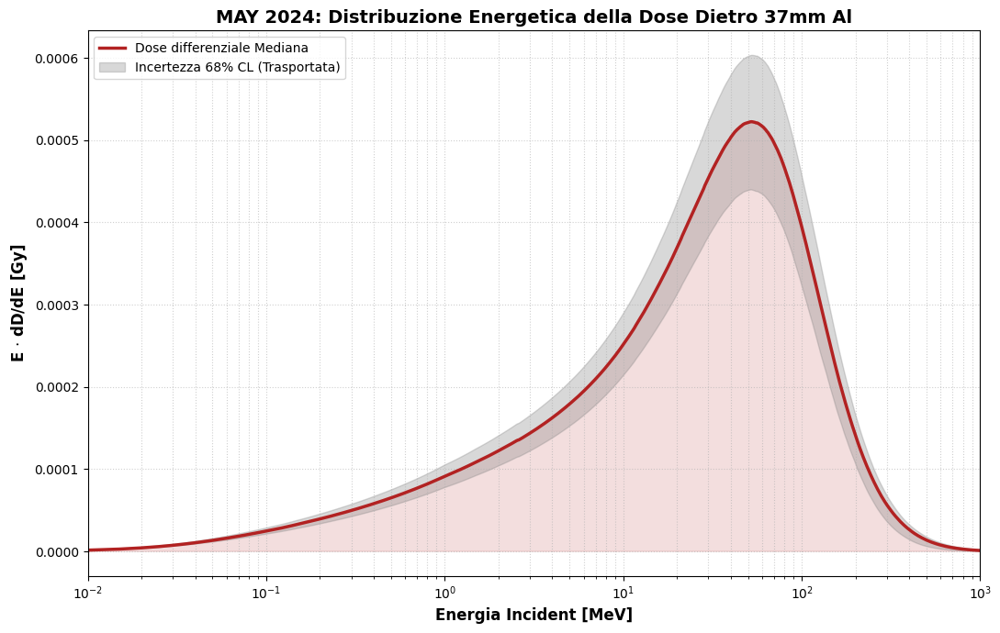

In [65]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "EXPORT_MAY2024_ER_MODEL_FINAL_2026_usaquesto/Planar/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "Median_residual_planar.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "Phi16_residual_planar.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "Phi84_residual_planar.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.1 - 1000 MeV original export) -  MAY 2024")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Planare (π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("MAY 2024: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.01, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# SPHERICAL
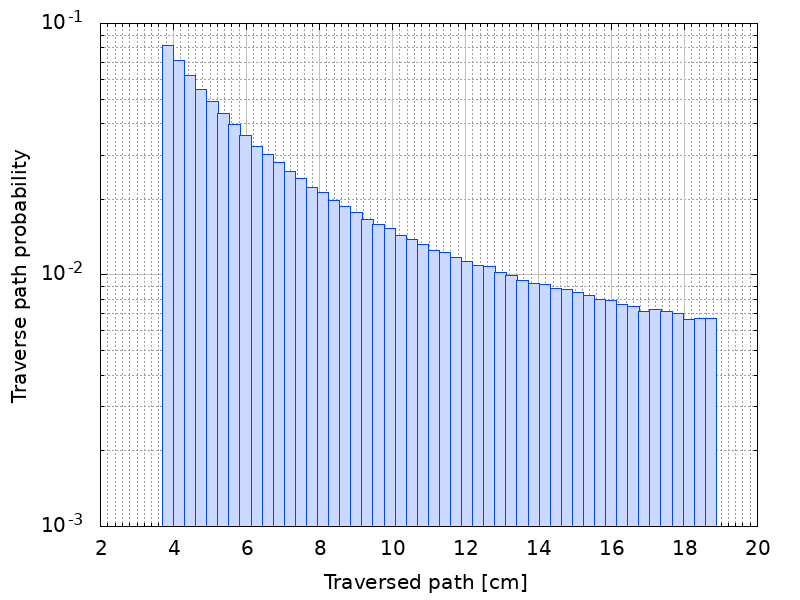
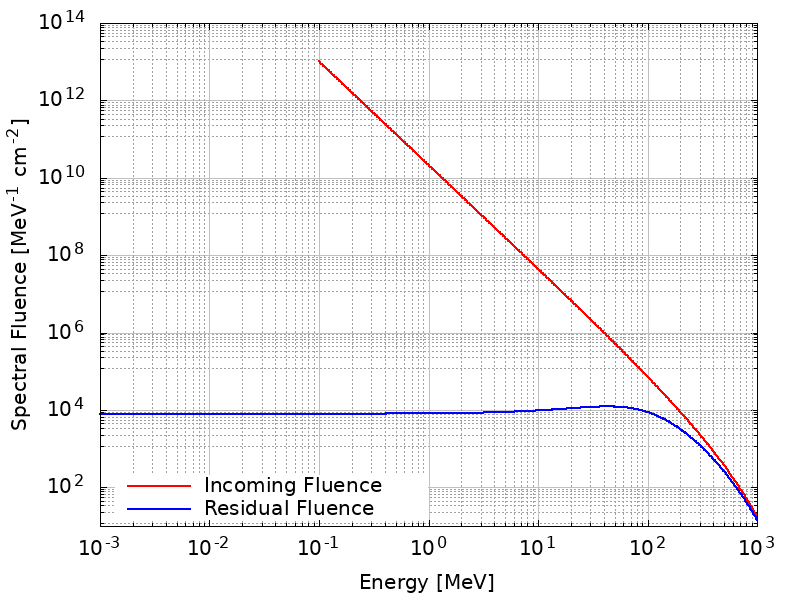

In [61]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "EXPORT_MAY2024_ER_MODEL_FINAL_2026_usaquesto/Spherical/MAY24_ER_Spherical_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
1.000000e-01 7.884717e+12
1.015495e-01 7.573160e+12
1.031230e-01 7.273914e+12
1.047209e-01 6.986491e+12
1.063436e-01 6.710424e+12
1.079914e-01 6.445270e+12
1.096647e-01 6.191014e+12
1.113639e-01 5.946788e+12
1.130895e-01 5.712195e+12
1.148418e-01 5.487644e+12
1.166213e-01 5.273677e+12
1.184284e-01 5.066027e+12
1.202634e-01 4.867087e+12
1.221269e-01 4.676248e+12
1.240193e-01 4.492974e+12
1.259409e-01 4.314822e+12
1.278924e-01 4.143729e+12
1.298741e-01 3.979600e+12
1.318865e-01 3.822208e+12
1.339301e-01 3.672159e+12
1.360053e-01 3.529186e+12
1.381127e-01 3.391861e+12
1.402528e-01 3.257982e+12
1.424260e-01 3.128906e+12
1.446329e-01 3.005761e+12
1.468740e-01 2.887828e+12
1.491498e-01 2.774523e+12
1.514609e-01 2.665663e+12
1.538078e-01 2.561073e+12
1.561910e-01 2.459034e+12
1.586112e-01 2.360699e+12
1.610689e-01 2.266296e+12
1.635647e-01 2.17566

# Dose

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.1 - 1000 MeV original export) -  MAY 2024
Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)
Dose Mediana: 3.6760 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [3.002 - 4.272] mGy
Incertezza Totale: +0.596 / -0.674 mGy
-----------------------------------------------------------------


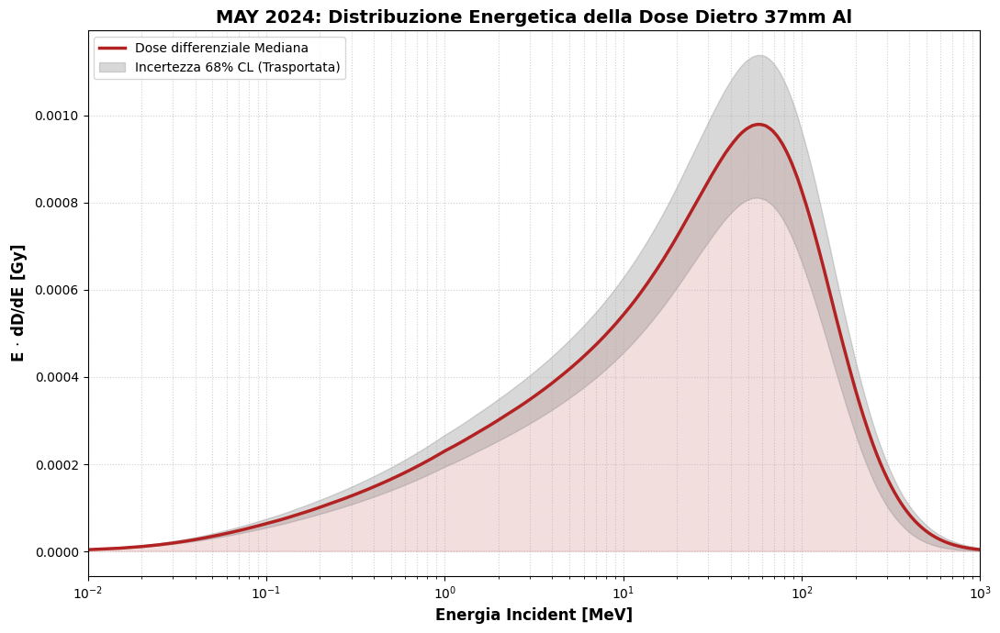

In [63]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "EXPORT_MAY2024_ER_MODEL_FINAL_2026_usaquesto/Spherical/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "Median_residual_spherical.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "Phi16_residual_spherical.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "Phi84_residual_spherical.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (0.1 - 1000 MeV original export) -  MAY 2024")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("MAY 2024: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.01, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

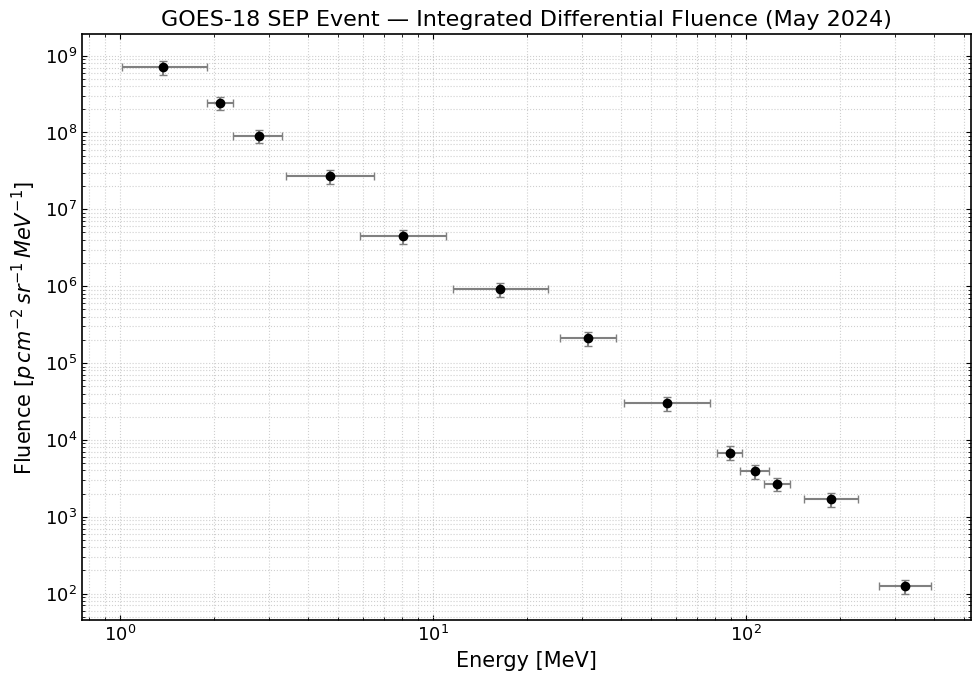

✔ Differential fluence ready for spectral fitting

Integral channel (>500 MeV):
Empty DataFrame
Columns: [Channel, E_eff, Fluence, y_err, x_err_low, x_err_high]
Index: []


In [9]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.integrate import trapezoid

# ============================================================
# 1. SELEZIONE EVENTO (NET, NON SMOOTHED!)
# ============================================================
df_ev = df_net.loc[t_start_ev:t_end_ev]

fluence_rows = []

for ch in df_ev.columns:
    s = df_ev[ch].dropna()
    if len(s) < 3:
        continue

    # Controllo temporale
    tsec = (s.index - s.index[0]).total_seconds().values
    if np.max(np.diff(tsec)) > 2 * np.median(np.diff(tsec)):
        print(f"⚠️ Gap temporale significativo in canale {ch}")

    flu = trapezoid(s.values, tsec)

    if ch < 13:
        e_eff = sgps_eff_energies[ch]
        e_min, e_max = goes_bins[ch]

        fluence_rows.append(dict(
            Channel=f"P{ch+1}",
            E_eff=e_eff,
            Fluence=flu,
            y_err=max(0.20 * flu, 1e-40),
            x_err_low=e_eff - e_min,
            x_err_high=e_max - e_eff
        ))
    else:
        # CANALE INTEGRALE: NON convertirlo in differenziale!
        fluence_rows.append(dict(
            Channel="INT>500",
            E_eff=500.0,
            Fluence=flu,              # p / (cm2 sr)
            y_err=max(0.35 * flu, 1e-40),
            x_err_low=np.nan,
            x_err_high=np.nan
        ))

df_fluence = pd.DataFrame(fluence_rows)

# ============================================================
# 2. PLOT SOLO CANALI DIFFERENZIALI
# ============================================================
df_diff = df_fluence[df_fluence.Channel != "INT>500"]

plt.figure(figsize=(10, 7))
plt.errorbar(
    df_diff.E_eff,
    df_diff.Fluence,
    yerr=df_diff.y_err,
    xerr=[df_diff.x_err_low, df_diff.x_err_high],
    fmt='o',
    color='black',
    ecolor='gray',
    capsize=3
)

plt.xscale("log")
plt.yscale("log")
plt.xlabel("Energy [MeV]")
plt.ylabel(r"Fluence [$p\,cm^{-2}\,sr^{-1}\,MeV^{-1}$]")
plt.title("GOES-18 SEP Event — Integrated Differential Fluence (May 2024)")
plt.grid(True, which="both", ls=":", alpha=0.6)
plt.tight_layout()
plt.show()

print("✔ Differential fluence ready for spectral fitting")
print("\nIntegral channel (>500 MeV):")
print(df_fluence[df_fluence.Channel == "INT>500"])


✔ Monte Carlo: 1000/1000 fit riusciti.

MODEL: Ellison-Ramaty
success=True | `ftol` termination condition is satisfied.
chi2=15.6 | dof=10 | chi2_red=1.56
AIC=21.62 | BIC=23.31
           A = 1.65239e+09 ± 2.69e+08
       gamma = 2.67048 ± 0.0692
    Er [MeV] = 376.852 ± 191

MODEL: Band
success=True | `ftol` termination condition is satisfied.
chi2=37.3 | dof=9 | chi2_red=4.14
AIC=45.29 | BIC=47.55
           A = 7.76888e+08 ± 2.87e+08
          ga = 2.14254 ± 0.37
          gb = 3.03592 ± 0.226
    E0 [MeV] = 36.9484 ± 47.7

MODEL: Combined
success=True | `ftol` termination condition is satisfied.
chi2=41 | dof=8 | chi2_red=5.13
AIC=51.05 | BIC=53.87
           A = 7.15153e+08 ± 3.05e+08
          ga = 2.11829 ± 0.496
          gb = 2.81851 ± 0.637
    E0 [MeV] = 37.1972 ± 79.8
    Er [MeV] = 574.777 ± 1.68e+03

------------------------------------------------------------------------
BEST (by BIC): Ellison-Ramaty
Monte Carlo (p16 / p50 / p84):
           A : 1.66641e+09  [1.44335e+09

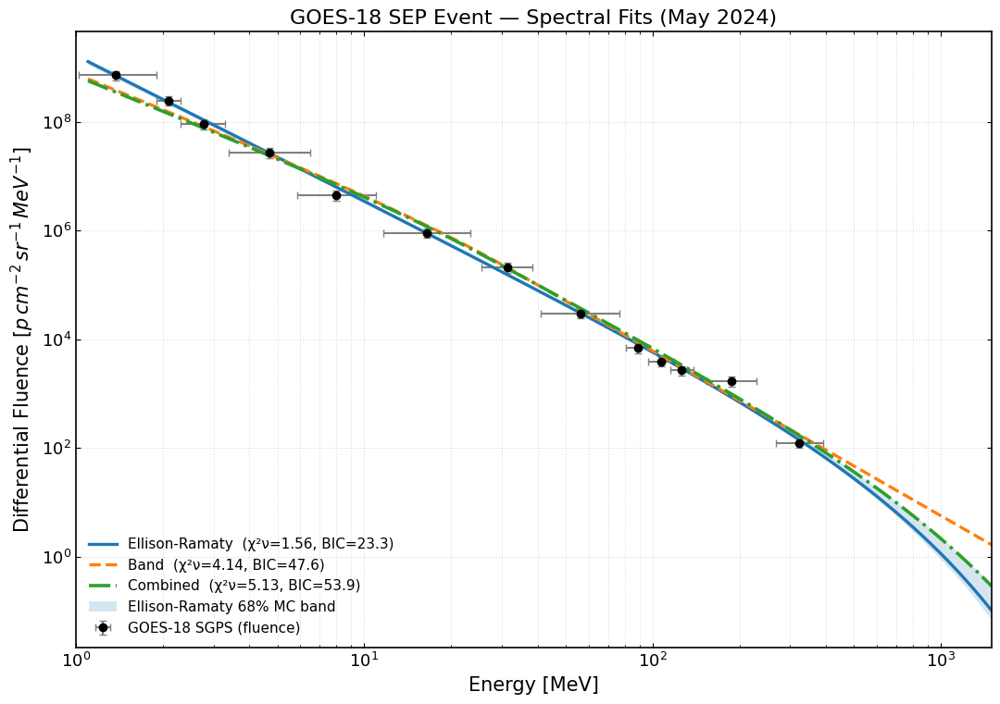


✔ Export SR-NIEL completato in 'EXPORT_MAY2024_1_1000MeV'
   Files: MAY24_Ellison-Ramaty_Planar/Spherical_(Median, CL68).txt


In [10]:
# =========================================================
# FINAL CELL — Spectral FIT (ER / Band / Combined)
# + Monte Carlo uncertainties (p16/p50/p84)
# + χ², dof, χ²_red, AIC/BIC
# + SR-NIEL export 1–1000 MeV (Planar π, Spherical 4π)
# =========================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import least_squares
import os

# ---------------------------
# 0) INPUT: usa il dataframe della figura appena fatta
# ---------------------------
# Mi aspetto che tu abbia df_diff con colonne:
# E_eff, Fluence, y_err, x_err_low, x_err_high
if "df_diff" not in globals():
    raise NameError("df_diff non trovato. Esegui prima la cella che costruisce e plottava lo spettro (df_diff).")

E = np.asarray(df_diff["E_eff"], dtype=float)
Y = np.asarray(df_diff["Fluence"], dtype=float)
Yerr = np.asarray(df_diff["y_err"], dtype=float)

xerr_low  = np.asarray(df_diff["x_err_low"], dtype=float) if "x_err_low" in df_diff.columns else np.zeros_like(E)
xerr_high = np.asarray(df_diff["x_err_high"], dtype=float) if "x_err_high" in df_diff.columns else np.zeros_like(E)

# pulizia minima
m = np.isfinite(E) & np.isfinite(Y) & np.isfinite(Yerr) & (E > 0) & (Y > 0)
E, Y, Yerr, xerr_low, xerr_high = E[m], Y[m], Yerr[m], xerr_low[m], xerr_high[m]
ordr = np.argsort(E)
E, Y, Yerr, xerr_low, xerr_high = E[ordr], Y[ordr], Yerr[ordr], xerr_low[ordr], xerr_high[ordr]

# floor error per stabilità
Yerr = np.maximum(Yerr, 1e-40*np.max(Y))

# log-uncertainty (propagazione)
sigma_ln = np.maximum(Yerr / Y, 1e-6)  # ≈ σ(lnY)

# ---------------------------
# 1) MODELLI (usa i tuoi se già definiti, altrimenti li definisco)
# ---------------------------
def ellison_ramaty(E, A, gamma, Er):
    return A * (E**(-gamma)) * np.exp(-E/Er)

def band_function(E, A, ga, gb, E0):
    E = np.asarray(E, dtype=float)
    if gb <= ga:
        return np.ones_like(E) * 1e-30
    E_break = (gb - ga) * E0
    if E_break <= 0:
        return np.ones_like(E) * 1e-30
    res = np.zeros_like(E)
    low = E < E_break
    res[low]  = A * (E[low] ** (-ga)) * np.exp(-E[low] / E0)
    norm_factor = (E_break ** (gb - ga)) * np.exp(ga - gb)
    res[~low] = A * (E[~low] ** (-gb)) * norm_factor
    return res

def combined_function(E, A, ga, gb, E0, Er):
    return band_function(E, A, ga, gb, E0) * np.exp(-E/Er)

# ---------------------------
# 2) FIT in log-space (least_squares), χ² in linear-space
# ---------------------------
def fit_log_model(model, p0, bounds):
    lo, hi = bounds

    def resid(p):
        pred = np.maximum(model(E, *p), 1e-30)
        # residui in log (ln) pesati
        r = (np.log(Y) - np.log(pred)) / sigma_ln
        return r

    out = least_squares(resid, x0=np.array(p0, float), bounds=(np.array(lo,float), np.array(hi,float)),
                        method="trf", max_nfev=30000)

    popt = out.x

    # χ² calcolato nello spazio lineare (come fai tu nei report)
    pred_lin = np.maximum(model(E, *popt), 1e-30)
    chi2 = np.sum(((Y - pred_lin)/Yerr)**2)
    dof = max(len(Y) - len(popt), 1)
    chi2_red = chi2 / dof

    # Covarianza locale (JTJ)^-1 * s^2
    J = out.jac
    try:
        cov = np.linalg.inv(J.T @ J) * chi2_red
        perr = np.sqrt(np.diag(cov))
    except np.linalg.LinAlgError:
        cov = np.full((len(popt), len(popt)), np.nan)
        perr = np.full(len(popt), np.nan)

    # AIC/BIC (approssimazione gaussiana)
    n = len(Y)
    k = len(popt)
    aic = 2*k + chi2
    bic = k*np.log(n) + chi2

    return dict(popt=popt, perr=perr, cov=cov, chi2=chi2, dof=dof, chi2_red=chi2_red,
                aic=aic, bic=bic, success=out.success, message=out.message)

# ---------------------------
# 3) Initial guesses sensati + bounds
# ---------------------------
# stima slope grezza per seed
logE = np.log(E)
logY = np.log(Y)
slope = np.polyfit(logE, logY, 1)[0]
gamma0 = np.clip(-slope, 0.8, 8.0)
A0 = np.exp(np.median(logY + gamma0*logE))

models = {
    "Ellison-Ramaty": dict(
        fun=ellison_ramaty,
        p0=[A0, gamma0, 300.0],
        bounds=([1e-40, 0.0, 30.0], [1e60, 15.0, 8000.0]),
        names=["A", "gamma", "Er [MeV]"]
    ),
    "Band": dict(
        fun=band_function,
        p0=[np.max(Y), 1.5, 4.5, 40.0],
        bounds=([1e-40, 0.0, 1.2, 1.0], [1e60, 6.0, 20.0, 3000.0]),
        names=["A", "ga", "gb", "E0 [MeV]"]
    ),
    "Combined": dict(
        fun=combined_function,
        p0=[np.max(Y), 1.5, 4.5, 40.0, 600.0],
        bounds=([1e-40, 0.0, 1.2, 1.0, 30.0], [1e60, 6.0, 20.0, 3000.0, 8000.0]),
        names=["A", "ga", "gb", "E0 [MeV]", "Er [MeV]"]
    )
}

fit_results = {}
for name, cfg in models.items():
    fit_results[name] = fit_log_model(cfg["fun"], cfg["p0"], cfg["bounds"])

# scegli best per BIC (più conservativo)
best_name = sorted(fit_results.keys(), key=lambda k: fit_results[k]["bic"])[0]
best_cfg = models[best_name]
best = fit_results[best_name]

# ---------------------------
# 4) MONTE CARLO (parametri p16/p50/p84) — refit su dataset perturbati in log
# ---------------------------
rng = np.random.default_rng(1234)
Nmc = 1000  # alza a 1000 se vuoi più stabile

def mc_refit(model_fun, p0, bounds):
    lo, hi = np.array(bounds[0], float), np.array(bounds[1], float)

    # dataset perturbato in lnY
    lnY_star = np.log(Y) + rng.normal(0.0, sigma_ln)
    Y_star = np.exp(lnY_star)

    def resid(p):
        pred = np.maximum(model_fun(E, *p), 1e-30)
        r = (np.log(Y_star) - np.log(pred)) / sigma_ln
        return r

    out = least_squares(resid, x0=np.array(p0,float), bounds=(lo,hi), method="trf", max_nfev=8000)
    return out.x if out.success else None

P = []
p_seed = best["popt"]
for _ in range(Nmc):
    p_i = mc_refit(best_cfg["fun"], p_seed, best_cfg["bounds"])
    if p_i is not None and np.all(np.isfinite(p_i)):
        P.append(p_i)
P = np.array(P)
if len(P) < 50:
    print(f"⚠️ Monte Carlo: solo {len(P)}/{Nmc} fit riusciti. Considera bounds più stretti o seed diversi.")
else:
    print(f"✔ Monte Carlo: {len(P)}/{Nmc} fit riusciti.")

p16 = np.percentile(P, 16, axis=0) if len(P) else np.full_like(best["popt"], np.nan)
p50 = np.percentile(P, 50, axis=0) if len(P) else best["popt"]
p84 = np.percentile(P, 84, axis=0) if len(P) else np.full_like(best["popt"], np.nan)

# ---------------------------
# 5) REPORT COMPLETO (tutti i modelli) + best model
# ---------------------------
def print_model_report(name, cfg, res):
    print("\n" + "="*72)
    print(f"MODEL: {name}")
    print(f"success={res['success']} | {res['message']}")
    print(f"chi2={res['chi2']:.3g} | dof={res['dof']} | chi2_red={res['chi2_red']:.3g}")
    print(f"AIC={res['aic']:.2f} | BIC={res['bic']:.2f}")
    for n, v, e in zip(cfg["names"], res["popt"], res["perr"]):
        print(f"  {n:>10s} = {v:.6g} ± {e:.3g}")

for name, cfg in models.items():
    print_model_report(name, cfg, fit_results[name])

print("\n" + "-"*72)
print(f"BEST (by BIC): {best_name}")
print("Monte Carlo (p16 / p50 / p84):")
for n, lo, md, hi in zip(best_cfg["names"], p16, p50, p84):
    print(f"  {n:>10s} : {md:.6g}  [{lo:.6g}, {hi:.6g}]")

# ---------------------------
# 6) PLOT PROFESSIONALE (dati + tutti i fit + banda MC del best)
# ---------------------------
E_plot = np.logspace(np.log10(E.min()*0.8), np.log10(1500), 700)

plt.rcParams.update({
    "font.size": 13,
    "axes.labelsize": 15,
    "axes.titlesize": 16,
    "xtick.direction": "in",
    "ytick.direction": "in",
    "xtick.top": True,
    "ytick.right": True,
    "axes.linewidth": 1.2
})

fig, ax = plt.subplots(figsize=(11, 7.8))

ax.errorbar(E, Y, yerr=Yerr, xerr=[xerr_low, xerr_high],
            fmt="o", color="black", ecolor="gray", capsize=3, markersize=6,
            label="GOES-18 SGPS (fluence)")

style = {
    "Ellison-Ramaty": dict(ls="-",  lw=2.4),
    "Band":           dict(ls="--", lw=2.4),
    "Combined":       dict(ls="-.", lw=2.6)
}

for name, cfg in models.items():
    res = fit_results[name]
    pred = cfg["fun"](E_plot, *res["popt"])
    ax.plot(E_plot, pred, **style[name],
            label=f"{name}  (χ²ν={res['chi2_red']:.2f}, BIC={res['bic']:.1f})")

# banda MC best model
if len(P) >= 50:
    ens = np.array([best_cfg["fun"](E_plot, *pi) for pi in P])
    lo, md, hi = np.percentile(ens, [16, 50, 84], axis=0)
    ax.fill_between(E_plot, lo, hi, alpha=0.18, label=f"{best_name} 68% MC band")

ax.set_xscale("log"); ax.set_yscale("log")
ax.set_xlim(1, 1500)
ax.set_xlabel("Energy [MeV]")
ax.set_ylabel(r"Differential Fluence [$p\,cm^{-2}\,sr^{-1}\,MeV^{-1}$]")
ax.set_title("GOES-18 SEP Event — Spectral Fits (May 2024)")
ax.grid(True, which="both", ls=":", alpha=0.45)
ax.legend(frameon=False, loc="lower left")
plt.tight_layout()
plt.show()

# ---------------------------
# 7) EXPORT SR-NIEL 1–1000 MeV (Planar π, Spherical 4π)
#     median + phi16/phi84 (MC)
# ---------------------------
E_grid = np.logspace(0, 3, 400)  # 1..1000 MeV

if len(P) >= 50:
    spec_ens = np.array([best_cfg["fun"](E_grid, *pi) for pi in P])
    phi16, phi50, phi84 = np.percentile(spec_ens, [16, 50, 84], axis=0)
else:
    # fallback: usa best-fit senza banda MC
    phi50 = best_cfg["fun"](E_grid, *best["popt"])
    phi16 = phi50.copy()
    phi84 = phi50.copy()

out_dir = "EXPORT_MAY2024_1_1000MeV"
os.makedirs(out_dir, exist_ok=True)

for geo, factor in {"Planar": np.pi, "Spherical": 4*np.pi}.items():
    np.savetxt(
        f"{out_dir}/MAY24_{best_name}_{geo}_Median.txt",
        np.column_stack([E_grid, factor*phi50]),
        fmt="%.6e"
    )
    np.savetxt(
        f"{out_dir}/MAY24_{best_name}_{geo}_CL68.txt",
        np.column_stack([E_grid, factor*phi16, factor*phi84]),
        fmt="%.6e"
    )

print(f"\n✔ Export SR-NIEL completato in '{out_dir}'")
print(f"   Files: MAY24_{best_name}_Planar/Spherical_(Median, CL68).txt")


# FIT finale e export SRNIEl


================ FINAL ER MODEL ================

A      = 1.666e+09  [1.443e+09, 1.788e+09]
gamma  = 2.6705  [2.6343, 2.7034]
Er     = 377.6 MeV  [337.9, 562.5]

chi2   = 16.08
dof    = 10
chi2_r = 1.61




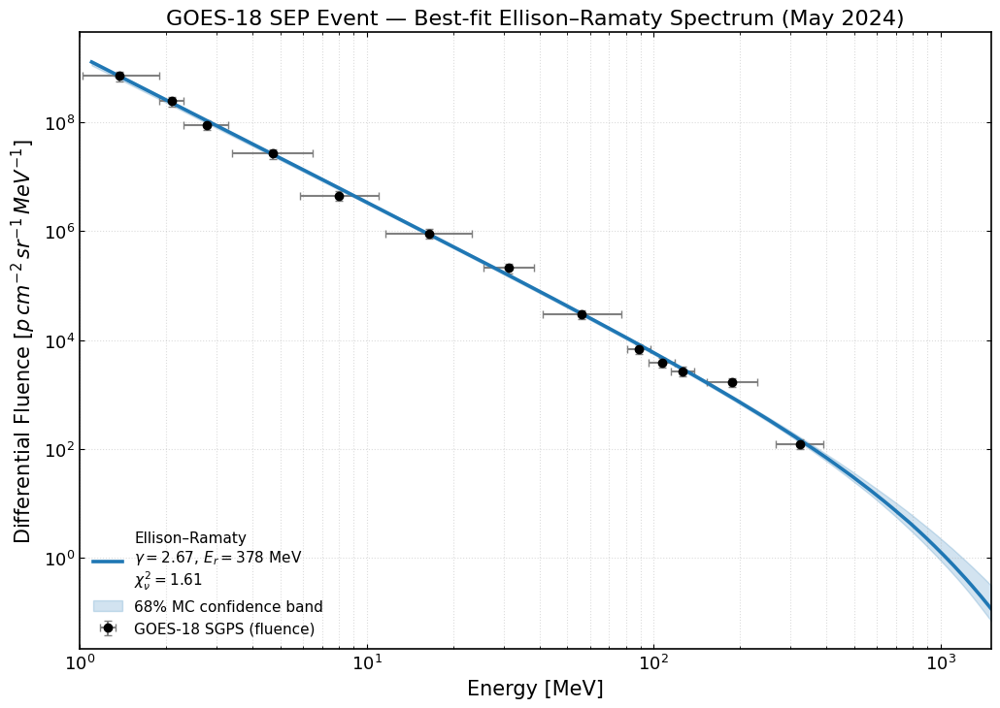

✔ SR-NIEL export completato in 'EXPORT_MAY2024_1_1000MeV_ER_usaquesto'
  → Planar (π) e Spherical (4π), Median + CL68


In [14]:
# =========================================================
# FINAL ER CELL — Best model only (Ellison–Ramaty)
# Plot + MC confidence band + χ² + SR-NIEL export
# =========================================================

import numpy as np
import matplotlib.pyplot as plt
import os

# ---------------------------
# ASSUNZIONI:
# - df_diff esiste (E_eff, Fluence, y_err, x_err_low, x_err_high)
# - best_name == "Ellison-Ramaty"
# - best, best_cfg, P (MC samples) esistono dalla cella precedente
# ---------------------------

assert best_name == "Ellison-Ramaty", "❌ Questa cella è pensata solo per ER (best model)"

E = df_diff["E_eff"].values
Y = df_diff["Fluence"].values
Yerr = df_diff["y_err"].values
xerr_low  = df_diff["x_err_low"].values
xerr_high = df_diff["x_err_high"].values

# Parametri MC
p16, p50, p84 = (
    np.percentile(P, 16, axis=0),
    np.percentile(P, 50, axis=0),
    np.percentile(P, 84, axis=0)
)

A_med, g_med, Er_med = p50

# ---------------------------
# χ² calcolato correttamente (linear space)
# ---------------------------
def ellison_ramaty(E, A, gamma, Er):
    return A * (E**(-gamma)) * np.exp(-E/Er)

Y_model = ellison_ramaty(E, *p50)
chi2 = np.sum(((Y - Y_model) / Yerr)**2)
dof = len(Y) - len(p50)
chi2_red = chi2 / dof

# ---------------------------
# STAMPA PARAMETRI FINALI
# ---------------------------
print("\n================ FINAL ER MODEL ================\n")
print(f"A      = {A_med:.3e}  [{p16[0]:.3e}, {p84[0]:.3e}]")
print(f"gamma  = {g_med:.4f}  [{p16[1]:.4f}, {p84[1]:.4f}]")
print(f"Er     = {Er_med:.1f} MeV  [{p16[2]:.1f}, {p84[2]:.1f}]")
print(f"\nchi2   = {chi2:.2f}")
print(f"dof    = {dof}")
print(f"chi2_r = {chi2_red:.2f}")
print("\n===============================================\n")

# ---------------------------
# PLOT PROFESSIONALE (ER + banda MC)
# ---------------------------
E_plot = np.logspace(np.log10(E.min()*0.8), np.log10(1500), 700)

spec_ens = np.array([ellison_ramaty(E_plot, *p) for p in P])
phi16, phi50, phi84 = np.percentile(spec_ens, [16, 50, 84], axis=0)

plt.rcParams.update({
    "font.size": 13,
    "axes.labelsize": 15,
    "axes.titlesize": 16,
    "xtick.direction": "in",
    "ytick.direction": "in",
    "xtick.top": True,
    "ytick.right": True,
    "axes.linewidth": 1.2
})

fig, ax = plt.subplots(figsize=(10.5, 7.5))

ax.errorbar(
    E, Y,
    yerr=Yerr,
    xerr=[xerr_low, xerr_high],
    fmt="o",
    color="black",
    ecolor="gray",
    capsize=3,
    markersize=6,
    label="GOES-18 SGPS (fluence)"
)

ax.plot(
    E_plot, phi50,
    color="tab:blue",
    lw=2.6,
    label=(
        r"Ellison–Ramaty" "\n"
        rf"$\gamma={g_med:.2f}$, $E_r={Er_med:.0f}$ MeV" "\n"
        rf"$\chi^2_\nu={chi2_red:.2f}$"
    )
)

ax.fill_between(
    E_plot, phi16, phi84,
    color="tab:blue",
    alpha=0.20,
    label="68% MC confidence band"
)

ax.set_xscale("log")
ax.set_yscale("log")
ax.set_xlim(1, 1500)

ax.set_xlabel("Energy [MeV]")
ax.set_ylabel(r"Differential Fluence [$p\,cm^{-2}\,sr^{-1}\,MeV^{-1}$]")
ax.set_title("GOES-18 SEP Event — Best-fit Ellison–Ramaty Spectrum (May 2024)")

ax.grid(True, which="both", ls=":", alpha=0.45)
ax.legend(frameon=False, loc="lower left")

plt.tight_layout()
plt.show()

# ---------------------------
# EXPORT SR-NIEL (1–1000 MeV)
# ---------------------------
E_grid = np.logspace(0, 3, 400)  # 1–1000 MeV
spec_grid_ens = np.array([ellison_ramaty(E_grid, *p) for p in P])
phi16_g, phi50_g, phi84_g = np.percentile(spec_grid_ens, [16, 50, 84], axis=0)

out_dir = "EXPORT_MAY2024_1_1000MeV_ER_usaquesto"
os.makedirs(out_dir, exist_ok=True)

for geo, factor in {"Planar": np.pi, "Spherical": 4*np.pi}.items():
    np.savetxt(
        f"{out_dir}/MAY24_ER_{geo}_Median.txt",
        np.column_stack([E_grid, factor*phi50_g]),
        fmt="%.6e"
    )
    np.savetxt(
        f"{out_dir}/MAY24_ER_{geo}_CL68.txt",
        np.column_stack([E_grid, factor*phi16_g, factor*phi84_g]),
        fmt="%.6e"
    )

print(f"✔ SR-NIEL export completato in '{out_dir}'")
print("  → Planar (π) e Spherical (4π), Median + CL68")


In [12]:
# =========================================================
# PARAMETRI FINALI — formato valore ± incertezza (MC 68%)
# =========================================================

# p16, p50, p84 sono già definiti dalla cella precedente
# Ordine parametri ER: [A, gamma, Er]

param_names = ["A", "gamma", "Er"]
param_units = ["p cm$^{-2}$ sr$^{-1}$ MeV$^{-1}$", "", "MeV"]

print("\n========= FINAL ER PARAMETERS (68% MC) =========\n")

for name, unit, v16, v50, v84 in zip(param_names, param_units, p16, p50, p84):
    # incertezza simmetrica (media delle due semi-ampiezze)
    sigma = 0.5 * ((v84 - v50) + (v50 - v16))
    
    if name == "A":
        print(f"{name:>6s} = ({v50:.3e} ± {sigma:.3e}) {unit}")
    elif name == "Er":
        print(f"{name:>6s} = ({v50:.1f} ± {sigma:.1f}) {unit}")
    else:
        print(f"{name:>6s} = ({v50:.3f} ± {sigma:.3f}) {unit}")

print("\nIncertezze: intervallo Monte Carlo 68% (p16–p84)")
print("===============================================\n")



========= FINAL ER PARAMETERS (68% MC) =========

     A = (1.666e+09 ± 1.724e+08) p cm$^{-2}$ sr$^{-1}$ MeV$^{-1}$
 gamma = (2.670 ± 0.035) 
    Er = (377.6 ± 112.3) MeV

Incertezze: intervallo Monte Carlo 68% (p16–p84)



# CALCOLO DOSE SRNIEL

# Spherical
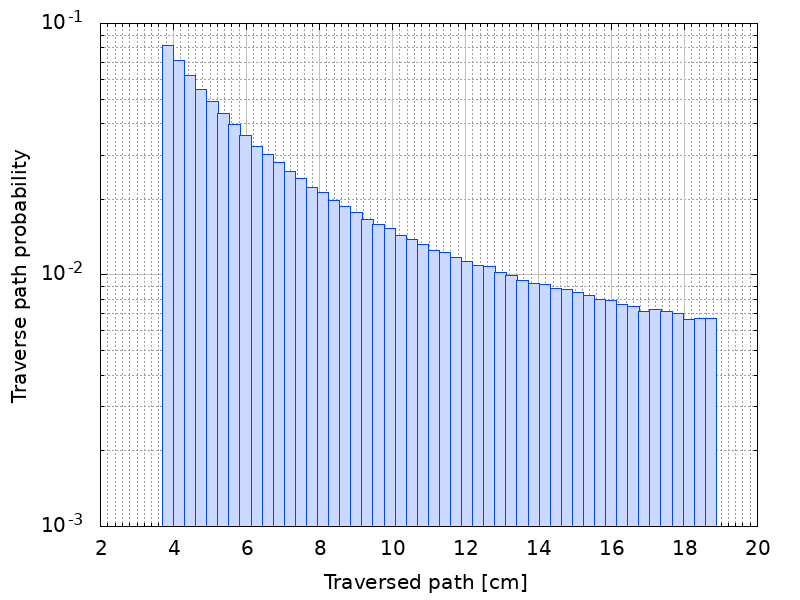
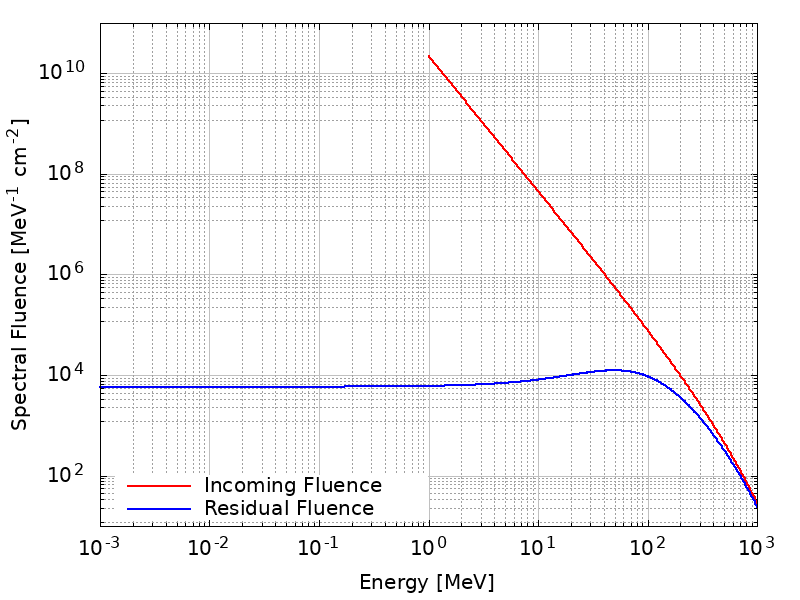

In [16]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "EXPORT_MAY2024_1_1000MeV_ER_usaquesto/Spherical/MAY24_ER_Spherical_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
1.000000e+00 1.808065e+10
1.017463e+00 1.727212e+10
1.035232e+00 1.650370e+10
1.053310e+00 1.577018e+10
1.071705e+00 1.506925e+10
1.090420e+00 1.439723e+10
1.109463e+00 1.374937e+10
1.128838e+00 1.313198e+10
1.148551e+00 1.254478e+10
1.168609e+00 1.198384e+10
1.189017e+00 1.144987e+10
1.209781e+00 1.093840e+10
1.230908e+00 1.044898e+10
1.252404e+00 9.981445e+09
1.274275e+00 9.534448e+09
1.296528e+00 9.104414e+09
1.319170e+00 8.693769e+09
1.342207e+00 8.305010e+09
1.365647e+00 7.935141e+09
1.389495e+00 7.581736e+09
1.413761e+00 7.244062e+09
1.438450e+00 6.919576e+09
1.463570e+00 6.606696e+09
1.489129e+00 6.307917e+09
1.515134e+00 6.023823e+09
1.541594e+00 5.754605e+09
1.568515e+00 5.496147e+09
1.595907e+00 5.251092e+09
1.623777e+00 5.017436e+09
1.652133e+00 4.794168e+09
1.680985e+00 4.581140e+09
1.710341e+00 4.376775e+09
1.740209e+00 4.18006

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  MAY 2024
Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)
Dose Mediana: 3.2010 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [2.806 - 3.591] mGy
Incertezza Totale: +0.390 / -0.395 mGy
-----------------------------------------------------------------


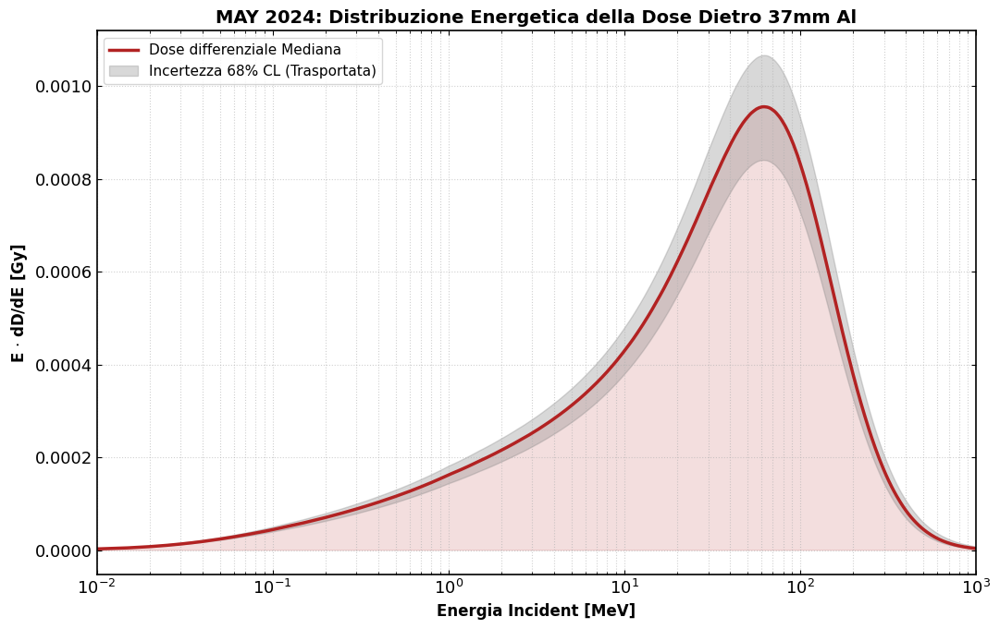

In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "EXPORT_MAY2024_1_1000MeV_ER_usaquesto/Spherical/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "37mmAl_spherical_residual_median.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "37mmAl_spherical_residual_Phi16.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "37mmAl_spherical_residual_Phi84.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (1 - 1000 MeV original export) -  MAY 2024")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("MAY 2024: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.01, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# Planar shielding

# V2 FIT con bande incertezza energy dependent montecarlo simulation

✔ Energy-dependent MC: 1000/1000 fit riusciti

================ FINAL ER MODEL (energy-dependent σ) ================

A      = 1.635e+09  [1.455e+09, 1.805e+09]   =>  (1.635e+09 ± 1.750e+08)
gamma  = 2.6789  [2.6486, 2.7374]   =>  (2.6789 ± 0.0444)
Er     = 464.7 MeV  [331.8, 1044.0] =>  (464.7 ± 356.1) MeV

chi2   = 6.70
dof    = 10
chi2_r = 0.67




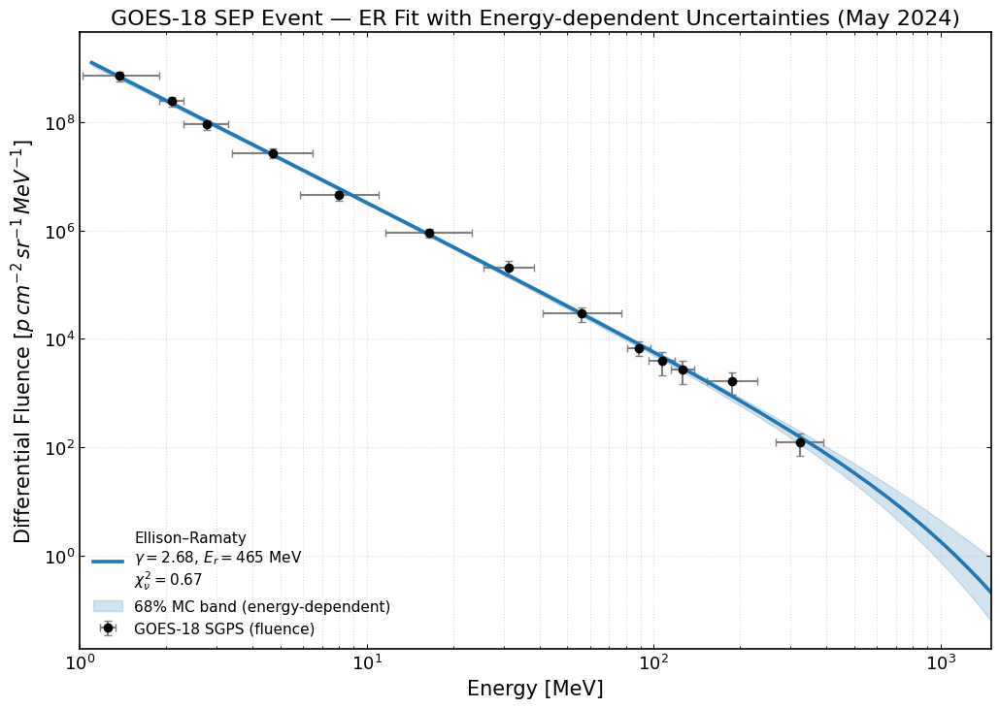

✔ SR-NIEL export completato in 'EXPORT_MAY2024_1_1000MeV_ER_energyDependent'
  → Planar (π) e Spherical (4π), Median + CL68 (energy-dependent)


In [20]:
# =========================================================
# FINAL ER CELL (ENERGY-DEPENDENT UNCERTAINTIES)
# Best-fit ER + MC band + χ² (correct) + SR-NIEL export
# =========================================================

import numpy as np
import matplotlib.pyplot as plt
import os
from scipy.optimize import least_squares

# ---------------------------
# ASSUNZIONI:
# - df_diff esiste con colonne: E_eff, Fluence, x_err_low, x_err_high
# - best_name può anche non esistere: qui rifacciamo ER fit + MC in modo autonomo
# ---------------------------

E = np.asarray(df_diff["E_eff"].values, dtype=float)
Y = np.asarray(df_diff["Fluence"].values, dtype=float)
xerr_low  = np.asarray(df_diff["x_err_low"].values, dtype=float)
xerr_high = np.asarray(df_diff["x_err_high"].values, dtype=float)

# pulizia minima
m = np.isfinite(E) & np.isfinite(Y) & (E > 0) & (Y > 0)
E, Y, xerr_low, xerr_high = E[m], Y[m], xerr_low[m], xerr_high[m]
ordr = np.argsort(E)
E, Y, xerr_low, xerr_high = E[ordr], Y[ordr], xerr_low[ordr], xerr_high[ordr]

# ---------------------------
# MODELLO ER
# ---------------------------
def ellison_ramaty(E, A, gamma, Er):
    return A * (E**(-gamma)) * np.exp(-E/Er)

# ---------------------------
# ENERGY-DEPENDENT RELATIVE ERRORS (modificabili)
# ---------------------------
def rel_err_of_E(e):
    # proposta "tesi-grade": aumenta alle alte energie
    if e < 30.0:
        return 0.20
    elif e < 100.0:
        return 0.30
    else:
        return 0.45

rel_err = np.array([rel_err_of_E(e) for e in E], dtype=float)
Yerr = np.maximum(Y * rel_err, 1e-40*np.max(Y))
sigma_ln = np.maximum(Yerr / Y, 1e-6)   # σ(lnY) ≈ σY/Y

# ---------------------------
# FIT in log-space (least_squares), seed robusto
# ---------------------------
logE = np.log(E)
logY = np.log(Y)
slope = np.polyfit(logE, logY, 1)[0]
gamma0 = np.clip(-slope, 0.8, 8.0)
A0 = np.exp(np.median(logY + gamma0*logE))
Er0 = 400.0

p0 = np.array([A0, gamma0, Er0], dtype=float)
bounds = (np.array([1e-40, 0.0, 30.0]), np.array([1e60, 15.0, 8000.0]))

def resid_log(p, Y_target):
    pred = np.maximum(ellison_ramaty(E, *p), 1e-40)
    return (np.log(Y_target) - np.log(pred)) / sigma_ln

out = least_squares(lambda p: resid_log(p, Y), x0=p0, bounds=bounds, method="trf", max_nfev=30000)
popt = out.x

# ---------------------------
# χ² calcolato correttamente in linear-space con Yerr energy-dependent
# ---------------------------
Y_model = np.maximum(ellison_ramaty(E, *popt), 1e-40)
chi2 = np.sum(((Y - Y_model) / Yerr)**2)
dof = max(len(Y) - len(popt), 1)
chi2_red = chi2 / dof

# ---------------------------
# MONTE CARLO con errori energy-dependent (perturbazione in ln)
# ---------------------------
N_MC = 1000
rng = np.random.default_rng(12345)
P = []

for _ in range(N_MC):
    # perturbazione lognormale coerente con σ_ln
    Y_mc = Y * np.exp(rng.normal(0.0, sigma_ln))
    out_i = least_squares(lambda p: resid_log(p, Y_mc), x0=popt, bounds=bounds,
                          method="trf", max_nfev=12000)
    if out_i.success and np.all(np.isfinite(out_i.x)):
        P.append(out_i.x)

P = np.array(P)
print(f"✔ Energy-dependent MC: {len(P)}/{N_MC} fit riusciti")

# percentili parametri
p16, p50, p84 = np.percentile(P, [16, 50, 84], axis=0)
A_med, g_med, Er_med = p50

# ---------------------------
# STAMPA PARAMETRI: intervallo + formato ± (MC 68%)
# ---------------------------
def sym_sigma(v16, v50, v84):
    return 0.5 * ((v84 - v50) + (v50 - v16))

sigA  = sym_sigma(p16[0], p50[0], p84[0])
sigG  = sym_sigma(p16[1], p50[1], p84[1])
sigEr = sym_sigma(p16[2], p50[2], p84[2])

print("\n================ FINAL ER MODEL (energy-dependent σ) ================\n")
print(f"A      = {A_med:.3e}  [{p16[0]:.3e}, {p84[0]:.3e}]   =>  ({A_med:.3e} ± {sigA:.3e})")
print(f"gamma  = {g_med:.4f}  [{p16[1]:.4f}, {p84[1]:.4f}]   =>  ({g_med:.4f} ± {sigG:.4f})")
print(f"Er     = {Er_med:.1f} MeV  [{p16[2]:.1f}, {p84[2]:.1f}] =>  ({Er_med:.1f} ± {sigEr:.1f}) MeV")
print(f"\nchi2   = {chi2:.2f}")
print(f"dof    = {dof}")
print(f"chi2_r = {chi2_red:.2f}")
print("\n=====================================================================\n")

# ---------------------------
# PLOT PROFESSIONALE: ER + banda MC (energy-dependent)
# ---------------------------
E_plot = np.logspace(np.log10(E.min()*0.8), np.log10(1500), 700)

spec_ens = np.array([ellison_ramaty(E_plot, *p) for p in P])
phi16, phi50, phi84 = np.percentile(spec_ens, [16, 50, 84], axis=0)

plt.rcParams.update({
    "font.size": 13,
    "axes.labelsize": 15,
    "axes.titlesize": 16,
    "xtick.direction": "in",
    "ytick.direction": "in",
    "xtick.top": True,
    "ytick.right": True,
    "axes.linewidth": 1.2
})

fig, ax = plt.subplots(figsize=(10.5, 7.5))

# NB: qui mostro barre Y con Yerr energy-dependent (più coerente col fit)
ax.errorbar(
    E, Y,
    yerr=Yerr,
    xerr=[xerr_low, xerr_high],
    fmt="o",
    color="black",
    ecolor="gray",
    capsize=3,
    markersize=6,
    label="GOES-18 SGPS (fluence)"
)

ax.plot(
    E_plot, phi50,
    color="tab:blue",
    lw=2.6,
    label=(
        r"Ellison–Ramaty" "\n"
        rf"$\gamma={g_med:.2f}$, $E_r={Er_med:.0f}$ MeV" "\n"
        rf"$\chi^2_\nu={chi2_red:.2f}$"
    )
)

ax.fill_between(
    E_plot, phi16, phi84,
    color="tab:blue",
    alpha=0.20,
    label="68% MC band (energy-dependent)"
)

ax.set_xscale("log")
ax.set_yscale("log")
ax.set_xlim(1, 1500)
ax.set_xlabel("Energy [MeV]")
ax.set_ylabel(r"Differential Fluence [$p\,cm^{-2}\,sr^{-1}\,MeV^{-1}$]")
ax.set_title("GOES-18 SEP Event — ER Fit with Energy-dependent Uncertainties (May 2024)")
ax.grid(True, which="both", ls=":", alpha=0.45)
ax.legend(frameon=False, loc="lower left")

plt.tight_layout()
plt.show()

# ---------------------------
# EXPORT SR-NIEL (1–1000 MeV) con banda MC (energy-dependent)
# ---------------------------
E_grid = np.logspace(0, 3, 400)  # 1–1000 MeV
spec_grid_ens = np.array([ellison_ramaty(E_grid, *p) for p in P])
phi16_g, phi50_g, phi84_g = np.percentile(spec_grid_ens, [16, 50, 84], axis=0)

out_dir = "EXPORT_MAY2024_1_1000MeV_ER_energyDependent"
os.makedirs(out_dir, exist_ok=True)

for geo, factor in {"Planar": np.pi, "Spherical": 4*np.pi}.items():
    np.savetxt(
        f"{out_dir}/MAY24_ER_{geo}_Median.txt",
        np.column_stack([E_grid, factor * phi50_g]),
        fmt="%.6e"
    )
    np.savetxt(
        f"{out_dir}/MAY24_ER_{geo}_CL68.txt",
        np.column_stack([E_grid, factor * phi16_g, factor * phi84_g]),
        fmt="%.6e"
    )

print(f"✔ SR-NIEL export completato in '{out_dir}'")
print("  → Planar (π) e Spherical (4π), Median + CL68 (energy-dependent)")


# V2 per JUL 2012 

# CARICAMENTO DATI HET 

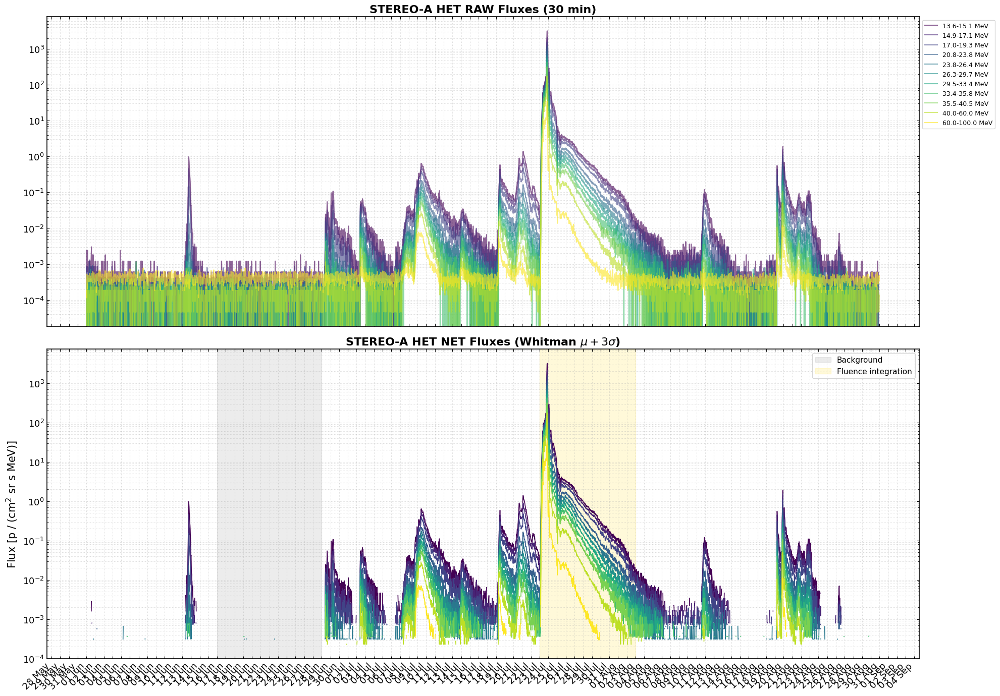

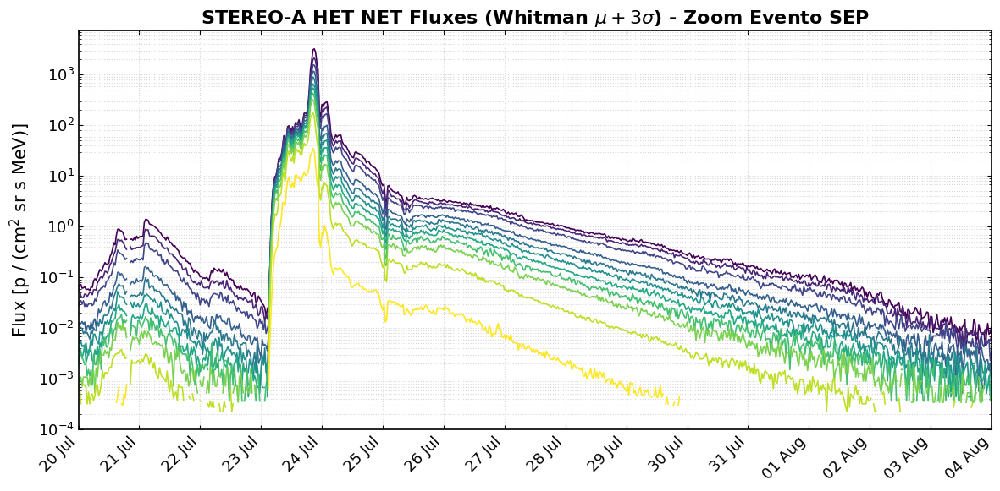

------------------------------------------------------------
CHANNEL (MeV)   | MU           | MU+3SIGMA   
------------------------------------------------------------
13.6-15.1       | 1.955e-04 | 1.214e-03
14.9-17.1       | 6.442e-05 | 5.572e-04
17.0-19.3       | 4.377e-05 | 4.350e-04
20.8-23.8       | 3.291e-05 | 3.392e-04
23.8-26.4       | 2.842e-05 | 3.181e-04
26.3-29.7       | 2.740e-05 | 2.961e-04
29.5-33.4       | 2.906e-05 | 2.765e-04
33.4-35.8       | 2.017e-05 | 2.788e-04
35.5-40.5       | 2.679e-05 | 2.390e-04
40.0-60.0       | 1.351e-04 | 3.615e-04
60.0-100.0      | 4.138e-04 | 7.116e-04


In [59]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# ============================================================
# 1. CARICAMENTO DATI STEREO-A HET (RAW 1-min)
# ============================================================
def load_stereo_het_raw(file_path):
    skip = 0
    with open(file_path, 'r') as f:
        for i, line in enumerate(f):
            if "#End" in line:
                skip = i + 1
                break

    df = pd.read_csv(file_path, sep=r'\s+', skiprows=skip, header=None, dtype=str)

    time_str = df[1] + " " + df[2] + " " + df[3] + " " + df[4]
    df['epoch'] = pd.to_datetime(time_str, format='%Y %b %d %H%M', errors='coerce')
    df = df.dropna(subset=['epoch']).set_index('epoch')

    col_mapping = {
        11: '13.6-15.1', 13: '14.9-17.1', 15: '17.0-19.3',
        17: '20.8-23.8', 19: '23.8-26.4', 21: '26.3-29.7',
        23: '29.5-33.4', 25: '33.4-35.8', 27: '35.5-40.5',
        29: '40.0-60.0', 31: '60.0-100.0'
    }

    df_flux = pd.DataFrame(index=df.index)
    for idx, name in col_mapping.items():
        df_flux[name] = pd.to_numeric(df[idx], errors='coerce').clip(lower=0)

    return df_flux


# ============================================================
# 2. CARICAMENTO + RESAMPLING
# ============================================================
path_jun = "File_scaricati_eventiSEP/Evento JUL 2012/AeH12Jun.1m"
path_jul = "File_scaricati_eventiSEP/Evento JUL 2012/AeH12Jul.1m"
path_aug = "File_scaricati_eventiSEP/Evento JUL 2012/AeH12Aug.1m"

df_jun = load_stereo_het_raw(path_jun)
df_jul = load_stereo_het_raw(path_jul)
df_aug = load_stereo_het_raw(path_aug)

df_full = pd.concat([df_jun, df_jul, df_aug]).sort_index()

# Finestra globale di lavoro
t_start, t_end = '2012-06-01', '2012-08-30'

# Resampling a 30 minuti (riduce jitter ma preserva coda SEP)
df_res = df_full.loc[t_start:t_end].resample('30min').mean()


# ============================================================
# 3. DEFINIZIONE BACKGROUND (SCELTA FISICA)
# ============================================================
# Background "quiet", lontano da coda SEP e da evento di Agosto
bg_start, bg_end = '2012-06-16 00:00', '2012-06-28 00:00'

bg = df_res.loc[bg_start:bg_end]

mu = bg.mean()
sigma = bg.std()
threshold = mu + 3 * sigma


# ============================================================
# 4. SERIE NET PER FLUENCE (NO NaN, CODA PRESERVATA)
# ============================================================
# Questa è quella da integrare per fluence e dose
df_net_fluence = (df_res - mu).clip(lower=0)


# ============================================================
# 5. SERIE "WHITMAN CLEANED" (SOLO PER PLOT / TRIGGER)
# ============================================================
df_net_clean = df_res - mu
for col in df_res.columns:
    df_net_clean.loc[df_res[col] < threshold[col], col] = np.nan


# ============================================================
# 6. FINESTRA EVENTO (PER INTEGRAZIONE)
# ============================================================
event_start = '2012-07-23 00:00'
event_end   = '2012-08-03 00:00'   # puoi estendere se includi più coda

df_event_fluence = df_net_fluence.loc[event_start:event_end]


# ============================================================
# 7. PLOT RAW vs NET
# ============================================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 14), sharex=True)
colors = plt.cm.viridis(np.linspace(0, 1, len(df_res.columns)))

# --- RAW ---
for i, col in enumerate(df_res.columns):
    ax1.plot(df_res.index, df_res[col], color=colors[i], alpha=0.6, label=f"{col} MeV")

ax1.set_yscale('log')
ax1.set_title('STEREO-A HET RAW Fluxes (30 min)', fontsize=16, fontweight='bold')
ax1.grid(True, which='both', ls=':', alpha=0.5)
ax1.legend(loc='upper left', bbox_to_anchor=(1,1), fontsize=9)

# --- NET (Whitman cleaned) ---
for i, col in enumerate(df_net_clean.columns):
    ax2.plot(df_net_clean.index, df_net_clean[col], color=colors[i], lw=1.2)

ax2.axvspan(pd.to_datetime(bg_start), pd.to_datetime(bg_end),
            color='gray', alpha=0.15, label='Background')

ax2.axvspan(pd.to_datetime(event_start), pd.to_datetime(event_end),
            color='gold', alpha=0.15, label='Fluence integration')

ax2.set_yscale('log')
ax2.set_ylim(bottom=1e-4)
ax2.set_ylabel(r'Flux [p / (cm$^2$ sr s MeV)]')
ax2.set_title(r'STEREO-A HET NET Fluxes (Whitman $\mu + 3\sigma$)', fontsize=16, fontweight='bold')
ax2.grid(True, which='both', ls=':', alpha=0.5)
ax2.legend()

ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45, ha='right')

plt.tight_layout()
plt.show()


# plot ristretto attorno evento SEP 
fig, ax = plt.subplots(figsize=(12, 6))
for i, col in enumerate(df_net_clean.columns):
    ax.plot(df_net_clean.index, df_net_clean[col], color=colors[i], lw=1.2)
ax.set_xlim(pd.to_datetime('2012-07-20'), pd.to_datetime('2012-08-04'))
ax.set_yscale('log')
ax.set_ylim(bottom=1e-4)
ax.set_ylabel(r'Flux [p / (cm$^2$ sr s MeV)]')
ax.set_title(r'STEREO-A HET NET Fluxes (Whitman $\mu + 3\sigma$) - Zoom Evento SEP', fontsize=16, fontweight='bold')
ax.grid(True, which='both', ls=':', alpha=0.5)
ax.xaxis.set_major_locator(mdates.DayLocator(interval=1))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
plt.setp(ax.xaxis.get_majorticklabels(), rotation=45, ha='right')
plt.tight_layout()
plt.show()


# ============================================================
# 8. STAMPA PARAMETRI BACKGROUND
# ============================================================
print("-" * 60)
print(f"{'CHANNEL (MeV)':<15} | {'MU':<12} | {'MU+3SIGMA':<12}")
print("-" * 60)
for col in df_res.columns:
    print(f"{col:<15} | {mu[col]:.3e} | {threshold[col]:.3e}")


# CALCOLO FLUENZA HET

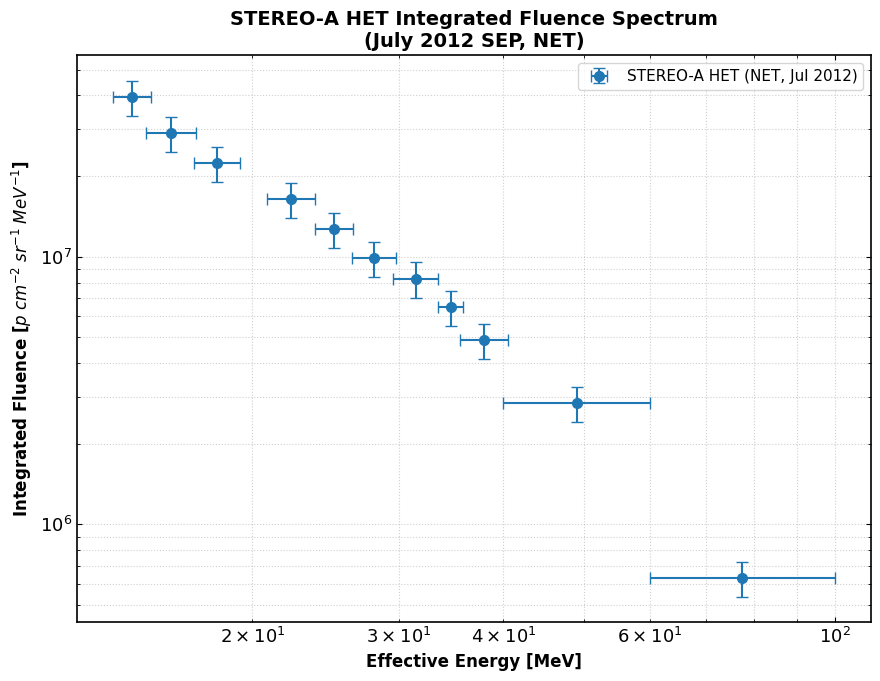


--- Riepilogo fluenze integrate HET (NET) ---
   Channel     E_eff      Fluence        y_err
 13.6-15.1 14.330387 3.934753e+07 5.902130e+06
 14.9-17.1 15.962143 2.900849e+07 4.351274e+06
 17.0-19.3 18.113531 2.241672e+07 3.362508e+06
 20.8-23.8 22.249494 1.642094e+07 2.463141e+06
 23.8-26.4 25.066312 1.267609e+07 1.901413e+06
 26.3-29.7 27.948345 9.902981e+06 1.485447e+06
 29.5-33.4 31.389489 8.280206e+06 1.242031e+06
 33.4-35.8 34.579184 6.462715e+06 9.694072e+05
 35.5-40.5 37.917674 4.883139e+06 7.324709e+05
 40.0-60.0 48.989795 2.830383e+06 4.245574e+05
60.0-100.0 77.459667 6.318490e+05 9.477734e+04


In [60]:
# ============================================================
# CALCOLO FLUENZA INTEGRATA STEREO-A HET (NET, bg-subtracted)
# Finestra: 23 Jul – 02 Aug 2012
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ----------------------------
# 1. Definizione bin energetici
# ----------------------------
het_bins = {
    '13.6-15.1': (13.6, 15.1),
    '14.9-17.1': (14.9, 17.1),
    '17.0-19.3': (17.0, 19.3),
    '20.8-23.8': (20.8, 23.8),
    '23.8-26.4': (23.8, 26.4),
    '26.3-29.7': (26.3, 29.7),
    '29.5-33.4': (29.5, 33.4),
    '33.4-35.8': (33.4, 35.8),
    '35.5-40.5': (35.5, 40.5),
    '40.0-60.0': (40.0, 60.0),
    '60.0-100.0': (60.0, 100.0)
}

delta_t = 1800  # 30 min in secondi
rows = []

# ----------------------------
# 2. Integrazione fluenza (NET)
# ----------------------------
for ch, (emin, emax) in het_bins.items():

    if ch not in df_event_fluence.columns:
        continue

    # integrazione temporale: F = ∑ Φ(t) Δt
    F = df_event_fluence[ch].sum() * delta_t

    if F <= 0:
        continue

    # energia efficace (media geometrica)
    Eeff = np.sqrt(emin * emax)

    # errori energia (asimmetrici)
    xerr_low  = Eeff - emin
    xerr_high = emax - Eeff

    # errore sistematico HET (~15%)
    yerr = 0.15 * F

    rows.append({
        'Channel': ch,
        'E_eff': Eeff,
        'Fluence': F,
        'y_err': yerr,
        'x_err_low': xerr_low,
        'x_err_high': xerr_high
    })

df_fluence_het_2012 = (
    pd.DataFrame(rows)
    .sort_values('E_eff')
    .reset_index(drop=True)
)

# ----------------------------
# 3. Plot spettro di fluenza
# ----------------------------
plt.figure(figsize=(9, 7))

plt.errorbar(
    df_fluence_het_2012['E_eff'],
    df_fluence_het_2012['Fluence'],
    yerr=df_fluence_het_2012['y_err'],
    xerr=[
        df_fluence_het_2012['x_err_low'],
        df_fluence_het_2012['x_err_high']
    ],
    fmt='o',
    capsize=4,
    markersize=7,
    label='STEREO-A HET (NET, Jul 2012)'
)

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which='both', ls=':', alpha=0.6)

plt.xlabel("Effective Energy [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"Integrated Fluence [$p\;cm^{-2}\;sr^{-1}\;MeV^{-1}$]",
           fontsize=12, fontweight='bold')

plt.title("STEREO-A HET Integrated Fluence Spectrum\n(July 2012 SEP, NET)",
          fontsize=14, fontweight='bold')

plt.legend()
plt.tight_layout()
plt.show()

# ----------------------------
# 4. Stampa tabellare
# ----------------------------
print("\n--- Riepilogo fluenze integrate HET (NET) ---")
print(
    df_fluence_het_2012[
        ['Channel', 'E_eff', 'Fluence', 'y_err']
    ].to_string(index=False)
)


# CARICAMENTO DATI LET 

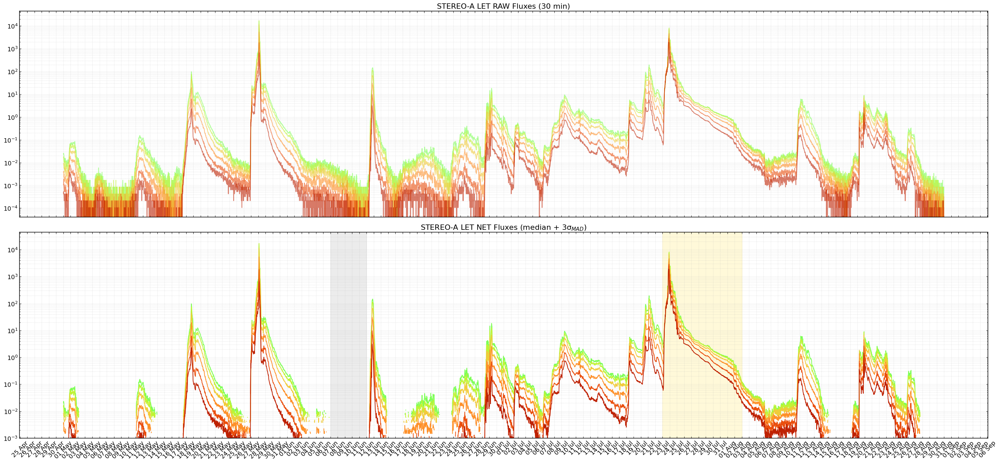

-----------------------------------------------------------------
CHANNEL (MeV)   | MU           | THRESHOLD   
-----------------------------------------------------------------
1.8-2.2         | nan | nan
2.2-2.7         | nan | nan
2.7-3.2         | nan | nan
3.2-3.6         | nan | nan
3.6-4.0         | nan | nan
4.0-4.5         | 2.538e-03 | 1.006e-02
4.5-5.0         | 1.692e-03 | 7.337e-03
5.0-6.0         | 8.461e-04 | 4.609e-03
6.0-8.0         | 4.230e-04 | 1.834e-03
8.0-10.0        | 2.115e-04 | 1.152e-03
10.0-12.0       | 0.000e+00 | 0.000e+00
12.0-15.0       | nan | nan


In [61]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import os

# ============================================================
# 1. FUNZIONE CARICAMENTO DATI STEREO-A LET (RAW 10-min)
# ============================================================
def load_stereo_let_raw(filepath):

    skip_to = 0
    with open(filepath, 'r') as f:
        for i, line in enumerate(f):
            if "BEGIN DATA" in line:
                skip_to = i + 1
                break

    df = pd.read_csv(filepath, sep=r'\s+', skiprows=skip_to, header=None)

    years = df[0].astype(int).astype(str)
    doy_fractional = df[1].astype(float)
    base_date = pd.to_datetime(years + "-01-01")
    df['epoch'] = base_date + pd.to_timedelta(doy_fractional - 1, unit='D')
    df.set_index('epoch', inplace=True)

    let_cols = {
        6: '1.8-2.2',   7: '2.2-2.7',   8: '2.7-3.2',
        9: '3.2-3.6',   10: '3.6-4.0',  11: '4.0-4.5',
        12: '4.5-5.0',  13: '5.0-6.0',  14: '6.0-8.0',
        15: '8.0-10.0', 16: '10.0-12.0', 17: '12.0-15.0'
    }

    df_flux = pd.DataFrame(index=df.index)
    for idx, name in let_cols.items():
        s = pd.to_numeric(df[idx], errors='coerce')
        df_flux[name] = s.where(s > -9000, np.nan).clip(lower=0)

    return df_flux


# ============================================================
# 2. CARICAMENTO MULTI-FILE + RESAMPLING (30 min, MEDIAN)
# ============================================================
folder_let = "File_scaricati_eventiSEP/Evento JUL 2012/LET/"

paths = [
    "H_ahead_2012_05_10min_level1_11.txt",
    "H_ahead_2012_06_10min_level1_11.txt",
    "H_ahead_2012_07_10min_level1_11.txt",
    "H_ahead_2012_08_10min_level1_11.txt"
]

dfs = [load_stereo_let_raw(os.path.join(folder_let, p)) for p in paths]
df_let_full = pd.concat(dfs).sort_index()

t_start, t_end = '2012-05-01', '2012-08-30'
df_let_res = df_let_full.loc[t_start:t_end].resample('30min').median()


# ============================================================
# 3. BACKGROUND ROBUSTO (median + 3*MAD)
# ============================================================
bg_start, bg_end = '2012-06-07', '2012-06-12'
bg = df_let_res.loc[bg_start:bg_end]

mu_let = bg.median()
mad_let = (bg - mu_let).abs().median()
sigma_robust = 1.4826 * mad_let

threshold_let = mu_let + 3 * sigma_robust


# ============================================================
# 4. SERIE NETTE
# ============================================================
# Per fluence (NO threshold)
df_let_net_fluence = (df_let_res - mu_let).clip(lower=0)

# Per plot (Whitman)
df_let_net_clean = df_let_res - mu_let
for col in df_let_net_clean.columns:
    df_let_net_clean.loc[df_let_res[col] < threshold_let[col], col] = np.nan

event_start, event_end = '2012-07-23', '2012-08-03 00:00'
df_let_event_fluence = df_let_net_fluence.loc[event_start:event_end]


# ============================================================
# 5. PLOT DI CONTROLLO
# ============================================================
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(30, 14), sharex=True)
colors = plt.cm.turbo(np.linspace(0, 1, len(df_let_res.columns)))

for i, col in enumerate(df_let_res.columns):
    ax1.plot(df_let_res.index, df_let_res[col], color=colors[i], alpha=0.6)

ax1.set_yscale('log')
ax1.set_title('STEREO-A LET RAW Fluxes (30 min)', fontsize=16)
ax1.grid(True, which='both', ls=':', alpha=0.5)

for i, col in enumerate(df_let_net_clean.columns):
    ax2.plot(df_let_net_clean.index, df_let_net_clean[col], color=colors[i])

ax2.axvspan(pd.to_datetime(bg_start), pd.to_datetime(bg_end), color='gray', alpha=0.15)
ax2.axvspan(pd.to_datetime(event_start), pd.to_datetime(event_end), color='gold', alpha=0.15)

ax2.set_yscale('log')
ax2.set_ylim(bottom=1e-3)
ax2.set_title(r'STEREO-A LET NET Fluxes (median + 3σ$_{MAD}$)', fontsize=16)
ax2.grid(True, which='both', ls=':', alpha=0.5)

ax2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d %b'))
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45)

plt.tight_layout()
plt.show()


# ============================================================
# 6. STAMPA PARAMETRI
# ============================================================
print("-" * 65)
print(f"{'CHANNEL (MeV)':<15} | {'MU':<12} | {'THRESHOLD':<12}")
print("-" * 65)
for col in df_let_res.columns:
    print(f"{col:<15} | {mu_let[col]:.3e} | {threshold_let[col]:.3e}")


In [52]:
import numpy as np
import pandas as pd

# ============================================================
# RICERCA AUTOMATICA FINESTRA BACKGROUND LET (ROBUSTA)
# ============================================================

# ----------------------------
# Parametri configurabili
# ----------------------------
L_days = 5                 # durata finestra background
step = "12h"               # passo scansione (pandas -> 'h', non 'H')
search_start = "2012-05-10"
search_end   = "2012-07-20"   # fermati prima del pre-event rise
event_exclude_start = "2012-07-22"
event_exclude_end   = "2012-08-10"

# Canali LET validi (già selezionati a monte)
cols = df_let_res.columns

L = pd.Timedelta(days=L_days)

# ----------------------------
# Funzione utilità: esclusione evento
# ----------------------------
def in_excluded(t):
    return (
        pd.Timestamp(event_exclude_start) <= t <= pd.Timestamp(event_exclude_end)
    )

# ----------------------------
# Scansione finestre candidate
# ----------------------------
candidates = []

times = pd.date_range(search_start, search_end, freq=step)

expected_points = int(L / pd.Timedelta("30min"))

for t0 in times:
    t1 = t0 + L

    # escludi finestre che toccano evento o coda
    if in_excluded(t0) or in_excluded(t1):
        continue

    w = df_let_res.loc[t0:t1, cols]

    # scarta finestre troppo bucate
    if len(w) < 0.8 * expected_points:
        continue

    # statistiche robuste per canale
    med = w.median()
    mad = (w - med).abs().median()

    # aggregazione robusta su canali
    level = med.median()
    var   = mad.median()

    # stima frazione spike nella finestra
    sigma_robust = 1.4826 * mad
    thr = med + 3 * sigma_robust

    spike_frac = ((w > thr).sum() / w.count()).median()

    # score globale (da minimizzare)
    score = level + 2.0 * var + 5.0 * level * spike_frac

    candidates.append({
        "bg_start": t0,
        "bg_end": t1,
        "score": score,
        "level": level,
        "var": var,
        "spike_frac": spike_frac
    })

# ----------------------------
# Risultati
# ----------------------------
df_bg_scan = (
    pd.DataFrame(candidates)
    .sort_values("score")
    .reset_index(drop=True)
)

print("\n--- Top 10 finestre background candidate (LET) ---")
print(df_bg_scan.head(10).to_string(index=False))

best = df_bg_scan.iloc[0]

print("\nScelta consigliata:")
print(f"bg_start = {best['bg_start']}")
print(f"bg_end   = {best['bg_end']}")
print(
    f"score={best['score']:.3e}  "
    f"level={best['level']:.3e}  "
    f"var={best['var']:.3e}  "
    f"spike_frac={best['spike_frac']:.3f}"
)



--- Top 10 finestre background candidate (LET) ---
           bg_start              bg_end    score    level      var  spike_frac
2012-06-07 12:00:00 2012-06-12 12:00:00 0.001507 0.000476 0.000476    0.033195
2012-06-08 00:00:00 2012-06-13 00:00:00 0.001739 0.000476 0.000476    0.130705
2012-06-07 00:00:00 2012-06-12 00:00:00 0.001811 0.000635 0.000582    0.004149
2012-06-08 12:00:00 2012-06-13 12:00:00 0.001966 0.000476 0.000476    0.226141
2012-06-06 12:00:00 2012-06-11 12:00:00 0.002081 0.000899 0.000582    0.004149
2012-06-09 00:00:00 2012-06-14 00:00:00 0.002203 0.000476 0.000476    0.325726
2012-05-13 00:00:00 2012-05-18 00:00:00 0.002299 0.000740 0.000476    0.163900
2012-05-12 12:00:00 2012-05-17 12:00:00 0.002368 0.000740 0.000476    0.182573
2012-05-13 12:00:00 2012-05-18 12:00:00 0.002422 0.000740 0.000476    0.197095
2012-06-06 00:00:00 2012-06-11 00:00:00 0.002493 0.001163 0.000635    0.010373

Scelta consigliata:
bg_start = 2012-06-07 12:00:00
bg_end   = 2012-06-12 12:00

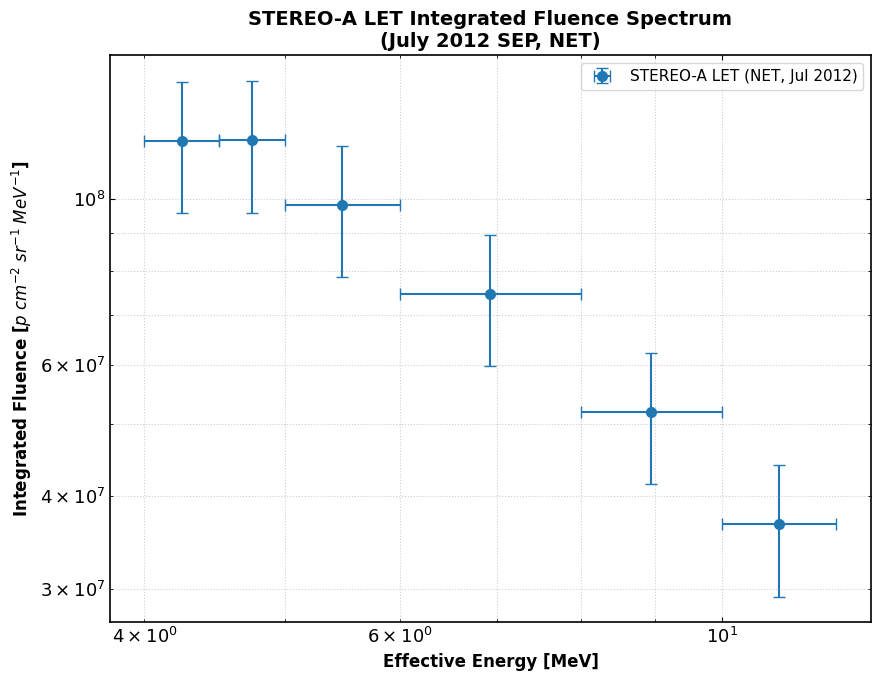


--- Riepilogo fluenze integrate LET (NET) ---
  Channel     E_eff      Fluence        y_err
  4.0-4.5  4.242641 1.195965e+08 2.391930e+07
  4.5-5.0  4.743416 1.199065e+08 2.398131e+07
  5.0-6.0  5.477226 9.820601e+07 1.964120e+07
  6.0-8.0  6.928203 7.463397e+07 1.492679e+07
 8.0-10.0  8.944272 5.180583e+07 1.036117e+07
10.0-12.0 10.954451 3.664381e+07 7.328763e+06


In [62]:
# ============================================================
# CALCOLO FLUENZA INTEGRATA STEREO-A LET (NET, bg-subtracted)
# Finestra: 23 Jul – 02 Aug 2012
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ----------------------------
# 1. Definizione bin energetici LET
# ----------------------------
let_bins = {
    '1.8-2.2': (1.8, 2.2),
    '2.2-2.7': (2.2, 2.7),
    '2.7-3.2': (2.7, 3.2),
    '3.2-3.6': (3.2, 3.6),
    '3.6-4.0': (3.6, 4.0),
    '4.0-4.5': (4.0, 4.5),
    '4.5-5.0': (4.5, 5.0),
    '5.0-6.0': (5.0, 6.0),
    '6.0-8.0': (6.0, 8.0),
    '8.0-10.0': (8.0, 10.0),
    '10.0-12.0': (10.0, 12.0),
    '12.0-15.0': (12.0, 15.0)
}

delta_t = 1800  # 30 min in secondi
rows = []

# ----------------------------
# 2. Integrazione fluenza (NET)
# ----------------------------
for ch, (emin, emax) in let_bins.items():

    if ch not in df_let_event_fluence.columns:
        continue

    # integrazione temporale
    F = df_let_event_fluence[ch].sum() * delta_t

    if F <= 0:
        continue

    # energia efficace (media geometrica)
    Eeff = np.sqrt(emin * emax)

    # errori energetici
    xerr_low  = Eeff - emin
    xerr_high = emax - Eeff

    # errore sistematico LET (più conservativo)
    yerr = 0.20 * F

    rows.append({
        'Channel': ch,
        'E_eff': Eeff,
        'Fluence': F,
        'y_err': yerr,
        'x_err_low': xerr_low,
        'x_err_high': xerr_high
    })

df_fluence_let_2012 = (
    pd.DataFrame(rows)
    .sort_values('E_eff')
    .reset_index(drop=True)
)

# ----------------------------
# 3. Plot spettro di fluenza
# ----------------------------
plt.figure(figsize=(9, 7))

plt.errorbar(
    df_fluence_let_2012['E_eff'],
    df_fluence_let_2012['Fluence'],
    yerr=df_fluence_let_2012['y_err'],
    xerr=[
        df_fluence_let_2012['x_err_low'],
        df_fluence_let_2012['x_err_high']
    ],
    fmt='o',
    capsize=4,
    markersize=7,
    label='STEREO-A LET (NET, Jul 2012)'
)

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which='both', ls=':', alpha=0.6)

plt.xlabel("Effective Energy [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"Integrated Fluence [$p\;cm^{-2}\;sr^{-1}\;MeV^{-1}$]",
           fontsize=12, fontweight='bold')

plt.title("STEREO-A LET Integrated Fluence Spectrum\n(July 2012 SEP, NET)",
          fontsize=14, fontweight='bold')

plt.legend()
plt.tight_layout()
plt.show()

# ----------------------------
# 4. Stampa tabellare
# ----------------------------
print("\n--- Riepilogo fluenze integrate LET (NET) ---")
print(
    df_fluence_let_2012[
        ['Channel', 'E_eff', 'Fluence', 'y_err']
    ].to_string(index=False)
)


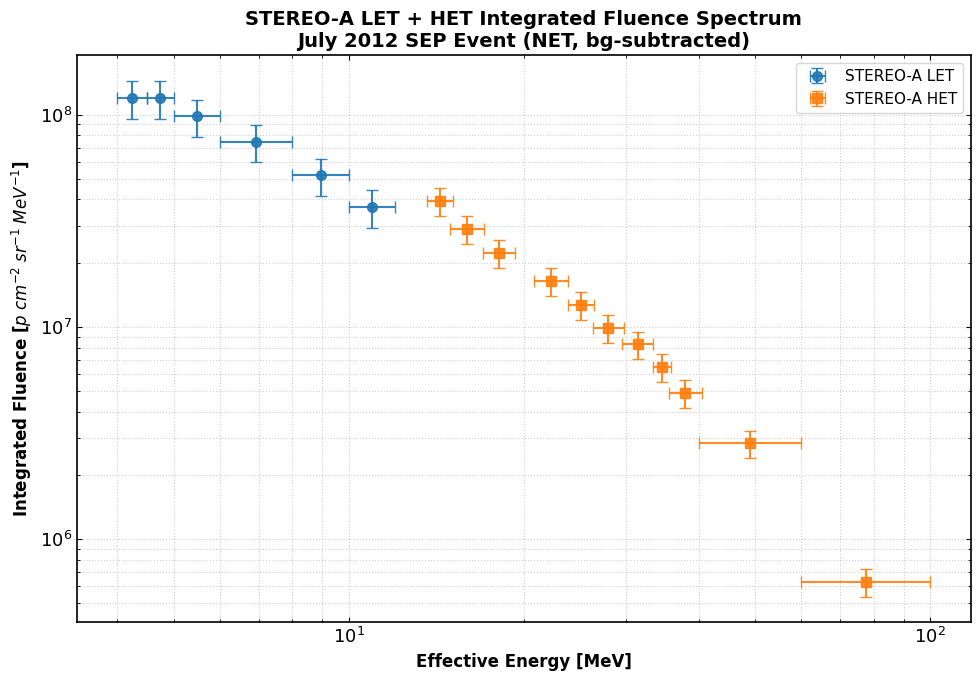


--- Riepilogo fluenze LET + HET ---
Instrument    Channel     E_eff      Fluence        y_err
       LET    4.0-4.5  4.242641 1.195965e+08 2.391930e+07
       LET    4.5-5.0  4.743416 1.199065e+08 2.398131e+07
       LET    5.0-6.0  5.477226 9.820601e+07 1.964120e+07
       LET    6.0-8.0  6.928203 7.463397e+07 1.492679e+07
       LET   8.0-10.0  8.944272 5.180583e+07 1.036117e+07
       LET  10.0-12.0 10.954451 3.664381e+07 7.328763e+06
       HET  13.6-15.1 14.330387 3.934753e+07 5.902130e+06
       HET  14.9-17.1 15.962143 2.900849e+07 4.351274e+06
       HET  17.0-19.3 18.113531 2.241672e+07 3.362508e+06
       HET  20.8-23.8 22.249494 1.642094e+07 2.463141e+06
       HET  23.8-26.4 25.066312 1.267609e+07 1.901413e+06
       HET  26.3-29.7 27.948345 9.902981e+06 1.485447e+06
       HET  29.5-33.4 31.389489 8.280206e+06 1.242031e+06
       HET  33.4-35.8 34.579184 6.462715e+06 9.694072e+05
       HET  35.5-40.5 37.917674 4.883139e+06 7.324709e+05
       HET  40.0-60.0 48.989795 2.8

In [65]:
# ============================================================
# JOIN LET + HET E PLOT DI VERIFICA FLUENZA
# Evento SEP: 23 Jul – 02 Aug 2012
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ----------------------------
# 1. Aggiunta label strumento
# ----------------------------
df_let_plot = df_fluence_let_2012.copy()
df_let_plot['Instrument'] = 'LET'

df_het_plot = df_fluence_het_2012.copy()
df_het_plot['Instrument'] = 'HET'

# ----------------------------
# 2. Unione dataframe
# ----------------------------
df_fluence_all = (
    pd.concat([df_let_plot, df_het_plot])
    .sort_values('E_eff')
    .reset_index(drop=True)
)

# ----------------------------
# 3. Plot di verifica spettrale
# ----------------------------
plt.figure(figsize=(10, 7))

# LET
plt.errorbar(
    df_let_plot['E_eff'],
    df_let_plot['Fluence'],
    yerr=df_let_plot['y_err'],
    xerr=[df_let_plot['x_err_low'], df_let_plot['x_err_high']],
    fmt='o',
    capsize=4,
    markersize=7,
    label='STEREO-A LET',
    alpha=0.9
)

# HET
plt.errorbar(
    df_het_plot['E_eff'],
    df_het_plot['Fluence'],
    yerr=df_het_plot['y_err'],
    xerr=[df_het_plot['x_err_low'], df_het_plot['x_err_high']],
    fmt='s',
    capsize=4,
    markersize=7,
    label='STEREO-A HET',
    alpha=0.9
)

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which='both', ls=':', alpha=0.6)

plt.xlabel("Effective Energy [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"Integrated Fluence [$p\;cm^{-2}\;sr^{-1}\;MeV^{-1}$]",
           fontsize=12, fontweight='bold')

plt.title(
    "STEREO-A LET + HET Integrated Fluence Spectrum\n"
    "July 2012 SEP Event (NET, bg-subtracted)",
    fontsize=14,
    fontweight='bold'
)

plt.legend()
plt.tight_layout()
plt.show()

# ----------------------------
# 4. Stampa tabella combinata (opzionale)
# ----------------------------
print("\n--- Riepilogo fluenze LET + HET ---")
print(
    df_fluence_all[
        ['Instrument', 'Channel', 'E_eff', 'Fluence', 'y_err']
    ].to_string(index=False)
)


# FIT

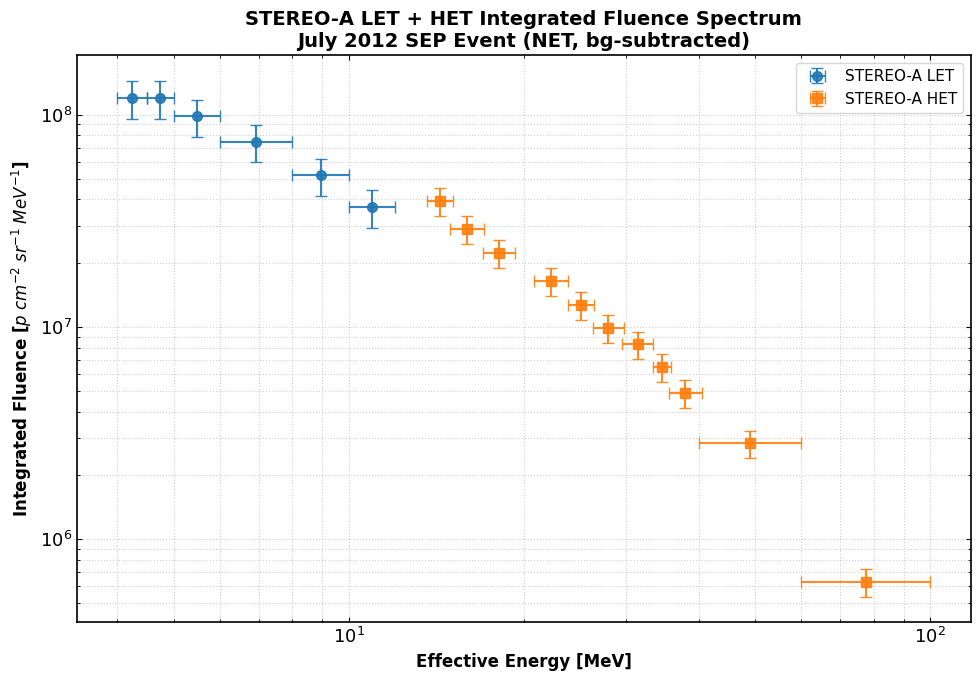


--- Riepilogo fluenze LET + HET ---
Instrument    Channel     E_eff      Fluence        y_err
       LET    4.0-4.5  4.242641 1.195965e+08 2.391930e+07
       LET    4.5-5.0  4.743416 1.199065e+08 2.398131e+07
       LET    5.0-6.0  5.477226 9.820601e+07 1.964120e+07
       LET    6.0-8.0  6.928203 7.463397e+07 1.492679e+07
       LET   8.0-10.0  8.944272 5.180583e+07 1.036117e+07
       LET  10.0-12.0 10.954451 3.664381e+07 7.328763e+06
       HET  13.6-15.1 14.330387 3.934753e+07 5.902130e+06
       HET  14.9-17.1 15.962143 2.900849e+07 4.351274e+06
       HET  17.0-19.3 18.113531 2.241672e+07 3.362508e+06
       HET  20.8-23.8 22.249494 1.642094e+07 2.463141e+06
       HET  23.8-26.4 25.066312 1.267609e+07 1.901413e+06
       HET  26.3-29.7 27.948345 9.902981e+06 1.485447e+06
       HET  29.5-33.4 31.389489 8.280206e+06 1.242031e+06
       HET  33.4-35.8 34.579184 6.462715e+06 9.694072e+05
       HET  35.5-40.5 37.917674 4.883139e+06 7.324709e+05
       HET  40.0-60.0 48.989795 2.8

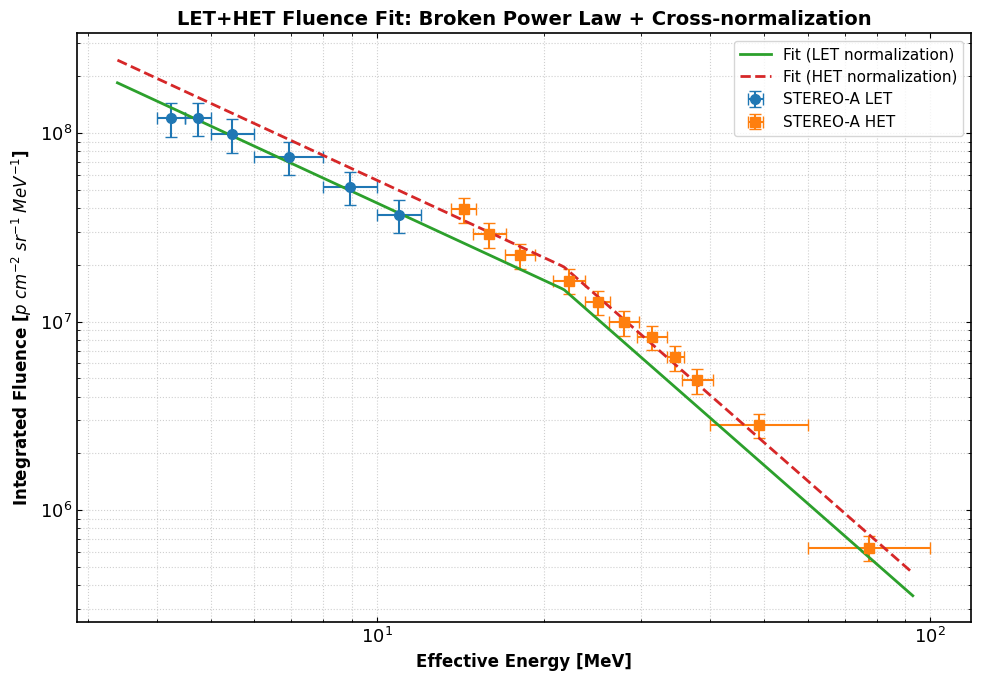

In [68]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# ============================================================
# JOIN LET + HET E PLOT DI VERIFICA FLUENZA
# Evento SEP: 23 Jul – 02 Aug 2012
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ----------------------------
# 1. Aggiunta label strumento
# ----------------------------
df_let_plot = df_fluence_let_2012.copy()
df_let_plot['Instrument'] = 'LET'

df_het_plot = df_fluence_het_2012.copy()
df_het_plot['Instrument'] = 'HET'

# ----------------------------
# 2. Unione dataframe
# ----------------------------
df_fluence_all = (
    pd.concat([df_let_plot, df_het_plot])
    .sort_values('E_eff')
    .reset_index(drop=True)
)

# ----------------------------
# 3. Plot di verifica spettrale
# ----------------------------
plt.figure(figsize=(10, 7))

# LET
plt.errorbar(
    df_let_plot['E_eff'],
    df_let_plot['Fluence'],
    yerr=df_let_plot['y_err'],
    xerr=[df_let_plot['x_err_low'], df_let_plot['x_err_high']],
    fmt='o',
    capsize=4,
    markersize=7,
    label='STEREO-A LET',
    alpha=0.9
)

# HET
plt.errorbar(
    df_het_plot['E_eff'],
    df_het_plot['Fluence'],
    yerr=df_het_plot['y_err'],
    xerr=[df_het_plot['x_err_low'], df_het_plot['x_err_high']],
    fmt='s',
    capsize=4,
    markersize=7,
    label='STEREO-A HET',
    alpha=0.9
)

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which='both', ls=':', alpha=0.6)

plt.xlabel("Effective Energy [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"Integrated Fluence [$p\;cm^{-2}\;sr^{-1}\;MeV^{-1}$]",
           fontsize=12, fontweight='bold')

plt.title(
    "STEREO-A LET + HET Integrated Fluence Spectrum\n"
    "July 2012 SEP Event (NET, bg-subtracted)",
    fontsize=14,
    fontweight='bold'
)

plt.legend()
plt.tight_layout()
plt.show()

# ----------------------------
# 4. Stampa tabella combinata (opzionale)
# ----------------------------
print("\n--- Riepilogo fluenze LET + HET ---")
print(
    df_fluence_all[
        ['Instrument', 'Channel', 'E_eff', 'Fluence', 'y_err']
    ].to_string(index=False)
)


# ============================================================
# FIT: Broken Power Law + cross-normalization HET
# ============================================================


df = df_fluence_all.copy()

# dati
E  = df['E_eff'].values
Y  = df['Fluence'].values
dY = df['y_err'].values
is_het = (df['Instrument'].values == 'HET')

# sicurezza
mask = np.isfinite(E) & np.isfinite(Y) & np.isfinite(dY) & (Y > 0) & (dY > 0)
E, Y, dY, is_het = E[mask], Y[mask], dY[mask], is_het[mask]

# -------- modello: broken power-law continuo + k_het
# params = [A, gamma1, gamma2, Ebreak, k_het]
def bpl_khet(E, A, g1, g2, Eb, khet):
    E = np.asarray(E)
    # broken PL continuo:
    # Y = A * (E/Eb)^(-g1) per E<Eb
    # Y = A * (E/Eb)^(-g2) per E>=Eb
    y = np.where(E < Eb,
                 A * (E / Eb)**(-g1),
                 A * (E / Eb)**(-g2))
    # cross-normalization solo su HET
    y = y * np.where(is_het, khet, 1.0)
    return y

# fit in log10-spazio (più stabile per power law)
logY = np.log10(Y)
# propagazione errore: sigma_log ≈ (1/ln10) * (dY/Y)
sig_logY = (1.0/np.log(10.0)) * (dY / Y)

def model_log(E, A, g1, g2, Eb, khet):
    return np.log10(bpl_khet(E, A, g1, g2, Eb, khet))

# guess iniziali ragionevoli
A0 = np.median(Y)          # ordine di grandezza
g1_0 = 1.5
g2_0 = 3.0
Eb0  = 15.0
k0   = 1.0

p0 = [A0, g1_0, g2_0, Eb0, k0]

# bounds (importanti per stabilità)
# A>0, g1/g2 in range tipico, Eb tra 8 e 40 MeV, khet tra 0.5 e 2
bounds = (
    [1e-12, 0.0, 0.0, 8.0, 0.5],
    [1e+20, 10.0, 10.0, 40.0, 2.0]
)

popt, pcov = curve_fit(
    model_log, E, logY,
    p0=p0,
    sigma=sig_logY,
    absolute_sigma=True,
    bounds=bounds,
    maxfev=200000
)

A, g1, g2, Eb, khet = popt
perr = np.sqrt(np.diag(pcov))

print("\n--- FIT RESULTS (Broken PL + k_het) ---")
print(f"A     = {A:.3e} ± {perr[0]:.3e}")
print(f"g1    = {g1:.3f} ± {perr[1]:.3f}")
print(f"g2    = {g2:.3f} ± {perr[2]:.3f}")
print(f"Ebreak= {Eb:.2f} ± {perr[3]:.2f}  MeV")
print(f"k_het = {khet:.3f} ± {perr[4]:.3f}")

# plot fit
Egrid = np.logspace(np.log10(E.min()*0.8), np.log10(E.max()*1.2), 300)

plt.figure(figsize=(10,7))

# punti
for inst, marker in [('LET','o'), ('HET','s')]:
    dfi = df[df['Instrument']==inst]
    plt.errorbar(
        dfi['E_eff'], dfi['Fluence'],
        yerr=dfi['y_err'],
        xerr=[dfi['x_err_low'], dfi['x_err_high']],
        fmt=marker, capsize=4, markersize=7, label=f"STEREO-A {inst}"
    )

# curve: per visualizzare bene l'effetto k_het, plottiamo due curve:
# - una come LET (khet=1) e una come HET (khet applicato)
def bpl(E, A, g1, g2, Eb):
    return np.where(E < Eb, A*(E/Eb)**(-g1), A*(E/Eb)**(-g2))

plt.plot(Egrid, bpl(Egrid, A, g1, g2, Eb), lw=2, label="Fit (LET normalization)")
plt.plot(Egrid, khet*bpl(Egrid, A, g1, g2, Eb), lw=2, ls='--', label="Fit (HET normalization)")

plt.xscale('log')
plt.yscale('log')
plt.grid(True, which='both', ls=':', alpha=0.6)
plt.xlabel("Effective Energy [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"Integrated Fluence [$p\;cm^{-2}\;sr^{-1}\;MeV^{-1}$]", fontsize=12, fontweight='bold')
plt.title("LET+HET Fluence Fit: Broken Power Law + Cross-normalization", fontsize=14, fontweight='bold')
plt.legend()
plt.tight_layout()
plt.show()



--- INIZIO ELABORAZIONE FINALE (JUL 2012): BPL + k_het + MC + EXPORT ---

--- FIT RESULTS (BPL + k_het) ---
logA   = 7.170 ± 0.171   (A=1.479e+07)
g1     = 1.358 ± 0.233
g2     = 2.574 ± 0.141
Ebreak = 21.76 ± 2.53  MeV
k_het  = 1.319 ± 0.320   (da logk)


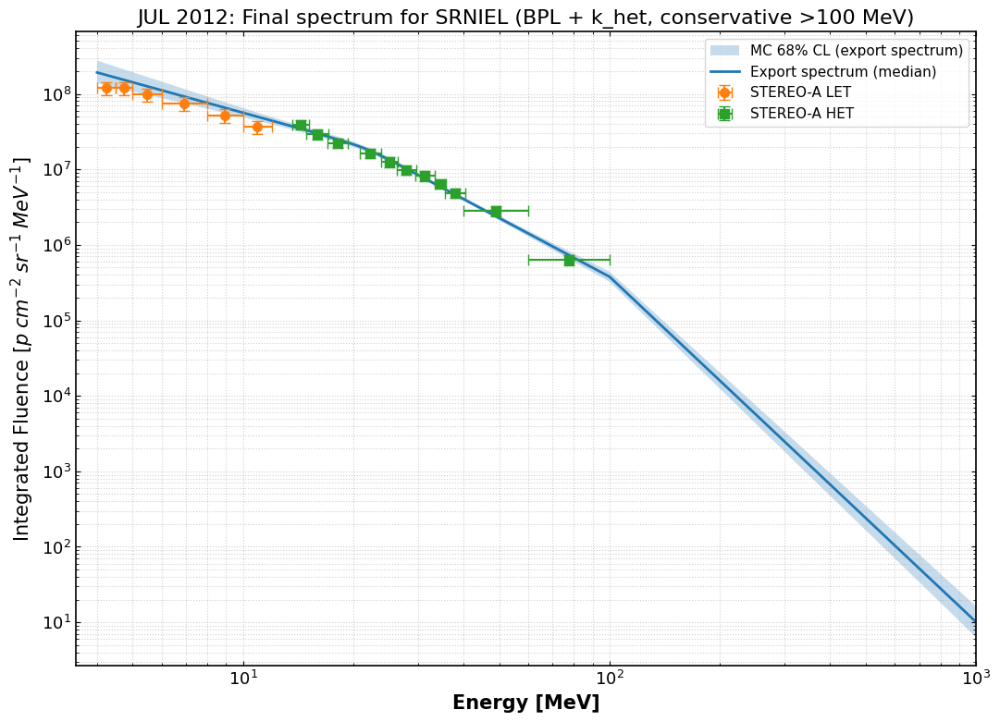


Export SRNIEL completato con bande di incertezza:
 - MEASURED 4–100 MeV: Phi50 + CL68 (Phi16–Phi84)
 - EXTENDED 4–1000 MeV: Phi50 + CL68 (Phi16–Phi84)
Geometrie: Planare (π) e Sferica (4π)
Second break a 100.0 MeV con steepening +2.0


In [71]:
# ============================================================
# JUL 2012 (STEREO-A): FIT + MC + EXPORT SRNIEL (robusto)
# - Gestisce scalino LET/HET con k_het
# - Evita extrapolazione "gonfiante" >100 MeV con 2° break
# ============================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from scipy.optimize import curve_fit
from scipy.linalg import eigh

print("\n--- INIZIO ELABORAZIONE FINALE (JUL 2012): BPL + k_het + MC + EXPORT ---")

# ----------------------------
# 1) PREPARA DATI
# ----------------------------
df = df_fluence_all.copy()

E  = df['E_eff'].values
Y  = df['Fluence'].values
dY = df['y_err'].values
is_het = (df['Instrument'].values == 'HET')

mask = np.isfinite(E) & np.isfinite(Y) & np.isfinite(dY) & (Y > 0) & (dY > 0)
E, Y, dY, is_het = E[mask], Y[mask], dY[mask], is_het[mask]

# errore in log10
sigma_log = (1.0/np.log(10.0)) * (dY / Y)

# ----------------------------
# 2) MODELLO: Broken Power-Law continuo + k_het (solo HET)
#    params = [logA, g1, g2, Eb, logk]
#    (log-param per stabilità e positività)
# ----------------------------
def log_bpl_khet(E, logA, g1, g2, Eb, logk):
    Eb = np.clip(Eb, 1.0, 2000.0)
    A  = 10**logA
    k  = 10**logk

    E = np.asarray(E, dtype=float)
    base = np.where(E < Eb,
                    A * (E/Eb)**(-g1),
                    A * (E/Eb)**(-g2))
    # applica cross-normalization solo a HET
    y = base * np.where(is_het, k, 1.0)
    return np.log10(y)

def bpl(E, logA, g1, g2, Eb):
    Eb = np.clip(Eb, 1.0, 2000.0)
    A  = 10**logA
    E = np.asarray(E, dtype=float)
    return np.where(E < Eb, A*(E/Eb)**(-g1), A*(E/Eb)**(-g2))

# ----------------------------
# 3) FIT
# ----------------------------
logA0 = np.log10(np.median(Y))
p0 = [logA0, 1.5, 3.0, 15.0, 0.0]  # logk=0 -> k=1

bounds = (
    [0.0,   0.0, 0.0,  8.0, -0.3],   # k ~ 0.5
    [20.0, 10.0, 10.0, 40.0,  0.3]   # k ~ 2
)

popt, pcov = curve_fit(
    log_bpl_khet, E, np.log10(Y),
    p0=p0, sigma=sigma_log, absolute_sigma=True,
    bounds=bounds, maxfev=200000
)

perr = np.sqrt(np.diag(pcov))

logA, g1, g2, Eb, logk = popt
khet = 10**logk

print("\n--- FIT RESULTS (BPL + k_het) ---")
print(f"logA   = {logA:.3f} ± {perr[0]:.3f}   (A={10**logA:.3e})")
print(f"g1     = {g1:.3f} ± {perr[1]:.3f}")
print(f"g2     = {g2:.3f} ± {perr[2]:.3f}")
print(f"Ebreak = {Eb:.2f} ± {perr[3]:.2f}  MeV")
print(f"k_het  = {khet:.3f} ± {np.log(10)*khet*perr[4]:.3f}   (da logk)")

# ----------------------------
# 4) MONTE CARLO (parametri) -> bande 68%
# ----------------------------
E_grid = np.logspace(np.log10(4.0), np.log10(1000.0), 500)  # per export (ma vedi sotto cutoff)
N_MC = 2000

# stabilizza cov
clean_cov = (pcov + pcov.T) / 2
vals, vecs = eigh(clean_cov)
vals = np.maximum(vals, 1e-12 * np.max(vals))
stable_cov = vecs @ np.diag(vals) @ vecs.T

rng = np.random.default_rng(42)
mc_params = rng.multivariate_normal(popt, stable_cov, N_MC)

# ----------------------------
# 5) COSTRUISCI SPETTRO UNICO PER EXPORT
#    Scelta tipica: ancorare a HET -> moltiplica base per khet
#    + protezione anti-extrapolazione >100 MeV:
#      secondo break a 100 MeV con steepening (gamma3 = g2 + 2)
# ----------------------------
E2 = 100.0
delta_gamma = 2.0  # steepening prudente oltre 100 MeV

def export_spectrum(E, logA, g1, g2, Eb, logk, E2=100.0, delta_gamma=2.0):
    base = bpl(E, logA, g1, g2, Eb)
    k = 10**logk
    F = k * base  # spettro unico ancorato a HET

    # steepening oltre E2 mantenendo continuità
    F2 = k * bpl(np.array([E2]), logA, g1, g2, Eb)[0]
    g3 = g2 + delta_gamma
    E = np.asarray(E, dtype=float)
    m = E > E2
    F[m] = F2 * (E[m]/E2)**(-g3)
    return F

mc_fits = np.array([export_spectrum(E_grid, *p, E2=E2, delta_gamma=delta_gamma) for p in mc_params])
Phi_med = np.median(mc_fits, axis=0)
Phi_lo, Phi_hi = np.percentile(mc_fits, [16, 84], axis=0)

# ----------------------------
# 6) PLOT (dati + fit mediana + banda)
# ----------------------------
plt.figure(figsize=(11, 8))
plt.fill_between(E_grid, Phi_lo, Phi_hi, alpha=0.25, label="MC 68% CL (export spectrum)")
plt.plot(E_grid, Phi_med, lw=2, label="Export spectrum (median)")

# dati originali
for inst, marker in [('LET','o'), ('HET','s')]:
    dfi = df[df['Instrument'] == inst]
    plt.errorbar(
        dfi['E_eff'], dfi['Fluence'],
        yerr=dfi['y_err'],
        xerr=[dfi['x_err_low'], dfi['x_err_high']],
        fmt=marker, capsize=4, markersize=7,
        label=f"STEREO-A {inst}"
    )

plt.xscale('log'); plt.yscale('log')
plt.xlim(3.5, 1000)
plt.grid(True, which='both', ls=':', alpha=0.6)
plt.xlabel("Energy [MeV]", fontweight='bold')
plt.ylabel(r"Integrated Fluence [$p\;cm^{-2}\;sr^{-1}\;MeV^{-1}$]")
plt.title("JUL 2012: Final spectrum for SRNIEL (BPL + k_het, conservative >100 MeV)")
plt.legend()
plt.tight_layout()
plt.show()

# ----------------------------
# 7) EXPORT SRNIEL
#    NB: decidi geometria: planare π o sferica 4π (come nei tuoi altri)
# ----------------------------
out_dir = "FINAL_JUL2012_EXPORT_SRNIEL_usaquestoiii"
os.makedirs(out_dir, exist_ok=True)

# ============================================================
# EXPORT SRNIEL CON BANDE Φ16 / Φ50 / Φ84
# - MEASURED: 4–100 MeV
# - EXTENDED: 4–1000 MeV (prudente >100 MeV)
# ============================================================

# --- griglie energia
E_meas = np.logspace(np.log10(4.0), np.log10(100.0), 250)
E_ext  = E_grid  # già 4–1000 MeV

# --- ricostruisci MC anche sul range misurato
mc_meas = np.array([
    export_spectrum(E_meas, *p, E2=E2, delta_gamma=delta_gamma)
    for p in mc_params
])

# percentili MEASURED
Phi16_meas = np.percentile(mc_meas, 16, axis=0)
Phi50_meas = np.percentile(mc_meas, 50, axis=0)
Phi84_meas = np.percentile(mc_meas, 84, axis=0)

# percentili EXTENDED (già calcolati prima, ma li rinominiamo per chiarezza)
Phi16_ext = Phi_lo
Phi50_ext = Phi_med
Phi84_ext = Phi_hi

# ============================================================
# SCRITTURA FILE
# ============================================================

for geo, factor in {"Planare": np.pi, "Sferica": 4*np.pi}.items():

    # ---------- MEASURED 4–100 MeV ----------
    np.savetxt(
        f"{out_dir}/JUL2012_{geo}_MEASURED_4-100MeV_Phi50.txt",
        np.column_stack([E_meas, factor * Phi50_meas]),
        fmt="%.6e"
    )

    np.savetxt(
        f"{out_dir}/JUL2012_{geo}_MEASURED_4-100MeV_CL68.txt",
        np.column_stack([E_meas, factor * Phi16_meas, factor * Phi84_meas]),
        fmt="%.6e"
    )

    # ---------- EXTENDED 4–1000 MeV ----------
    np.savetxt(
        f"{out_dir}/JUL2012_{geo}_EXTENDED_4-1000MeV_Phi50.txt",
        np.column_stack([E_ext, factor * Phi50_ext]),
        fmt="%.6e"
    )

    np.savetxt(
        f"{out_dir}/JUL2012_{geo}_EXTENDED_4-1000MeV_CL68.txt",
        np.column_stack([E_ext, factor * Phi16_ext, factor * Phi84_ext]),
        fmt="%.6e"
    )

print("\nExport SRNIEL completato con bande di incertezza:")
print(" - MEASURED 4–100 MeV: Phi50 + CL68 (Phi16–Phi84)")
print(" - EXTENDED 4–1000 MeV: Phi50 + CL68 (Phi16–Phi84)")
print(f"Geometrie: Planare (π) e Sferica (4π)")
print(f"Second break a {E2} MeV con steepening +{delta_gamma}")



# CALCOLO DOSE 4-100 MeV 

# Spherical SHIELDING 37mm Al
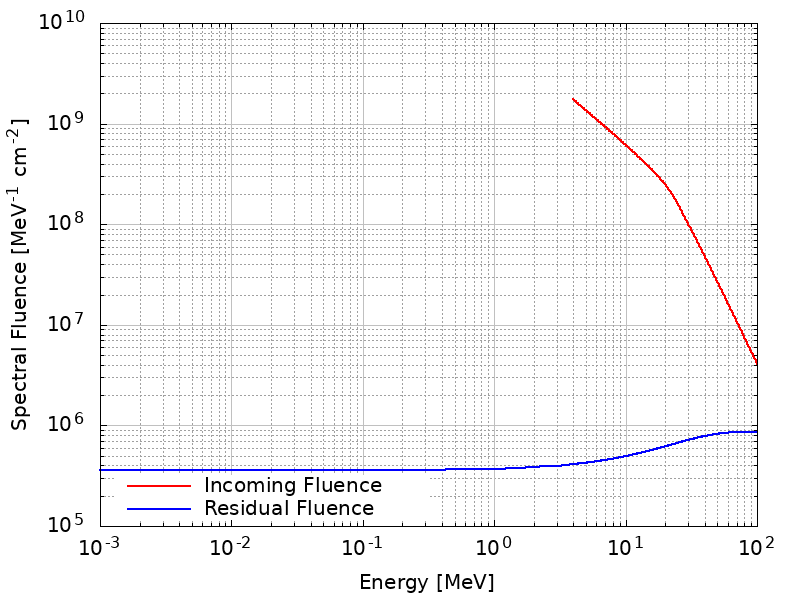

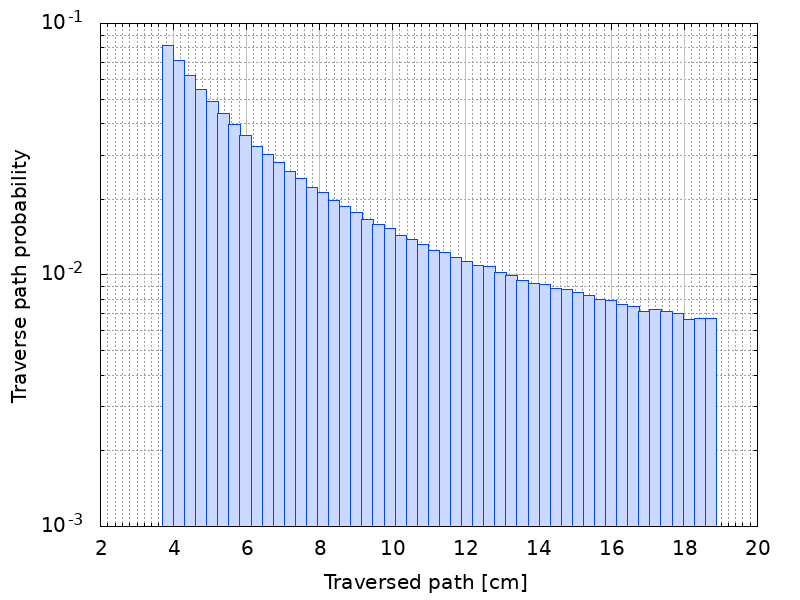

In [72]:
# ============================================================
# ESTRAPOLAZIONE DATI PHI 16 E PHI 84 PER SR-NIEL
# ============================================================
import pandas as pd

# Path del file generato dal Monte Carlo
path_cl = "FINAL_JUL2012_EXPORT_SRNIEL_usaquestoiii/measured4_100MeV/Spherical/JUL2012_Sferica_MEASURED_4-100MeV_CL68.txt"

# Caricamento robusto: 
# 1. sep=r"\s+" per gestire spazi multipli
# 2. comment='#' salta le righe che iniziano con l'header di numpy
# 3. names definisce le colonne
df_cl = pd.read_csv(path_cl, sep=r"\s+", comment='#', names=["E", "Phi_16", "Phi_84"])

# Conversione forzata a numerico (per evitare l'errore ValueError su 'e')
df_cl = df_cl.apply(pd.to_numeric, errors='coerce').dropna()

# ============================================================
# TABELLA 1: LIMITE INFERIORE (16° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    # Ora row['E'] e row['Phi_16'] sono numeri reali, .6e funzionerà
    print(f"{row['E']:.6e} {row['Phi_16']:.6e}")

print("\n\n" + "="*60 + "\n\n")

# ============================================================
# TABELLA 2: LIMITE SUPERIORE (84° Percentile)
# ============================================================
print("-" * 50)
print("TABELLA PER RUN SR-NIEL: PHI_84 (Upper Bound)")
print("-" * 50)
for _, row in df_cl.iterrows():
    print(f"{row['E']:.6e} {row['Phi_84']:.6e}")

--------------------------------------------------
TABELLA PER RUN SR-NIEL: PHI_16 (Lower Bound)
--------------------------------------------------
4.000000e+00 1.736109e+09
4.052045e+00 1.713260e+09
4.104766e+00 1.689336e+09
4.158174e+00 1.665249e+09
4.212276e+00 1.642669e+09
4.267083e+00 1.620302e+09
4.322602e+00 1.597311e+09
4.378844e+00 1.572598e+09
4.435818e+00 1.547847e+09
4.493533e+00 1.526102e+09
4.551999e+00 1.502799e+09
4.611226e+00 1.480350e+09
4.671223e+00 1.458351e+09
4.732001e+00 1.435920e+09
4.793569e+00 1.413812e+09
4.855939e+00 1.394231e+09
4.919121e+00 1.373394e+09
4.983124e+00 1.354471e+09
5.047960e+00 1.334701e+09
5.113640e+00 1.315769e+09
5.180174e+00 1.298324e+09
5.247574e+00 1.280104e+09
5.315851e+00 1.262624e+09
5.385016e+00 1.245338e+09
5.455081e+00 1.227296e+09
5.526058e+00 1.209638e+09
5.597958e+00 1.192086e+09
5.670794e+00 1.175087e+09
5.744577e+00 1.158811e+09
5.819321e+00 1.142277e+09
5.895036e+00 1.125522e+09
5.971738e+00 1.108674e+09
6.049437e+00 1.09222

-----------------------------------------------------------------
ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (4 - 100 MeV original export) -  JUL 2012
Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)
Dose Mediana: 216.5279 mGy
Intervallo 68% CL (Fit MC + 5% SRIM): [170.304 - 274.503] mGy
Incertezza Totale: +57.975 / -46.224 mGy
-----------------------------------------------------------------


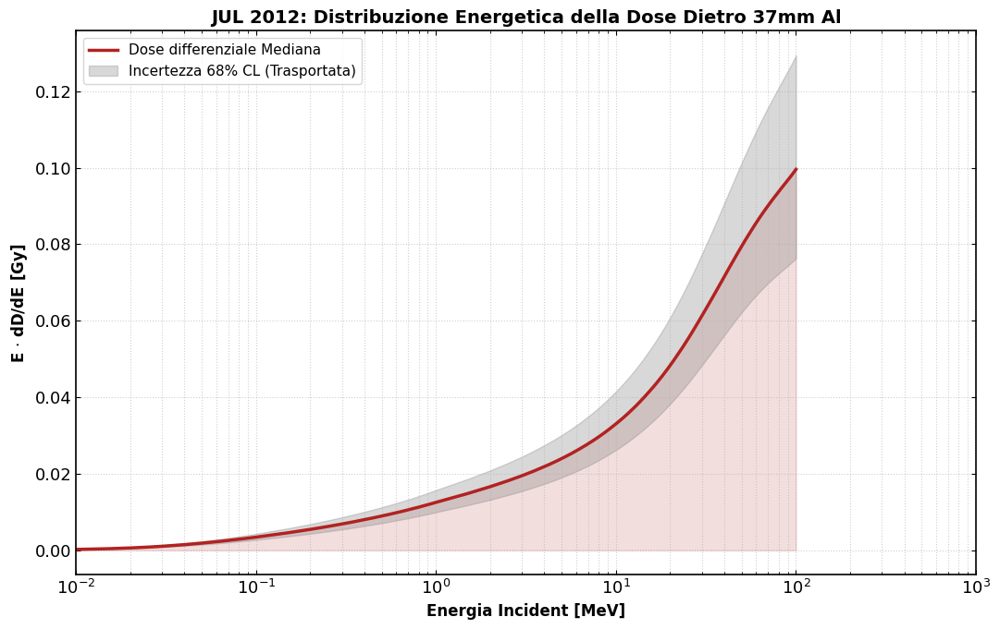

In [74]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ============================================================
# 1. CARICAMENTO DATI RESIDUI (TRASPORTO DIRETTO SR-NIEL)
# ============================================================

base_path = "FINAL_JUL2012_EXPORT_SRNIEL_usaquestoiii/measured4_100MeV/Spherical/"

# 1.1 Caricamento Mediana Residua
path_med = base_path + "37mmAl_spherical_median_residual.txt"
df_med = pd.read_csv(path_med, sep=r"\s+", comment="#", skiprows=1, 
                     names=["E", "Phi_in_med", "Phi_res_med"]).sort_values("E")

# 1.2 Caricamento Limite Inferiore Residuo (Phi 16)
path_16 = base_path + "37mmAl_spherical_Phi16_residual.txt"
df_16 = pd.read_csv(path_16, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_16", "Phi_res_16"]).sort_values("E")

# 1.3 Caricamento Limite Superiore Residuo (Phi 84)
path_84 = base_path + "37mmAl_spherical_Phi84_residual.txt"
df_84 = pd.read_csv(path_84, sep=r"\s+", comment="#", skiprows=1, 
                    names=["E", "Phi_in_84", "Phi_res_84"]).sort_values("E")

# 1.4 Caricamento Stopping Power Si (Database SRIM)
path_S = "Simulazioni_SRNIEL/JAN2005/FINAL_JAN2005_SRNIEL_EXPORT/stopping_power_Si.txt"
df_S = pd.read_csv(path_S, sep=r"\s+", comment="#", skiprows=1, 
                   names=["E", "S", "Dose_MeV_g", "Dose_Gy"]).drop_duplicates(subset="E").sort_values("E")

# ============================================================
# 2. INTERPOLAZIONE SULLA GRIGLIA MASTER
# ============================================================

# Utilizziamo la griglia energetica della mediana come riferimento
E_master = df_med["E"].values
Phi_res_med = df_med["Phi_res_med"].values

# Interpolazione dei flussi residui di incertezza sulla griglia master
Phi_res_16 = np.interp(E_master, df_16["E"], df_16["Phi_res_16"])
Phi_res_84 = np.interp(E_master, df_84["E"], df_84["Phi_res_84"])

# Interpolazione log-log dello Stopping Power (più accurata fisicamente)
S_grid = 10**np.interp(np.log10(E_master), np.log10(df_S["E"]), np.log10(df_S["S"]))

# ============================================================
# 3. INTEGRAZIONE DOSE TID E CALCOLO INCERTEZZA
# ============================================================
CONV_GY = 1.602e-10

# Dose Mediana
dose_med_mGy = np.trapezoid(Phi_res_med * S_grid, E_master) * CONV_GY * 1e3

# Dose 16th CL (Lower: Flusso basso + Stopping Power -5%)
dose_16_mGy = np.trapezoid(Phi_res_16 * (S_grid * 0.95), E_master) * CONV_GY * 1e3

# Dose 84th CL (Upper: Flusso alto + Stopping Power +5%)
dose_84_mGy = np.trapezoid(Phi_res_84 * (S_grid * 1.05), E_master) * CONV_GY * 1e3

print("-" * 65)
print(f"ANALISI RIGOROSA DOSE (TRASPORTO DIRETTO) (4 - 100 MeV original export) -  JUL 2012")  
print(f"Configurazione: 37mm Al (~10 g/cm²), Geometria Sferica (4π sr)")
print(f"Dose Mediana: {dose_med_mGy:.4f} mGy")
print(f"Intervallo 68% CL (Fit MC + 5% SRIM): [{dose_16_mGy:.3f} - {dose_84_mGy:.3f}] mGy")
print(f"Incertezza Totale: +{dose_84_mGy - dose_med_mGy:.3f} / -{dose_med_mGy - dose_16_mGy:.3f} mGy")
print("-" * 65)

# ============================================================
# 4. VISUALIZZAZIONE DELLA DISTRIBUZIONE ENERGETICA
# ============================================================
dD_dE_med = Phi_res_med * S_grid * CONV_GY
dD_dE_16  = Phi_res_16  * (S_grid * 0.95) * CONV_GY
dD_dE_84  = Phi_res_84  * (S_grid * 1.05) * CONV_GY

plt.figure(figsize=(11, 7))

# Area della dose mediana
plt.semilogx(E_master, E_master * dD_dE_med, color='firebrick', lw=2.5, label='Dose differenziale Mediana')
plt.fill_between(E_master, E_master * dD_dE_med, color='firebrick', alpha=0.15)

# Fascia di incertezza spettrale trasportata
plt.fill_between(E_master, E_master * dD_dE_16, E_master * dD_dE_84, 
                 color='gray', alpha=0.3, label='Incertezza 68% CL (Trasportata)')

plt.title("JUL 2012: Distribuzione Energetica della Dose Dietro 37mm Al", fontsize=14, fontweight='bold')
plt.xlabel("Energia Incident [MeV]", fontsize=12, fontweight='bold')
plt.ylabel(r"E $\cdot$ dD/dE [Gy]", fontsize=12, fontweight='bold')
plt.grid(True, which="both", ls=':', alpha=0.6)
plt.xlim(0.01, 1000) # Focus sulla zona che contribuisce alla dose residua
plt.legend(frameon=True, facecolor='white')
plt.tight_layout()
plt.show()

# STEP SUCCESSIVO 
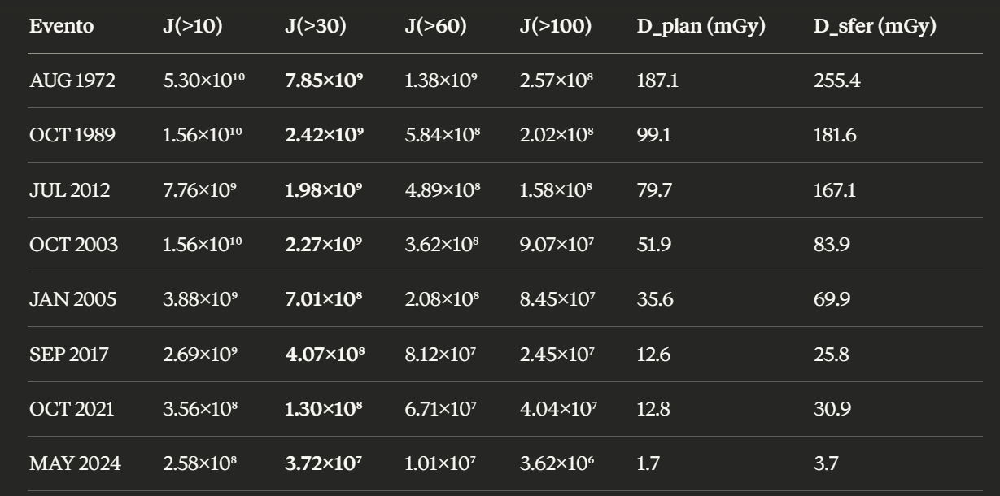

DOSE-FLUENCE POWER LAW FIT (WEIGHTED): D = 10^a × F^b
Shielding: 10 g/cm² Al (37 mm)

--- Geometria: Sferica (4pi sr) ---
    sigma_logD per evento: ['0.085', '0.099', '0.135', '0.072', '0.080', '0.068', '0.065', '0.076']

  J(>30 MeV):
    D = 10^(-4.556±0.344) × F^(0.710±0.039)
    R² = 0.8981  |  chi²_red = 7.81
    sigma_spectral = 0.1816 dex (51.9%)
    (scatter = ±51.9% in dose)

  J(>60 MeV):
    D = 10^(-5.394±0.369) × F^(0.864±0.045)
    R² = 0.9769  |  chi²_red = 1.55
    sigma_spectral = 0.0862 dex (21.9%)
    (scatter = ±21.9% in dose)

  J(>100 MeV):
    D = 10^(-5.872±0.391) × F^(0.979±0.051)
    R² = 0.9929  |  chi²_red = 0.53
    sigma_spectral = 0.0478 dex (11.6%)
    (scatter = ±11.6% in dose)

--- Geometria: Planare (pi sr) ---
    sigma_logD per evento: ['0.082', '0.090', '0.109', '0.074', '0.081', '0.069', '0.059', '0.077']

  J(>30 MeV):
    D = 10^(-5.581±0.334) × F^(0.796±0.038)
    R² = 0.9417  |  chi²_red = 6.09
    sigma_spectral = 0.1494 dex (41.0%)
    (sca

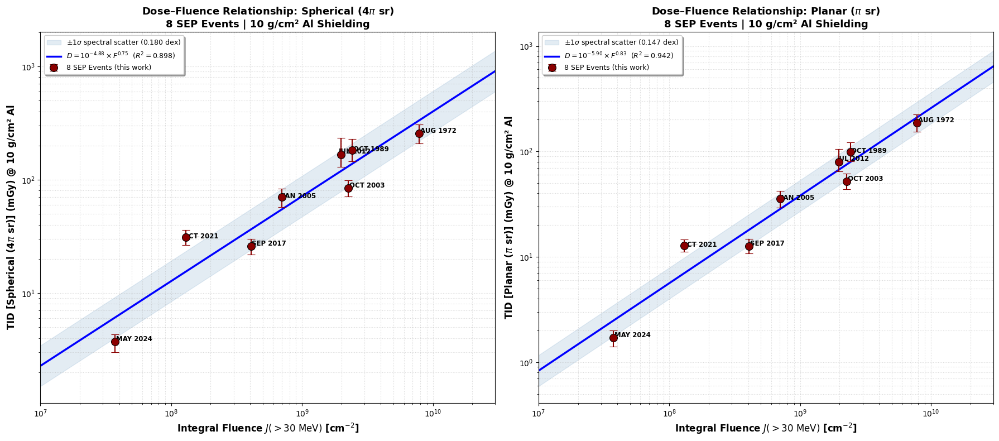


CONFRONTO METRICHE DI FLUENZA (Geometria Sferica)
Metrica                a        b       R²   σ_spec (dex)   σ_spec (%)
----------------------------------------------------------------------
J(>30 MeV)        -4.882    0.748   0.8981         0.1796        51.2%
J(>60 MeV)        -5.521    0.880   0.9769         0.0856        21.8%
J(>100 MeV)       -5.935    0.988   0.9929         0.0475        11.6%

→ La metrica con R² più alto e σ_spectral più basso è
  la migliore per la relazione dose-fluenza nel Monte Carlo.

TABELLA MASTER — 8 EVENTI SEP ANALIZZATI
Dose: TID in Si @ 10 g/cm² Al (37 mm) | Fluenze: omnidirezionali [cm⁻²]
Evento       J(>30)       J(>60)       J(>100)      D_plan     D_sfer       γ_b/γ₂
------------------------------------------------------------------------------------------
AUG 1972     7.85e+09     1.38e+09     2.57e+08     187.1      255.4          7.95
OCT 1989     2.42e+09     5.84e+08     2.02e+08     99.1       181.6          3.07
JUL 2012     1.98e+09   

In [9]:

import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.stats import pearsonr

# ============================================================
# 1. DATI: 8 EVENTI SEP — FLUENZE + DOSI
# ============================================================

events = {
    'AUG 1972': {'J10': 5.301e10, 'J30': 7.847e9, 'J60': 1.384e9, 'J100': 2.566e8,
                 'D_plan': 187.1, 'D_sfer': 255.4, 'dD_plan': [33.7, 37.1], 'dD_sfer': [47.3, 52.1]},
    'OCT 1989': {'J10': 1.557e10, 'J30': 2.415e9, 'J60': 5.836e8, 'J100': 2.017e8,
                 'D_plan': 99.1, 'D_sfer': 181.6, 'dD_plan': [18.5, 22.7], 'dD_sfer': [37.2, 45.7]},
    'JUL 2012': {'J10': 7.755e9, 'J30': 1.981e9, 'J60': 4.888e8, 'J100': 1.581e8,
                 'D_plan': 79.7, 'D_sfer': 167.1, 'dD_plan': [14.8, 25.3], 'dD_sfer': [37.8, 66.4]},
    'OCT 2003': {'J10': 1.564e10, 'J30': 2.266e9, 'J60': 3.617e8, 'J100': 9.068e7,
                 'D_plan': 51.9, 'D_sfer': 83.9, 'dD_plan': [8.3, 9.5], 'dD_sfer': [13.1, 14.8]},
    'JAN 2005': {'J10': 3.878e9, 'J30': 7.011e8, 'J60': 2.082e8, 'J100': 8.449e7,
                 'D_plan': 35.6, 'D_sfer': 69.9, 'dD_plan': [6.4, 6.8], 'dD_sfer': [12.6, 13.2]},
    'SEP 2017': {'J10': 2.685e9, 'J30': 4.065e8, 'J60': 8.124e7, 'J100': 2.448e7,
                 'D_plan': 12.6, 'D_sfer': 25.8, 'dD_plan': [1.9, 2.1], 'dD_sfer': [3.9, 4.2]},
    'OCT 2021': {'J10': 3.555e8, 'J30': 1.297e8, 'J60': 6.712e7, 'J100': 4.036e7,
                 'D_plan': 12.8, 'D_sfer': 30.9, 'dD_plan': [1.7, 1.8], 'dD_sfer': [4.3, 4.9]},
    'MAY 2024': {'J10': 2.583e8, 'J30': 3.723e7, 'J60': 1.014e7, 'J100': 3.618e6,
                 'D_plan': 1.7, 'D_sfer': 3.7, 'dD_plan': [0.3, 0.3], 'dD_sfer': [0.7, 0.6]},
}

names = list(events.keys())
J30  = np.array([events[n]['J30'] for n in names])
J60  = np.array([events[n]['J60'] for n in names])
J100 = np.array([events[n]['J100'] for n in names])
D_sfer = np.array([events[n]['D_sfer'] for n in names])
D_plan = np.array([events[n]['D_plan'] for n in names])

# Errori asimmetrici per plot (prendi media per fit simmetrico)
dD_sfer_lo = np.array([events[n]['dD_sfer'][0] for n in names])
dD_sfer_hi = np.array([events[n]['dD_sfer'][1] for n in names])
dD_plan_lo = np.array([events[n]['dD_plan'][0] for n in names])
dD_plan_hi = np.array([events[n]['dD_plan'][1] for n in names])

# ============================================================
# 2. FIT POWER LAW: log(D) = a + b*log(F)
#    Per tutte le soglie energetiche e geometrie
# ============================================================
# ============================================================
# 2. FIT POWER LAW PESATO: log(D) = a + b*log(F)
#    Pesi: sigma_logD dalle tue bande CL 16/84
# ============================================================

def linear_model(x, a, b):
    return a + b * x

print("=" * 70)
print("DOSE-FLUENCE POWER LAW FIT (WEIGHTED): D = 10^a × F^b")
print("Shielding: 10 g/cm² Al (37 mm)")
print("=" * 70)

results = {}

for geo_name, D_arr, dD_lo, dD_hi, label in [
    ("Sferica (4pi sr)", D_sfer, dD_sfer_lo, dD_sfer_hi, "Spherical"),
    ("Planare (pi sr)", D_plan, dD_plan_lo, dD_plan_hi, "Planar")
]:
    # Incertezza in log-space dalla media delle bande asimmetriche
    # sigma_logD = media(dD_lo, dD_hi) / (D * ln(10))
    dD_mean = (dD_lo + dD_hi) / 2.0
    sigma_logD = dD_mean / (D_arr * np.log(10))
    
    print(f"\n--- Geometria: {geo_name} ---")
    print(f"    sigma_logD per evento: {[f'{s:.3f}' for s in sigma_logD]}")
    
    for thresh_name, F_arr in [("J(>30 MeV)", J30), ("J(>60 MeV)", J60), ("J(>100 MeV)", J100)]:
        logF = np.log10(F_arr)
        logD = np.log10(D_arr)
        
        # Fit pesato con le tue incertezze
        popt, pcov = curve_fit(linear_model, logF, logD, 
                               sigma=sigma_logD, absolute_sigma=True)
        perr = np.sqrt(np.diag(pcov))
        
        # Residui pesati e chi2 ridotto
        residuals = (logD - linear_model(logF, *popt)) / sigma_logD
        chi2red = np.sum(residuals**2) / (len(logD) - 2)
        
        # Scatter spettrale (dai residui non pesati)
        res_unw = logD - linear_model(logF, *popt)
        sigma_scatter = np.std(res_unw)
        
        # Correlazione
        r, p_val = pearsonr(logF, logD)
        R2 = r**2
        
        key = f"{label}_{thresh_name}"
        results[key] = {
            'a': popt[0], 'b': popt[1],
            'da': perr[0], 'db': perr[1],
            'R2': R2, 'sigma': sigma_scatter,
            'chi2red': chi2red
        }
        
        print(f"\n  {thresh_name}:")
        print(f"    D = 10^({popt[0]:.3f}±{perr[0]:.3f}) × F^({popt[1]:.3f}±{perr[1]:.3f})")
        print(f"    R² = {R2:.4f}  |  chi²_red = {chi2red:.2f}")
        print(f"    sigma_spectral = {sigma_scatter:.4f} dex ({(10**sigma_scatter - 1)*100:.1f}%)")
        print(f"    (scatter = ±{(10**sigma_scatter - 1)*100:.1f}% in dose)")

# ============================================================
# 3. PLOT PRINCIPALE: D_sferica vs J(>30 MeV)
# ============================================================

fig, axes = plt.subplots(1, 2, figsize=(18, 8))

for ax_idx, (geo_name, D_arr, dD_lo, dD_hi, geo_label) in enumerate([
    (r"Spherical (4$\pi$ sr)", D_sfer, dD_sfer_lo, dD_sfer_hi, "Spherical"),
    (r"Planar ($\pi$ sr)", D_plan, dD_plan_lo, dD_plan_hi, "Planar")
]):
    ax = axes[ax_idx]
    
    # Fit con J(>30 MeV)
    logF = np.log10(J30)
    logD = np.log10(D_arr)
    popt, pcov = curve_fit(linear_model, logF, logD)
    residuals = logD - linear_model(logF, *popt)
    sigma_sc = np.std(residuals)
    r, _ = pearsonr(logF, logD)
    
    # Griglia per fit line
    F_fit = np.logspace(7, 10.5, 200)
    D_fit = 10**(popt[0] + popt[1] * np.log10(F_fit))
    D_fit_hi = 10**(popt[0] + popt[1] * np.log10(F_fit) + sigma_sc)
    D_fit_lo = 10**(popt[0] + popt[1] * np.log10(F_fit) - sigma_sc)
    
    # Scatter band (±1σ spettrale)
    ax.fill_between(F_fit, D_fit_lo, D_fit_hi, color='steelblue', alpha=0.15,
                    label=rf'$\pm 1\sigma$ spectral scatter ({sigma_sc:.3f} dex)')
    
    # Fit line
    ax.plot(F_fit, D_fit, 'b-', lw=2.5,
            label=rf'$D = 10^{{{popt[0]:.2f}}} \times F^{{{popt[1]:.2f}}}$  ($R^2={r**2:.3f}$)')
    
    # Data points con error bars
    ax.errorbar(J30, D_arr, yerr=[dD_lo, dD_hi], 
                fmt='o', color='darkred', markersize=10, capsize=5, capthick=1.5,
                markeredgecolor='black', markeredgewidth=0.8, zorder=5,
                label='8 SEP Events (this work)')
    
    # Labels per ogni punto
    offsets = {
        'AUG 1972': (0.15, 0.12), 'OCT 1989': (0.15, -0.18),
        'JUL 2012': (-0.35, 0.12), 'OCT 2003': (0.15, 0.12),
        'JAN 2005': (0.15, -0.18), 'SEP 2017': (0.15, 0.12),
        'OCT 2021': (-0.45, -0.18), 'MAY 2024': (0.15, 0.12)
    }
    for i, name in enumerate(names):
        dx, dy = offsets.get(name, (0.1, 0.1))
        ax.annotate(name, (J30[i], D_arr[i]),
                   xytext=(dx, dy), textcoords='offset fontsize',
                   fontsize=8.5, fontweight='bold',
                   arrowprops=dict(arrowstyle='-', color='gray', lw=0.5) if abs(dx)>0.3 else None)
    
    ax.set_xscale('log'); ax.set_yscale('log')
    ax.set_xlabel(r'Integral Fluence $J(>30\ \mathrm{MeV})$ [cm$^{-2}$]', fontsize=12, fontweight='bold')
    ax.set_ylabel(f'TID [{geo_name}] (mGy) @ 10 g/cm² Al', fontsize=12, fontweight='bold')
    ax.set_title(f'Dose–Fluence Relationship: {geo_name}\n'
                 f'8 SEP Events | 10 g/cm² Al Shielding', fontsize=13, fontweight='bold')
    ax.grid(True, which='both', ls=':', alpha=0.5)
    ax.legend(loc='upper left', fontsize=9, shadow=True)
    ax.set_xlim(1e7, 3e10)

fig.tight_layout()
plt.show()

# ============================================================
# 4. CONFRONTO TRA METRICHE: J(>30) vs J(>60) vs J(>100)
# ============================================================

print("\n" + "=" * 70)
print("CONFRONTO METRICHE DI FLUENZA (Geometria Sferica)")
print("=" * 70)
print(f"{'Metrica':<15} {'a':>8} {'b':>8} {'R²':>8} {'σ_spec (dex)':>14} {'σ_spec (%)':>12}")
print("-" * 70)

for thresh_name, F_arr in [("J(>30 MeV)", J30), ("J(>60 MeV)", J60), ("J(>100 MeV)", J100)]:
    logF = np.log10(F_arr)
    logD = np.log10(D_sfer)
    popt, _ = curve_fit(linear_model, logF, logD)
    res = logD - linear_model(logF, *popt)
    sig = np.std(res)
    r, _ = pearsonr(logF, logD)
    pct = (10**sig - 1) * 100
    print(f"{thresh_name:<15} {popt[0]:>8.3f} {popt[1]:>8.3f} {r**2:>8.4f} {sig:>14.4f} {pct:>11.1f}%")

print("\n→ La metrica con R² più alto e σ_spectral più basso è")
print("  la migliore per la relazione dose-fluenza nel Monte Carlo.")

# ============================================================
# 5. TABELLA RIASSUNTIVA FINALE
# ============================================================

print("\n" + "=" * 90)
print("TABELLA MASTER — 8 EVENTI SEP ANALIZZATI")
print("Dose: TID in Si @ 10 g/cm² Al (37 mm) | Fluenze: omnidirezionali [cm⁻²]")
print("=" * 90)
print(f"{'Evento':<12} {'J(>30)':<12} {'J(>60)':<12} {'J(>100)':<12} {'D_plan':<10} {'D_sfer':<10} {'γ_b/γ₂':>8}")
print("-" * 90)

# Indici spettrali per riferimento
gamma_b = {
    'AUG 1972': 7.95, 'OCT 1989': 3.07, 'JUL 2012': 3.20,
    'OCT 2003': 2.50, 'JAN 2005': 3.20, 'SEP 2017': 3.34,
    'OCT 2021': 1.89, 'MAY 2024': 2.67  # gamma ER
}

for name in names:
    e = events[name]
    gb = gamma_b.get(name, 0)
    print(f"{name:<12} {e['J30']:<12.2e} {e['J60']:<12.2e} {e['J100']:<12.2e} "
          f"{e['D_plan']:<10.1f} {e['D_sfer']:<10.1f} {gb:>8.2f}")

print("=" * 90)






































DOSE-FLUENCE POWER LAW FIT (WEIGHTED): D = 10^a × F^b
Shielding: 10 g/cm² Al (37 mm)

--- Geometria: Sferica (4pi sr) ---
    sigma_logD per evento: ['0.085', '0.099', '0.135', '0.072', '0.080', '0.068', '0.065', '0.076']

  J(>30 MeV):
    D = 10^(-4.556±0.344) × F^(0.710±0.039)
    R² = 0.8981  |  chi²_red = 7.81
    sigma_spectral = 0.1816 dex (51.9%)
    (scatter = ±51.9% in dose)

  J(>60 MeV):
    D = 10^(-5.394±0.369) × F^(0.864±0.045)
    R² = 0.9769  |  chi²_red = 1.55
    sigma_spectral = 0.0862 dex (21.9%)
    (scatter = ±21.9% in dose)

  J(>100 MeV):
    D = 10^(-5.872±0.391) × F^(0.979±0.051)
    R² = 0.9929  |  chi²_red = 0.53
    sigma_spectral = 0.0478 dex (11.6%)
    (scatter = ±11.6% in dose)

--- Geometria: Planare (pi sr) ---
    sigma_logD per evento: ['0.082', '0.090', '0.109', '0.074', '0.081', '0.069', '0.059', '0.077']

  J(>30 MeV):
    D = 10^(-5.581±0.334) × F^(0.796±0.038)
    R² = 0.9417  |  chi²_red = 6.09
    sigma_spectral = 0.1494 dex (41.0%)
    (sca

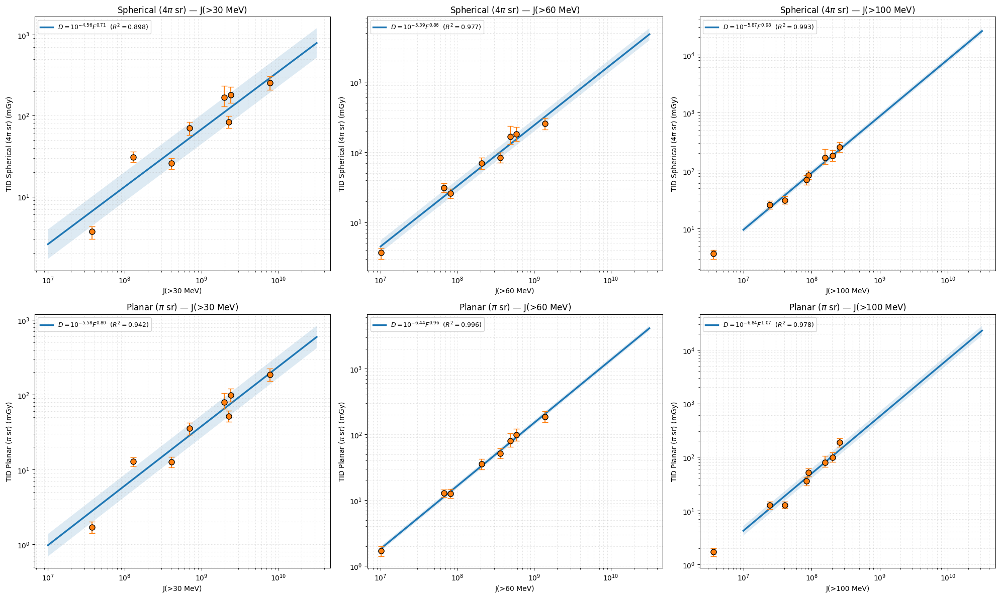


CONFRONTO METRICHE DI FLUENZA (Geometria Sferica)
Metrica                a        b       R²   σ_spec (dex)   σ_spec (%)
----------------------------------------------------------------------
J(>30 MeV)        -4.882    0.748   0.8981         0.1796        51.2%
J(>60 MeV)        -5.521    0.880   0.9769         0.0856        21.8%
J(>100 MeV)       -5.935    0.988   0.9929         0.0475        11.6%

→ La metrica con R² più alto e σ_spectral più basso è
  la migliore per la relazione dose-fluenza nel Monte Carlo.

TABELLA MASTER — 8 EVENTI SEP ANALIZZATI
Dose: TID in Si @ 10 g/cm² Al (37 mm) | Fluenze: omnidirezionali [cm⁻²]
Evento       J(>30)       J(>60)       J(>100)      D_plan     D_sfer       γ_b/γ₂
------------------------------------------------------------------------------------------
AUG 1972     7.85e+09     1.38e+09     2.57e+08     187.1      255.4          7.95
OCT 1989     2.42e+09     5.84e+08     2.02e+08     99.1       181.6          3.07
JUL 2012     1.98e+09   

In [ ]:

import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.stats import pearsonr

# ============================================================
# 1. DATI: 8 EVENTI SEP — FLUENZE + DOSI
# ============================================================

events = {
    'AUG 1972': {'J10': 5.301e10, 'J30': 7.847e9, 'J60': 1.384e9, 'J100': 2.566e8,
                 'D_plan': 187.1, 'D_sfer': 255.4, 'dD_plan': [33.7, 37.1], 'dD_sfer': [47.3, 52.1]},
    'OCT 1989': {'J10': 1.557e10, 'J30': 2.415e9, 'J60': 5.836e8, 'J100': 2.017e8,
                 'D_plan': 99.1, 'D_sfer': 181.6, 'dD_plan': [18.5, 22.7], 'dD_sfer': [37.2, 45.7]},
    'JUL 2012': {'J10': 7.755e9, 'J30': 1.981e9, 'J60': 4.888e8, 'J100': 1.581e8,
                 'D_plan': 79.7, 'D_sfer': 167.1, 'dD_plan': [14.8, 25.3], 'dD_sfer': [37.8, 66.4]},
    'OCT 2003': {'J10': 1.564e10, 'J30': 2.266e9, 'J60': 3.617e8, 'J100': 9.068e7,
                 'D_plan': 51.9, 'D_sfer': 83.9, 'dD_plan': [8.3, 9.5], 'dD_sfer': [13.1, 14.8]},
    'JAN 2005': {'J10': 3.878e9, 'J30': 7.011e8, 'J60': 2.082e8, 'J100': 8.449e7,
                 'D_plan': 35.6, 'D_sfer': 69.9, 'dD_plan': [6.4, 6.8], 'dD_sfer': [12.6, 13.2]},
    'SEP 2017': {'J10': 2.685e9, 'J30': 4.065e8, 'J60': 8.124e7, 'J100': 2.448e7,
                 'D_plan': 12.6, 'D_sfer': 25.8, 'dD_plan': [1.9, 2.1], 'dD_sfer': [3.9, 4.2]},
    'OCT 2021': {'J10': 3.555e8, 'J30': 1.297e8, 'J60': 6.712e7, 'J100': 4.036e7,
                 'D_plan': 12.8, 'D_sfer': 30.9, 'dD_plan': [1.7, 1.8], 'dD_sfer': [4.3, 4.9]},
    'MAY 2024': {'J10': 2.583e8, 'J30': 3.723e7, 'J60': 1.014e7, 'J100': 3.618e6,
                 'D_plan': 1.7, 'D_sfer': 3.7, 'dD_plan': [0.3, 0.3], 'dD_sfer': [0.7, 0.6]},
}

names = list(events.keys())
J30  = np.array([events[n]['J30'] for n in names])
J60  = np.array([events[n]['J60'] for n in names])
J100 = np.array([events[n]['J100'] for n in names])
D_sfer = np.array([events[n]['D_sfer'] for n in names])
D_plan = np.array([events[n]['D_plan'] for n in names])

# Errori asimmetrici per plot (prendi media per fit simmetrico)
dD_sfer_lo = np.array([events[n]['dD_sfer'][0] for n in names])
dD_sfer_hi = np.array([events[n]['dD_sfer'][1] for n in names])
dD_plan_lo = np.array([events[n]['dD_plan'][0] for n in names])
dD_plan_hi = np.array([events[n]['dD_plan'][1] for n in names])


# ============================================================
# 2. FIT POWER LAW PESATO: log(D) = a + b*log(F)
#    Pesi: sigma_logD dalle tue bande CL 16/84
# ============================================================

def linear_model(x, a, b):
    return a + b * x

print("=" * 70)
print("DOSE-FLUENCE POWER LAW FIT (WEIGHTED): D = 10^a × F^b")
print("Shielding: 10 g/cm² Al (37 mm)")
print("=" * 70)

results = {}

for geo_name, D_arr, dD_lo, dD_hi, label in [
    ("Sferica (4pi sr)", D_sfer, dD_sfer_lo, dD_sfer_hi, "Spherical"),
    ("Planare (pi sr)", D_plan, dD_plan_lo, dD_plan_hi, "Planar")
]:
    # Incertezza in log-space dalla media delle bande asimmetriche
    # sigma_logD = media(dD_lo, dD_hi) / (D * ln(10))
    dD_mean = (dD_lo + dD_hi) / 2.0
    sigma_logD = dD_mean / (D_arr * np.log(10))
    
    print(f"\n--- Geometria: {geo_name} ---")
    print(f"    sigma_logD per evento: {[f'{s:.3f}' for s in sigma_logD]}")
    
    for thresh_name, F_arr in [("J(>30 MeV)", J30), ("J(>60 MeV)", J60), ("J(>100 MeV)", J100)]:
        logF = np.log10(F_arr)
        logD = np.log10(D_arr)
        
        # Fit pesato con le tue incertezze
        popt, pcov = curve_fit(linear_model, logF, logD, 
                               sigma=sigma_logD, absolute_sigma=True)
        perr = np.sqrt(np.diag(pcov))
        
        # Residui pesati e chi2 ridotto
        residuals = (logD - linear_model(logF, *popt)) / sigma_logD
        chi2red = np.sum(residuals**2) / (len(logD) - 2)
        
        # Scatter spettrale (dai residui non pesati)
        res_unw = logD - linear_model(logF, *popt)
        sigma_scatter = np.std(res_unw)
        
        # Correlazione
        r, p_val = pearsonr(logF, logD)
        R2 = r**2
        
        key = f"{label}_{thresh_name}"
        results[key] = {
            'a': popt[0], 'b': popt[1],
            'da': perr[0], 'db': perr[1],
            'R2': R2, 'sigma': sigma_scatter,
            'chi2red': chi2red
        }
        
        print(f"\n  {thresh_name}:")
        print(f"    D = 10^({popt[0]:.3f}±{perr[0]:.3f}) × F^({popt[1]:.3f}±{perr[1]:.3f})")
        print(f"    R² = {R2:.4f}  |  chi²_red = {chi2red:.2f}")
        print(f"    sigma_spectral = {sigma_scatter:.4f} dex ({(10**sigma_scatter - 1)*100:.1f}%)")
        print(f"    (scatter = ±{(10**sigma_scatter - 1)*100:.1f}% in dose)")

# ============================================================
# ============================================================
# 3. PLOT COMPLETO: Dose vs J(>30), J(>60), J(>100)
#    FIT PESATO COERENTE CON SEZIONE 2
# ============================================================

thresholds = [
    ("J(>30 MeV)", J30),
    ("J(>60 MeV)", J60),
    ("J(>100 MeV)", J100)
]

geometries = [
    (r"Spherical (4$\pi$ sr)", D_sfer, dD_sfer_lo, dD_sfer_hi),
    (r"Planar ($\pi$ sr)", D_plan, dD_plan_lo, dD_plan_hi)
]

fig, axes = plt.subplots(2, 3, figsize=(20, 12))

for row, (geo_name, D_arr, dD_lo, dD_hi) in enumerate(geometries):

    # errore log-space coerente
    dD_mean = (dD_lo + dD_hi) / 2.0
    sigma_logD = dD_mean / (D_arr * np.log(10))

    for col, (th_name, F_arr) in enumerate(thresholds):

        ax = axes[row, col]

        logF = np.log10(F_arr)
        logD = np.log10(D_arr)

        # ===== FIT PESATO =====
        popt, pcov = curve_fit(
            linear_model,
            logF,
            logD,
            sigma=sigma_logD,
            absolute_sigma=True
        )

        perr = np.sqrt(np.diag(pcov))

        # scatter spettrale dai residui NON pesati
        residuals = logD - linear_model(logF, *popt)
        sigma_sc = np.std(residuals)

        r, _ = pearsonr(logF, logD)

        # ===== curva fit =====
        F_fit = np.logspace(7, 10.5, 300)
        D_fit = 10**(popt[0] + popt[1]*np.log10(F_fit))
        D_fit_hi = 10**(popt[0] + popt[1]*np.log10(F_fit) + sigma_sc)
        D_fit_lo = 10**(popt[0] + popt[1]*np.log10(F_fit) - sigma_sc)

        # banda scatter
        ax.fill_between(
            F_fit,
            D_fit_lo,
            D_fit_hi,
            alpha=0.15
        )

        # retta
        ax.plot(
            F_fit,
            D_fit,
            lw=2.5,
            label=rf'$D = 10^{{{popt[0]:.2f}}} F^{{{popt[1]:.2f}}}$'
                  rf'  ($R^2={r**2:.3f}$)'
        )

        # punti con error bars
        ax.errorbar(
            F_arr,
            D_arr,
            yerr=[dD_lo, dD_hi],
            fmt='o',
            markersize=8,
            capsize=4,
            markeredgecolor='black',
            zorder=5
        )

        ax.set_xscale('log')
        ax.set_yscale('log')

        ax.set_xlabel(th_name)
        ax.set_ylabel(f'TID {geo_name} (mGy)')

        ax.set_title(f'{geo_name} — {th_name}')

        ax.grid(True, which='both', ls=':', alpha=0.4)

        ax.legend(fontsize=9)

plt.tight_layout()
plt.show()

# ============================================================
# 4. CONFRONTO TRA METRICHE: J(>30) vs J(>60) vs J(>100)
# ============================================================

print("\n" + "=" * 70)
print("CONFRONTO METRICHE DI FLUENZA (Geometria Sferica)")
print("=" * 70)
print(f"{'Metrica':<15} {'a':>8} {'b':>8} {'R²':>8} {'σ_spec (dex)':>14} {'σ_spec (%)':>12}")
print("-" * 70)

for thresh_name, F_arr in [("J(>30 MeV)", J30), ("J(>60 MeV)", J60), ("J(>100 MeV)", J100)]:
    logF = np.log10(F_arr)
    logD = np.log10(D_sfer)
    popt, _ = curve_fit(linear_model, logF, logD)
    res = logD - linear_model(logF, *popt)
    sig = np.std(res)
    r, _ = pearsonr(logF, logD)
    pct = (10**sig - 1) * 100
    print(f"{thresh_name:<15} {popt[0]:>8.3f} {popt[1]:>8.3f} {r**2:>8.4f} {sig:>14.4f} {pct:>11.1f}%")

print("\n→ La metrica con R² più alto e σ_spectral più basso è")
print("  la migliore per la relazione dose-fluenza nel Monte Carlo.")

# ============================================================
# 5. TABELLA RIASSUNTIVA FINALE
# ============================================================

print("\n" + "=" * 90)
print("TABELLA MASTER — 8 EVENTI SEP ANALIZZATI")
print("Dose: TID in Si @ 10 g/cm² Al (37 mm) | Fluenze: omnidirezionali [cm⁻²]")
print("=" * 90)
print(f"{'Evento':<12} {'J(>30)':<12} {'J(>60)':<12} {'J(>100)':<12} {'D_plan':<10} {'D_sfer':<10} {'γ_b/γ₂':>8}")
print("-" * 90)

# Indici spettrali per riferimento
gamma_b = {
    'AUG 1972': 7.95, 'OCT 1989': 3.07, 'JUL 2012': 3.20,
    'OCT 2003': 2.50, 'JAN 2005': 3.20, 'SEP 2017': 3.34,
    'OCT 2021': 1.89, 'MAY 2024': 2.67  # gamma ER
}

for name in names:
    e = events[name]
    gb = gamma_b.get(name, 0)
    print(f"{name:<12} {e['J30']:<12.2e} {e['J60']:<12.2e} {e['J100']:<12.2e} "
          f"{e['D_plan']:<10.1f} {e['D_sfer']:<10.1f} {gb:>8.2f}")

print("=" * 90)




# FUNZIONE DI TRASFERIMENTO DOSE vs FLUENZA 
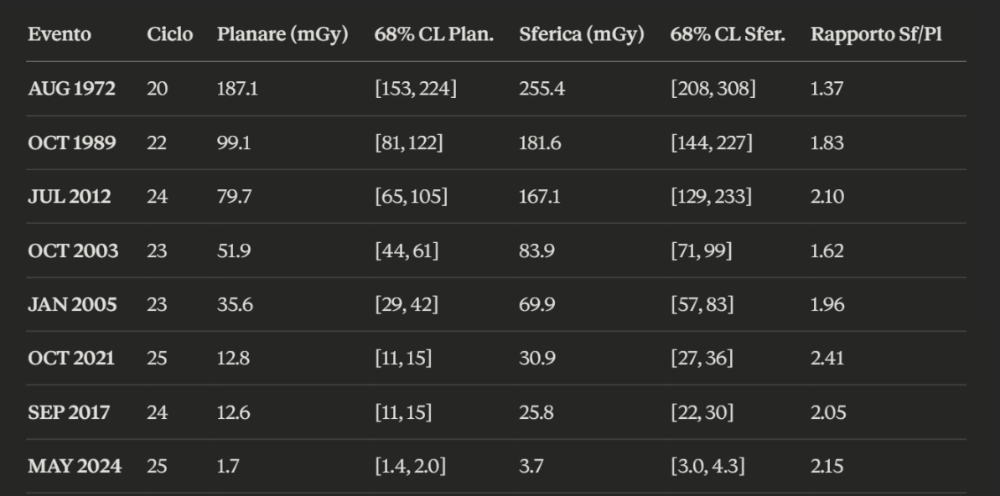
AUG 1972:

J(>10 MeV) = 5.301e+10 cm⁻² 
J(>30 MeV) = 7.847e+09 cm⁻²
J(>60 MeV) = 1.384e+09 cm⁻² 
J(>100 MeV) = 2.566e+08 cm⁻² 
J(>500 MeV) = 2.170e+05 cm⁻²

OCT 1989: 
J(>10 MeV) = 1.557e+10 cm⁻² 
J(>30 MeV) = 2.415e+09 cm⁻²
J(>60 MeV) = 5.836e+08 cm⁻² 
J(>100 MeV) = 2.017e+08 cm⁻²
J(>500 MeV) = 5.535e+06 cm⁻²

OCT 2003: 
J(>10 MeV) = 1.564e+10 cm⁻² 
J(>30 MeV) = 2.266e+09 cm⁻² 
J(>60 MeV) = 3.617e+08 cm⁻² 
J(>100 MeV) = 9.068e+07 cm⁻²
J(>500 MeV) = 9.865e+05 cm⁻²

JAN 2005:
J(>10 MeV) = 3.878e+09 cm⁻² 
J(>30 MeV) = 7.011e+08 cm⁻² 
J(>60 MeV) = 2.082e+08 cm⁻² 
J(>100 MeV) = 8.449e+07 cm⁻² 
J(>500 MeV) = 3.637e+06 cm⁻²

JUL 2012: 
 J(>10 MeV) = 7.755e+09 cm⁻² 
 J(>30 MeV) = 1.981e+09 cm⁻²
  J(>60 MeV) = 4.888e+08 cm⁻² 
  J(>100 MeV) = 1.581e+08 cm⁻² 
  J(>500 MeV) = 3.599e+06 cm⁻²

SEP 2017:
 J(>10 MeV) = 2.685e+09 cm⁻²
  J(>30 MeV) = 4.065e+08 cm⁻² 
  J(>60 MeV) = 8.124e+07 cm⁻² 
  J(>100 MeV) = 2.448e+07 cm⁻²
  J(>500 MeV) = 4.546e+05 cm⁻²


OCT 2021:
J(>10 MeV) = 3.555e+08 cm⁻² 
J(>30 MeV) = 1.297e+08 cm⁻² 
J(>60 MeV) = 6.712e+07 cm⁻² 
J(>100 MeV) = 4.036e+07 cm⁻² 
J(>500 MeV) = 5.066e+06 cm⁻²

MAY 2024: 
J(>10 MeV) = 2.583e+08 cm⁻² 
J(>30 MeV) = 3.723e+07 cm⁻² 
J(>60 MeV) = 1.014e+07 cm⁻² 
J(>100 MeV) = 3.618e+06 cm⁻² 
J(>500 MeV) = 5.240e+04 cm⁻²


DOSE-FLUENCE POWER LAW FIT (WEIGHTED): D = 10^a × F^b
Shielding: 10 g/cm² Al (37 mm) | Pesi: CL68 bootstrap + 5% SRIM

───────────────────────────────────────────────────────────────────────────
Geometria: Sferica (4π sr)
sigma_logD: ['0.085', '0.099', '0.135', '0.072', '0.080', '0.068', '0.065', '0.076']
───────────────────────────────────────────────────────────────────────────

  J(>30 MeV):
    D = 10^(-4.556±0.344) × F^(0.710±0.039)
    R² = 0.8981  |  r = 0.9477  |  p = 3.44e-04
    χ²_red = 7.81  (>>1: scatter spettrale domina)
    σ_spectral = 0.1816 dex (±51.9%)

  J(>60 MeV):
    D = 10^(-5.394±0.369) × F^(0.864±0.045)
    R² = 0.9769  |  r = 0.9884  |  p = 3.91e-06
    χ²_red = 1.55  (>>1: scatter spettrale domina)
    σ_spectral = 0.0862 dex (±21.9%)

  J(>100 MeV):
    D = 10^(-5.872±0.391) × F^(0.979±0.051)
    R² = 0.9929  |  r = 0.9964  |  p = 1.14e-07
    χ²_red = 0.53  (>>1: scatter spettrale domina)
    σ_spectral = 0.0478 dex (±11.6%)

──────────────────────────────

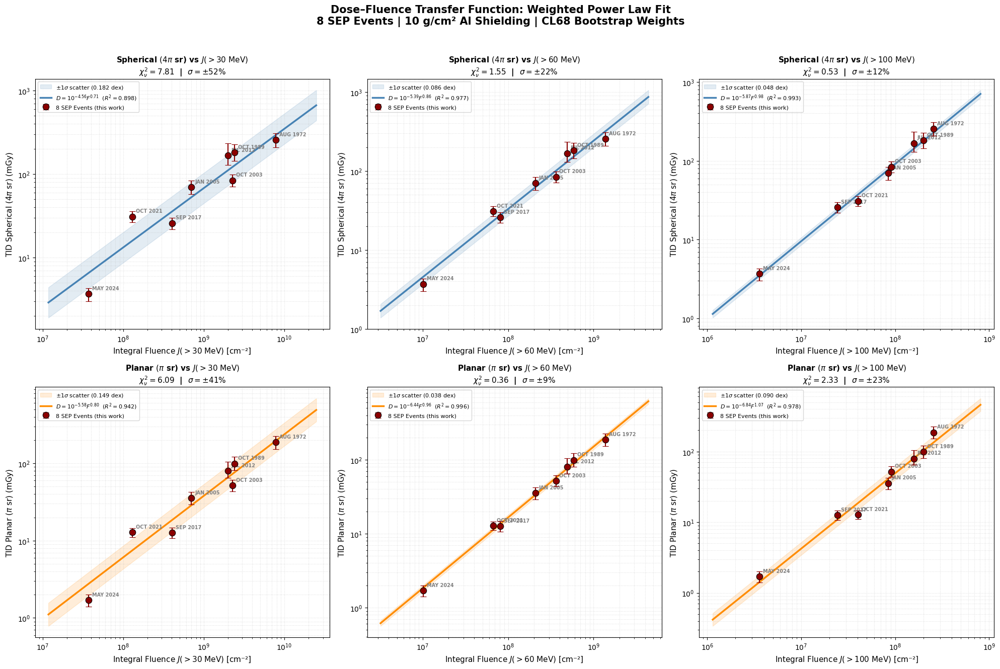


CONFRONTO METRICHE DI FLUENZA — FIT PESATO

  Geometria: SFERICA (4π sr)
  Metrica                a        b       R²   χ²_red    σ (dex)    σ (%)
  ----------------------------------------------------------------------
  J(>30 MeV)        -4.556    0.710   0.8981     7.81     0.1816    51.9%
  J(>60 MeV)        -5.394    0.864   0.9769     1.55     0.0862    21.9%
  J(>100 MeV)       -5.872    0.979   0.9929     0.53     0.0478    11.6%

  Geometria: PLANARE (π sr)
  Metrica                a        b       R²   χ²_red    σ (dex)    σ (%)
  ----------------------------------------------------------------------
  J(>30 MeV)        -5.581    0.796   0.9417     6.09     0.1494    41.0%
  J(>60 MeV)        -6.444    0.958   0.9962     0.36     0.0379     9.1%
  J(>100 MeV)       -6.842    1.067   0.9782     2.33     0.0901    23.1%

INTERPRETAZIONE χ²_ridotto

  χ²_red >> 1 : lo scatter è DOMINATO dalla variabilità spettrale,
                NON dalle incertezze sperimentali. La metrica d

In [13]:

import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.stats import pearsonr

# ============================================================
# 1. DATI: 8 EVENTI SEP — FLUENZE + DOSI
# ============================================================

events = {
    'AUG 1972': {'J10': 5.301e10, 'J30': 7.847e9, 'J60': 1.384e9, 'J100': 2.566e8,
                 'D_plan': 187.1, 'D_sfer': 255.4, 'dD_plan': [33.7, 37.1], 'dD_sfer': [47.3, 52.1]},
    'OCT 1989': {'J10': 1.557e10, 'J30': 2.415e9, 'J60': 5.836e8, 'J100': 2.017e8,
                 'D_plan': 99.1, 'D_sfer': 181.6, 'dD_plan': [18.5, 22.7], 'dD_sfer': [37.2, 45.7]},
    'JUL 2012': {'J10': 7.755e9, 'J30': 1.981e9, 'J60': 4.888e8, 'J100': 1.581e8,
                 'D_plan': 79.7, 'D_sfer': 167.1, 'dD_plan': [14.8, 25.3], 'dD_sfer': [37.8, 66.4]},
    'OCT 2003': {'J10': 1.564e10, 'J30': 2.266e9, 'J60': 3.617e8, 'J100': 9.068e7,
                 'D_plan': 51.9, 'D_sfer': 83.9, 'dD_plan': [8.3, 9.5], 'dD_sfer': [13.1, 14.8]},
    'JAN 2005': {'J10': 3.878e9, 'J30': 7.011e8, 'J60': 2.082e8, 'J100': 8.449e7,
                 'D_plan': 35.6, 'D_sfer': 69.9, 'dD_plan': [6.4, 6.8], 'dD_sfer': [12.6, 13.2]},
    'SEP 2017': {'J10': 2.685e9, 'J30': 4.065e8, 'J60': 8.124e7, 'J100': 2.448e7,
                 'D_plan': 12.6, 'D_sfer': 25.8, 'dD_plan': [1.9, 2.1], 'dD_sfer': [3.9, 4.2]},
    'OCT 2021': {'J10': 3.555e8, 'J30': 1.297e8, 'J60': 6.712e7, 'J100': 4.036e7,
                 'D_plan': 12.8, 'D_sfer': 30.9, 'dD_plan': [1.7, 1.8], 'dD_sfer': [4.3, 4.9]},
    'MAY 2024': {'J10': 2.583e8, 'J30': 3.723e7, 'J60': 1.014e7, 'J100': 3.618e6,
                 'D_plan': 1.7, 'D_sfer': 3.7, 'dD_plan': [0.3, 0.3], 'dD_sfer': [0.7, 0.6]},
}

names = list(events.keys())
J30  = np.array([events[n]['J30'] for n in names])
J60  = np.array([events[n]['J60'] for n in names])
J100 = np.array([events[n]['J100'] for n in names])
D_sfer = np.array([events[n]['D_sfer'] for n in names])
D_plan = np.array([events[n]['D_plan'] for n in names])

dD_sfer_lo = np.array([events[n]['dD_sfer'][0] for n in names])
dD_sfer_hi = np.array([events[n]['dD_sfer'][1] for n in names])
dD_plan_lo = np.array([events[n]['dD_plan'][0] for n in names])
dD_plan_hi = np.array([events[n]['dD_plan'][1] for n in names])

def linear_model(x, a, b):
    return a + b * x

# ============================================================
# 2. FIT POWER LAW PESATO + CHI2 ANALYSIS
# ============================================================

print("=" * 75)
print("DOSE-FLUENCE POWER LAW FIT (WEIGHTED): D = 10^a × F^b")
print("Shielding: 10 g/cm² Al (37 mm) | Pesi: CL68 bootstrap + 5% SRIM")
print("=" * 75)

results = {}

for geo_name, D_arr, dD_lo, dD_hi, label in [
    ("Sferica (4π sr)", D_sfer, dD_sfer_lo, dD_sfer_hi, "Spherical"),
    ("Planare (π sr)", D_plan, dD_plan_lo, dD_plan_hi, "Planar")
]:
    dD_mean = (dD_lo + dD_hi) / 2.0
    sigma_logD = dD_mean / (D_arr * np.log(10))
    
    print(f"\n{'─'*75}")
    print(f"Geometria: {geo_name}")
    print(f"sigma_logD: {[f'{s:.3f}' for s in sigma_logD]}")
    print(f"{'─'*75}")
    
    for thresh_name, F_arr in [("J(>30 MeV)", J30), ("J(>60 MeV)", J60), ("J(>100 MeV)", J100)]:
        logF = np.log10(F_arr)
        logD = np.log10(D_arr)
        
        # Fit pesato
        popt, pcov = curve_fit(linear_model, logF, logD, 
                               sigma=sigma_logD, absolute_sigma=True)
        perr = np.sqrt(np.diag(pcov))
        
        # Chi2 ridotto (residui pesati)
        res_weighted = (logD - linear_model(logF, *popt)) / sigma_logD
        chi2red = np.sum(res_weighted**2) / (len(logD) - 2)
        
        # Scatter spettrale (residui non pesati)
        res_unw = logD - linear_model(logF, *popt)
        sigma_scatter = np.std(res_unw)
        
        # Correlazione
        r, p_val = pearsonr(logF, logD)
        
        key = f"{label}_{thresh_name}"
        results[key] = {
            'a': popt[0], 'b': popt[1],
            'da': perr[0], 'db': perr[1],
            'R2': r**2, 'sigma': sigma_scatter,
            'chi2red': chi2red, 'r': r, 'p_val': p_val,
            'sigma_logD': sigma_logD  # salva per i plot
        }
        
        print(f"\n  {thresh_name}:")
        print(f"    D = 10^({popt[0]:.3f}±{perr[0]:.3f}) × F^({popt[1]:.3f}±{perr[1]:.3f})")
        print(f"    R² = {r**2:.4f}  |  r = {r:.4f}  |  p = {p_val:.2e}")
        print(f"    χ²_red = {chi2red:.2f}  (>>1: scatter spettrale domina)")
        print(f"    σ_spectral = {sigma_scatter:.4f} dex (±{(10**sigma_scatter - 1)*100:.1f}%)")

# ============================================================
# 3. PLOT 2×3: Tutte le combinazioni geometria × soglia
# ============================================================

thresholds = [
    (r"$J(>30\ \mathrm{MeV})$", "J(>30 MeV)", J30),
    (r"$J(>60\ \mathrm{MeV})$", "J(>60 MeV)", J60),
    (r"$J(>100\ \mathrm{MeV})$", "J(>100 MeV)", J100)
]

geo_configs = [
    (r"Spherical $(4\pi$ sr)", "Spherical", D_sfer, dD_sfer_lo, dD_sfer_hi),
    (r"Planar $(\pi$ sr)", "Planar", D_plan, dD_plan_lo, dD_plan_hi)
]

colors_geo = ['steelblue', 'darkorange']

fig, axes = plt.subplots(2, 3, figsize=(20, 13))

for row, (geo_label, geo_key, D_arr, dD_lo, dD_hi) in enumerate(geo_configs):
    for col, (th_label, th_key, F_arr) in enumerate(thresholds):
        
        ax = axes[row, col]
        key = f"{geo_key}_{th_key}"
        res = results[key]
        color = colors_geo[row]
        
        # Griglia fit
        F_fit = np.logspace(np.log10(F_arr.min()) - 0.5, 
                            np.log10(F_arr.max()) + 0.5, 300)
        D_fit = 10**(res['a'] + res['b'] * np.log10(F_fit))
        D_fit_hi = 10**(res['a'] + res['b'] * np.log10(F_fit) + res['sigma'])
        D_fit_lo = 10**(res['a'] + res['b'] * np.log10(F_fit) - res['sigma'])
        
        # Banda scatter spettrale
        ax.fill_between(F_fit, D_fit_lo, D_fit_hi, color=color, alpha=0.15,
                        label=rf'$\pm 1\sigma$ scatter ({res["sigma"]:.3f} dex)')
        
        # Retta fit
        ax.plot(F_fit, D_fit, '-', color=color, lw=2.5,
                label=rf'$D = 10^{{{res["a"]:.2f}}} F^{{{res["b"]:.2f}}}$'
                      rf'  ($R^2={res["R2"]:.3f}$)')
        
        # Punti con error bars
        ax.errorbar(F_arr, D_arr, yerr=[dD_lo, dD_hi],
                    fmt='o', color='darkred', markersize=9, capsize=4, capthick=1.5,
                    markeredgecolor='black', markeredgewidth=0.8, zorder=5,
                    label='8 SEP Events (this work)')
        
        # Labels eventi
        for i, name in enumerate(names):
            ax.annotate(name, (F_arr[i], D_arr[i]),
                       xytext=(5, 6), textcoords='offset points',
                       fontsize=7, fontweight='bold', color='gray')
        
        ax.set_xscale('log'); ax.set_yscale('log')
        ax.set_xlabel(f'Integral Fluence {th_label} [cm⁻²]', fontsize=11)
        ax.set_ylabel(f'TID {geo_label} (mGy)', fontsize=11)
        ax.set_title(f'{geo_label} vs {th_label}\n'
                     rf'$\chi^2_\nu = {res["chi2red"]:.2f}$  |  '
                     rf'$\sigma = \pm{(10**res["sigma"]-1)*100:.0f}\%$',
                     fontsize=11, fontweight='bold')
        ax.grid(True, which='both', ls=':', alpha=0.4)
        ax.legend(fontsize=8, loc='upper left')

fig.suptitle('Dose–Fluence Transfer Function: Weighted Power Law Fit\n'
             '8 SEP Events | 10 g/cm² Al Shielding | CL68 Bootstrap Weights',
             fontsize=15, fontweight='bold', y=1.02)
fig.tight_layout()
plt.show()

# ============================================================
# 4. TABELLA CONFRONTO METRICHE (PESATO — coerente con Sez. 2)
# ============================================================

print("\n" + "=" * 85)
print("CONFRONTO METRICHE DI FLUENZA — FIT PESATO")
print("=" * 85)

for geo_label, geo_key in [("SFERICA (4π sr)", "Spherical"), ("PLANARE (π sr)", "Planar")]:
    print(f"\n  Geometria: {geo_label}")
    print(f"  {'Metrica':<15} {'a':>8} {'b':>8} {'R²':>8} {'χ²_red':>8} {'σ (dex)':>10} {'σ (%)':>8}")
    print(f"  {'-'*70}")
    
    for th_key in ["J(>30 MeV)", "J(>60 MeV)", "J(>100 MeV)"]:
        key = f"{geo_key}_{th_key}"
        r = results[key]
        pct = (10**r['sigma'] - 1) * 100
        print(f"  {th_key:<15} {r['a']:>8.3f} {r['b']:>8.3f} {r['R2']:>8.4f} "
              f"{r['chi2red']:>8.2f} {r['sigma']:>10.4f} {pct:>7.1f}%")

# ============================================================
# 5. INTERPRETAZIONE CHI2
# ============================================================

print("\n" + "=" * 85)
print("INTERPRETAZIONE χ²_ridotto")
print("=" * 85)
print("""
  χ²_red >> 1 : lo scatter è DOMINATO dalla variabilità spettrale,
                NON dalle incertezze sperimentali. La metrica di fluenza
                non cattura bene la dose dietro schermatura.
                
  χ²_red ≈ 1  : lo scatter è INTERAMENTE spiegato dalle incertezze
                sperimentali. La relazione dose-fluenza è quasi perfetta.
                
  χ²_red < 1  : le incertezze sperimentali sono sovrastimate (conservativo)
                OPPURE il fit assorbe parte del rumore (con solo 8 punti 
                e 2 parametri, ν=6, questo è possibile).
""")

for geo_key, geo_label in [("Spherical", "Sferica"), ("Planar", "Planare")]:
    print(f"\n  {geo_label}:")
    for th_key in ["J(>30 MeV)", "J(>60 MeV)", "J(>100 MeV)"]:
        key = f"{geo_key}_{th_key}"
        r = results[key]
        if r['chi2red'] > 3:
            interp = "⚠️  SCATTER SPETTRALE DOMINA"
        elif r['chi2red'] > 1.5:
            interp = "⚡ scatter spettrale significativo"
        elif r['chi2red'] > 0.5:
            interp = "✅ buon fit, incertezze coerenti"
        else:
            interp = "✅ fit eccellente (incertezze conservative)"
        print(f"    {th_key}: χ²_red = {r['chi2red']:.2f}  → {interp}")

# ============================================================
# 6. TABELLA MASTER FINALE
# ============================================================

print("\n" + "=" * 110)
print("TABELLA MASTER — 8 EVENTI SEP ANALIZZATI")
print("Dose: TID in Si @ 10 g/cm² Al (37 mm) | Fluenze omnidirezionali [cm⁻²]")
print("=" * 110)
print(f"{'Evento':<12} {'Ciclo':>5} {'J(>30)':<12} {'J(>60)':<12} {'J(>100)':<12} "
      f"{'D_plan':>8} {'CL68_plan':>14} {'D_sfer':>8} {'CL68_sfer':>14} {'γ_b':>6}")
print("-" * 110)

gamma_b = {
    'AUG 1972': 7.95, 'OCT 1989': 3.07, 'JUL 2012': 3.20,
    'OCT 2003': 2.50, 'JAN 2005': 3.20, 'SEP 2017': 3.34,
    'OCT 2021': 1.89, 'MAY 2024': 2.67
}
cycles = {
    'AUG 1972': 20, 'OCT 1989': 22, 'JUL 2012': 24,
    'OCT 2003': 23, 'JAN 2005': 23, 'SEP 2017': 24,
    'OCT 2021': 25, 'MAY 2024': 25
}

for name in names:
    e = events[name]
    gb = gamma_b[name]
    cy = cycles[name]
    cl_p = f"[{e['D_plan']-e['dD_plan'][0]:.0f}, {e['D_plan']+e['dD_plan'][1]:.0f}]"
    cl_s = f"[{e['D_sfer']-e['dD_sfer'][0]:.0f}, {e['D_sfer']+e['dD_sfer'][1]:.0f}]"
    print(f"{name:<12} {cy:>5} {e['J30']:<12.2e} {e['J60']:<12.2e} {e['J100']:<12.2e} "
          f"{e['D_plan']:>8.1f} {cl_p:>14} {e['D_sfer']:>8.1f} {cl_s:>14} {gb:>6.2f}")

print("=" * 110)
print("\nNota: Le fluenze integrali sono calcolate dal best-fit della Band function")
print("(Ellison-Ramaty per MAY 2024). Le incertezze sulle fluenze, derivate dalla")
print("propagazione degli errori sui parametri spettrali, sono dell'ordine del 10-20%")
print("e sono incluse implicitamente nello scatter della relazione dose-fluenza.")

# FUNZIONE CUMULATIVA DELLE FLUENZE 

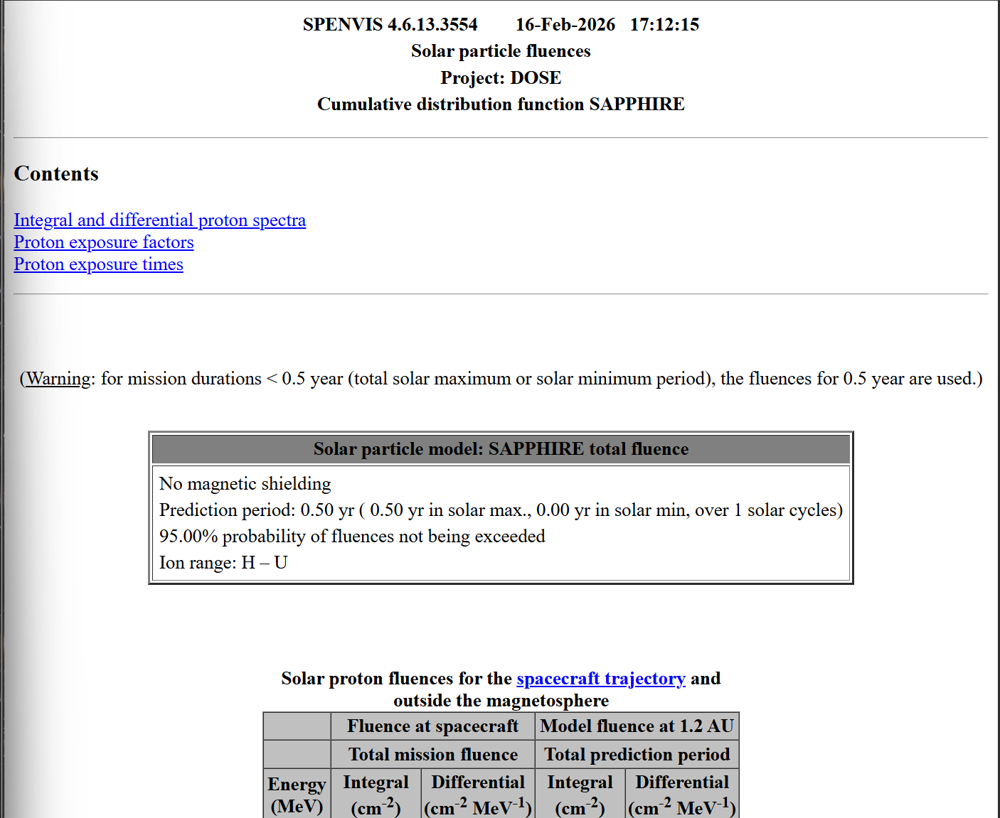

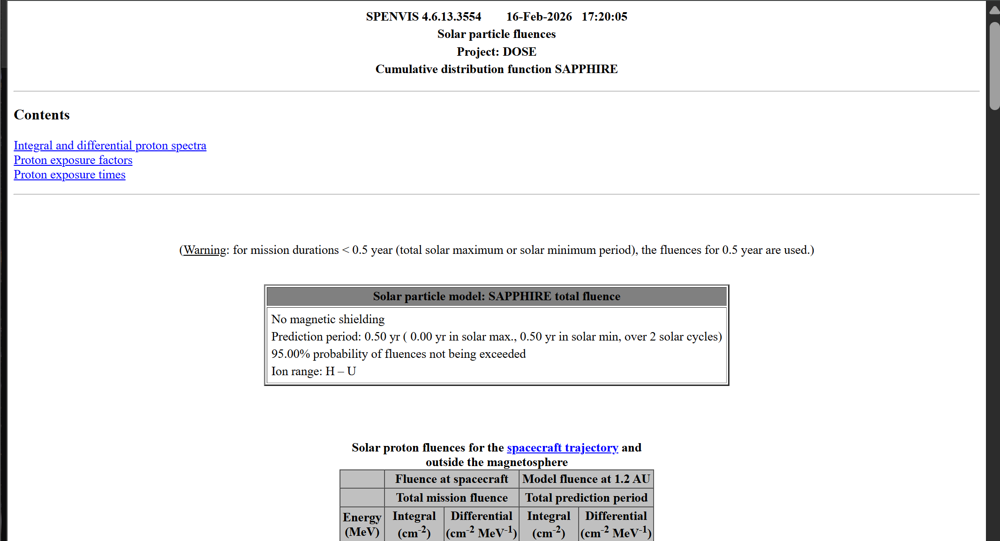



Geometria: SFERICA (4π sr)
  Metrica                a        b       R²   χ²_red    σ (dex)    σ (%)
  ----------------------------------------------------------------------
  J(>30 MeV)        -4.556    0.710   0.8981     7.81     0.1816    51.9%
  J(>60 MeV)        -5.394    0.864   0.9769     1.55     0.0862    21.9%
  J(>100 MeV)       -5.872    0.979   0.9929     0.53     0.0478    11.6%

  Geometria: PLANARE (π sr)
  Metrica                a        b       R²   χ²_red    σ (dex)    σ (%)
  ----------------------------------------------------------------------
  J(>30 MeV)        -5.581    0.796   0.9417     6.09     0.1494    41.0%
  J(>60 MeV)        -6.444    0.958   0.9962     0.36     0.0379     9.1%
  J(>100 MeV)       -6.842    1.067   0.9782     2.33     0.0901    23.1%

# CALCOLO DOSE 90%CL SOLAR MAX 1AU SAPPHIRE 0.5 yrs

In [6]:
# CALCOLO DOSE 90%CL SOLAR MAX 1AU SAPPHIRE 0.5 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  1.745E+08



a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 4.552E+07

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 28.290 mGy
Dose sferica stimata: 42.207 mGy


In [7]:
# CALCOLO DOSE 90%CL SOLAR min 1AU SAPPHIRE 0.5 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  9.448E+06



a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 2.440E+06

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 1.731 mGy
Dose sferica stimata: 2.406 mGy


# 95% confidence level SOLAR MAX 1AU SAPPHIRE 0.5 yrs

In [ ]:
# CALCOLO DOSE 95%CL SOLAR min 1AU SAPPHIRE 0.5 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  5.070E+07



a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 1.246E+07

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 8.658 mGy
Dose sferica stimata: 11.872 mGy


In [9]:
# CALCOLO DOSE 95%CL SOLAR MAX 1AU SAPPHIRE 0.5 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  3.080E+08



a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 8.752E+07

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 48.756 mGy
Dose sferica stimata: 80.043 mGy


# SAPPHIRE 1yr Mission 

In [10]:
# CALCOLO DOSE 90%CL SOLAR MAX 1AU SAPPHIRE 1 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  3.313E+08



a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 9.244E+07

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 52.284 mGy
Dose sferica stimata: 84.446 mGy


In [11]:
# CALCOLO DOSE 90%CL SOLAR MIN 1AU SAPPHIRE 1 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  4.692E+07



a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 1.163E+07

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 8.038 mGy
Dose sferica stimata: 11.097 mGy


# 95%

In [12]:
# CALCOLO DOSE 95%CL SOLAR MAX 1AU SAPPHIRE 1 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  4.899E+08



a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 1.440E+08

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 76.054 mGy
Dose sferica stimata: 130.328 mGy


In [13]:
# CALCOLO DOSE 95%CL SOLAR IN 1AU SAPPHIRE 1 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV = 1.307E+08



a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV =  3.439E+07

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 21.448 mGy
Dose sferica stimata: 32.075 mGy


# 1.5 yrs SAPPHIRE

In [14]:
# CALCOLO DOSE 90%CL SOLAR MIN 1AU SAPPHIRE 1.5 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  8.398E+07



a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 2.136E+07

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 14.040 mGy
Dose sferica stimata: 20.122 mGy


In [15]:
# CALCOLO DOSE 90%CL SOLAR MAX 1AU SAPPHIRE 1.5 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  4.532E+08


a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 1.285E+08

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 70.587 mGy
Dose sferica stimata: 116.578 mGy


# 95% 1.5yrs

In [16]:
# CALCOLO DOSE 95%CL SOLAR MAX 1AU SAPPHIRE 1.5 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  6.300E+08


a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV =1.865E+08

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 96.776 mGy
Dose sferica stimata: 167.878 mGy


In [17]:
# CALCOLO DOSE 95%CL SOLAR MIN 1AU SAPPHIRE 1.5 yrs

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  1.871E+08


a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 5.114E+07

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 30.245 mGy
Dose sferica stimata: 47.302 mGy


# STIME CON PSYCHIC

In [18]:
# CALCOLO DOSE 90%CL SOLAR MAX 1AU SAPPHIRE 1.0 yr

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  4.548E+08


a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 1.608E+08

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 70.826 mGy
Dose sferica stimata: 145.196 mGy


In [19]:
# CALCOLO DOSE 95%CL SOLAR MAX 1AU SAPPHIRE 1.0 yr

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV =  9.725E+08


a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 3.544E+08

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 146.689 mGy
Dose sferica stimata: 314.742 mGy


In [20]:
# CALCOLO DOSE 90%CL SOLAR MAX 1AU SAPPHIRE 1.5 yr

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV = 1.470E+09


a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 5.224E+08

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 217.916 mGy
Dose sferica stimata: 460.177 mGy


In [21]:
# CALCOLO DOSE 95%CL SOLAR MAX 1AU SAPPHIRE 1.5 yr

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV = 3.033E+09


a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 1.113E+09

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata: {dose_sferica:.3f} mGy")

Dose planare stimata: 436.148 mGy
Dose sferica stimata: 964.981 mGy


# PLOT risultati SAPPHIRE e ESP-PSCHIC

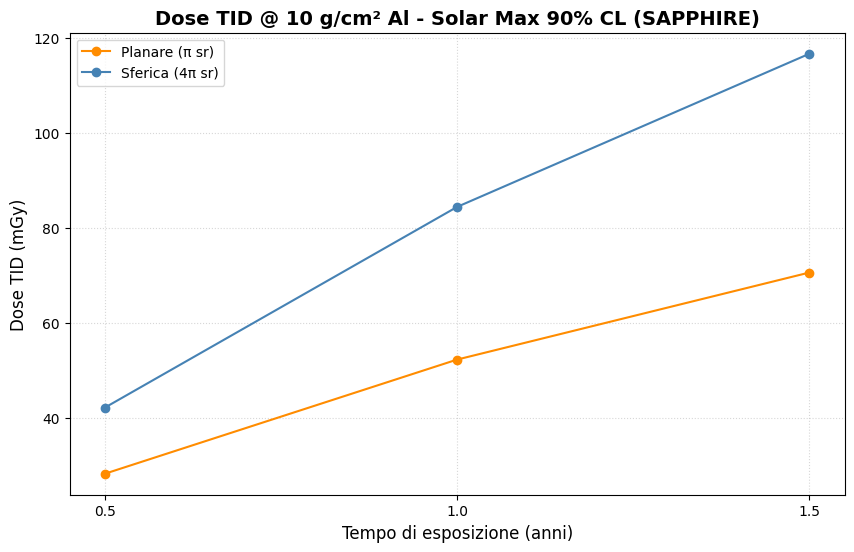

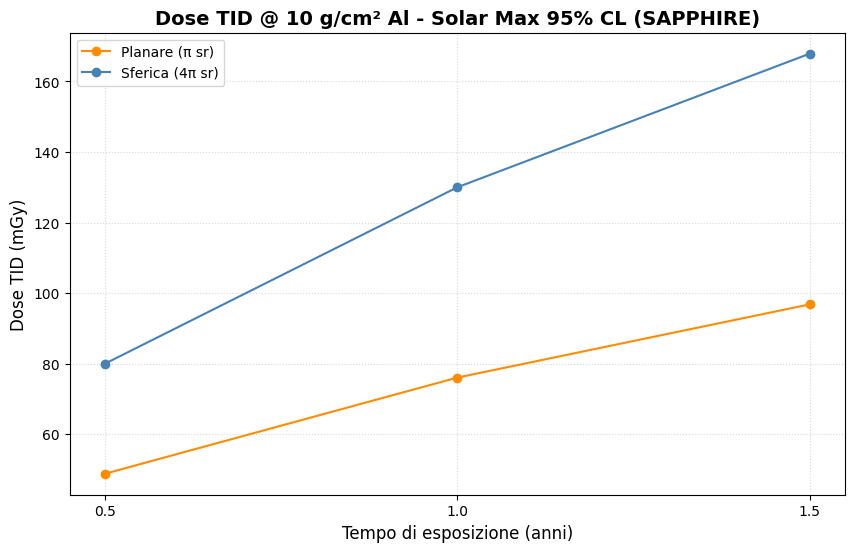

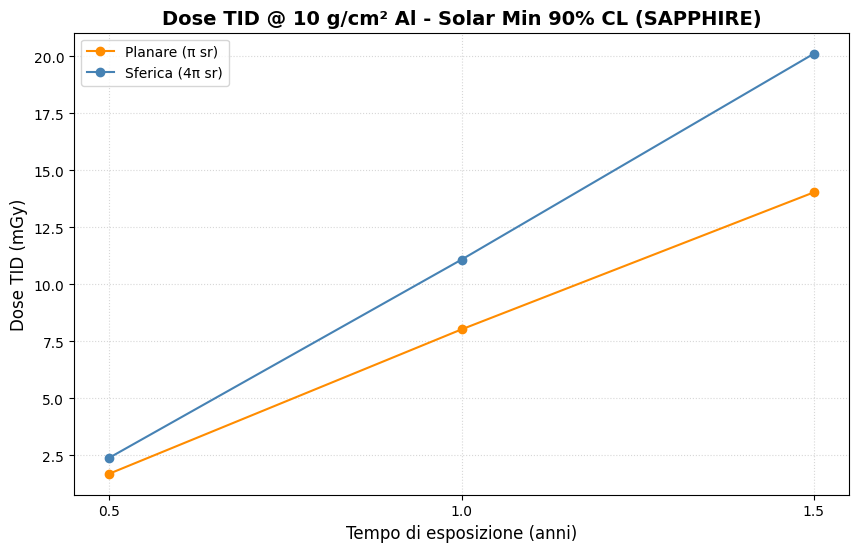

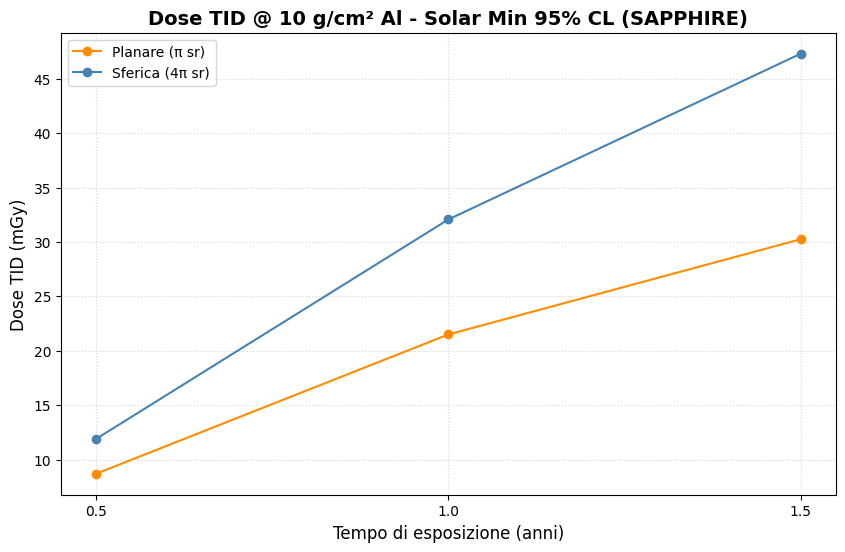

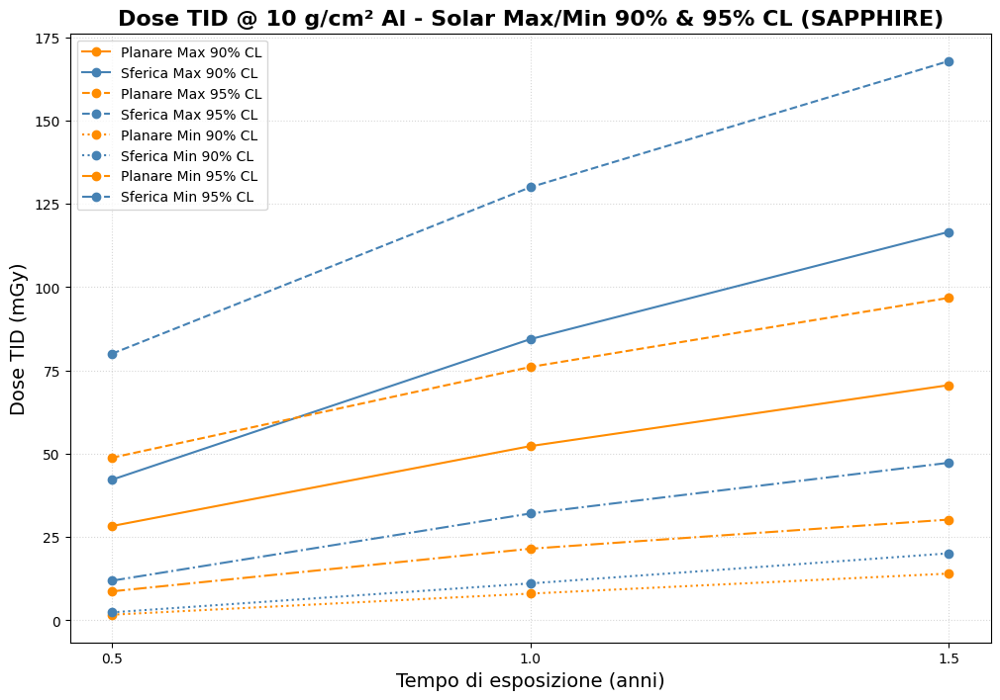

In [30]:

import matplotlib.pyplot as plt

time = [0.5, 1.0, 1.5]

dose_planare_max_sapphire_90 = [28.3,52.3,70.6]
dose_sferica_max_sapphire_90 = [42.2, 84.4, 116.6]

dose_planare_max_sapphire_95 = [48.8, 76.05, 96.8]
dose_sferica_max_sapphire_95 = [80,130.0,167.87]


dose_planare_min_sapphire_90 = [1.7,8.03,14.04]
dose_sferica_min_sapphire_90 = [2.4,11.09,20.12]

dose_planare_min_sapphire_95 = [8.7,21.5,30.25]
dose_sferica_min_sapphire_95 = [11.9,32.07,47.3]


#plot MAX solare 90%
plt.figure(figsize=(10, 6))
plt.plot(time, dose_planare_max_sapphire_90, marker='o', label='Planare (π sr)', color='darkorange')
plt.plot(time, dose_sferica_max_sapphire_90, marker='o', label='Sferica (4π sr)', color='steelblue')
plt.title('Dose TID @ 10 g/cm² Al - Solar Max 90% CL (SAPPHIRE)', fontsize=14, fontweight='bold')
plt.xlabel('Tempo di esposizione (anni)', fontsize=12)
plt.ylabel('Dose TID (mGy)', fontsize=12)
plt.xticks(time)
plt.grid(True, ls=':', alpha=0.5)
plt.legend()
plt.show()

#plot MAX solare 95%
plt.figure(figsize=(10, 6))
plt.plot(time, dose_planare_max_sapphire_95, marker='o', label='Planare (π sr)', color='darkorange')
plt.plot(time, dose_sferica_max_sapphire_95, marker='o', label='Sferica (4π sr)', color='steelblue')
plt.title('Dose TID @ 10 g/cm² Al - Solar Max 95% CL (SAPPHIRE)', fontsize=14, fontweight='bold')
plt.xlabel('Tempo di esposizione (anni)', fontsize=12)
plt.ylabel('Dose TID (mGy)', fontsize=12)
plt.xticks(time)
plt.grid(True, ls=':', alpha=0.5)
plt.legend()
plt.show()

#plot MIN solare 90%
plt.figure(figsize=(10, 6))
plt.plot(time, dose_planare_min_sapphire_90, marker='o', label='Planare (π sr)', color='darkorange')
plt.plot(time, dose_sferica_min_sapphire_90, marker='o', label='Sferica (4π sr)', color='steelblue')
plt.title('Dose TID @ 10 g/cm² Al - Solar Min 90% CL (SAPPHIRE)', fontsize=14, fontweight='bold')
plt.xlabel('Tempo di esposizione (anni)', fontsize=12)
plt.ylabel('Dose TID (mGy)', fontsize=12)
plt.xticks(time)
plt.grid(True, ls=':', alpha=0.5)
plt.legend()
plt.show()

#plot MIN solare 95%
plt.figure(figsize=(10, 6))
plt.plot(time, dose_planare_min_sapphire_95, marker='o', label='Planare (π sr)', color='darkorange')
plt.plot(time, dose_sferica_min_sapphire_95, marker='o', label='Sferica (4π sr)', color='steelblue')
plt.title('Dose TID @ 10 g/cm² Al - Solar Min 95% CL (SAPPHIRE)', fontsize=14, fontweight='bold')
plt.xlabel('Tempo di esposizione (anni)', fontsize=12)
plt.ylabel('Dose TID (mGy)', fontsize=12)
plt.xticks(time)
plt.grid(True, ls=':', alpha=0.5)
plt.legend()
plt.show()




# single plot with all curves
plt.figure(figsize=(12, 8))
plt.plot(time, dose_planare_max_sapphire_90, marker='o', label='Planare Max 90% CL', color='darkorange')
plt.plot(time, dose_sferica_max_sapphire_90, marker='o', label='Sferica Max 90% CL', color='steelblue')
plt.plot(time, dose_planare_max_sapphire_95, marker='o', label='Planare Max 95% CL', color='darkorange', linestyle='--')
plt.plot(time, dose_sferica_max_sapphire_95, marker='o', label='Sferica Max 95% CL', color='steelblue', linestyle='--')
plt.plot(time, dose_planare_min_sapphire_90, marker='o', label='Planare Min 90% CL', color='darkorange', linestyle=':')
plt.plot(time, dose_sferica_min_sapphire_90, marker='o', label='Sferica Min 90% CL', color='steelblue', linestyle=':')
plt.plot(time, dose_planare_min_sapphire_95, marker='o', label='Planare Min 95% CL', color='darkorange', linestyle='-.')
plt.plot(time, dose_sferica_min_sapphire_95, marker='o', label='Sferica Min 95% CL', color='steelblue', linestyle='-.')
plt.title('Dose TID @ 10 g/cm² Al - Solar Max/Min 90% & 95% CL (SAPPHIRE)', fontsize=16, fontweight='bold')
plt.xlabel('Tempo di esposizione (anni)', fontsize=14)
plt.ylabel('Dose TID (mGy)', fontsize=14)
plt.xticks(time)
plt.grid(True, ls=':', alpha=0.5)
plt.legend(loc='upper left', fontsize=10)
plt.show()




# WORST-EVENT FLUENCE SAPPHIRE

# 0.5 yr SOLAR MAX 95%CL SAPPHIER 

In [26]:


a_planar = -6.444
b_planar = 0.958

fluenza_63MeV = 2.720E+08


a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 7.832E+07

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata da Singolo evento Worst Case: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata da Singolo evento Worst Case: {dose_sferica:.3f} mGy")

Dose planare stimata da Singolo evento Worst Case: 43.283 mGy
Dose sferica stimata da Singolo evento Worst Case: 71.796 mGy


# 1yr SAPPHIRE worst case

In [29]:


a_planar = -6.444
b_planar = 0.958

fluenza_63MeV = 3.952E+08


a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 1.189E+08

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata da Singolo evento Worst Case: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata da Singolo evento Worst Case: {dose_sferica:.3f} mGy")

Dose planare stimata da Singolo evento Worst Case: 61.909 mGy
Dose sferica stimata da Singolo evento Worst Case: 108.045 mGy


# WORST- EVENT FLUENCE PSYCHIC 1yr

In [28]:
# Worst case 95%CL 1yr in SOLAR MAX from PSYCHIC

a_planar = -6.444
b_planar = 0.958

fluenza_63MeV = 1.976E+09


a_sferica = -5.872
b_sferica = 0.979
 
fluenza_100MeV = 6.279E+08

dose_planare = (10**a_planar) * (fluenza_63MeV**b_planar)
print(f"Dose planare stimata da Singolo evento Worst Case: {dose_planare:.3f} mGy")

dose_sferica = (10**a_sferica) * (fluenza_100MeV**b_sferica)
print(f"Dose sferica stimata da Singolo evento Worst Case: {dose_sferica:.3f} mGy")

Dose planare stimata da Singolo evento Worst Case: 289.310 mGy
Dose sferica stimata da Singolo evento Worst Case: 550.979 mGy
